In [1]:
import os
import csv
import optuna
import numpy as np
import pandas as pd
from tensorflow import keras
from tensorflow.keras.optimizers import Adam, RMSprop, SGD
import tensorflow as tf
from keras.models import Sequential
from keras.layers import Input, Conv1D, MaxPooling1D, LSTM, Dense, Activation, Dropout
from pandas import DataFrame
from pandas import Series
from pandas import concat
from pandas import read_csv
from datetime import datetime
from sklearn.metrics import mean_squared_error
from sklearn.preprocessing import MinMaxScaler
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import KFold
from sklearn.model_selection import train_test_split
from sklearn.model_selection import cross_val_score
from math import sqrt
from matplotlib import pyplot as plt
from matplotlib.patches import Patch
from numpy import array
import keras.backend as K
import itertools
#!pip install pydot
    
# date-time parsing function for loading the dataset
def parser(x):
    return datetime.strptime('190'+x, '%Y-%m')
    
def rmse (y_true, y_pred):
    return K.sqrt(K.mean(K.square(y_pred - y_true)))
    
def mape (y_true, y_pred):
    return 100*K.mean(K.sqrt(K.square(y_true - y_pred))/y_true)
    
def pearson (y_true, y_pred):
    return (K.square(K.mean((y_true - K.mean(y_true))*(y_pred - K.mean(y_pred)))))/(K.mean(K.square(y_true - K.mean(y_true)))*K.mean(K.square(y_pred - K.mean(y_pred))))
    
# convert time series into a supervised learning problem
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
# convert time series into a supervised learning problem
def series_to_supervised(data, n_in=1, n_out=1, dropnan=True):

    n_vars = 1 if type(data) is list else data.shape[1]
    cols, names = list(), list()
    df = DataFrame(data)
    # input sequence (t-n, ... t-1)
    for i in range(n_in, 0, -1):
    	cols.append(df.shift(i))
    	names += [('var%d(t-%d)' % (j+1, i)) for j in range(n_vars)]
    # forecast sequence (t, t+1, ... t+n)
    for i in range(0, n_out):
        cols.append(df[0].shift(-i)) # df[0] for specific humidity
        if i == 0:
            names += [('var%d(t)' % (1))] # % (1) for specific humidity
        else:            
            names += [('var%d(t+%d)' % (1, i))] # % (1) for specific humidity
    
    # put it all together
    agg = concat(cols, axis=1)

    if dropnan:
        #Drop rows containing NaN
        agg.dropna(inplace=True)

    agg.columns = names

    return agg
     
# create a differenced series
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def difference(dataset, interval=1):
    diff = list()
    for i in range(interval, len(dataset)):
        value = dataset[i] - dataset[i - interval]
        diff.append(value)
    return Series(diff)
     
# transform series into training sets for supervised learning
def prepare_training_data(data, n_lag, n_seq, n_time_steps):
    
    #Prepare data for time series forecasting.
        
    #Parameters:
    #x (array-like): Input features.
    #y (array-like): Target values.
    #n_test (int): Number of test samples (rows).
    #n_lag (int): Number of lag observations.
    #n_seq (int): Number of sequence observations.
    #n_train (int): Number of training samples (rows).
        
    #Returns:
    #tuple: Training and test datasets.
    
    n_vars = len(data[0][0])

    # Each weather station has 227 time steps (the first 180 have no nan values)
    # Loop through data, grabbing one weather station (ws) at a time, 
    # differencing on each ws and separating by training (first 226-n_lag-n_seq-n_test time steps) 
    # and testing (n_test time steps) to scale data on training only.
    # We then recombine the training and testing datasets to change each ws to a supervised learning problem by taking all the first 180 time steps for all 12 predictors
    # and changing these to (t-n_lag) to (t-1) since we lose one row through differencing. We then shift forward only one dependent variable (temperature or specific humidity)
    # for time steps t to (t+n_seq)

    diff_values = []
    
    for ws in range(84):
        
        # transform data to be stationary
        diff_series = difference(data[ws], 1)
        for i in range(len(diff_series)):
            diff_values_row = []
            for j in range(len(diff_series[0])):
                diff_values_row.append(diff_series[i][j])
            diff_values.append(diff_values_row)

    # rescale values to 0, 1
    scaler_all_features =  MinMaxScaler(feature_range=(0, 1))
    scaler =  MinMaxScaler(feature_range=(0, 1))
    #diff_values_training = np.array(diff_values_for_training)
    #diff_values_training = diff_values_training.reshape(1, -1) 
    train_scaled_values = scaler_all_features.fit_transform(diff_values)
    response_train_values = []
    for i in range(len(diff_values)):
        response_train_values.append(diff_values[i][0]) # Uses first column (specific_humidity) as response variable
    response_train_values = np.array(response_train_values)
    response_train_values = response_train_values.reshape(len(response_train_values), 1)

    # Fit the scaler for just the response variable for use later when forecasting
    response_scaled_values = scaler.fit_transform(response_train_values) 
    scaled_values = scaler_all_features.transform(diff_values)

    train = []

    # Transform each weather station as a separate "batch"
    for ws in range(84):
        # transform into supervised learning problem X, y
        first = (n_time_steps-1)*ws
        last = (n_time_steps-1)*ws+(n_time_steps-2)
        scaled_values_batch = scaled_values[first:last]
        supervised = series_to_supervised(scaled_values_batch, n_lag, n_seq)
        supervised_values = supervised.values
        train.append([supervised_values])
    
    return scaler, scaler_all_features, train

# transform series into testing and validation sets for supervised learning
def prepare_testing_and_validation_data(data, n_lag, n_seq, n_time_steps, scaler_all_features):
    
    #Prepare data for time series forecasting.
        
    #Parameters:
    #x (array-like): Input features.
    #y (array-like): Target values.
    #n_test (int): Number of test samples (rows).
    #n_lag (int): Number of lag observations.
    #n_seq (int): Number of sequence observations.
    #n_train (int): Number of training samples (rows).
        
    #Returns:
    #tuple: Training and test datasets.
    
    n_vars = len(data[0][0])

    # Each weather station has 227 time steps (the first 180 have no nan values)
    # Loop through data, grabbing one weather station (ws) at a time, 
    # differencing on each ws and separating by training (first 226-n_lag-n_seq-n_test time steps) 
    # and testing (n_test time steps) to scale data on training only.
    # We then recombine the training and testing datasets to change each ws to a supervised learning problem by taking all the first 180 time steps for all 12 predictors
    # and changing these to (t-n_lag) to (t-1) since we lose one row through differencing. We then shift forward only one dependent variable (temperature or specific humidity)
    # for time steps t to (t+n_seq)

    diff_values = []
    
    for ws in range(21):
        
        # transform data to be stationary
        diff_series = difference(data[ws], 1)
        for i in range(len(diff_series)):
            diff_values_row = []
            for j in range(len(diff_series[0])):
                diff_values_row.append(diff_series[i][j])
            diff_values.append(diff_values_row)

    # rescale values to 0, 1
    scaled_values = scaler_all_features.transform(diff_values)

    validation = []
    test = []

    # Transform each weather station as a separate "batch"
    for ws in range(21):
        # transform into supervised learning problem X, y
        first = (n_time_steps-1)*ws
        last = (n_time_steps-1)*ws+(n_time_steps-2)
        scaled_values_batch = scaled_values[first:last]
        supervised = series_to_supervised(scaled_values_batch, n_lag, n_seq)
        supervised_values = supervised.values
        # training/test/validation split is 80%/10%/10%
        if ws < 11:
            test.append([supervised_values])
        else:
            validation.append([supervised_values])
    
    return validation, test
    
def plot_kfold(cv, X, y, ax, n_splits, xlim_max=105):
    
    #Plots the indices for a cross-validation object.
    #Taken from https://www.geeksforgeeks.org/cross-validation-using-k-fold-with-scikit-learn/
    
    #Parameters:
    #cv: Cross-validation object
    #X: Feature set
    #y: Target variable
    #ax: Matplotlib axis object
    #n_splits: Number of folds in the cross-validation
    #xlim_max: Maximum limit for the x-axis
        
    # Set color map for the plot
    cmap_cv = plt.cm.coolwarm
    cv_split = cv.split(X=X, y=y)
        
    for i_split, (train_idx, test_idx) in enumerate(cv_split):
        # Create an array of NaNs and fill in training/testing indices
        indices = np.full(len(X), np.nan)
        indices[test_idx], indices[train_idx] = 1, 0
            
        # Plot the training and testing indices
        ax_x = range(len(indices))
        ax_y = [i_split + 0.5] * len(indices)
        ax.scatter(ax_x, ax_y, c=indices, marker="_", 
                   lw=10, cmap=cmap_cv, vmin=-0.2, vmax=1.2)
    
        # Set y-ticks and labels
        y_ticks = np.arange(n_splits) + 0.5
        ax.set(yticks=y_ticks, yticklabels=range(n_splits),
               xlabel="Weather Station index (file_id)", ylabel="Fold",
               ylim=[n_splits, -0.2], xlim=[0, xlim_max])
    
        # Set plot title and create legend
        ax.set_title("KFold", fontsize=14)
        legend_patches = [Patch(color=cmap_cv(0.8), label="Testing set"), 
                          Patch(color=cmap_cv(0.02), label="Training set")]
        ax.legend(handles=legend_patches, loc=(1.03, 0.8))
    
#Main

#Configure
n_seq = 60
if n_seq > 46:
    n_lag = 179 - n_seq + 46
else:
    n_lag = 179
n_time_steps = 227
n_test = 1

print("Model Parameters:")
print("n_lag (number of input time steps): "+str(n_lag))
print("n_seq (number of output/future prediction time steps): "+str(n_seq))

# Create 2D array with file_ids to use for sample creation
array = np.array([
    6501, 6541, 6640, 6668, 6678, 
    6687, 6697, 6714, 6744, 6772, 
    6783, 6840, 6844, 6854, 6870, 
    6891, 6895, 6899, 6901, 6909, 
    6929, 6950, 6963, 6969, 6994, 
    7032, 7057, 7094, 7095, 7100, 
    7108, 7116, 7119, 7131, 7139, 
    7152, 7155, 7156, 7182, 7193, 
    7202, 7239, 7280, 7286, 7287, 
    7311, 7321, 7329, 7347, 7350, 
    7354, 7357, 7361, 7414, 7423, 
    7424, 7432, 7463, 7482, 7489, 
    7528, 7531, 7534, 7538, 7549, 
    7553, 7555, 7562, 7571, 7573, 
    7574, 7575, 7585, 7599, 7603, 
    7606, 7622, 7652, 7671, 7704, 
    7786, 7805, 7816, 7838, 7861, 
    7862, 7863, 7870, 7892, 7907, 
    7938, 7962, 7979, 7987, 7999, 
    8000, 8034, 8083, 8120, 8133, 
    8184, 8186, 8247, 8248, 9858])
    
#Create arrays holding the 5-fold cross-validation indices gathered for consistency across models
train_array = []
test_array = []
    
train_array.append([1, 2, 3, 5, 6, 7, 8, 9, 11, 13, 14, 15, 16, 17, 19, 20, 21, 22, 
                        23, 24, 25, 27, 28, 29, 32, 34, 35, 36, 37, 38, 39, 40, 41, 42, 
                        43, 44, 46, 48, 49, 50, 51, 52, 54, 55, 56, 57, 58, 59, 60, 61, 
                        62, 63, 66, 67, 68, 69, 70, 71, 72, 73, 74, 75, 76, 78, 79, 81, 
                        82, 83, 84, 85, 86, 87, 88, 90, 91, 92, 93, 95, 97, 98, 100, 101, 102, 103])
test_array.append([0, 4, 10, 12, 18, 26, 30, 31, 33, 45, 47, 53, 64, 65, 77, 80, 89, 94, 96, 99, 104])
    
train_array.append([0, 1, 2, 3, 4, 6, 7, 8, 10, 12, 13, 14, 17, 18, 19, 20, 21, 23, 
                        24, 25, 26, 27, 29, 30, 31, 32, 33, 34, 36, 37, 38, 41, 43, 45, 
                        46, 47, 48, 49, 50, 51, 52, 53, 54, 57, 58, 59, 60, 61, 63, 64, 
                        65, 66, 67, 68, 69, 70, 71, 73, 74, 75, 77, 80, 81, 82, 83, 84, 
                        86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 104])
test_array.append([5, 9, 11, 15, 16, 22, 28, 35, 39, 40, 42, 44, 55, 56, 62, 72, 76, 78, 79, 85, 103])
    
train_array.append([0, 1, 2, 4, 5, 9, 10, 11, 12, 14, 15, 16, 18, 20, 21, 22, 23, 26, 
                    28, 29, 30, 31, 32, 33, 35, 36, 37, 39, 40, 41, 42, 44, 45, 46, 47, 
                    48, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 
                    70, 71, 72, 74, 75, 76, 77, 78, 79, 80, 82, 83, 85, 86, 87, 88, 89, 
                    90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104])
test_array.append([3, 6, 7, 8, 13, 17, 19, 24, 25, 27, 34, 38, 43, 49, 66, 67, 68, 69, 73, 81, 84])
    
train_array.append([0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 
                        18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 33, 34, 
                        35, 37, 38, 39, 40, 42, 43, 44, 45, 47, 49, 51, 52, 53, 55, 56, 
                        60, 62, 64, 65, 66, 67, 68, 69, 71, 72, 73, 74, 76, 77, 78, 79, 
                        80, 81, 82, 84, 85, 86, 87, 88, 89, 92, 93, 94, 95, 96, 99, 102, 103, 104])
test_array.append([32, 36, 41, 46, 48, 50, 54, 57, 58, 59, 61, 63, 70, 75, 83, 90, 91, 97, 98, 100, 101])
    
train_array.append([0, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 15, 16, 17, 18, 19, 22,
                        24, 25, 26, 27, 28, 30, 31, 32, 33, 34, 35, 36, 38, 39, 40, 41, 
                        42, 43, 44, 45, 46, 47, 48, 49, 50, 53, 54, 55, 56, 57, 58, 59, 
                        61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 72, 73, 75, 76, 77, 78, 
                        79, 80, 81, 83, 84, 85, 89, 90, 91, 94, 96, 97, 98, 99, 100, 101, 103, 104])
test_array.append([1, 2, 14, 20, 21, 23, 29, 37, 51, 52, 60, 71, 74, 82, 86, 87, 88, 92, 93, 95, 102])
    
# Equations for three Principal Components from PCA using response variables combined with other predictors
#PC1=-0.0002714X1+0.02612X2+0.03858X3-0.007658X4+0.001592X5-0.02087X6+0.8564X7-0.1468X8+0.01192X9-0.0001049X10+0.01913X11+0.02076X12
#PC2=0.0003944X1+0.002204X2+0.01052X3+0.3248X4-0.0009976X5-0.04421X6+2.3406X7+0.06103X8+0.08841X9+0.00009018X10+0.05678X11-0.002022X12
#PC3=-0.00007998X1-0.0006124X2-0.001063X3-0.01855X4+0.00001956X5+0.01170X6+0.6076X7+0.4664X8-0.002995X9+0.008185X10+0.8815X11-0.0004730X12
    
# Equations for three Principal Components from PCA omitting both response variables,
#PC-1=-0.0004514X1+0.03194X2-0.04343X3+0.002243X4-0.02252X5+0.9877X6-0.2265X7+0.006144X8-0.0001488X9+0.02943X10
#PC-2=0.0001702X1+0.005484X2+0.2057X3-0.0003188X4-0.02584X5+1.6963X6-0.05890X7+0.05809X8+1.9748X9+0.03686X10
#PC-3=-0.00006323X1-0.001180X2-0.02384X3-0.00002833X4+0.01170X5+0.5204X6+0.4791X7-0.004318X8+0.008271X9+0.8765X10
    
# Get the current working directory 
current_directory = os.getcwd() 
    
# Print the current working directory 
print(current_directory)
    
# Define the directory containing the files 
path = current_directory+"\\Modeling\\"
print(path)
    
filename = path + 'Final_Monthly_Dataset.csv'
    
# load dataset
df = read_csv(filename, header=0, parse_dates=[0], index_col=0, date_format='%Y-%m')

# Swap columns 'temperatures' and 'specific_humidity' directly
df['A'] = df['temperatures']
df['temperatures'] = df['specific_humidity']
df['specific_humidity'] = df['A']
df = df.drop(columns=['A'])
# Rename columns
df = df.rename(columns={'temperatures': 'specific_humidity', 'specific_humidity': 'temperatures'})

print(df)
    
df = df.rename(columns={'Unnamed: 0' : 'indices'})
    
#Remove unused columns
df = df.drop(['Day', 'vapor_pressure'], axis=1)
    
# Round numbers in columns to reasonable precision,
df['temperatures'] = np.round(df['temperatures'], 2)
df['slp'] = np.round(df['slp'], 2)
df['wet_bulb_temperature'] = np.round(df['wet_bulb_temperature'], 2)
df['specific_humidity'] = np.round(df['specific_humidity'], 2)
df['GHI'] = np.round(df['GHI'], 2)
df['PRCP'] = np.round(df['PRCP'], 2)
df['SNDP'] = np.round(df['SNDP'], 2)
df['solar_activity'] = np.round(df['solar_activity'], 2)
df['ONI'] = np.round(df['ONI'], 2)
df['water'] = np.round(df['water'], 0)
df['region'] = np.round(df['region'], 0)
    
df_trimmed = df[df['file_id'] != 7533] # Remove file_id 7533 so there are 105 weather stations for 5-fold CV
df_trimmed = df_trimmed.drop(['Year', 'Month', 'date', 'latitude', 'longitude', 'elevation'], axis=1)

#Test model and accuracy when solar activity is removed as a predictor
df_trimmed = df_trimmed.drop(['ONI'], axis=1)

n_vars = df_trimmed.shape[1]-1

X = []
y = []
    
for i in array:
    add_to_X = [] # create list to store each column to add to X
    new_df = df_trimmed[df_trimmed['file_id'] == i].drop(['file_id'], axis=1)
    add_to_y = []
    for j in range(new_df.shape[0]):
        add_to_y.append(new_df['specific_humidity'].iloc[j])
    y.append(add_to_y)
    columns_list = new_df.columns.tolist()
    for j in range(new_df.shape[0]):
        l=0
        new_row = []
        for m in columns_list:
            new_row.append(new_df.iloc[j, l])
            l += 1
        add_to_X.append(new_row)
    X.append(add_to_X)
    
#Perform k-fold cross-validation
#Taken from: https://www.geeksforgeeks.org/cross-validation-using-k-fold-with-scikit-learn/
    
#k = 5  # Number of folds
#kf = KFold(n_splits=k, shuffle=True, random_state=42)
    
#for i, (train_index, test_index) in enumerate(kf.split(X)):
#    print(f"Fold {i}:")
#    print(f"  Training dataset index: {train_index}")
#    print(f"  Test dataset index: {test_index}")
    
#for train_indices, test_indices in kf.split(X):
#    print('Train: %s | test: %s' % (train_indices, test_indices))
    
# Create figure and axis
#fig, ax = plt.subplots(figsize=(6, 3))
#plot_kfold(kf, X, y, ax, k)
#plt.tight_layout()
#fig.subplots_adjust(right=0.6)
    
#Create train and test sets for each cross-validation split
train_X = []
train_y = []
val_X = []
val_y = []
for i in range(5):
    print(f"Fold {i+1}")
    #Add each corresponding sample for each entry of train index 
    train_X_rows = [] # Stores all the samples for one fold of train_X
    train_y_rows = [] # Stores all the samples for one fold of train_y
    for j in train_array[i]:
        train_X_rows.append(X[j])
        train_y_rows.append(y[j])
    # Stores one fold of train dataset
    train_X.append(train_X_rows)
    train_y.append(train_y_rows)
    #Add each corresponding sample for each entry of the validation index 
    val_X_rows = [] # Stores all the samples for one fold of val_X
    val_y_rows = [] # Stores all the samples for one fold of val_y
    for j in test_array[i]: 
            val_X_rows.append(X[j])
            val_y_rows.append(y[j])
    # Stores one fold of validation dataset
    val_X.append(val_X_rows)
    val_y.append(val_y_rows) 
    
#Convert 3D arrays to DataFrames
df_X = []
df_y = []
val_df_X = []
val_df_y = []
dataset = []
dataset_test = []
scaler = []
scaler_all_features = []
train = []
test = []
validation = []

for i in range(5):
    dataset_scaling = [] # Holds all 84 weather station rows to train the scaling function
    dataset_testing = [] # Holds remaining 21 weather station rows for testing and validation
    print("Fold "+str(i+1)+":")
    #Transform train_X to the correct format
    df1 = []
    dataset_df = [] # captures each weather station's dataset as values for training scaler mapping
    df_X.append(pd.DataFrame(train_X[i]))
    X_t = df_X[i].transpose()
    for k in range(84):
        X = np.array(X_t.iloc[:, k])
        df = pd.DataFrame()
        for j in range(n_time_steps):
            new_row = pd.DataFrame(X[j]).transpose()
            new_row.columns = new_df.columns
            # Add the new row
            df = pd.concat([df, new_row], ignore_index=True)
        df.columns = new_df.columns
        df1.append(df)
        dataset_df.append(df.values)
        dataset_scaling.append(df.values)
    df_X[i] = df1
    dataset.append(dataset_df) 
    
    #Transform train_y to the correct format
    df2 = []
    df_y.append(pd.DataFrame(train_y[i]))
    y_t = df_y[i].transpose()
    
    for j in range(84):
        y = np.array(y_t.iloc[:, j])
        y = pd.DataFrame(y)
        y.columns = ['specific_humidity']
        df2.append(y)
    df_y[i] = df2

    #Transform val_X to the correct format
    df3 = []
    dataset_vl_df = [] # captures each weather station's dataset as values for training scaler mapping
    val_df_X.append(pd.DataFrame(val_X[i]))
    val_X_t = val_df_X[i].transpose()
    for k in range(21):
        vl_X = np.array(val_X_t.iloc[:, k])
        vl_df = pd.DataFrame()
        for j in range(n_time_steps):
            new1_row = pd.DataFrame(vl_X[j]).transpose()
            new1_row.columns = new_df.columns
            # Add the new row
            vl_df = pd.concat([vl_df, new1_row], ignore_index=True)
        vl_df.columns = new_df.columns
        df3.append(vl_df)
        dataset_vl_df.append(vl_df.values)
        dataset_testing.append(vl_df.values)
    val_df_X[i] = df3
    dataset_test.append(dataset_vl_df)

    #Transform val_y to the correct format
    df4 = []
    val_df_y.append(pd.DataFrame(train_y[i]))
    val_y_t = val_df_y[i].transpose()
    
    for j in range(21):
        v_y = np.array(val_y_t.iloc[:, j])
        v_y = pd.DataFrame(v_y)
        v_y.columns = ['specific_humidity']
        df4.append(v_y)
    val_df_y[i] = df4
    
    scaler.append(MinMaxScaler(feature_range=(0, 1)))
    scaler_all_features.append(MinMaxScaler(feature_range=(0, 1)))
    train.append([1])
    test.append([1])
    validation.append([1])
    
    # prepare data
    scaler[i], scaler_all_features[i], train[i] = prepare_training_data(dataset_scaling, n_lag, n_seq, n_time_steps)

    validation[i], test[i] = prepare_testing_and_validation_data(dataset_testing, n_lag, n_seq, n_time_steps, scaler_all_features[i])

    #Reshape dimensionality
    train1 = train[i]
    test1 = test[i]
    validation1 = validation[i]
    print(np.array(train1).shape)
    print(np.array(test1).shape)
    print(np.array(validation1).shape)
    train2 = []
    test2 = []
    validation2 = []

    for k in range(84):
        train2.append(train1[k][0])
        
    for k in range(11):
        test2.append(test1[k][0])

    for k in range(10):
        validation2.append(validation1[k][0])

    print(np.array(train2).shape)
    print(np.array(test2).shape)
    print(np.array(validation2).shape)

    train[i] = train2
    test[i] = test2
    validation[i] = validation2

    #Reshape dimensionality (again)
    dim_size = n_seq + n_vars*n_lag
    train1 = np.array(train[i]).reshape(84, dim_size)
    test1 = np.array(test[i]).reshape(11, dim_size)
    validation1 = np.array(validation[i]).reshape(10, dim_size)
    train2 = pd.DataFrame(train1).values
    test2 = pd.DataFrame(test1).values
    validation2 = pd.DataFrame(validation1).values
    print(np.array(train2).shape)
    print(np.array(test2).shape)
    print(np.array(validation2).shape)

    print(train2)

    train[i] = train2
    test[i] = test2
    validation[i] = validation2
    
print("Finished")

Model Parameters:
n_lag (number of input time steps): 165
n_seq (number of output/future prediction time steps): 60
C:\Users\User
C:\Users\User\Modeling\
             date  file_id  specific_humidity          slp  vapor_pressure  \
0      2006-01-31     6501           5.386935  1018.534543        8.674922   
1      2006-02-28     6501           4.299929  1021.230347        6.942276   
2      2006-03-31     6501           6.505135  1018.968548       10.468176   
3      2006-04-30     6501          10.211263  1014.686944       16.358802   
4      2006-05-31     6501          11.737971  1014.236828       18.798749   
...           ...      ...                ...          ...             ...   
24057  2024-07-31     9858          15.211417  1013.969355       23.769169   
24058  2024-08-31     9858          15.149811  1015.112097       23.699154   
24059  2024-09-30     9858          10.720199  1014.393750       16.790240   
24060  2024-10-31     9858           6.989922  1018.230376       1

In [2]:
print(n_seq)
print(n_lag)
print(np.array(train[1]).shape)
print(np.array(test[1]).shape)

60
165
(84, 1875)
(11, 1875)


[I 2025-05-18 22:54:13,973] A new study created in memory with name: no-name-a24882e4-0474-4f54-94cc-fe51c642fec6
[I 2025-05-18 22:59:33,423] Trial 0 finished with value: 0.06479694843292236 and parameters: {'lr': 0.14587984854824837, 'optimizer': 'SGD', 'activation_function': 'relu', 'filters': 256, 'lstm_units': 1024, 'dropout_rate': 0.41462290417334646}. Best is trial 0 with value: 0.06479694843292236.


Cross Validation Accuracies:
[0.05867081508040428, 0.06165482848882675, 0.0719161257147789, 0.07300491631031036, 0.05873805657029152]
Mean Cross Validation Accuracy:
0.06479694843292236
Standard Deviation of Cross Validation Accuracy:
0.006358710876360202


[I 2025-05-18 23:05:01,259] Trial 1 finished with value: 0.06773838475346565 and parameters: {'lr': 0.8152157868064199, 'optimizer': 'SGD', 'activation_function': 'sigmoid', 'filters': 256, 'lstm_units': 256, 'dropout_rate': 0.47429719617868116}. Best is trial 0 with value: 0.06479694843292236.


Cross Validation Accuracies:
[0.063327856361866, 0.06740173697471619, 0.07566743344068527, 0.07472708821296692, 0.05756780877709389]
Mean Cross Validation Accuracy:
0.06773838475346565
Standard Deviation of Cross Validation Accuracy:
0.006851547230229654


[I 2025-05-18 23:13:18,808] Trial 2 finished with value: 0.1182217538356781 and parameters: {'lr': 0.023160753017138935, 'optimizer': 'RMSprop', 'activation_function': 'sigmoid', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.14014074151796746}. Best is trial 0 with value: 0.06479694843292236.


Cross Validation Accuracies:
[0.10619547963142395, 0.11988665908575058, 0.1278447061777115, 0.140252023935318, 0.09692990034818649]
Mean Cross Validation Accuracy:
0.1182217538356781
Standard Deviation of Cross Validation Accuracy:
0.01535369804379759


[I 2025-05-18 23:23:00,164] Trial 3 finished with value: 0.07107496708631515 and parameters: {'lr': 0.002716686987721696, 'optimizer': 'RMSprop', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 256, 'dropout_rate': 0.2723322484877609}. Best is trial 0 with value: 0.06479694843292236.


Cross Validation Accuracies:
[0.05987795442342758, 0.07072479277849197, 0.08018558472394943, 0.08128812164068222, 0.06329838186502457]
Mean Cross Validation Accuracy:
0.07107496708631515
Standard Deviation of Cross Validation Accuracy:
0.008640403601838062


[I 2025-05-18 23:30:47,435] Trial 4 finished with value: 0.07715396136045456 and parameters: {'lr': 0.026069378539313036, 'optimizer': 'SGD', 'activation_function': 'relu', 'filters': 256, 'lstm_units': 512, 'dropout_rate': 0.27585523701164616}. Best is trial 0 with value: 0.06479694843292236.


Cross Validation Accuracies:
[0.06588546931743622, 0.10179715603590012, 0.07422482967376709, 0.08084575086832047, 0.06301660090684891]
Mean Cross Validation Accuracy:
0.07715396136045456
Standard Deviation of Cross Validation Accuracy:
0.013829967747894384


[I 2025-05-18 23:38:28,256] Trial 5 finished with value: 19.976710510253906 and parameters: {'lr': 0.224190585963825, 'optimizer': 'RMSprop', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 512, 'dropout_rate': 0.414898758528488}. Best is trial 0 with value: 0.06479694843292236.


Cross Validation Accuracies:
[19.273494720458984, 20.631649017333984, 18.088836669921875, 21.78639793395996, 20.103174209594727]
Mean Cross Validation Accuracy:
19.976710510253906
Standard Deviation of Cross Validation Accuracy:
1.2472759254354278


[I 2025-05-18 23:46:40,040] Trial 6 finished with value: 0.06506354808807373 and parameters: {'lr': 0.017656364127469758, 'optimizer': 'Adam', 'activation_function': 'relu', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.34094469487643553}. Best is trial 0 with value: 0.06479694843292236.


Cross Validation Accuracies:
[0.05835450068116188, 0.06104445457458496, 0.07296697050333023, 0.07338806986808777, 0.05956374481320381]
Mean Cross Validation Accuracy:
0.06506354808807373
Standard Deviation of Cross Validation Accuracy:
0.006680928297482842


[I 2025-05-18 23:57:04,796] Trial 7 finished with value: 0.08431607335805893 and parameters: {'lr': 0.9126920656258997, 'optimizer': 'Adam', 'activation_function': 'relu', 'filters': 256, 'lstm_units': 1024, 'dropout_rate': 0.34108468708016515}. Best is trial 0 with value: 0.06479694843292236.


Cross Validation Accuracies:
[0.09082338213920593, 0.08346983790397644, 0.09617466479539871, 0.0790664330124855, 0.07204604893922806]
Mean Cross Validation Accuracy:
0.08431607335805893
Standard Deviation of Cross Validation Accuracy:
0.008506463376647967


[I 2025-05-19 00:08:37,430] Trial 8 finished with value: 7.517343902587891 and parameters: {'lr': 0.6761551739892816, 'optimizer': 'RMSprop', 'activation_function': 'sigmoid', 'filters': 256, 'lstm_units': 1024, 'dropout_rate': 0.19973254724984804}. Best is trial 0 with value: 0.06479694843292236.


Cross Validation Accuracies:
[6.517077922821045, 6.384850025177002, 7.524661540985107, 9.973745346069336, 7.186384677886963]
Mean Cross Validation Accuracy:
7.517343902587891
Standard Deviation of Cross Validation Accuracy:
1.2981964427956314


[I 2025-05-19 00:17:02,397] Trial 9 finished with value: 0.5529421210289002 and parameters: {'lr': 0.1233076965638428, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 256, 'dropout_rate': 0.386184563835837}. Best is trial 0 with value: 0.06479694843292236.


Cross Validation Accuracies:
[0.4864443838596344, 0.48632460832595825, 0.6997889280319214, 0.6121079325675964, 0.48004475235939026]
Mean Cross Validation Accuracy:
0.5529421210289002
Standard Deviation of Cross Validation Accuracy:
0.08858718461302731


[I 2025-05-19 00:27:00,805] Trial 10 finished with value: 0.4808383285999298 and parameters: {'lr': 0.004546012121278172, 'optimizer': 'SGD', 'activation_function': 'relu', 'filters': 512, 'lstm_units': 1024, 'dropout_rate': 0.48464999419154453}. Best is trial 0 with value: 0.06479694843292236.


Cross Validation Accuracies:
[0.48276475071907043, 0.4787440598011017, 0.4888964593410492, 0.47241780161857605, 0.4813685715198517]
Mean Cross Validation Accuracy:
0.4808383285999298
Standard Deviation of Cross Validation Accuracy:
0.005370604569723346


[I 2025-05-19 00:35:52,790] Trial 11 finished with value: 0.06550818309187889 and parameters: {'lr': 0.08065356806119206, 'optimizer': 'Adam', 'activation_function': 'relu', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.3526345203660337}. Best is trial 0 with value: 0.06479694843292236.


Cross Validation Accuracies:
[0.06035834178328514, 0.06153431162238121, 0.07349247485399246, 0.07331544160842896, 0.058840345591306686]
Mean Cross Validation Accuracy:
0.06550818309187889
Standard Deviation of Cross Validation Accuracy:
0.006503457194148684


[I 2025-05-19 00:44:31,628] Trial 12 finished with value: 0.42976510524749756 and parameters: {'lr': 0.008780495730406254, 'optimizer': 'SGD', 'activation_function': 'relu', 'filters': 1024, 'lstm_units': 1024, 'dropout_rate': 0.42307926807882124}. Best is trial 0 with value: 0.06479694843292236.


Cross Validation Accuracies:
[0.439060777425766, 0.4240189790725708, 0.4196009635925293, 0.4314740002155304, 0.4346708059310913]
Mean Cross Validation Accuracy:
0.42976510524749756
Standard Deviation of Cross Validation Accuracy:
0.007067156203948704


[I 2025-05-19 00:53:48,731] Trial 13 finished with value: 0.06626945957541466 and parameters: {'lr': 0.06181987446427665, 'optimizer': 'Adam', 'activation_function': 'relu', 'filters': 1024, 'lstm_units': 1024, 'dropout_rate': 0.32018506184805917}. Best is trial 0 with value: 0.06479694843292236.


Cross Validation Accuracies:
[0.06227158010005951, 0.061600323766469955, 0.07257770001888275, 0.07407215237617493, 0.060825541615486145]
Mean Cross Validation Accuracy:
0.06626945957541466
Standard Deviation of Cross Validation Accuracy:
0.005798207045146121


[I 2025-05-19 01:01:09,833] Trial 14 finished with value: 0.4209552764892578 and parameters: {'lr': 0.01043971505084705, 'optimizer': 'SGD', 'activation_function': 'relu', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.20877146400833196}. Best is trial 0 with value: 0.06479694843292236.


Cross Validation Accuracies:
[0.4326495826244354, 0.4207402169704437, 0.415211945772171, 0.41737622022628784, 0.41879841685295105]
Mean Cross Validation Accuracy:
0.4209552764892578
Standard Deviation of Cross Validation Accuracy:
0.006119650014991902


[I 2025-05-19 01:07:52,980] Trial 15 finished with value: 0.06145232543349266 and parameters: {'lr': 0.0011468743035242719, 'optimizer': 'Adam', 'activation_function': 'relu', 'filters': 256, 'lstm_units': 512, 'dropout_rate': 0.42018571552290773}. Best is trial 15 with value: 0.06145232543349266.


Cross Validation Accuracies:
[0.05662298575043678, 0.056163810193538666, 0.06579381972551346, 0.07206078618764877, 0.05662022531032562]
Mean Cross Validation Accuracy:
0.06145232543349266
Standard Deviation of Cross Validation Accuracy:
0.0064191606784375545


[I 2025-05-19 01:15:28,184] Trial 16 finished with value: 0.05846198201179505 and parameters: {'lr': 0.001837714584266461, 'optimizer': 'Adam', 'activation_function': 'relu', 'filters': 256, 'lstm_units': 1024, 'dropout_rate': 0.4356282464845786}. Best is trial 16 with value: 0.05846198201179505.


Cross Validation Accuracies:
[0.05396454036235809, 0.054757360368967056, 0.06362780928611755, 0.06426756083965302, 0.0556926392018795]
Mean Cross Validation Accuracy:
0.05846198201179505
Standard Deviation of Cross Validation Accuracy:
0.004516878999044311


[I 2025-05-19 01:22:54,083] Trial 17 finished with value: 0.05799294784665108 and parameters: {'lr': 0.0011168395951898238, 'optimizer': 'Adam', 'activation_function': 'relu', 'filters': 256, 'lstm_units': 1024, 'dropout_rate': 0.4510677135354648}. Best is trial 17 with value: 0.05799294784665108.


Cross Validation Accuracies:
[0.04868391528725624, 0.059093181043863297, 0.0650053545832634, 0.06240963935852051, 0.054772648960351944]
Mean Cross Validation Accuracy:
0.05799294784665108
Standard Deviation of Cross Validation Accuracy:
0.005777887803478461


[I 2025-05-19 01:31:55,355] Trial 18 finished with value: 0.04964808002114296 and parameters: {'lr': 0.001081947323973415, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 1024, 'dropout_rate': 0.4921348139247974}. Best is trial 18 with value: 0.04964808002114296.


Cross Validation Accuracies:
[0.04292401671409607, 0.05057723447680473, 0.055914998054504395, 0.05131131038069725, 0.04751284047961235]
Mean Cross Validation Accuracy:
0.04964808002114296
Standard Deviation of Cross Validation Accuracy:
0.004305257254222567


[I 2025-05-19 01:40:09,496] Trial 19 finished with value: 0.05082317516207695 and parameters: {'lr': 0.0010410713807768002, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 1024, 'dropout_rate': 0.4917651124105467}. Best is trial 18 with value: 0.04964808002114296.


Cross Validation Accuracies:
[0.046578045934438705, 0.04901975393295288, 0.05840611830353737, 0.049462102353572845, 0.05064985528588295]
Mean Cross Validation Accuracy:
0.05082317516207695
Standard Deviation of Cross Validation Accuracy:
0.004016392310149958


[I 2025-05-19 01:48:32,227] Trial 20 finished with value: 0.06766685917973518 and parameters: {'lr': 0.004882292266937564, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 1024, 'dropout_rate': 0.49697050523124714}. Best is trial 18 with value: 0.04964808002114296.


Cross Validation Accuracies:
[0.0516483336687088, 0.06110120192170143, 0.0831032320857048, 0.07315917313098907, 0.06932235509157181]
Mean Cross Validation Accuracy:
0.06766685917973518
Standard Deviation of Cross Validation Accuracy:
0.010685399407816007


[I 2025-05-19 01:56:50,515] Trial 21 finished with value: 0.04951063320040703 and parameters: {'lr': 0.0010155813143112986, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 1024, 'dropout_rate': 0.46222360935573287}. Best is trial 21 with value: 0.04951063320040703.


Cross Validation Accuracies:
[0.04645374044775963, 0.046306587755680084, 0.056892331689596176, 0.048107802867889404, 0.04979270324110985]
Mean Cross Validation Accuracy:
0.04951063320040703
Standard Deviation of Cross Validation Accuracy:
0.0039024984189120343


[I 2025-05-19 02:04:49,396] Trial 22 finished with value: 0.05959412604570389 and parameters: {'lr': 0.0023020929363359653, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 1024, 'dropout_rate': 0.4633322628994079}. Best is trial 21 with value: 0.04951063320040703.


Cross Validation Accuracies:
[0.05128763988614082, 0.05393996462225914, 0.06721564382314682, 0.06727667897939682, 0.058250702917575836]
Mean Cross Validation Accuracy:
0.05959412604570389
Standard Deviation of Cross Validation Accuracy:
0.006631458244359914


[I 2025-05-19 02:13:07,187] Trial 23 finished with value: 0.0519324466586113 and parameters: {'lr': 0.0010327027694571852, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 1024, 'dropout_rate': 0.4961502445878412}. Best is trial 21 with value: 0.04951063320040703.


Cross Validation Accuracies:
[0.053794682025909424, 0.04820946604013443, 0.058307990431785583, 0.04752693325281143, 0.05182316154241562]
Mean Cross Validation Accuracy:
0.0519324466586113
Standard Deviation of Cross Validation Accuracy:
0.003934375560561956


[I 2025-05-19 02:21:38,345] Trial 24 finished with value: 0.0655032142996788 and parameters: {'lr': 0.004089331875489008, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 1024, 'dropout_rate': 0.3816933580431635}. Best is trial 21 with value: 0.04951063320040703.


Cross Validation Accuracies:
[0.05669962987303734, 0.06259100139141083, 0.07228412479162216, 0.07637523859739304, 0.05956607684493065]
Mean Cross Validation Accuracy:
0.0655032142996788
Standard Deviation of Cross Validation Accuracy:
0.007555333789668016


[I 2025-05-19 02:29:25,264] Trial 25 finished with value: 0.05253904312849045 and parameters: {'lr': 0.0018873640720861913, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 1024, 'dropout_rate': 0.45308527737315357}. Best is trial 21 with value: 0.04951063320040703.


Cross Validation Accuracies:
[0.05212942510843277, 0.047846827656030655, 0.06350807845592499, 0.05190805345773697, 0.04730283096432686]
Mean Cross Validation Accuracy:
0.05253904312849045
Standard Deviation of Cross Validation Accuracy:
0.005836445404003816


[I 2025-05-19 02:38:24,111] Trial 26 finished with value: 0.08738340884447098 and parameters: {'lr': 0.006424834257938339, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 1024, 'dropout_rate': 0.39181650120279643}. Best is trial 21 with value: 0.04951063320040703.


Cross Validation Accuracies:
[0.09043332934379578, 0.0892002210021019, 0.09009918570518494, 0.08109307289123535, 0.08609123528003693]
Mean Cross Validation Accuracy:
0.08738340884447098
Standard Deviation of Cross Validation Accuracy:
0.0034990371347185635


[I 2025-05-19 02:46:28,362] Trial 27 finished with value: 0.0653006300330162 and parameters: {'lr': 0.0030220320470474974, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 256, 'dropout_rate': 0.4686826154884949}. Best is trial 21 with value: 0.04951063320040703.


Cross Validation Accuracies:
[0.06328348815441132, 0.06311066448688507, 0.06716510653495789, 0.07384002953767776, 0.05910386145114899]
Mean Cross Validation Accuracy:
0.0653006300330162
Standard Deviation of Cross Validation Accuracy:
0.004973175400795482


[I 2025-05-19 02:54:44,099] Trial 28 finished with value: 0.03924315124750137 and parameters: {'lr': 0.0014755396272186742, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 1024, 'dropout_rate': 0.10520688121885485}. Best is trial 28 with value: 0.03924315124750137.


Cross Validation Accuracies:
[0.03138145059347153, 0.039405159652233124, 0.047708310186862946, 0.0430588535964489, 0.03466198220849037]
Mean Cross Validation Accuracy:
0.03924315124750137
Standard Deviation of Cross Validation Accuracy:
0.00581443366021467


[I 2025-05-19 03:03:18,566] Trial 29 finished with value: 0.07691924273967743 and parameters: {'lr': 0.0017189383582257754, 'optimizer': 'RMSprop', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 1024, 'dropout_rate': 0.15603206268462377}. Best is trial 28 with value: 0.03924315124750137.


Cross Validation Accuracies:
[0.0687650516629219, 0.08091304451227188, 0.07979699969291687, 0.07957624644041061, 0.07554487138986588]
Mean Cross Validation Accuracy:
0.07691924273967743
Standard Deviation of Cross Validation Accuracy:
0.004464780735261892


[I 2025-05-19 03:12:00,143] Trial 30 finished with value: 0.0915670394897461 and parameters: {'lr': 0.011094661332307526, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 1024, 'dropout_rate': 0.23968360884735393}. Best is trial 28 with value: 0.03924315124750137.


Cross Validation Accuracies:
[0.08427600562572479, 0.0870649442076683, 0.09813081473112106, 0.09415807574987411, 0.0942053571343422]
Mean Cross Validation Accuracy:
0.0915670394897461
Standard Deviation of Cross Validation Accuracy:
0.005102653643930476


[I 2025-05-19 03:21:09,865] Trial 31 finished with value: 0.0394885279238224 and parameters: {'lr': 0.0014769982989808418, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 1024, 'dropout_rate': 0.12381034077004788}. Best is trial 28 with value: 0.03924315124750137.


Cross Validation Accuracies:
[0.03156508505344391, 0.03983521834015846, 0.04532083123922348, 0.04221349582076073, 0.038508009165525436]
Mean Cross Validation Accuracy:
0.0394885279238224
Standard Deviation of Cross Validation Accuracy:
0.004589199716780392


[I 2025-05-19 03:31:01,422] Trial 32 finished with value: 0.04077979847788811 and parameters: {'lr': 0.0016046918170719736, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 1024, 'dropout_rate': 0.12563130418930785}. Best is trial 28 with value: 0.03924315124750137.


Cross Validation Accuracies:
[0.03209299221634865, 0.035711757838726044, 0.04798155650496483, 0.05058865621685982, 0.0375240296125412]
Mean Cross Validation Accuracy:
0.04077979847788811
Standard Deviation of Cross Validation Accuracy:
0.007208670871585564


[I 2025-05-19 03:40:55,003] Trial 33 finished with value: 0.06622618064284325 and parameters: {'lr': 0.003371210229942097, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'filters': 256, 'lstm_units': 1024, 'dropout_rate': 0.10656236223346291}. Best is trial 28 with value: 0.03924315124750137.


Cross Validation Accuracies:
[0.0595402754843235, 0.06312858313322067, 0.07285314798355103, 0.07415374368429184, 0.06145515292882919]
Mean Cross Validation Accuracy:
0.06622618064284325
Standard Deviation of Cross Validation Accuracy:
0.006063366976840182


[I 2025-05-19 03:48:03,903] Trial 34 finished with value: 0.04008557051420212 and parameters: {'lr': 0.0016671897746303064, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 256, 'dropout_rate': 0.10144526364665862}. Best is trial 28 with value: 0.03924315124750137.


Cross Validation Accuracies:
[0.032066360116004944, 0.0367061048746109, 0.05053391307592392, 0.04508088156580925, 0.036040592938661575]
Mean Cross Validation Accuracy:
0.04008557051420212
Standard Deviation of Cross Validation Accuracy:
0.006726237607990858


[I 2025-05-19 03:55:36,388] Trial 35 finished with value: 0.07215468883514405 and parameters: {'lr': 0.0018014194744434278, 'optimizer': 'RMSprop', 'activation_function': 'sigmoid', 'filters': 256, 'lstm_units': 256, 'dropout_rate': 0.12540469250410613}. Best is trial 28 with value: 0.03924315124750137.


Cross Validation Accuracies:
[0.06467342376708984, 0.07347521185874939, 0.08147243410348892, 0.0751076489686966, 0.06604472547769547]
Mean Cross Validation Accuracy:
0.07215468883514405
Standard Deviation of Cross Validation Accuracy:
0.006173898456240404


[I 2025-05-19 04:04:10,157] Trial 36 finished with value: 0.378215092420578 and parameters: {'lr': 0.006218225001406216, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 256, 'dropout_rate': 0.15925151870009774}. Best is trial 28 with value: 0.03924315124750137.


Cross Validation Accuracies:
[0.3584630489349365, 0.4060845673084259, 0.3793415129184723, 0.3801385164260864, 0.36704781651496887]
Mean Cross Validation Accuracy:
0.378215092420578
Standard Deviation of Cross Validation Accuracy:
0.01610296424002797


[I 2025-05-19 04:11:29,799] Trial 37 finished with value: 0.21291526556015014 and parameters: {'lr': 0.04106576597219743, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 256, 'dropout_rate': 0.10583000515785992}. Best is trial 28 with value: 0.03924315124750137.


Cross Validation Accuracies:
[0.1817472279071808, 0.17890217900276184, 0.1702970564365387, 0.26302656531333923, 0.2706032991409302]
Mean Cross Validation Accuracy:
0.21291526556015014
Standard Deviation of Cross Validation Accuracy:
0.04423505387941187


[I 2025-05-19 04:18:55,104] Trial 38 finished with value: 0.04572942107915878 and parameters: {'lr': 0.002796930486276538, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 256, 'dropout_rate': 0.18576630425924795}. Best is trial 28 with value: 0.03924315124750137.


Cross Validation Accuracies:
[0.0418873056769371, 0.0402543731033802, 0.0609099417924881, 0.045749321579933167, 0.039846163243055344]
Mean Cross Validation Accuracy:
0.04572942107915878
Standard Deviation of Cross Validation Accuracy:
0.00787145893751457


[I 2025-05-19 04:25:58,719] Trial 39 finished with value: 0.09615310579538346 and parameters: {'lr': 0.016149208496476827, 'optimizer': 'RMSprop', 'activation_function': 'sigmoid', 'filters': 256, 'lstm_units': 256, 'dropout_rate': 0.13536892535279807}. Best is trial 28 with value: 0.03924315124750137.


Cross Validation Accuracies:
[0.11433877795934677, 0.07769787311553955, 0.10501498728990555, 0.09058580547571182, 0.09312808513641357]
Mean Cross Validation Accuracy:
0.09615310579538346
Standard Deviation of Cross Validation Accuracy:
0.01256974790345369


[I 2025-05-19 04:32:35,678] Trial 40 finished with value: 2.2857869625091554 and parameters: {'lr': 0.36944115874347605, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 256, 'dropout_rate': 0.16597424336515837}. Best is trial 28 with value: 0.03924315124750137.


Cross Validation Accuracies:
[2.546619415283203, 2.24892258644104, 2.3185675144195557, 2.1396007537841797, 2.175224542617798]
Mean Cross Validation Accuracy:
2.2857869625091554
Standard Deviation of Cross Validation Accuracy:
0.1442647368833997


[I 2025-05-19 04:39:41,507] Trial 41 finished with value: 0.0430091917514801 and parameters: {'lr': 0.0025845914467498925, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 256, 'dropout_rate': 0.18607203892642896}. Best is trial 28 with value: 0.03924315124750137.


Cross Validation Accuracies:
[0.038763657212257385, 0.036580562591552734, 0.049036286771297455, 0.04081522300839424, 0.0498502291738987]
Mean Cross Validation Accuracy:
0.0430091917514801
Standard Deviation of Cross Validation Accuracy:
0.0054275409282303535


[I 2025-05-19 04:47:54,545] Trial 42 finished with value: 0.041171375662088394 and parameters: {'lr': 0.001535016617592123, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 256, 'dropout_rate': 0.12292904772964522}. Best is trial 28 with value: 0.03924315124750137.


Cross Validation Accuracies:
[0.030054140836000443, 0.04281167313456535, 0.05089731141924858, 0.04352853447198868, 0.038565218448638916]
Mean Cross Validation Accuracy:
0.041171375662088394
Standard Deviation of Cross Validation Accuracy:
0.006829722767511277


[I 2025-05-19 04:55:58,317] Trial 43 finished with value: 0.040842436254024506 and parameters: {'lr': 0.0014343080099702063, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 256, 'dropout_rate': 0.12214547784578172}. Best is trial 28 with value: 0.03924315124750137.


Cross Validation Accuracies:
[0.03277301415801048, 0.03602822870016098, 0.05189007893204689, 0.04103899002075195, 0.04248186945915222]
Mean Cross Validation Accuracy:
0.040842436254024506
Standard Deviation of Cross Validation Accuracy:
0.006527923876606829


[I 2025-05-19 05:03:28,722] Trial 44 finished with value: 0.04316158667206764 and parameters: {'lr': 0.001436902595747378, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 256, 'dropout_rate': 0.14667469303695457}. Best is trial 28 with value: 0.03924315124750137.


Cross Validation Accuracies:
[0.03852551802992821, 0.042802587151527405, 0.04924361780285835, 0.04507562145590782, 0.040160588920116425]
Mean Cross Validation Accuracy:
0.04316158667206764
Standard Deviation of Cross Validation Accuracy:
0.003775781573323606


[I 2025-05-19 05:11:30,278] Trial 45 finished with value: 0.4646370232105255 and parameters: {'lr': 0.002251498350085609, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 256, 'lstm_units': 256, 'dropout_rate': 0.10279493012501659}. Best is trial 28 with value: 0.03924315124750137.


Cross Validation Accuracies:
[0.4542695879936218, 0.46946895122528076, 0.4682912528514862, 0.45666563510894775, 0.474489688873291]
Mean Cross Validation Accuracy:
0.4646370232105255
Standard Deviation of Cross Validation Accuracy:
0.007807722901250543


[I 2025-05-19 05:18:27,325] Trial 46 finished with value: 0.06546765565872192 and parameters: {'lr': 0.004056436375498254, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.22961570330759085}. Best is trial 28 with value: 0.03924315124750137.


Cross Validation Accuracies:
[0.060323216021060944, 0.061672553420066833, 0.07335731387138367, 0.07337556779384613, 0.058609627187252045]
Mean Cross Validation Accuracy:
0.06546765565872192
Standard Deviation of Cross Validation Accuracy:
0.006521999628217398


[I 2025-05-19 05:25:38,449] Trial 47 finished with value: 0.071358472853899 and parameters: {'lr': 0.006252051775115201, 'optimizer': 'RMSprop', 'activation_function': 'sigmoid', 'filters': 256, 'lstm_units': 256, 'dropout_rate': 0.12417065809100533}. Best is trial 28 with value: 0.03924315124750137.


Cross Validation Accuracies:
[0.06243467703461647, 0.06691567599773407, 0.07840424031019211, 0.07801953703165054, 0.07101823389530182]
Mean Cross Validation Accuracy:
0.071358472853899
Standard Deviation of Cross Validation Accuracy:
0.0062209477301553425


[I 2025-05-19 05:34:38,823] Trial 48 finished with value: 0.04065326973795891 and parameters: {'lr': 0.001526928583004307, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 1024, 'dropout_rate': 0.1746796410783573}. Best is trial 28 with value: 0.03924315124750137.


Cross Validation Accuracies:
[0.03257618844509125, 0.03682011365890503, 0.05114186927676201, 0.04472556337714195, 0.0380026139318943]
Mean Cross Validation Accuracy:
0.04065326973795891
Standard Deviation of Cross Validation Accuracy:
0.006535328602439448


[I 2025-05-19 05:43:48,432] Trial 49 finished with value: 0.4302490770816803 and parameters: {'lr': 0.0033912692093313137, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 1024, 'dropout_rate': 0.17697748857924997}. Best is trial 28 with value: 0.03924315124750137.


Cross Validation Accuracies:
[0.4298045039176941, 0.41327640414237976, 0.4403642416000366, 0.4463702142238617, 0.4214300215244293]
Mean Cross Validation Accuracy:
0.4302490770816803
Standard Deviation of Cross Validation Accuracy:
0.012068575963343115


[I 2025-05-19 05:53:05,963] Trial 50 finished with value: 0.04649269357323647 and parameters: {'lr': 0.0021742689660047146, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 1024, 'dropout_rate': 0.2770624079553952}. Best is trial 28 with value: 0.03924315124750137.


Cross Validation Accuracies:
[0.03921918570995331, 0.0409591868519783, 0.05153275653719902, 0.05110768973827362, 0.049644649028778076]
Mean Cross Validation Accuracy:
0.04649269357323647
Standard Deviation of Cross Validation Accuracy:
0.00529450395691956


[I 2025-05-19 06:02:00,462] Trial 51 finished with value: 0.040246418118476866 and parameters: {'lr': 0.0013405177398077457, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 1024, 'dropout_rate': 0.13942010455008674}. Best is trial 28 with value: 0.03924315124750137.


Cross Validation Accuracies:
[0.035701725631952286, 0.03539722040295601, 0.05161496624350548, 0.04579012468457222, 0.032728053629398346]
Mean Cross Validation Accuracy:
0.040246418118476866
Standard Deviation of Cross Validation Accuracy:
0.007220406108162933


[I 2025-05-19 06:11:08,248] Trial 52 finished with value: 0.0394393652677536 and parameters: {'lr': 0.0016133055489694341, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 1024, 'dropout_rate': 0.142652533174687}. Best is trial 28 with value: 0.03924315124750137.


Cross Validation Accuracies:
[0.03100789338350296, 0.03964786231517792, 0.0476771742105484, 0.03911117836833, 0.039752718061208725]
Mean Cross Validation Accuracy:
0.0394393652677536
Standard Deviation of Cross Validation Accuracy:
0.00527637341259701


[I 2025-05-19 06:21:27,919] Trial 53 finished with value: 0.04013608768582344 and parameters: {'lr': 0.0012533889198712196, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 1024, 'dropout_rate': 0.14379485450043408}. Best is trial 28 with value: 0.03924315124750137.


Cross Validation Accuracies:
[0.03501351177692413, 0.03698103129863739, 0.04915791377425194, 0.0406627282500267, 0.03886525332927704]
Mean Cross Validation Accuracy:
0.04013608768582344
Standard Deviation of Cross Validation Accuracy:
0.00488837152770227


[I 2025-05-19 06:31:42,145] Trial 54 finished with value: 0.039719820767641065 and parameters: {'lr': 0.0013655198285443468, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 1024, 'dropout_rate': 0.13973682951793293}. Best is trial 28 with value: 0.03924315124750137.


Cross Validation Accuracies:
[0.032216425985097885, 0.041468892246484756, 0.04743308946490288, 0.04337267950177193, 0.03410801663994789]
Mean Cross Validation Accuracy:
0.039719820767641065
Standard Deviation of Cross Validation Accuracy:
0.005721720384570883


[I 2025-05-19 06:41:38,445] Trial 55 finished with value: 0.04624263122677803 and parameters: {'lr': 0.002467469498460172, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 1024, 'dropout_rate': 0.20076852935331058}. Best is trial 28 with value: 0.03924315124750137.


Cross Validation Accuracies:
[0.03550548851490021, 0.040620509535074234, 0.05666301026940346, 0.044057879596948624, 0.05436626821756363]
Mean Cross Validation Accuracy:
0.04624263122677803
Standard Deviation of Cross Validation Accuracy:
0.008077690300644695


[I 2025-05-19 06:49:03,730] Trial 56 finished with value: 0.038152105361223224 and parameters: {'lr': 0.0020251169132599243, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 512, 'dropout_rate': 0.14042268236135122}. Best is trial 56 with value: 0.038152105361223224.


Cross Validation Accuracies:
[0.030682526528835297, 0.03892310708761215, 0.04652285575866699, 0.0381121002137661, 0.036519937217235565]
Mean Cross Validation Accuracy:
0.038152105361223224
Standard Deviation of Cross Validation Accuracy:
0.005081812414360228


[I 2025-05-19 06:55:50,282] Trial 57 finished with value: 0.040282142162322995 and parameters: {'lr': 0.0020661474419722734, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 512, 'dropout_rate': 0.11178226519800832}. Best is trial 56 with value: 0.038152105361223224.


Cross Validation Accuracies:
[0.02837253361940384, 0.040360696613788605, 0.047106947749853134, 0.044665101915597916, 0.0409054309129715]
Mean Cross Validation Accuracy:
0.040282142162322995
Standard Deviation of Cross Validation Accuracy:
0.0064501432979510364


[I 2025-05-19 07:03:00,174] Trial 58 finished with value: 0.06552894189953803 and parameters: {'lr': 0.005169220010934349, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 512, 'dropout_rate': 0.21667966122634136}. Best is trial 56 with value: 0.038152105361223224.


Cross Validation Accuracies:
[0.058978281915187836, 0.061908915638923645, 0.07315102219581604, 0.07304776459932327, 0.06055872514843941]
Mean Cross Validation Accuracy:
0.06552894189953803
Standard Deviation of Cross Validation Accuracy:
0.0062505614746952345


[I 2025-05-19 07:09:12,059] Trial 59 finished with value: 0.06741685345768929 and parameters: {'lr': 0.0033850754208392007, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'filters': 512, 'lstm_units': 512, 'dropout_rate': 0.1519352129065942}. Best is trial 56 with value: 0.038152105361223224.


Cross Validation Accuracies:
[0.06639928370714188, 0.06302548199892044, 0.0734272226691246, 0.07424049824476242, 0.059991780668497086]
Mean Cross Validation Accuracy:
0.06741685345768929
Standard Deviation of Cross Validation Accuracy:
0.005623841456670719


[I 2025-05-19 07:15:37,360] Trial 60 finished with value: 0.2833900272846222 and parameters: {'lr': 0.007681293543369887, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 512, 'dropout_rate': 0.10032872945423686}. Best is trial 56 with value: 0.038152105361223224.


Cross Validation Accuracies:
[0.344939261674881, 0.25724902749061584, 0.2953181564807892, 0.2541198432445526, 0.26532384753227234]
Mean Cross Validation Accuracy:
0.2833900272846222
Standard Deviation of Cross Validation Accuracy:
0.034050171555989155


[I 2025-05-19 07:24:16,142] Trial 61 finished with value: 0.041178197041153906 and parameters: {'lr': 0.0012337686939089588, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 1024, 'dropout_rate': 0.1411711734707015}. Best is trial 56 with value: 0.038152105361223224.


Cross Validation Accuracies:
[0.031043557450175285, 0.042794376611709595, 0.04836547002196312, 0.03801547363400459, 0.045672107487916946]
Mean Cross Validation Accuracy:
0.041178197041153906
Standard Deviation of Cross Validation Accuracy:
0.00611846221525702


[I 2025-05-19 07:33:17,785] Trial 62 finished with value: 0.038834105059504506 and parameters: {'lr': 0.001272197524847545, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 1024, 'dropout_rate': 0.16784241536633412}. Best is trial 56 with value: 0.038152105361223224.


Cross Validation Accuracies:
[0.030028147622942924, 0.036987606436014175, 0.04930349439382553, 0.04007025808095932, 0.037781018763780594]
Mean Cross Validation Accuracy:
0.038834105059504506
Standard Deviation of Cross Validation Accuracy:
0.0062161020199699765


[I 2025-05-19 07:41:57,533] Trial 63 finished with value: 0.04226556196808815 and parameters: {'lr': 0.001949312945395152, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 1024, 'dropout_rate': 0.16341470048241402}. Best is trial 56 with value: 0.038152105361223224.


Cross Validation Accuracies:
[0.03713899478316307, 0.037969920784235, 0.048922475427389145, 0.04054809361696243, 0.0467483252286911]
Mean Cross Validation Accuracy:
0.04226556196808815
Standard Deviation of Cross Validation Accuracy:
0.004734840759187552


[I 2025-05-19 07:49:36,877] Trial 64 finished with value: 0.059573983401060106 and parameters: {'lr': 0.0012559319180046574, 'optimizer': 'Adam', 'activation_function': 'relu', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.11385653816345555}. Best is trial 56 with value: 0.038152105361223224.


Cross Validation Accuracies:
[0.05233542621135712, 0.052723005414009094, 0.06588423997163773, 0.07134158909320831, 0.05558565631508827]
Mean Cross Validation Accuracy:
0.059573983401060106
Standard Deviation of Cross Validation Accuracy:
0.007662052521677881


[I 2025-05-19 07:58:07,632] Trial 65 finished with value: 0.0427462674677372 and parameters: {'lr': 0.00267125467610693, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 1024, 'dropout_rate': 0.1339786097107097}. Best is trial 56 with value: 0.038152105361223224.


Cross Validation Accuracies:
[0.0351102314889431, 0.03961540386080742, 0.05449269711971283, 0.0447574183344841, 0.03975558653473854]
Mean Cross Validation Accuracy:
0.0427462674677372
Standard Deviation of Cross Validation Accuracy:
0.0066193483397577165


[I 2025-05-19 08:06:41,340] Trial 66 finished with value: 0.6264686703681945 and parameters: {'lr': 0.11139212573455284, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 1024, 'dropout_rate': 0.25335083945716447}. Best is trial 56 with value: 0.038152105361223224.


Cross Validation Accuracies:
[0.6498727202415466, 0.5064535737037659, 0.5299562811851501, 0.7159881591796875, 0.7300726175308228]
Mean Cross Validation Accuracy:
0.6264686703681945
Standard Deviation of Cross Validation Accuracy:
0.0927507746473458


[I 2025-05-19 08:17:54,070] Trial 67 finished with value: 0.2680253505706787 and parameters: {'lr': 0.00395239378910739, 'optimizer': 'RMSprop', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 1024, 'dropout_rate': 0.17047928857381897}. Best is trial 56 with value: 0.038152105361223224.


Cross Validation Accuracies:
[0.2470194697380066, 0.24331332743167877, 0.3229411840438843, 0.2462351769208908, 0.2806175947189331]
Mean Cross Validation Accuracy:
0.2680253505706787
Standard Deviation of Cross Validation Accuracy:
0.03066286406587908


[I 2025-05-19 08:26:44,370] Trial 68 finished with value: 0.0389203418046236 and parameters: {'lr': 0.001007668445011933, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 1024, 'dropout_rate': 0.19164663648180652}. Best is trial 56 with value: 0.038152105361223224.


Cross Validation Accuracies:
[0.02945020981132984, 0.04288803040981293, 0.045395493507385254, 0.04186146706342697, 0.035006508231163025]
Mean Cross Validation Accuracy:
0.0389203418046236
Standard Deviation of Cross Validation Accuracy:
0.005853577597344222


[I 2025-05-19 08:33:40,916] Trial 69 finished with value: 0.03968529850244522 and parameters: {'lr': 0.0010134511022015045, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 1024, 'dropout_rate': 0.19295583332854013}. Best is trial 56 with value: 0.038152105361223224.


Cross Validation Accuracies:
[0.03148936107754707, 0.03925178945064545, 0.051323793828487396, 0.041425302624702454, 0.034936245530843735]
Mean Cross Validation Accuracy:
0.03968529850244522
Standard Deviation of Cross Validation Accuracy:
0.006758653894048623


[I 2025-05-19 08:41:46,801] Trial 70 finished with value: 0.046134696900844575 and parameters: {'lr': 0.0011363286408274148, 'optimizer': 'Adam', 'activation_function': 'relu', 'filters': 1024, 'lstm_units': 1024, 'dropout_rate': 0.1917103557676878}. Best is trial 56 with value: 0.038152105361223224.


Cross Validation Accuracies:
[0.03783071041107178, 0.046325668692588806, 0.056970492005348206, 0.04224998503923416, 0.04729662835597992]
Mean Cross Validation Accuracy:
0.046134696900844575
Standard Deviation of Cross Validation Accuracy:
0.006369429932867235


[I 2025-05-19 08:52:58,612] Trial 71 finished with value: 0.038798500597476956 and parameters: {'lr': 0.0010117503264254217, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 1024, 'dropout_rate': 0.15903921308748678}. Best is trial 56 with value: 0.038152105361223224.


Cross Validation Accuracies:
[0.03357158228754997, 0.03700624778866768, 0.04497082158923149, 0.03981799632310867, 0.03862585499882698]
Mean Cross Validation Accuracy:
0.038798500597476956
Standard Deviation of Cross Validation Accuracy:
0.003733619413167414


[I 2025-05-19 09:04:21,212] Trial 72 finished with value: 0.040386300534009933 and parameters: {'lr': 0.001003370891514885, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 1024, 'dropout_rate': 0.22052013075445598}. Best is trial 56 with value: 0.038152105361223224.


Cross Validation Accuracies:
[0.03907887265086174, 0.04052867367863655, 0.046153340488672256, 0.04060277342796326, 0.03556784242391586]
Mean Cross Validation Accuracy:
0.040386300534009933
Standard Deviation of Cross Validation Accuracy:
0.0034132912765588493


[I 2025-05-19 09:17:24,812] Trial 73 finished with value: 0.03974677473306656 and parameters: {'lr': 0.0018389712403907368, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 1024, 'dropout_rate': 0.1951117276095149}. Best is trial 56 with value: 0.038152105361223224.


Cross Validation Accuracies:
[0.03349785506725311, 0.039764534682035446, 0.04647010564804077, 0.038898222148418427, 0.04010315611958504]
Mean Cross Validation Accuracy:
0.03974677473306656
Standard Deviation of Cross Validation Accuracy:
0.004125519123198806


[I 2025-05-19 09:28:17,104] Trial 74 finished with value: 0.04011092856526375 and parameters: {'lr': 0.0010098613158119624, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 1024, 'dropout_rate': 0.15512237991290428}. Best is trial 56 with value: 0.038152105361223224.


Cross Validation Accuracies:
[0.03671250492334366, 0.04049304127693176, 0.04397403076291084, 0.040420930832624435, 0.03895413503050804]
Mean Cross Validation Accuracy:
0.04011092856526375
Standard Deviation of Cross Validation Accuracy:
0.00236867577568847


[I 2025-05-19 09:39:26,947] Trial 75 finished with value: 0.04144925028085709 and parameters: {'lr': 0.0016560918716222585, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 1024, 'dropout_rate': 0.20621571304549507}. Best is trial 56 with value: 0.038152105361223224.


Cross Validation Accuracies:
[0.03148285299539566, 0.039192650467157364, 0.04824092239141464, 0.0407043993473053, 0.047625426203012466]
Mean Cross Validation Accuracy:
0.04144925028085709
Standard Deviation of Cross Validation Accuracy:
0.006152204150754307


[I 2025-05-19 09:50:20,079] Trial 76 finished with value: 0.04518241584300995 and parameters: {'lr': 0.002137812680543393, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 1024, 'dropout_rate': 0.18026360542373357}. Best is trial 56 with value: 0.038152105361223224.


Cross Validation Accuracies:
[0.03579531982541084, 0.04454512894153595, 0.058052387088537216, 0.043639954179525375, 0.04387928918004036]
Mean Cross Validation Accuracy:
0.04518241584300995
Standard Deviation of Cross Validation Accuracy:
0.007186615241992239


[I 2025-05-19 10:00:54,810] Trial 77 finished with value: 0.06549794301390648 and parameters: {'lr': 0.0030055396692551823, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 1024, 'dropout_rate': 0.16387246265583216}. Best is trial 56 with value: 0.038152105361223224.


Cross Validation Accuracies:
[0.059851791709661484, 0.060782913118600845, 0.0739428922533989, 0.07394694536924362, 0.05896517261862755]
Mean Cross Validation Accuracy:
0.06549794301390648
Standard Deviation of Cross Validation Accuracy:
0.006920844297621242


[I 2025-05-19 10:11:52,779] Trial 78 finished with value: 0.201331290602684 and parameters: {'lr': 0.02818163478085293, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 1024, 'dropout_rate': 0.11506762025993864}. Best is trial 56 with value: 0.038152105361223224.


Cross Validation Accuracies:
[0.1909402459859848, 0.17485685646533966, 0.15685439109802246, 0.25139355659484863, 0.23261140286922455]
Mean Cross Validation Accuracy:
0.201331290602684
Standard Deviation of Cross Validation Accuracy:
0.03541677557413775


[I 2025-05-19 10:18:48,622] Trial 79 finished with value: 0.07247624397277833 and parameters: {'lr': 0.0012583234338207788, 'optimizer': 'RMSprop', 'activation_function': 'sigmoid', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.1301934136584676}. Best is trial 56 with value: 0.038152105361223224.


Cross Validation Accuracies:
[0.07156208902597427, 0.06462575495243073, 0.08060888946056366, 0.07695231586694717, 0.06863217055797577]
Mean Cross Validation Accuracy:
0.07247624397277833
Standard Deviation of Cross Validation Accuracy:
0.005716955479545381


[I 2025-05-19 10:24:19,712] Trial 80 finished with value: 0.06481968685984611 and parameters: {'lr': 0.03775185809775774, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 1024, 'dropout_rate': 0.30427729123524816}. Best is trial 56 with value: 0.038152105361223224.


Cross Validation Accuracies:
[0.05974810943007469, 0.06085657700896263, 0.07175443321466446, 0.07287336140871048, 0.058865953236818314]
Mean Cross Validation Accuracy:
0.06481968685984611
Standard Deviation of Cross Validation Accuracy:
0.006161598203631917


[I 2025-05-19 10:30:29,411] Trial 81 finished with value: 0.03889021947979927 and parameters: {'lr': 0.001458276052404353, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 1024, 'dropout_rate': 0.14873963897809261}. Best is trial 56 with value: 0.038152105361223224.


Cross Validation Accuracies:
[0.03234251216053963, 0.0377509780228138, 0.046644940972328186, 0.039314303547143936, 0.03839836269617081]
Mean Cross Validation Accuracy:
0.03889021947979927
Standard Deviation of Cross Validation Accuracy:
0.004576632343863062


[I 2025-05-19 10:36:38,214] Trial 82 finished with value: 0.04337354227900505 and parameters: {'lr': 0.001656897780028674, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 1024, 'dropout_rate': 0.1491825982390826}. Best is trial 56 with value: 0.038152105361223224.


Cross Validation Accuracies:
[0.03998503461480141, 0.03729569539427757, 0.055989015847444534, 0.03959756717085838, 0.044000398367643356]
Mean Cross Validation Accuracy:
0.04337354227900505
Standard Deviation of Cross Validation Accuracy:
0.006666683086419508


[I 2025-05-19 10:42:59,119] Trial 83 finished with value: 1.2217167377471925 and parameters: {'lr': 0.2386880678813069, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 1024, 'dropout_rate': 0.17224836355065687}. Best is trial 56 with value: 0.038152105361223224.


Cross Validation Accuracies:
[1.8180251121520996, 1.1280832290649414, 0.7249767780303955, 1.0645021200180054, 1.37299644947052]
Mean Cross Validation Accuracy:
1.2217167377471925
Standard Deviation of Cross Validation Accuracy:
0.3629610133664068


[I 2025-05-19 10:49:19,388] Trial 84 finished with value: 0.042090903222560885 and parameters: {'lr': 0.001457892789535177, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 1024, 'dropout_rate': 0.15296812979800695}. Best is trial 56 with value: 0.038152105361223224.


Cross Validation Accuracies:
[0.03306364640593529, 0.04121871292591095, 0.04982893541455269, 0.047975730150938034, 0.03836749121546745]
Mean Cross Validation Accuracy:
0.042090903222560885
Standard Deviation of Cross Validation Accuracy:
0.00617453170212455


[I 2025-05-19 10:54:50,514] Trial 85 finished with value: 0.04178525507450104 and parameters: {'lr': 0.0011799271554070365, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 1024, 'dropout_rate': 0.1882159428287469}. Best is trial 56 with value: 0.038152105361223224.


Cross Validation Accuracies:
[0.03552892804145813, 0.0478646494448185, 0.04477839544415474, 0.04185781255364418, 0.03889648988842964]
Mean Cross Validation Accuracy:
0.04178525507450104
Standard Deviation of Cross Validation Accuracy:
0.004322262879897971


[I 2025-05-19 11:00:31,363] Trial 86 finished with value: 0.044990706443786624 and parameters: {'lr': 0.00233190569485387, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 1024, 'dropout_rate': 0.118301157850872}. Best is trial 56 with value: 0.038152105361223224.


Cross Validation Accuracies:
[0.047809407114982605, 0.043069787323474884, 0.045662615448236465, 0.04328028857707977, 0.04513143375515938]
Mean Cross Validation Accuracy:
0.044990706443786624
Standard Deviation of Cross Validation Accuracy:
0.0017338857462795465


[I 2025-05-19 11:07:07,857] Trial 87 finished with value: 0.04648208543658257 and parameters: {'lr': 0.001825879751316371, 'optimizer': 'Adam', 'activation_function': 'relu', 'filters': 1024, 'lstm_units': 1024, 'dropout_rate': 0.13036528839613365}. Best is trial 56 with value: 0.038152105361223224.


Cross Validation Accuracies:
[0.040562573820352554, 0.040942661464214325, 0.054998159408569336, 0.050999339669942856, 0.044907692819833755]
Mean Cross Validation Accuracy:
0.04648208543658257
Standard Deviation of Cross Validation Accuracy:
0.00567685915867507


[I 2025-05-19 11:13:37,593] Trial 88 finished with value: 3.680195665359497 and parameters: {'lr': 0.6749283001228741, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 1024, 'dropout_rate': 0.24890322371056986}. Best is trial 56 with value: 0.038152105361223224.


Cross Validation Accuracies:
[3.713050603866577, 4.27040958404541, 3.8470840454101562, 2.717841863632202, 3.8525922298431396]
Mean Cross Validation Accuracy:
3.680195665359497
Standard Deviation of Cross Validation Accuracy:
0.5163582212641838


[I 2025-05-19 11:18:27,506] Trial 89 finished with value: 0.04081065729260445 and parameters: {'lr': 0.0010205177417587144, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 512, 'dropout_rate': 0.1637414070663786}. Best is trial 56 with value: 0.038152105361223224.


Cross Validation Accuracies:
[0.03371010348200798, 0.04099688678979874, 0.048895787447690964, 0.0416727140545845, 0.03877779468894005]
Mean Cross Validation Accuracy:
0.04081065729260445
Standard Deviation of Cross Validation Accuracy:
0.004913197486235279


[I 2025-05-19 11:24:39,638] Trial 90 finished with value: 0.1081469088792801 and parameters: {'lr': 0.019396021815826305, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 1024, 'lstm_units': 1024, 'dropout_rate': 0.1813237161074971}. Best is trial 56 with value: 0.038152105361223224.


Cross Validation Accuracies:
[0.11959130316972733, 0.09554716944694519, 0.10773453116416931, 0.12682200968265533, 0.09103953093290329]
Mean Cross Validation Accuracy:
0.1081469088792801
Standard Deviation of Cross Validation Accuracy:
0.013647852725130662


[I 2025-05-19 11:30:27,012] Trial 91 finished with value: 0.03975451812148094 and parameters: {'lr': 0.0014129703127810911, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 1024, 'dropout_rate': 0.14116438876740023}. Best is trial 56 with value: 0.038152105361223224.


Cross Validation Accuracies:
[0.03513788804411888, 0.03858485445380211, 0.04728930816054344, 0.041913893073797226, 0.03584664687514305]
Mean Cross Validation Accuracy:
0.03975451812148094
Standard Deviation of Cross Validation Accuracy:
0.004458448276297322


[I 2025-05-19 11:36:16,282] Trial 92 finished with value: 0.03901796862483024 and parameters: {'lr': 0.0013021008541220101, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 1024, 'dropout_rate': 0.13438394436624682}. Best is trial 56 with value: 0.038152105361223224.


Cross Validation Accuracies:
[0.04159330204129219, 0.03441762179136276, 0.04542877525091171, 0.03825785592198372, 0.035392288118600845]
Mean Cross Validation Accuracy:
0.03901796862483024
Standard Deviation of Cross Validation Accuracy:
0.004064906032011821


[I 2025-05-19 11:42:02,197] Trial 93 finished with value: 0.0398416206240654 and parameters: {'lr': 0.001576236146932084, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 1024, 'dropout_rate': 0.13020656987131227}. Best is trial 56 with value: 0.038152105361223224.


Cross Validation Accuracies:
[0.03546011447906494, 0.040799301117658615, 0.04585873708128929, 0.04019257053732872, 0.03689737990498543]
Mean Cross Validation Accuracy:
0.0398416206240654
Standard Deviation of Cross Validation Accuracy:
0.00360866063075453


[I 2025-05-19 11:47:09,134] Trial 94 finished with value: 0.0390915647149086 and parameters: {'lr': 0.0011933004656593837, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 1024, 'dropout_rate': 0.1546575670166031}. Best is trial 56 with value: 0.038152105361223224.


Cross Validation Accuracies:
[0.03016214817762375, 0.04024852067232132, 0.04656144231557846, 0.040631916373968124, 0.037853796035051346]
Mean Cross Validation Accuracy:
0.0390915647149086
Standard Deviation of Cross Validation Accuracy:
0.0053061634481256096


[I 2025-05-19 11:52:48,864] Trial 95 finished with value: 0.04261038787662983 and parameters: {'lr': 0.0019924796481296148, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 1024, 'dropout_rate': 0.1483118163522431}. Best is trial 56 with value: 0.038152105361223224.


Cross Validation Accuracies:
[0.029667453840374947, 0.04829288646578789, 0.04931536689400673, 0.03862336650490761, 0.047152865678071976]
Mean Cross Validation Accuracy:
0.04261038787662983
Standard Deviation of Cross Validation Accuracy:
0.007500633563923215


[I 2025-05-19 11:58:28,655] Trial 96 finished with value: 0.038531515002250674 and parameters: {'lr': 0.00121860068278923, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 1024, 'dropout_rate': 0.11063744036158511}. Best is trial 56 with value: 0.038152105361223224.


Cross Validation Accuracies:
[0.03622402623295784, 0.03475893661379814, 0.04667187109589577, 0.03911486268043518, 0.03588787838816643]
Mean Cross Validation Accuracy:
0.038531515002250674
Standard Deviation of Cross Validation Accuracy:
0.004316279845184891


[I 2025-05-19 12:04:35,994] Trial 97 finished with value: 0.0662236087024212 and parameters: {'lr': 0.0012367117869774129, 'optimizer': 'Adam', 'activation_function': 'sigmoid', 'filters': 512, 'lstm_units': 1024, 'dropout_rate': 0.11021686794012464}. Best is trial 56 with value: 0.038152105361223224.


Cross Validation Accuracies:
[0.05843646824359894, 0.06340712308883667, 0.07324310392141342, 0.0752728208899498, 0.060758527368307114]
Mean Cross Validation Accuracy:
0.0662236087024212
Standard Deviation of Cross Validation Accuracy:
0.006776441781197684


[I 2025-05-19 12:12:21,833] Trial 98 finished with value: 0.4519012689590454 and parameters: {'lr': 0.002487212582762867, 'optimizer': 'SGD', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 1024, 'dropout_rate': 0.15979479615239897}. Best is trial 56 with value: 0.038152105361223224.


Cross Validation Accuracies:
[0.45738938450813293, 0.4680286645889282, 0.441057950258255, 0.4436499774456024, 0.44938036799430847]
Mean Cross Validation Accuracy:
0.4519012689590454
Standard Deviation of Cross Validation Accuracy:
0.009820678345650452


[I 2025-05-19 12:17:02,016] Trial 99 finished with value: 0.07578010112047195 and parameters: {'lr': 0.0012022062489782563, 'optimizer': 'RMSprop', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 512, 'dropout_rate': 0.11736692197455016}. Best is trial 56 with value: 0.038152105361223224.


Cross Validation Accuracies:
[0.06836605817079544, 0.07016948610544205, 0.08474328368902206, 0.08434499055147171, 0.07127668708562851]
Mean Cross Validation Accuracy:
0.07578010112047195
Standard Deviation of Cross Validation Accuracy:
0.007216976436128413
Number of finished trials: 100
Best trial: {'lr': 0.0020251169132599243, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 512, 'dropout_rate': 0.14042268236135122}
Best hyperparameters:  {'lr': 0.0020251169132599243, 'optimizer': 'Adam', 'activation_function': 'tanh', 'filters': 512, 'lstm_units': 512, 'dropout_rate': 0.14042268236135122}
Fold 1:
Epoch 1/100
84/84 [==============================] - 22s 84ms/step - loss: 0.1243 - val_loss: 0.0750
Epoch 2/100
84/84 [==============================] - 3s 41ms/step - loss: 0.0866 - val_loss: 0.0721
Epoch 3/100
84/84 [==============================] - 3s 40ms/step - loss: 0.0776 - val_loss: 0.0621
Epoch 4/100
84/84 [==============================] - 3s 40ms

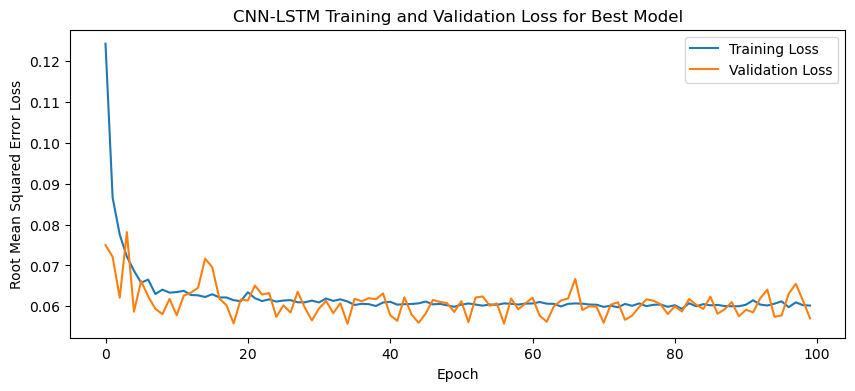

1/1 - 1s - loss: 0.0613 - 1s/epoch - 1s/step
Test Loss: 0.06125115230679512
1/1 [==============================] - 0s 33ms/step


NameError: name 'series' is not defined

In [3]:
n_batch = 1
nb_epoch = 100

def rmse (y_true, y_pred):
    return K.sqrt(K.mean(K.square(y_pred - y_true)))

def mape (y_true, y_pred):
    return 100*K.mean(K.sqrt(K.square(y_true - y_pred))/y_true)
    
def pearson (y_true, y_pred):
    return (K.square(K.mean((y_true - K.mean(y_true))*(y_pred - K.mean(y_pred)))))/(K.mean(K.square(y_true - K.mean(y_true)))*K.mean(K.square(y_pred - K.mean(y_pred))))
 
# fit an LSTM network to training data
#Adapted from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def create_model(trial, X, y, n_lag, n_seq, n_batch, nb_epoch):
    
    #Parameters:
    #trial (array-like): Optuna parameters.
    #train (array-like): Target values.
    #n_lag (int): Number of lag observations.
    #n_seq (int): Number of sequence observations
    #nb_epoch (int): Maximum number of epochs
    
    # Hyperparameters to be tuned by Optuna (taken from Javier Leon's dissertation 'Fruit Prices')
    lr = trial.suggest_float('lr', 1e-3, 1, log=True)
    optimizer_name = trial.suggest_categorical('optimizer', ['Adam', 'RMSprop', 'SGD'])
    if optimizer_name == 'Adam':
        optimizer = Adam(learning_rate=lr)
    elif optimizer_name == 'RMSprop':
        optimizer = RMSprop(learning_rate=lr)
    else:
        optimizer = SGD(learning_rate=lr)
    
    #Optuna will try either Rectified Linear Unit (ReLU) = max(0, x), tanh, or sigmoid functions
    activation_function = trial.suggest_categorical('activation_function', ['relu', 'tanh', 'sigmoid'])
    
    filters = trial.suggest_categorical('filters', [256, 512, 1024]) # Used for CNN-LSTM model
    lstm_units = trial.suggest_categorical('lstm_units', [256, 512, 1024])
    dropout_rate = trial.suggest_float('dropout_rate', 0.1, 0.5)

    # design network
    model = Sequential()
    model.add(Conv1D(filters=filters, kernel_size=1, activation='relu', input_shape=(X.shape[1], X.shape[2]))) # CNN-LSTM only
    model.add(MaxPooling1D(pool_size=1)) # CNN-LSTM Only
    model.add(Dropout(dropout_rate))
    model.add(LSTM(lstm_units, return_sequences=True))
    model.add(Dropout(dropout_rate))
    model.add(LSTM(lstm_units))
    model.add(Dropout(dropout_rate))
    model.add(Dense(256, input_dim=y.shape[1], activation=activation_function))
    model.add(Dense(128, activation=activation_function))
    model.add(Dense(n_seq))
    model.compile(loss=rmse, optimizer=optimizer)
        
    return model

# make forecast with the CNN-LSTM best model
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def forecast_lstm(model, X, n_seq, n_test):
    # reshape input pattern to [samples, timesteps, features]
    X = X.reshape(1, 1, X.shape[1])
    # make forecast
    forecast = model.predict(X)
    # convert to array
    return forecast
     
# evaluate the persistence model
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def make_forecasts(model, X_test, y_test, n_lag, n_seq, n_test):
    forecasts = list()
    for i in range(len(X_test)):
        X, y = X_test[i, :], y_test[i, :]
        # make forecast
        forecast = forecast_lstm(model, X, n_seq, n_test)
        # store the forecast
        forecasts.append(forecast)
    return forecasts
     
# invert differenced forecast
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def inverse_difference(last_ob, forecast):
    # invert first forecast
    inverted = list()
    inverted.append(forecast[0] + last_ob)
    # propagate difference forecast using inverted first value
    for i in range(1, len(forecast)):
        inverted.append(forecast[i] + inverted[i-1])
    return inverted
     
# inverse data transform on forecasts
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def inverse_transform(series, forecasts, scaler, n_test, n_seq):
    inverted = list()
    for i in range(len(forecasts)):
        # create array from forecast
        forecast = forecasts[i]
        forecast = forecast.reshape(1, n_seq)
        # invert scaling
        inv_scale = scaler.inverse_transform(forecast)
        inv_scale = inv_scale[0, :]
        # invert differencing
        index = len(series) - n_test + i - 1
        last_ob = series.values[index]
        inv_diff = inverse_difference(last_ob, inv_scale)
        # store
        inverted.append(inv_diff)
    return inverted
     
# evaluate the RMSE for each forecast time step
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def evaluate_forecasts(test, forecasts, n_lag, n_seq):
    rmse_list = []
    mae_list = []
    mape_list = []
    r2_list = []
    for i in range(n_seq):
        actual = [row[i] for row in test]
        predicted = [forecast[i] for forecast in forecasts]
        rmse = sqrt(mean_squared_error(actual, predicted))
        mae = mean_absolute_error(actual, predicted)
        mse = mean_squared_error(actual, predicted)
        mape = mean_absolute_percentage_error(actual, predicted)
        r2 = r2_score(actual, predicted) 
        rmse_list.append(rmse)
        mae_list.append(mae)
        mape_list.append(mape)
        r2_list.append(r2)
        print("Month at t+"+str(i+1)+":")
        print('t+%d RMSE: %f' % ((i+1), rmse))
        print('t+%d MAE: %f' % ((i+1), mae))
        print('t+%d MAPE: %f' % ((i+1), mape))
        print('t+%d R2_SCORE: %f' % ((i+1), r2))

    return rmse_list, mae_list, mape_list, r2_list
     
# plot the forecasts in the context of the original dataset
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def plot_forecasts(series, forecasts, n_test):
    # plot the entire dataset in blue
    plt.plot(series.values)
    # plot the forecasts in red
    for i in range(len(forecasts)):
        off_s = len(series) - n_test + i - 1
        off_e = off_s + len(forecasts[i]) + 1
        xaxis = [x for x in range(off_s, off_e)]
        yaxis = [series.values[off_s]] + forecasts[i]
        plt.plot(xaxis, yaxis, color='red')
    # show the plot
    plt.show()
    
def objective(trial):
    
    cv_accuracies = []
        
    for i in range(5):
        train1 = train[i]
        test1 = test[i]
        validation1 = validation[i]

        X, y = train1[:, 0:-n_seq], train1[:, -n_seq:]
        X_test, y_test = test1[:, 0:-n_seq], test1[:, -n_seq:]
        X_val, y_val = validation1[:, 0:-n_seq], validation1[:, -n_seq:]
        X = X.reshape(X.shape[0], 1, X.shape[1])
        X_test = X_test.reshape(X_test.shape[0], 1, X_test.shape[1])
        X_val = X_val.reshape(X_val.shape[0], 1, X_val.shape[1])
    
        model = create_model(trial, X, y, n_lag, n_seq, n_batch, nb_epoch)

        history = model.fit(X, y, validation_data=(X_val, y_val), epochs=nb_epoch, verbose=0)

        cv_accuracy = model.evaluate(X_test, y_test, verbose=0)
    
        loss = history.history['val_loss'][-1]
    
        # Plotting the training and validation loss
        #plt.figure(figsize=(10, 4))
        #plt.plot(history.history['loss'], label='Training Loss')
        #plt.plot(history.history['val_loss'], label='Validation Loss')
        #title1 = "CNN-LSTM Training and Validation Loss for Fold " + str(i+1)
        #plt.title(title1)
        #plt.xlabel('Epoch')
        #plt.ylabel('Root Mean Squared Error Loss')
        #plt.legend()
        #plt.show()
            
        cv_accuracies.append(cv_accuracy)
    
    print("Cross Validation Accuracies:")
    print(cv_accuracies)
    print("Mean Cross Validation Accuracy:")
    print(np.mean(cv_accuracies))
    print("Standard Deviation of Cross Validation Accuracy:")
    print(np.std(cv_accuracies))
        
    return np.mean(cv_accuracies)

n_batch = 1
nb_epoch = 100

# optimize and fit model
study = optuna.create_study(direction='minimize')
study.optimize(objective, n_trials=100)
print('Number of finished trials:', len(study.trials))

print('Best trial:', study.best_trial.params)
best_params = study.best_params
print("Best hyperparameters: ", best_params)

for i in range(5):
    print("Fold "+str(i+1)+":")
    train1 = train[i]
    test1 = test[i]
    validation1 = validation[i]

    X, y = train1[:, 0:-n_seq], train1[:, -n_seq:]
    X_test, y_test = test1[:, 0:-n_seq], test1[:, -n_seq:]
    X_val, y_val = validation1[:, 0:-n_seq], validation1[:, -n_seq:]
    X = X.reshape(X.shape[0], 1, X.shape[1])
    X_test = X_test.reshape(X_test.shape[0], 1, X_test.shape[1])
    X_val = X_val.reshape(X_val.shape[0], 1, X_val.shape[1])

    best_model = create_model(optuna.trial.FixedTrial(best_params), X, y, n_lag, n_seq, n_batch, nb_epoch)
    history = best_model.fit(X, y, epochs=100, batch_size=n_batch, validation_data=(X_val, y_val))

    # Plotting the training and validation loss
    plt.figure(figsize=(10, 4))
    plt.plot(history.history['loss'], label='Training Loss')
    plt.plot(history.history['val_loss'], label='Validation Loss')
    title1 = "CNN-LSTM Training and Validation Loss for Best Model"
    plt.title(title1)
    plt.xlabel('Epoch')
    plt.ylabel('Root Mean Squared Error Loss')
    plt.legend()
    plt.show()

    # Evaluate the model
    loss = best_model.evaluate(X_test, y_test, verbose=2)
    print(f'Test Loss: {loss}')

    # make forecasts
    forecasts = make_forecasts(best_model, X_test, y_test, n_lag, n_seq, n_test)
    
    # inverse transform forecasts and test
    forecasts = inverse_transform(series, forecasts, scaler[i], n_test+2, n_seq)
    actual = [row[-n_seq:] for row in test1]
    actual = inverse_transform(series, actual, scaler[i], n_test+2, n_seq)

    rmse_list = [] # list stores root mean squared errors for each future time prediction
    mae_list = [] # list stores root mean squared errors for each future time prediction
    mape_list = [] # list stores root mean squared errors for each future time prediction
    r2_list = [] # list stores root mean squared errors for each future time prediction
    
    # evaluate forecasts
    rmse_list, mae_list, mape_list, r2_list = evaluate_forecasts(actual, forecasts, n_lag, n_seq)

    for j in range(len(X_test)):
        print("Weather Station "+str(j+1)+":")
        dataset_df = pd.DataFrame(y_test[j].flatten())
        dataset = dataset_df.values
        dataset = dataset[:, 0]
        dataset = np.array(dataset).reshape(-1, 1)
        dataset = dataset.flatten()
        dataset = pd.DataFrame(dataset)
        series = scaler[i].inverse_transform(dataset)
        series = pd.Series(series.flatten())

    # plot forecasts
    plot_forecasts(series, forecasts, 1)
    
    best_model.summary()

    # Print out table of actual and predicted values for each weather station
    for j in range(11):
        print("Weather Station "+str(j+1)+":")
        print("Actual Specific Humidity\tPredicted Specific Humidity\tDifference")
        print("-----------\t--------------\t----------")
        for k in range(n_seq):
            diff = forecasts[j][k] - actual[j][k]
            print(f"{actual[j][k]:.2f}\t\t{forecasts[j][k]:.2f}\t\t{diff:.2f}")

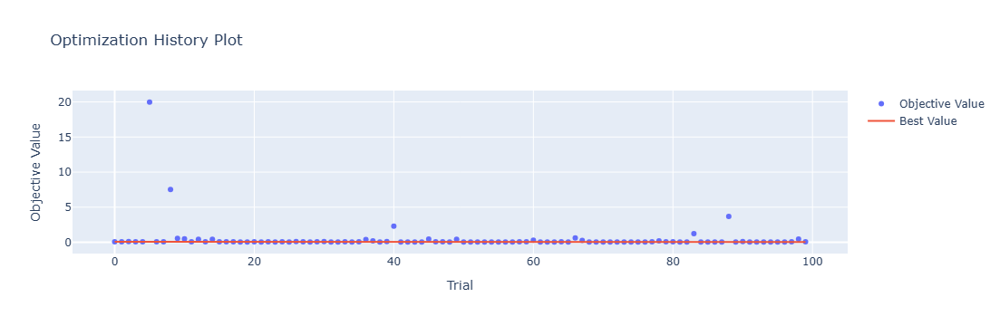

In [4]:
optuna.visualization.plot_optimization_history(study)

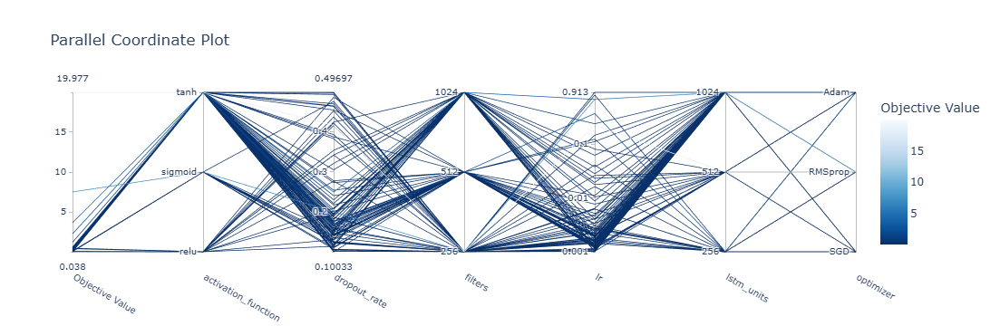

In [5]:
optuna.visualization.plot_parallel_coordinate(study)

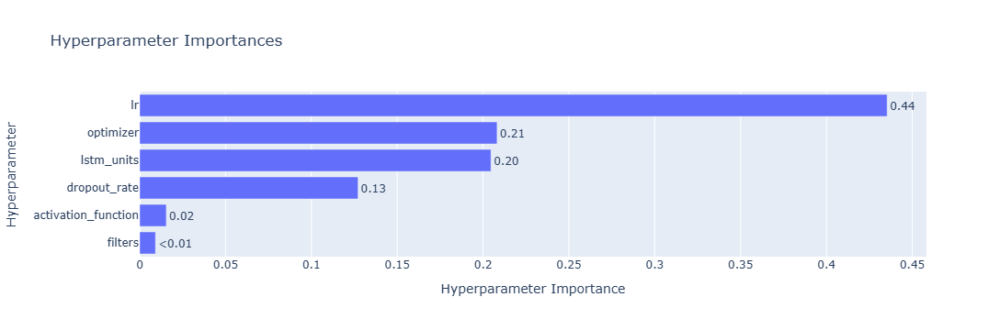

In [6]:
optuna.visualization.plot_param_importances(study)

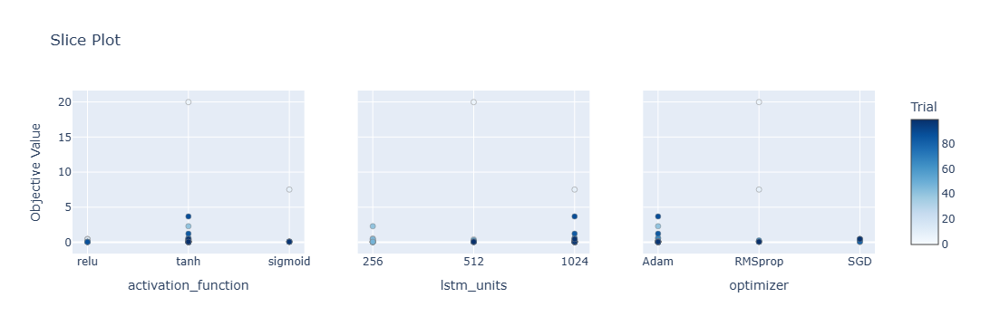

In [7]:
optuna.visualization.plot_slice(study, params=['optimizer', 'activation_function', 'lstm_units'])

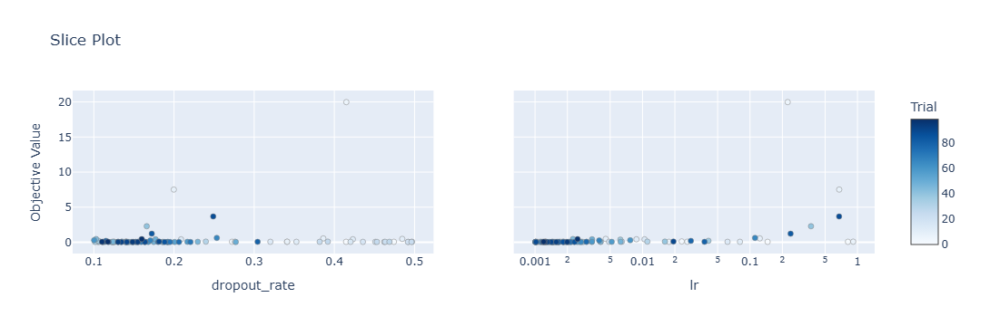

In [8]:
optuna.visualization.plot_slice(study, params=['lr', 'dropout_rate'])

[[ 5.39  4.3   6.51 ... 13.73  8.35  9.05]
 [ 8.03  6.78  8.21 ... 17.14 11.74 12.27]
 [ 5.48  4.27  5.49 ... 13.3   9.17  8.6 ]
 ...
 [ 4.55  3.1   4.22 ... 12.8   7.91  6.65]
 [ 4.44  3.4   5.39 ... 12.34  7.74  6.78]
 [ 4.14  2.75  4.12 ... 10.6   7.07  6.41]]
Epoch 1/100
84/84 [==============================] - 29s 137ms/step - loss: 0.1203 - accuracy: 0.2143 - mae: 0.0998 - rmse: 0.1203 - mape: 21.6711 - pearson: 0.6062 - val_loss: 0.0854 - val_accuracy: 0.7000 - val_mae: 0.0686 - val_rmse: 0.0854 - val_mape: 14.9334 - val_pearson: 0.7010
Epoch 2/100
84/84 [==============================] - 8s 92ms/step - loss: 0.0837 - accuracy: 0.3690 - mae: 0.0673 - rmse: 0.0837 - mape: 14.7511 - pearson: 0.7288 - val_loss: 0.0722 - val_accuracy: 0.0000e+00 - val_mae: 0.0589 - val_rmse: 0.0722 - val_mape: 12.8259 - val_pearson: 0.7028
Epoch 3/100
84/84 [==============================] - 6s 71ms/step - loss: 0.0795 - accuracy: 0.4167 - mae: 0.0638 - rmse: 0.0795 - mape: 13.9840 - pearson: 0.7485

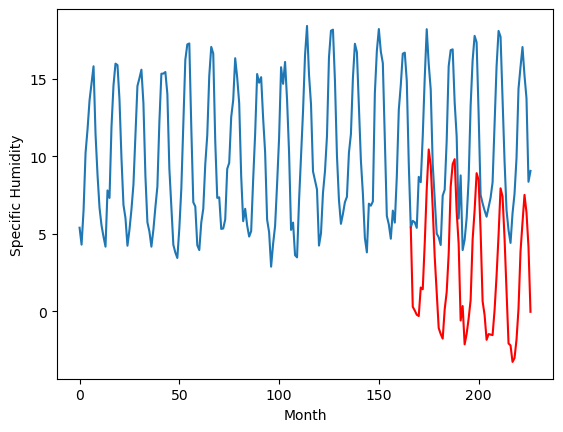

Weather Station 2:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
-0.86		1.55		2.41
-0.53		1.31		1.84
-0.97		1.03		2.00
-0.24		0.95		1.19
3.64		2.79		-0.85
1.85		2.67		0.82
4.17		5.64		1.47
7.85		9.12		1.27
9.51		11.68		2.17
9.45		10.64		1.19
7.35		7.89		0.54
4.79		4.76		-0.03
1.46		2.47		1.01
-2.06		0.18		2.24
-1.71		-0.21		1.50
-1.00		-0.51		0.49
1.21		1.38		0.17
1.43		2.50		1.07
3.92		4.95		1.03
8.67		9.29		0.62
9.47		10.74		1.27
9.63		11.06		1.43
7.47		7.69		0.22
4.39		5.60		1.21
-1.27		0.66		1.93
2.37		1.59		-0.78
-2.39		-0.87		1.52
-1.17		-0.20		0.97
0.74		0.78		0.04
2.04		1.98		-0.06
6.28		5.87		-0.41
8.89		7.76		-1.13
9.79		10.15		0.36
9.22		9.72		0.50
6.16		6.41		0.25
1.02		1.91		0.89
0.82		1.02		0.20
-0.38		-0.58		-0.20
-0.29		-0.21		0.08
1.40		-0.24		-1.64
1.78		-0.28		-2.06
2.57		1.32		-1.25
4.76		3.54		-1.22
8.09		6.17		-1.92
9.76		9.18		-0.58
10.54		8.65		-1.89
6.52		5.97		-0.55
1.82		2.55		0.73
-0.36		-0.82		-0.46
-1.80		-0.94		0.86
-2.58		-2

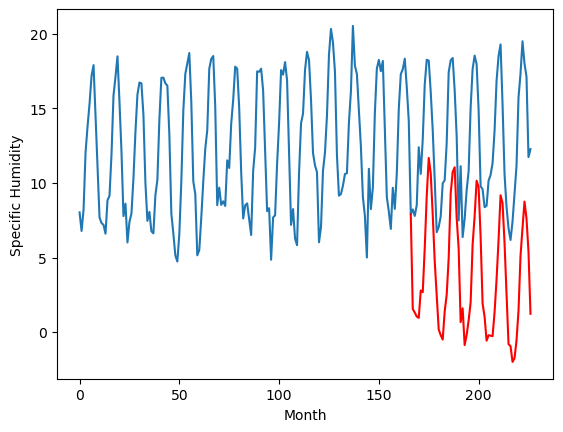

Weather Station 3:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
2.23		4.19		1.96
2.48		3.95		1.47
2.31		3.67		1.36
2.86		3.59		0.73
5.46		5.43		-0.03
4.21		5.31		1.10
7.07		8.28		1.21
10.98		11.76		0.78
13.38		14.32		0.94
13.47		13.28		-0.19
10.38		10.53		0.15
7.63		7.40		-0.23
4.30		5.11		0.81
1.14		2.82		1.68
1.52		2.43		0.91
1.67		2.13		0.46
3.52		4.02		0.50
3.76		5.14		1.38
6.52		7.59		1.07
11.14		11.93		0.79
13.05		13.38		0.33
13.25		13.70		0.45
10.25		10.33		0.08
7.53		8.24		0.71
1.66		3.30		1.64
4.06		4.23		0.17
0.65		1.77		1.12
1.86		2.44		0.58
2.57		3.42		0.85
4.02		4.62		0.60
8.16		8.51		0.35
10.94		10.40		-0.54
13.14		12.79		-0.35
12.44		12.36		-0.08
8.71		9.05		0.34
3.71		4.55		0.84
3.39		3.66		0.27
2.06		2.06		-0.00
2.43		2.43		-0.00
3.54		2.40		-1.14
2.90		2.36		-0.54
4.34		3.96		-0.38
7.12		6.18		-0.94
9.70		8.81		-0.89
12.56		11.82		-0.74
12.65		11.29		-1.36
9.07		8.61		-0.46
5.16		5.19		0.03
2.63		1.82		-0.81
1.82		1.70		-0.12
1.02		0.63	

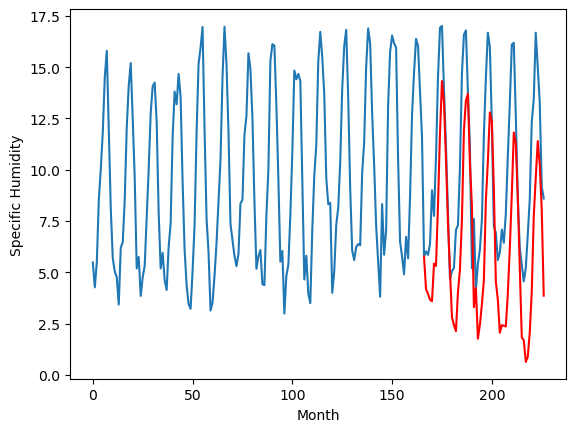

Weather Station 4:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
-0.48		1.64		2.12
0.06		1.40		1.34
0.30		1.12		0.82
0.44		1.04		0.60
4.75		2.88		-1.87
3.60		2.76		-0.84
5.75		5.73		-0.02
8.24		9.21		0.97
10.99		11.77		0.78
9.74		10.73		0.99
8.39		7.98		-0.41
4.58		4.85		0.27
1.53		2.56		1.03
-1.54		0.27		1.81
-1.47		-0.12		1.35
-1.56		-0.42		1.14
1.89		1.47		-0.42
2.46		2.59		0.13
5.97		5.04		-0.93
9.87		9.38		-0.49
10.71		10.83		0.12
10.33		11.15		0.82
8.02		7.78		-0.24
5.59		5.69		0.10
-0.62		0.75		1.37
2.43		1.68		-0.75
-2.69		-0.78		1.91
-1.48		-0.11		1.37
-0.39		0.87		1.26
2.53		2.07		-0.46
6.77		5.96		-0.81
8.78		7.85		-0.93
9.99		10.24		0.25
9.27		9.81		0.54
5.89		6.50		0.61
0.79		2.00		1.21
0.27		1.11		0.84
-0.23		-0.49		-0.26
-0.04		-0.12		-0.08
0.63		-0.15		-0.78
1.71		-0.19		-1.90
2.11		1.41		-0.70
4.96		3.63		-1.33
9.11		6.26		-2.85
10.14		9.27		-0.87
9.89		8.74		-1.15
7.71		6.06		-1.65
3.14		2.64		-0.50
0.15		-0.73		-0.88
-1.25		-0.85		0.40
-

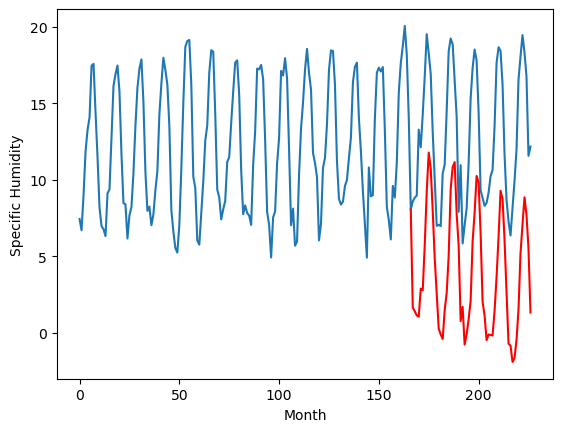

Weather Station 5:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
4.29		3.59		-0.70
3.04		3.35		0.31
3.83		3.07		-0.76
3.22		2.99		-0.23
7.67		4.83		-2.84
7.39		4.71		-2.68
9.97		7.68		-2.29
12.33		11.16		-1.17
15.19		13.72		-1.47
12.92		12.68		-0.24
11.61		9.93		-1.68
7.33		6.80		-0.53
5.48		4.51		-0.97
2.70		2.22		-0.48
2.63		1.83		-0.80
2.23		1.53		-0.70
5.07		3.42		-1.65
6.47		4.54		-1.93
10.48		6.99		-3.49
14.17		11.33		-2.84
14.88		12.78		-2.10
14.80		13.10		-1.70
10.57		9.73		-0.84
8.48		7.64		-0.84
4.26		2.70		-1.56
7.02		3.63		-3.39
1.52		1.17		-0.35
1.78		1.84		0.06
3.33		2.82		-0.51
7.25		4.02		-3.23
10.95		7.91		-3.04
11.92		9.80		-2.12
11.68		12.19		0.51
12.77		11.76		-1.01
9.94		8.45		-1.49
5.14		3.95		-1.19
5.13		3.06		-2.07
4.05		1.46		-2.59
3.29		1.83		-1.46
3.63		1.80		-1.83
5.82		1.76		-4.06
6.58		3.36		-3.22
10.52		5.58		-4.94
14.64		8.21		-6.43
13.22		11.22		-2.00
11.40		10.69		-0.71
11.36		8.01		-3.35
7.61		4.59		-3.02
4.81		1.22		-3.5

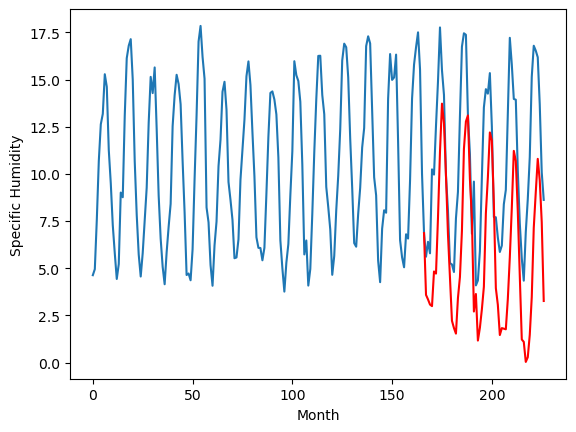

Weather Station 6:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
-0.81		0.79		1.60
-0.85		0.55		1.40
-1.33		0.27		1.60
-1.44		0.19		1.63
0.32		2.03		1.71
0.66		1.91		1.25
3.79		4.88		1.09
7.52		8.36		0.84
11.00		10.92		-0.08
11.03		9.88		-1.15
8.13		7.13		-1.00
4.43		4.00		-0.43
1.48		1.71		0.23
-2.28		-0.58		1.70
-2.89		-0.97		1.92
-2.30		-1.27		1.03
-0.73		0.62		1.35
0.28		1.74		1.46
2.78		4.19		1.41
8.04		8.53		0.49
9.16		9.98		0.82
10.32		10.30		-0.02
6.23		6.93		0.70
3.91		4.84		0.93
-1.35		-0.10		1.25
0.07		0.83		0.76
-3.04		-1.63		1.41
-1.66		-0.96		0.70
-0.33		0.02		0.35
0.80		1.22		0.42
5.58		5.11		-0.47
6.67		7.00		0.33
11.00		9.39		-1.61
9.21		8.96		-0.25
6.51		5.65		-0.86
1.87		1.15		-0.72
1.21		0.26		-0.95
-2.14		-1.34		0.80
-1.39		-0.97		0.42
-0.46		-1.00		-0.54
-0.68		-1.04		-0.36
2.00		0.56		-1.44
2.76		2.78		0.02
6.66		5.41		-1.25
11.01		8.42		-2.59
10.12		7.89		-2.23
7.00		5.21		-1.79
2.60		1.79		-0.81
-0.42		-1.58		-1.16
-1.24		-1.70		-0

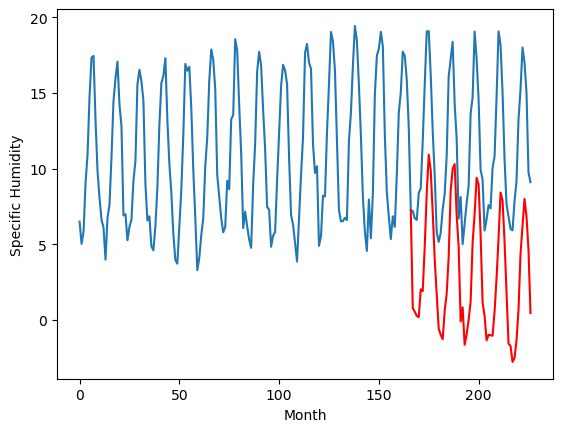

Weather Station 7:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
1.38		2.66		1.28
1.50		2.42		0.92
1.42		2.14		0.72
1.78		2.06		0.28
3.41		3.90		0.49
3.19		3.78		0.59
6.29		6.75		0.46
10.01		10.23		0.22
12.80		12.79		-0.01
12.74		11.75		-0.99
9.21		9.00		-0.21
6.49		5.87		-0.62
3.64		3.58		-0.06
0.77		1.29		0.52
0.62		0.90		0.28
0.67		0.60		-0.07
2.26		2.49		0.23
2.86		3.61		0.75
5.86		6.06		0.20
10.24		10.40		0.16
11.68		11.85		0.17
12.21		12.17		-0.04
8.89		8.80		-0.09
6.78		6.71		-0.07
1.03		1.77		0.74
2.87		2.70		-0.17
0.09		0.24		0.15
1.37		0.91		-0.46
2.38		1.89		-0.49
3.38		3.09		-0.29
7.74		6.98		-0.76
9.62		8.87		-0.75
13.24		11.26		-1.98
11.89		10.83		-1.06
8.45		7.52		-0.93
3.89		3.02		-0.87
3.29		2.13		-1.16
1.11		0.53		-0.58
1.97		0.90		-1.07
2.65		0.87		-1.78
2.24		0.83		-1.41
4.45		2.43		-2.02
6.04		4.65		-1.39
8.77		7.28		-1.49
12.51		10.29		-2.22
12.14		9.76		-2.38
9.20		7.08		-2.12
4.94		3.66		-1.28
1.61		0.29		-1.32
1.54		0.17		-1.37
0.8

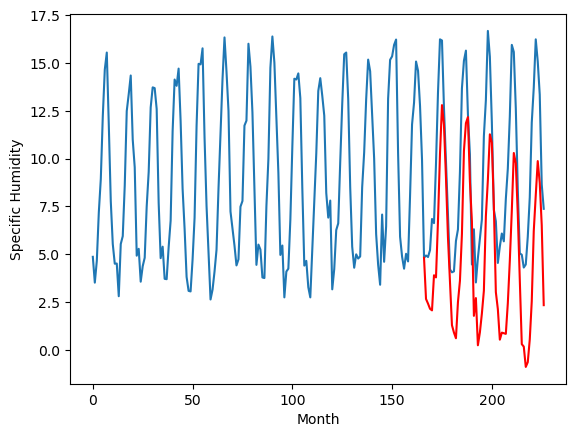

Weather Station 8:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
-0.05		1.02		1.07
0.20		0.78		0.58
0.23		0.50		0.27
0.45		0.42		-0.03
1.75		2.26		0.51
1.69		2.14		0.45
3.68		5.11		1.43
8.35		8.59		0.24
11.16		11.15		-0.01
11.40		10.11		-1.29
7.50		7.36		-0.14
4.79		4.23		-0.56
2.25		1.94		-0.31
-0.62		-0.35		0.27
-0.93		-0.74		0.19
-0.90		-1.04		-0.14
0.72		0.85		0.13
1.42		1.97		0.55
4.44		4.42		-0.02
8.71		8.76		0.05
10.21		10.21		-0.00
10.49		10.53		0.04
7.00		7.16		0.16
5.12		5.07		-0.05
-0.67		0.13		0.80
1.10		1.06		-0.04
-1.41		-1.40		0.01
-0.18		-0.73		-0.55
0.81		0.25		-0.56
1.71		1.45		-0.26
6.00		5.34		-0.66
7.45		7.23		-0.22
10.82		9.62		-1.20
9.75		9.19		-0.56
6.96		5.88		-1.08
2.54		1.38		-1.16
1.84		0.49		-1.35
-0.50		-1.11		-0.61
0.43		-0.74		-1.17
0.79		-0.77		-1.56
0.71		-0.81		-1.52
2.99		0.79		-2.20
4.31		3.01		-1.30
6.93		5.64		-1.29
11.28		8.65		-2.63
10.22		8.12		-2.10
7.42		5.44		-1.98
3.67		2.02		-1.65
0.15		-1.35		-1.50
0.35		-1.4

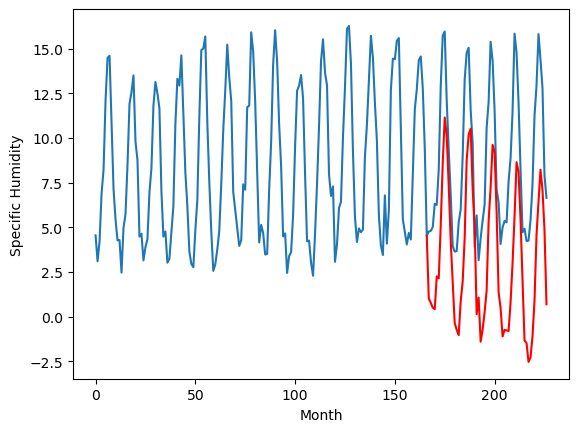

Weather Station 9:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
1.27		0.71		-0.56
1.36		0.47		-0.89
0.96		0.19		-0.77
0.95		0.11		-0.84
3.21		1.95		-1.26
3.45		1.83		-1.62
6.67		4.80		-1.87
10.32		8.28		-2.04
13.41		10.84		-2.57
11.38		9.80		-1.58
8.66		7.05		-1.61
4.21		3.92		-0.29
2.45		1.63		-0.82
0.54		-0.66		-1.20
0.31		-1.05		-1.36
-0.37		-1.35		-0.98
2.69		0.54		-2.15
3.42		1.66		-1.76
6.33		4.11		-2.22
11.31		8.45		-2.86
12.81		9.90		-2.91
13.00		10.22		-2.78
9.19		6.85		-2.34
6.77		4.76		-2.01
1.48		-0.18		-1.66
3.07		0.75		-2.32
-0.21		-1.71		-1.50
0.38		-1.04		-1.42
2.06		-0.06		-2.12
3.64		1.14		-2.50
7.83		5.03		-2.80
10.01		6.92		-3.09
13.67		9.31		-4.36
12.70		8.88		-3.82
8.25		5.57		-2.68
3.02		1.07		-1.95
2.02		0.18		-1.84
1.09		-1.42		-2.51
1.69		-1.05		-2.74
1.76		-1.08		-2.84
2.20		-1.12		-3.32
3.42		0.48		-2.94
6.91		2.70		-4.21
9.19		5.33		-3.86
12.74		8.34		-4.40
12.74		7.81		-4.93
8.67		5.13		-3.54
4.61		1.71		-2.90
1.95		-1.66		-3

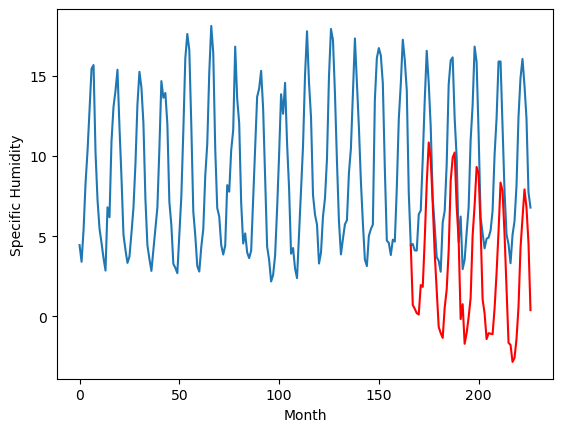

Weather Station 10:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
0.78		0.60		-0.18
1.19		0.36		-0.83
0.69		0.08		-0.61
0.37		0.00		-0.37
2.33		1.84		-0.49
2.39		1.72		-0.67
5.53		4.69		-0.84
8.22		8.17		-0.05
11.36		10.73		-0.63
10.14		9.69		-0.45
7.35		6.94		-0.41
4.01		3.81		-0.20
1.96		1.52		-0.44
0.30		-0.77		-1.07
-0.03		-1.16		-1.13
-0.48		-1.46		-0.98
1.32		0.43		-0.89
2.64		1.55		-1.09
4.73		4.00		-0.73
9.50		8.34		-1.16
10.43		9.79		-0.64
10.85		10.11		-0.74
7.68		6.74		-0.94
6.37		4.65		-1.72
0.85		-0.29		-1.14
1.69		0.64		-1.05
-0.60		-1.82		-1.22
0.14		-1.15		-1.29
1.42		-0.17		-1.59
3.04		1.03		-2.01
7.65		4.92		-2.73
9.33		6.81		-2.52
12.91		9.20		-3.71
11.37		8.77		-2.60
8.31		5.46		-2.85
2.52		0.96		-1.56
1.80		0.07		-1.73
0.87		-1.53		-2.40
1.48		-1.16		-2.64
1.25		-1.19		-2.44
1.35		-1.23		-2.58
3.08		0.37		-2.71
5.52		2.59		-2.93
8.14		5.22		-2.92
11.96		8.23		-3.73
10.66		7.70		-2.96
7.94		5.02		-2.92
4.70		1.60		-3.10
1.35		-1.77		-3.

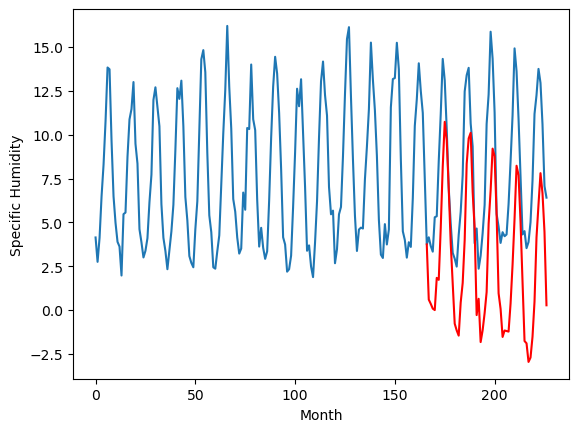

Weather Station 11:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
0.49		0.30		-0.19
0.61		0.06		-0.55
0.23		-0.22		-0.45
-0.28		-0.30		-0.02
1.32		1.54		0.22
1.68		1.42		-0.26
4.58		4.39		-0.19
7.68		7.87		0.19
10.73		10.43		-0.30
9.16		9.39		0.23
6.50		6.64		0.14
3.05		3.51		0.46
1.64		1.22		-0.42
0.11		-1.07		-1.18
-0.27		-1.46		-1.19
-1.01		-1.76		-0.75
0.61		0.13		-0.48
2.21		1.25		-0.96
3.73		3.70		-0.03
8.86		8.04		-0.82
9.93		9.49		-0.44
10.42		9.81		-0.61
6.80		6.44		-0.36
5.81		4.35		-1.46
0.96		-0.59		-1.55
0.96		0.34		-0.62
-1.11		-2.12		-1.01
-0.51		-1.45		-0.94
0.74		-0.47		-1.21
1.68		0.73		-0.95
5.40		4.62		-0.78
6.67		6.51		-0.16
9.16		8.90		-0.26
10.15		8.47		-1.68
7.55		5.16		-2.39
2.53		0.66		-1.87
1.39		-0.23		-1.62
0.22		-1.83		-2.05
0.62		-1.46		-2.08
0.06		-1.49		-1.55
0.52		-1.53		-2.05
2.16		0.07		-2.09
3.37		2.29		-1.08
6.38		4.92		-1.46
10.21		7.93		-2.28
9.46		7.40		-2.06
8.15		4.72		-3.43
4.39		1.30		-3.09
0.98		-2.07		-3.05
1.

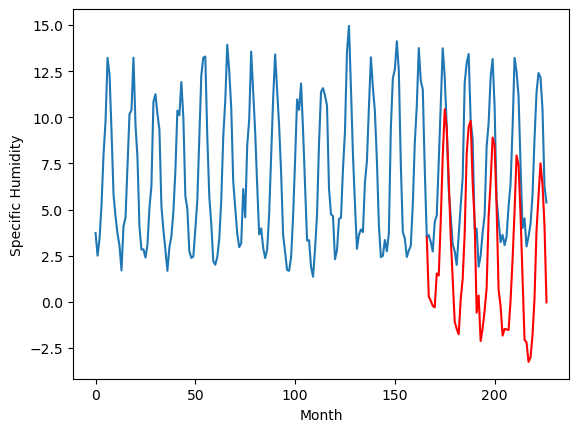

Predictions for (t+0):
    Weather_Station  Actual  Predicted
0                 0    0.03   0.296842
1                 1   -0.86   1.546842
2                 2    2.23   4.186842
3                 3   -0.48   1.636842
4                 4    4.29   3.586837
5                 5   -0.81   0.786843
6                 6    1.38   2.656842
7                 7   -0.05   1.016842
8                 8    1.27   0.706843
9                 9    0.78   0.596842
10               10    0.49   0.296838


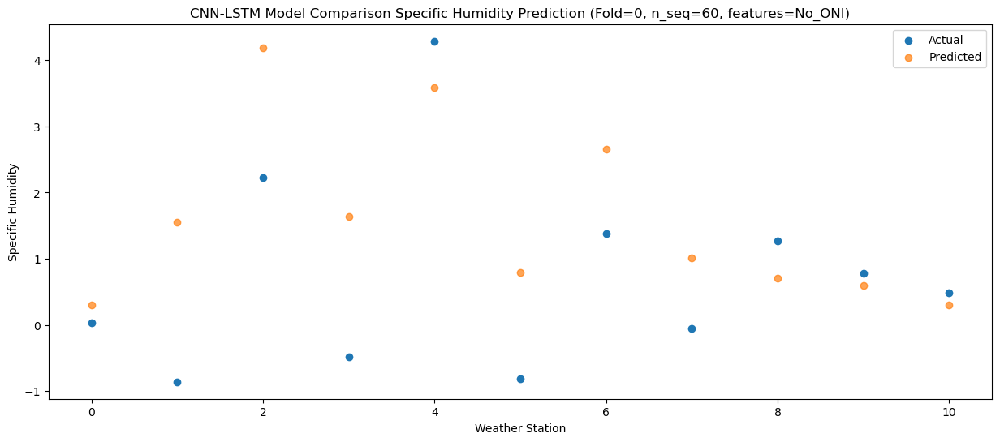

Predictions for (t+1):
    Weather_Station  Actual  Predicted
0                 0    0.46   0.055112
1                 1   -0.53   1.305102
2                 2    2.48   3.945115
3                 3    0.06   1.395108
4                 4    3.04   3.345069
5                 5   -0.85   0.545093
6                 6    1.50   2.415103
7                 7    0.20   0.775108
8                 8    1.36   0.465134
9                 9    1.19   0.355138
10               10    0.61   0.055106


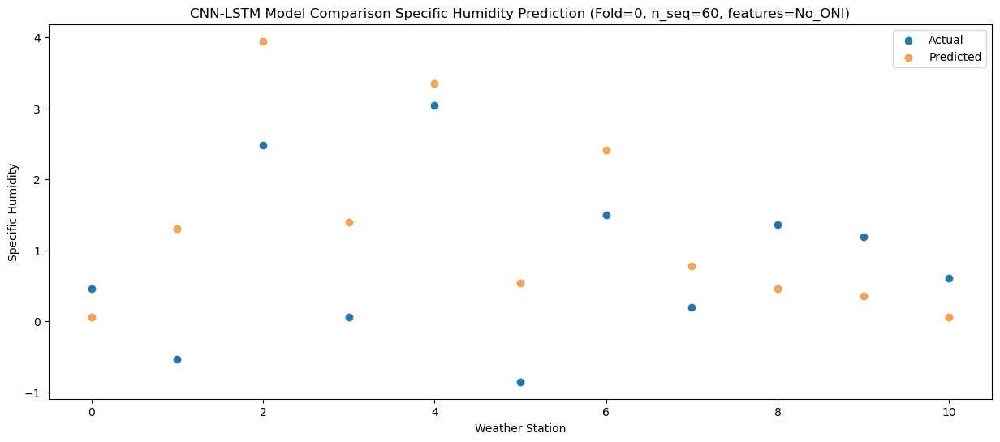

Predictions for (t+2):
    Weather_Station  Actual  Predicted
0                 0    0.37  -0.215869
1                 1   -0.97   1.034122
2                 2    2.31   3.674130
3                 3    0.30   1.124126
4                 4    3.83   3.074099
5                 5   -1.33   0.274111
6                 6    1.42   2.144120
7                 7    0.23   0.504124
8                 8    0.96   0.194146
9                 9    0.69   0.084148
10               10    0.23  -0.215875


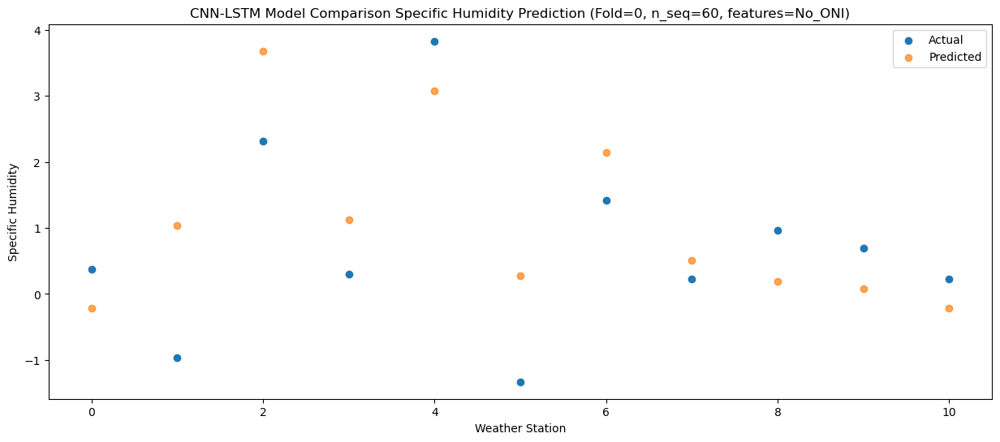

Predictions for (t+3):
    Weather_Station  Actual  Predicted
0                 0    0.01  -0.299233
1                 1   -0.24   0.950745
2                 2    2.86   3.590763
3                 3    0.44   1.040760
4                 4    3.22   2.990712
5                 5   -1.44   0.190723
6                 6    1.78   2.060740
7                 7    0.45   0.420750
8                 8    0.95   0.110796
9                 9    0.37   0.000800
10               10   -0.28  -0.299241


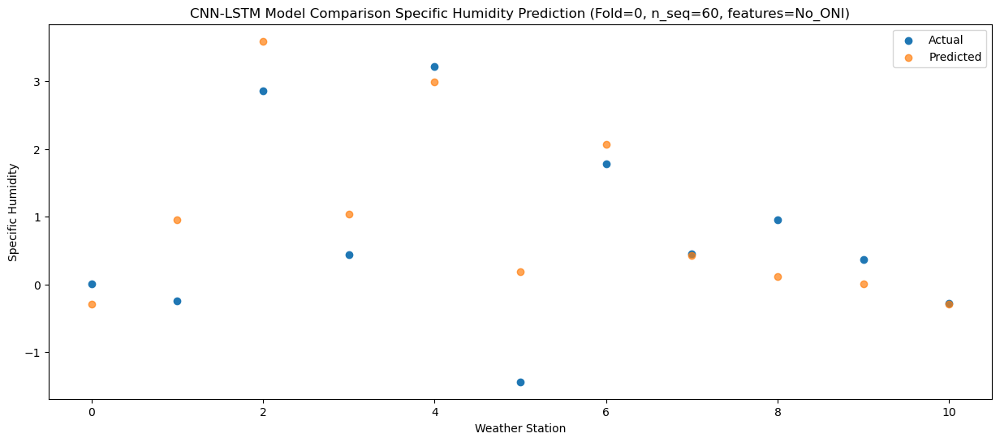

Predictions for (t+4):
    Weather_Station  Actual  Predicted
0                 0    3.30   1.536784
1                 1    3.64   2.786766
2                 2    5.46   5.426776
3                 3    4.75   2.876777
4                 4    7.67   4.826747
5                 5    0.32   2.026746
6                 6    3.41   3.896758
7                 7    1.75   2.256766
8                 8    3.21   1.946802
9                 9    2.33   1.836804
10               10    1.32   1.536773


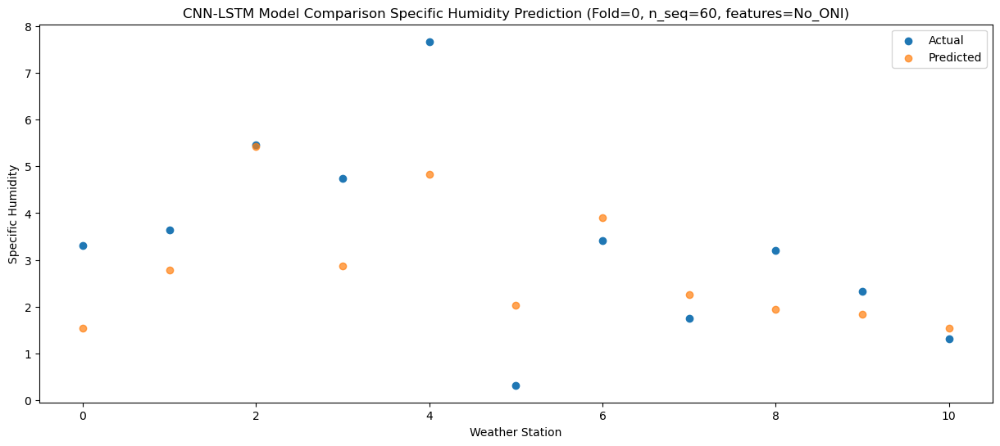

Predictions for (t+5):
    Weather_Station  Actual  Predicted
0                 0    2.95   1.424479
1                 1    1.85   2.674451
2                 2    4.21   5.314472
3                 3    3.60   2.764469
4                 4    7.39   4.714408
5                 5    0.66   1.914422
6                 6    3.19   3.784443
7                 7    1.69   2.144457
8                 8    3.45   1.834518
9                 9    2.39   1.724526
10               10    1.68   1.424470


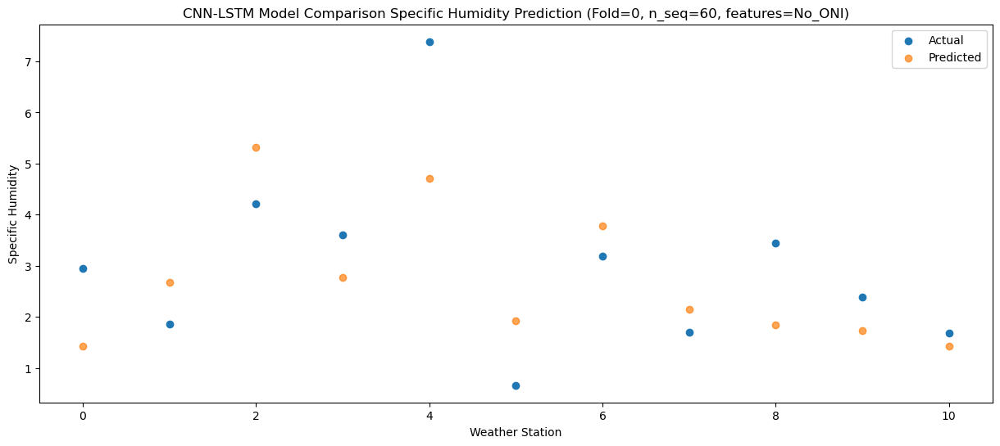

Predictions for (t+6):
    Weather_Station  Actual  Predicted
0                 0    5.92   4.385449
1                 1    4.17   5.635429
2                 2    7.07   8.275438
3                 3    5.75   5.725443
4                 4    9.97   7.675408
5                 5    3.79   4.875407
6                 6    6.29   6.745418
7                 7    3.68   5.105428
8                 8    6.67   4.795469
9                 9    5.53   4.685469
10               10    4.58   4.385437


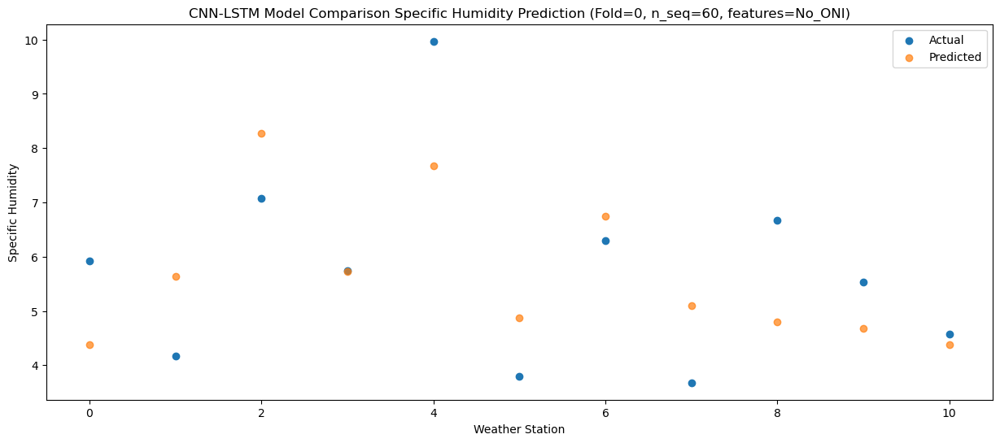

Predictions for (t+7):
    Weather_Station  Actual  Predicted
0                 0    9.68   7.874141
1                 1    7.85   9.124126
2                 2   10.98  11.764128
3                 3    8.24   9.214137
4                 4   12.33  11.164121
5                 5    7.52   8.364113
6                 6   10.01  10.234117
7                 7    8.35   8.594124
8                 8   10.32   8.284147
9                 9    8.22   8.174145
10               10    7.68   7.874125


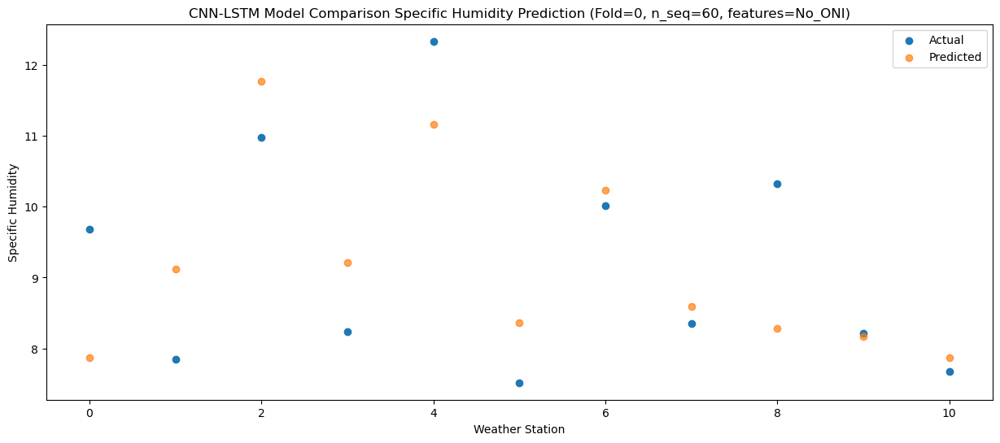

Predictions for (t+8):
    Weather_Station  Actual  Predicted
0                 0   12.81  10.431476
1                 1    9.51  11.681461
2                 2   13.38  14.321462
3                 3   10.99  11.771471
4                 4   15.19  13.721461
5                 5   11.00  10.921449
6                 6   12.80  12.791451
7                 7   11.16  11.151460
8                 8   13.41  10.841477
9                 9   11.36  10.731474
10               10   10.73  10.431458


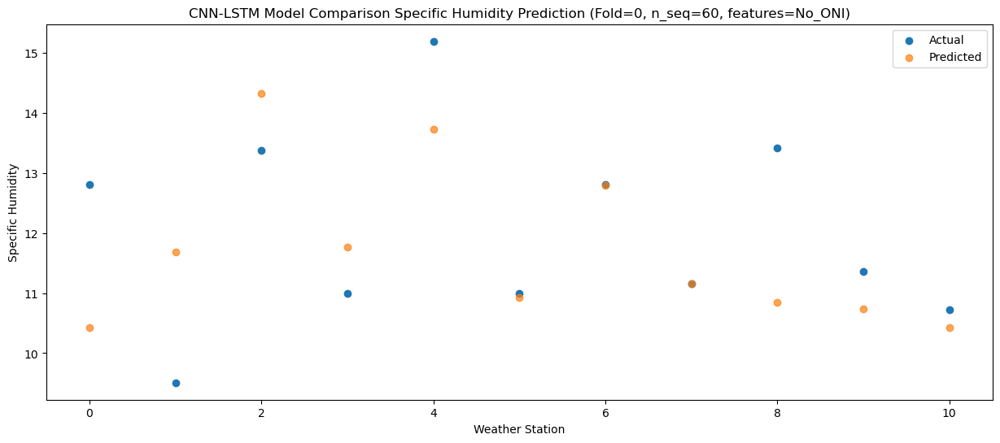

Predictions for (t+9):
    Weather_Station  Actual  Predicted
0                 0   10.56   9.388303
1                 1    9.45  10.638291
2                 2   13.47  13.278288
3                 3    9.74  10.728299
4                 4   12.92  12.678294
5                 5   11.03   9.878280
6                 6   12.74  11.748281
7                 7   11.40  10.108287
8                 8   11.38   9.798300
9                 9   10.14   9.688296
10               10    9.16   9.388285


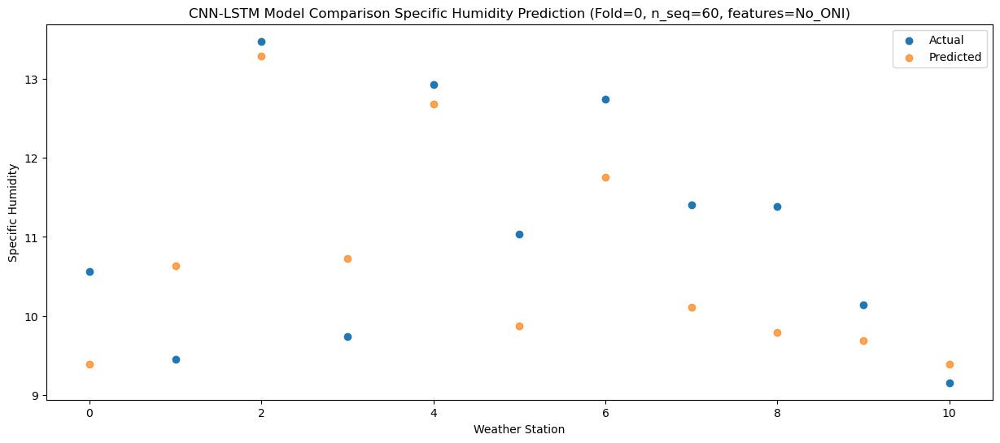

Predictions for (t+10):
    Weather_Station  Actual  Predicted
0                 0    8.92   6.637588
1                 1    7.35   7.887582
2                 2   10.38  10.527575
3                 3    8.39   7.977585
4                 4   11.61   9.927591
5                 5    8.13   7.127577
6                 6    9.21   8.997573
7                 7    7.50   7.357577
8                 8    8.66   7.047577
9                 9    7.35   6.937571
10               10    6.50   6.637569


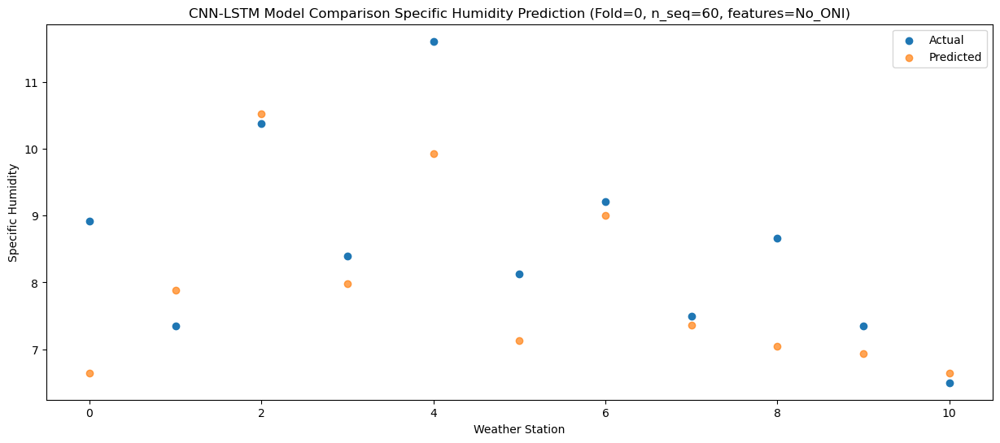

Predictions for (t+11):
    Weather_Station  Actual  Predicted
0                 0    4.11   3.512419
1                 1    4.79   4.762414
2                 2    7.63   7.402408
3                 3    4.58   4.852416
4                 4    7.33   6.802422
5                 5    4.43   4.002410
6                 6    6.49   5.872407
7                 7    4.79   4.232410
8                 8    4.21   3.922407
9                 9    4.01   3.812403
10               10    3.05   3.512400


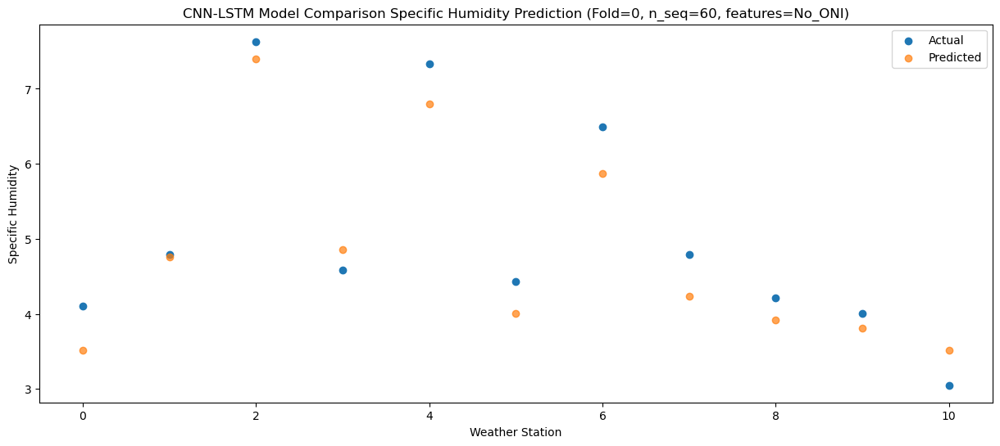

Predictions for (t+12):
    Weather_Station  Actual  Predicted
0                 0    1.87   1.215871
1                 1    1.46   2.465862
2                 2    4.30   5.105860
3                 3    1.53   2.555865
4                 4    5.48   4.505862
5                 5    1.48   1.705857
6                 6    3.64   3.575855
7                 7    2.25   1.935859
8                 8    2.45   1.625865
9                 9    1.96   1.515860
10               10    1.64   1.215853


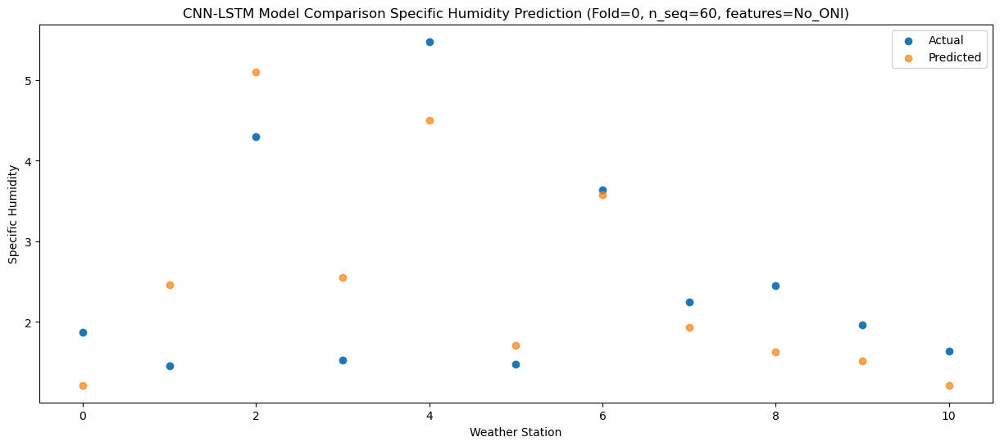

Predictions for (t+13):
    Weather_Station  Actual  Predicted
0                 0   -0.36  -1.074098
1                 1   -2.06   0.175896
2                 2    1.14   2.815890
3                 3   -1.54   0.265896
4                 4    2.70   2.215899
5                 5   -2.28  -0.584107
6                 6    0.77   1.285889
7                 7   -0.62  -0.354110
8                 8    0.54  -0.664108
9                 9    0.30  -0.774115
10               10    0.11  -1.074118


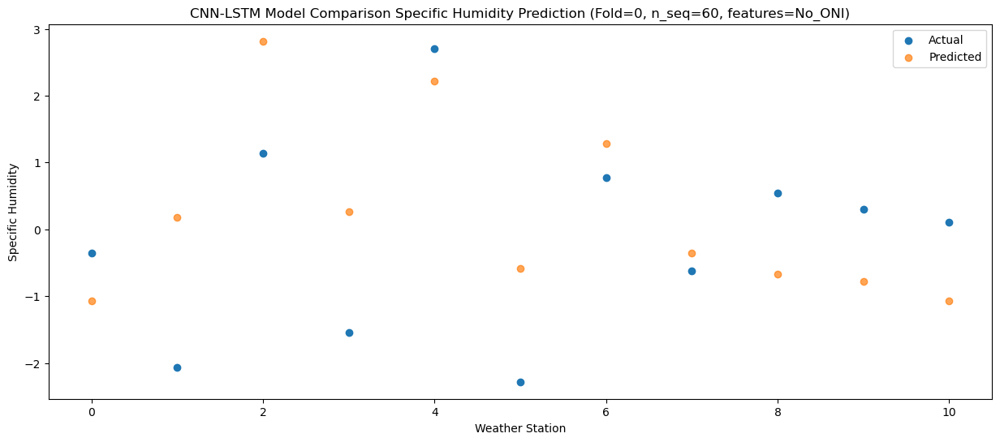

Predictions for (t+14):
    Weather_Station  Actual  Predicted
0                 0   -0.60  -1.459500
1                 1   -1.71  -0.209506
2                 2    1.52   2.430490
3                 3   -1.47  -0.119508
4                 4    2.63   1.830497
5                 5   -2.89  -0.969509
6                 6    0.62   0.900488
7                 7   -0.93  -0.739510
8                 8    0.31  -1.049510
9                 9   -0.03  -1.159516
10               10   -0.27  -1.459519


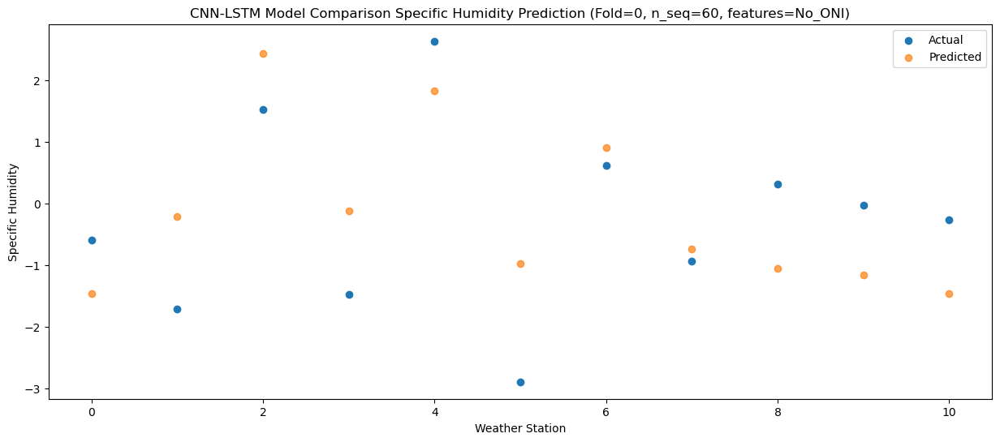

Predictions for (t+15):
    Weather_Station  Actual  Predicted
0                 0   -1.09  -1.756604
1                 1   -1.00  -0.506611
2                 2    1.67   2.133387
3                 3   -1.56  -0.416612
4                 4    2.23   1.533388
5                 5   -2.30  -1.266617
6                 6    0.67   0.603383
7                 7   -0.90  -1.036612
8                 8   -0.37  -1.346611
9                 9   -0.48  -1.456615
10               10   -1.01  -1.756620


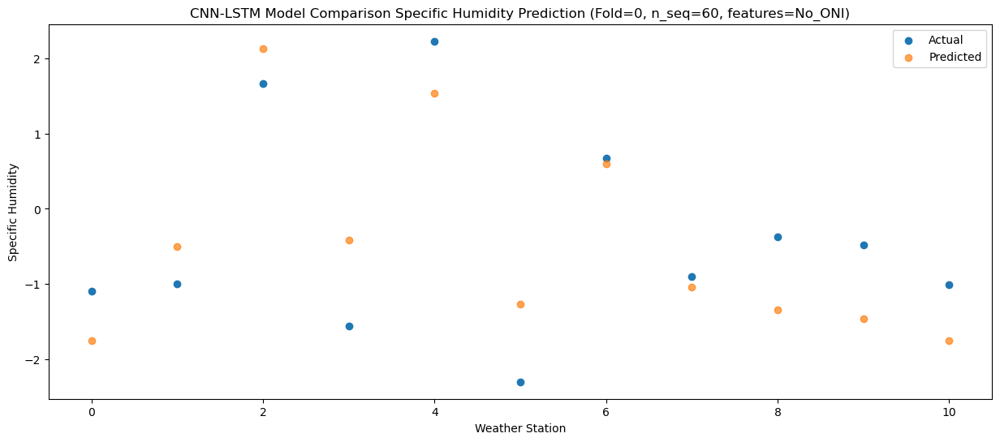

Predictions for (t+16):
    Weather_Station  Actual  Predicted
0                 0    2.08   0.129215
1                 1    1.21   1.379213
2                 2    3.52   4.019206
3                 3    1.89   1.469211
4                 4    5.07   3.419219
5                 5   -0.73   0.619210
6                 6    2.26   2.489207
7                 7    0.72   0.849208
8                 8    2.69   0.539200
9                 9    1.32   0.429195
10               10    0.61   0.129198


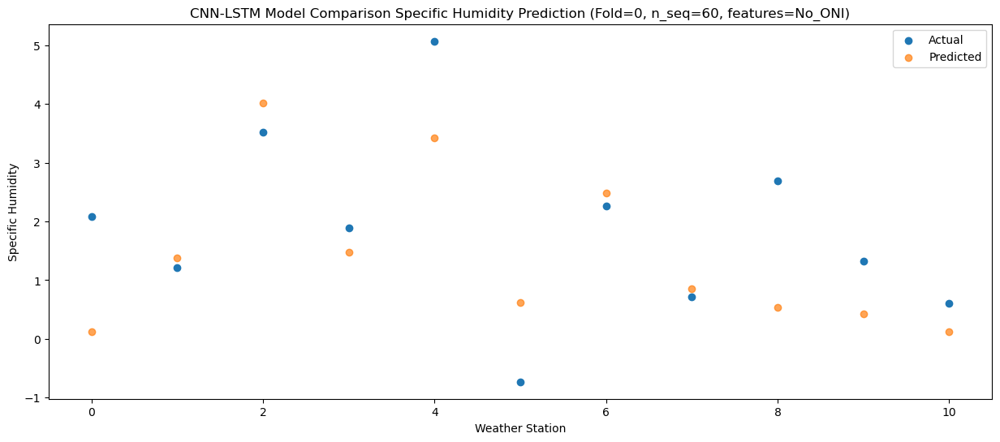

Predictions for (t+17):
    Weather_Station  Actual  Predicted
0                 0    2.47   1.245786
1                 1    1.43   2.495777
2                 2    3.76   5.135777
3                 3    2.46   2.585779
4                 4    6.47   4.535773
5                 5    0.28   1.735771
6                 6    2.86   3.605770
7                 7    1.42   1.965776
8                 8    3.42   1.655781
9                 9    2.64   1.545780
10               10    2.21   1.245769


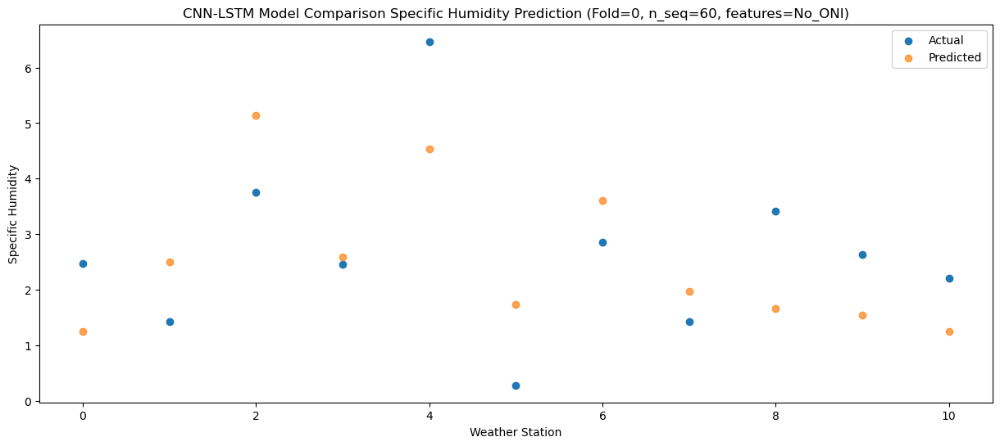

Predictions for (t+18):
    Weather_Station  Actual  Predicted
0                 0    5.62   3.695626
1                 1    3.92   4.945636
2                 2    6.52   7.585617
3                 3    5.97   5.035625
4                 4   10.48   6.985664
5                 5    2.78   4.185641
6                 6    5.86   6.055630
7                 7    4.44   4.415625
8                 8    6.33   4.105593
9                 9    4.73   3.995583
10               10    3.73   3.695605


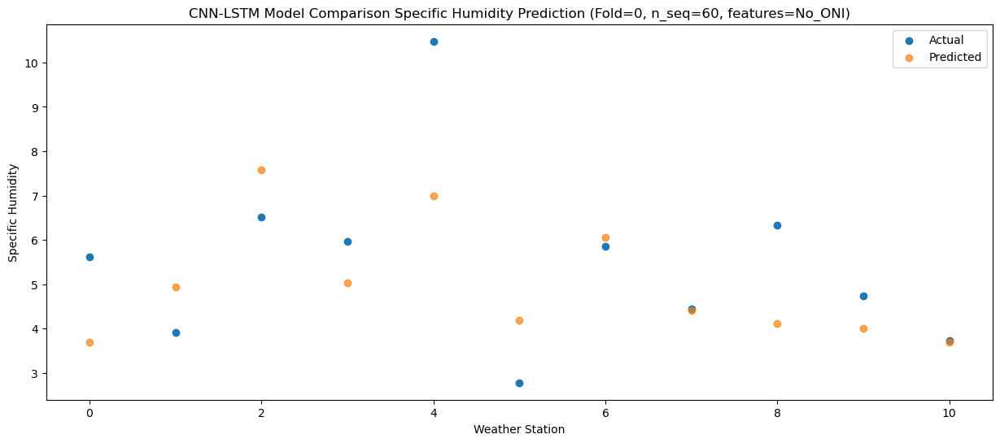

Predictions for (t+19):
    Weather_Station  Actual  Predicted
0                 0   10.43   8.035581
1                 1    8.67   9.285586
2                 2   11.14  11.925573
3                 3    9.87   9.375579
4                 4   14.17  11.325606
5                 5    8.04   8.525593
6                 6   10.24  10.395582
7                 7    8.71   8.755581
8                 8   11.31   8.445555
9                 9    9.50   8.335549
10               10    8.86   8.035559


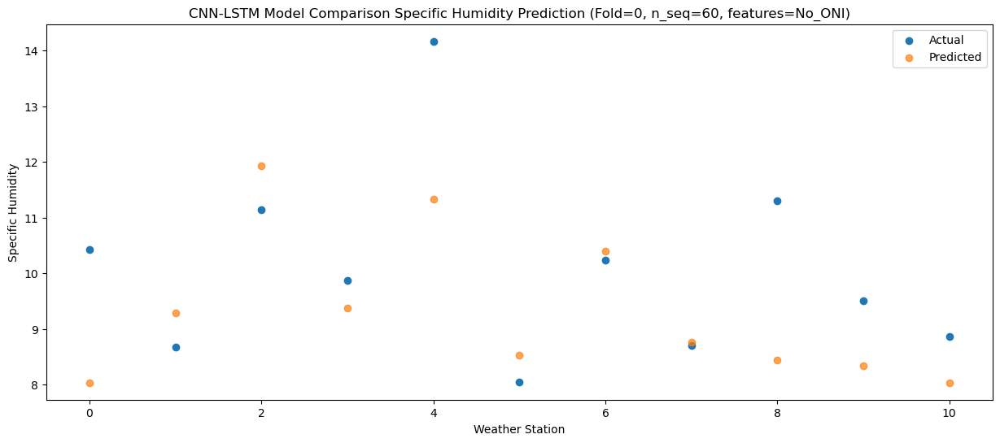

Predictions for (t+20):
    Weather_Station  Actual  Predicted
0                 0   11.46   9.485867
1                 1    9.47  10.735879
2                 2   13.05  13.375860
3                 3   10.71  10.825868
4                 4   14.88  12.775910
5                 5    9.16   9.975891
6                 6   11.68  11.845875
7                 7   10.21  10.205872
8                 8   12.81   9.895833
9                 9   10.43   9.785824
10               10    9.93   9.485847


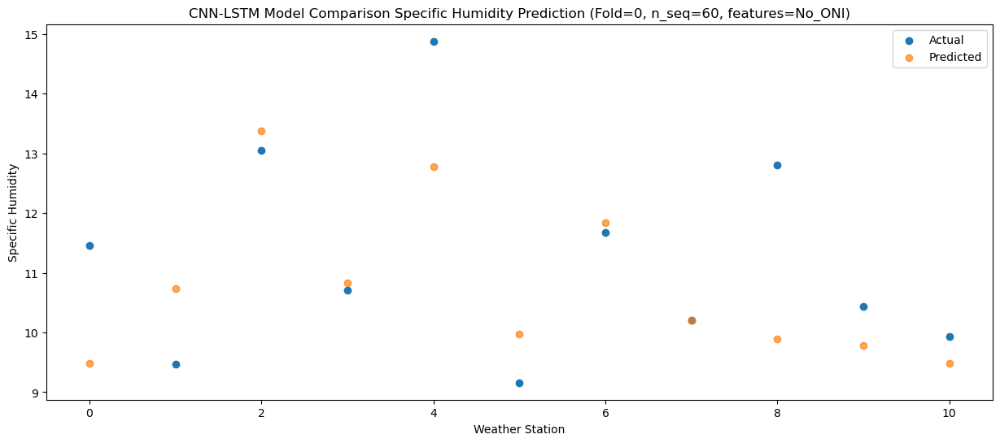

Predictions for (t+21):
    Weather_Station  Actual  Predicted
0                 0   11.51   9.806342
1                 1    9.63  11.056357
2                 2   13.25  13.696338
3                 3   10.33  11.146346
4                 4   14.80  13.096384
5                 5   10.32  10.296367
6                 6   12.21  12.166353
7                 7   10.49  10.526348
8                 8   13.00  10.216307
9                 9   10.85  10.106301
10               10   10.42   9.806323


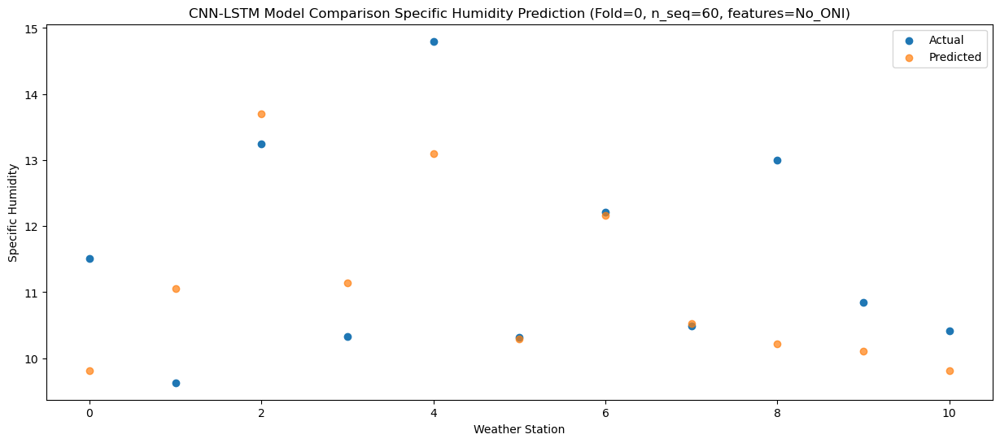

Predictions for (t+22):
    Weather_Station  Actual  Predicted
0                 0    8.09   6.435798
1                 1    7.47   7.685806
2                 2   10.25  10.325793
3                 3    8.02   7.775799
4                 4   10.57   9.725825
5                 5    6.23   6.925813
6                 6    8.89   8.795801
7                 7    7.00   7.155799
8                 8    9.19   6.845773
9                 9    7.68   6.735769
10               10    6.80   6.435780


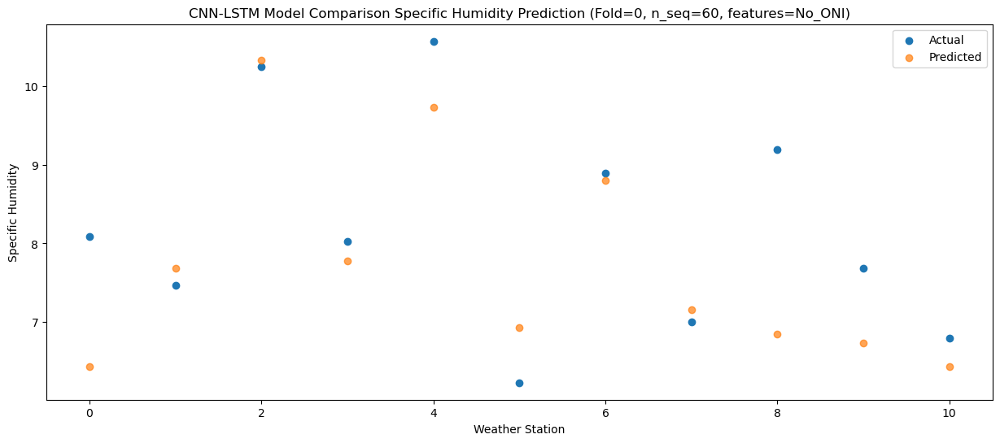

Predictions for (t+23):
    Weather_Station  Actual  Predicted
0                 0    5.91   4.349501
1                 1    4.39   5.599495
2                 2    7.53   8.239504
3                 3    5.59   5.689499
4                 4    8.48   7.639473
5                 5    3.91   4.839493
6                 6    6.78   6.709494
7                 7    5.12   5.069501
8                 8    6.77   4.759508
9                 9    6.37   4.649515
10               10    5.81   4.349486


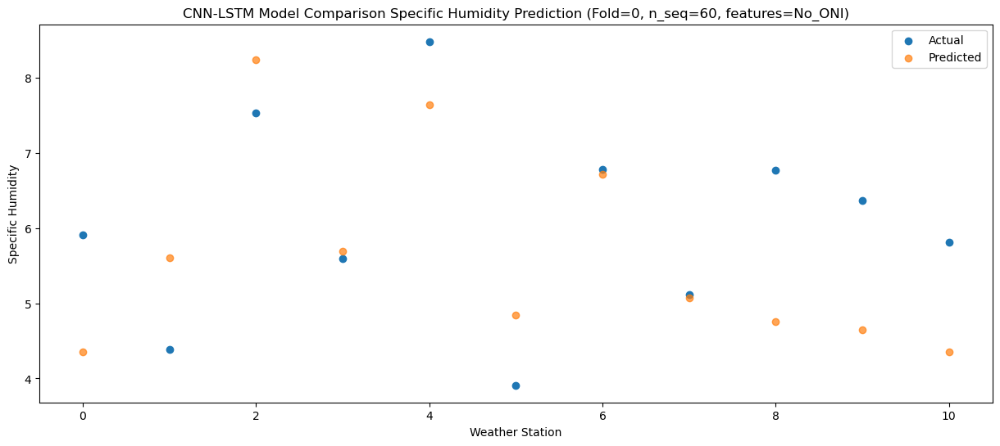

Predictions for (t+24):
    Weather_Station  Actual  Predicted
0                 0    0.61  -0.585260
1                 1   -1.27   0.664736
2                 2    1.66   3.304744
3                 3   -0.62   0.754740
4                 4    4.26   2.704714
5                 5   -1.35  -0.095260
6                 6    1.03   1.774737
7                 7   -0.67   0.134742
8                 8    1.48  -0.175255
9                 9    0.85  -0.285251
10               10    0.96  -0.585278


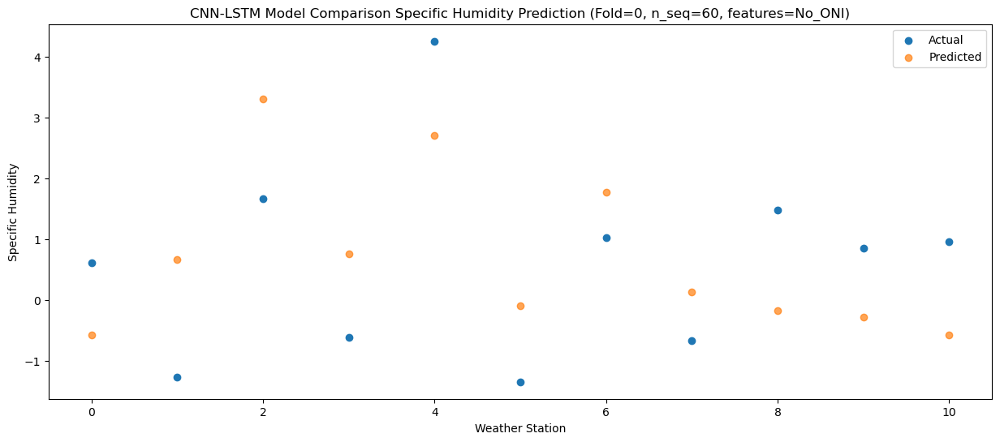

Predictions for (t+25):
    Weather_Station  Actual  Predicted
0                 0    3.39   0.343629
1                 1    2.37   1.593638
2                 2    4.06   4.233628
3                 3    2.43   1.683634
4                 4    7.02   3.633654
5                 5    0.07   0.833654
6                 6    2.87   2.703639
7                 7    1.10   1.063636
8                 8    3.07   0.753603
9                 9    1.69   0.643599
10               10    0.96   0.343609


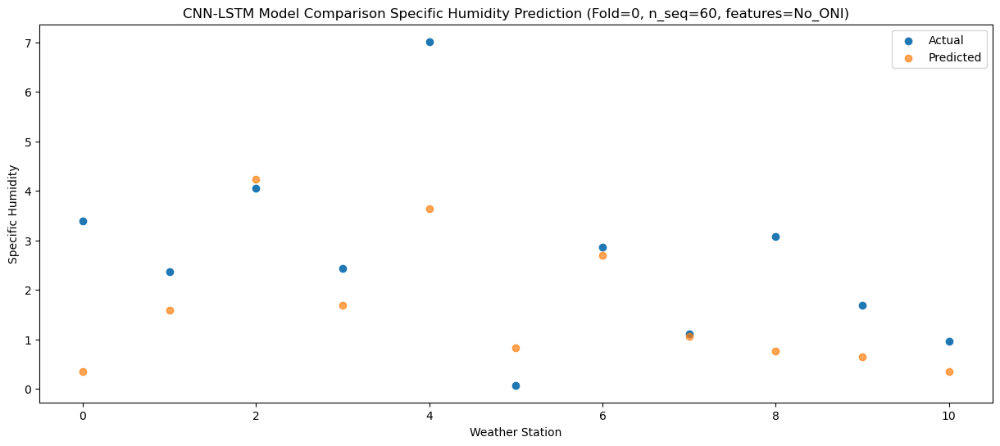

Predictions for (t+26):
    Weather_Station  Actual  Predicted
0                 0   -1.42  -2.123840
1                 1   -2.39  -0.873838
2                 2    0.65   1.766163
3                 3   -2.69  -0.783836
4                 4    1.52   1.166157
5                 5   -3.04  -1.633825
6                 6    0.09   0.236165
7                 7   -1.41  -1.403832
8                 8   -0.21  -1.713850
9                 9   -0.60  -1.823849
10               10   -1.11  -2.123858


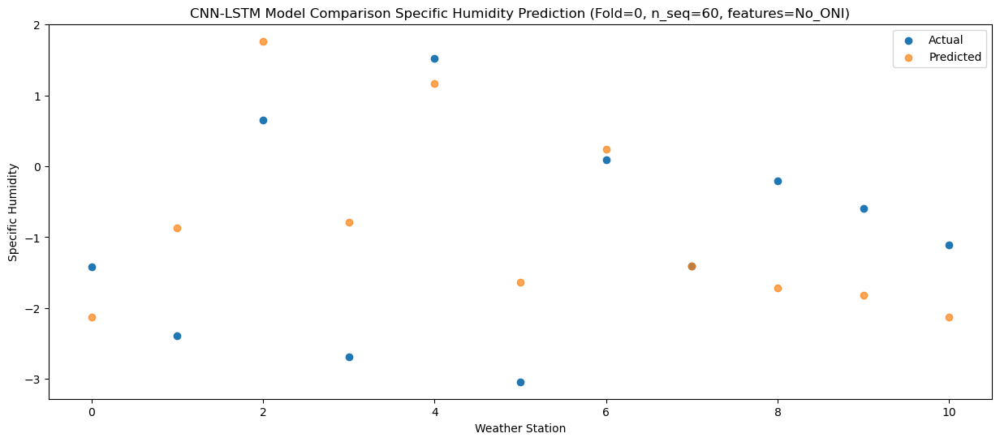

Predictions for (t+27):
    Weather_Station  Actual  Predicted
0                 0   -0.76  -1.449259
1                 1   -1.17  -0.199260
2                 2    1.86   2.440739
3                 3   -1.48  -0.109256
4                 4    1.78   1.840742
5                 5   -1.66  -0.959251
6                 6    1.37   0.910741
7                 7   -0.18  -0.729259
8                 8    0.38  -1.039267
9                 9    0.14  -1.149272
10               10   -0.51  -1.449280


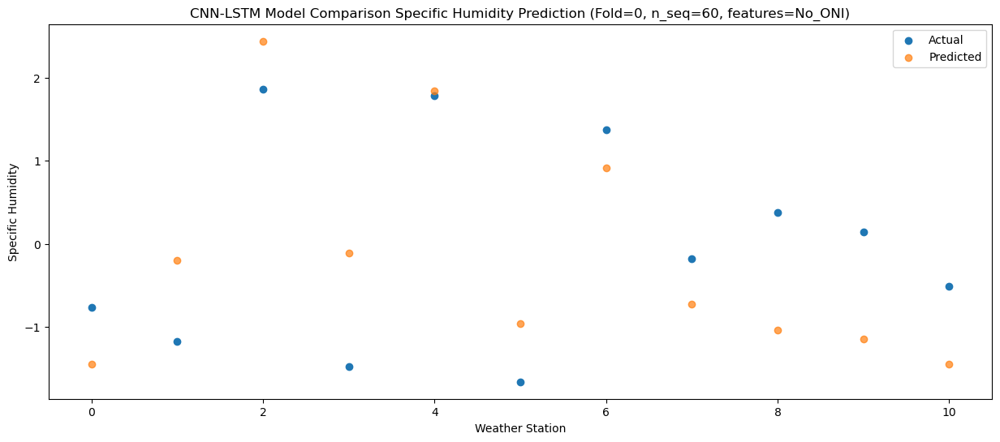

Predictions for (t+28):
    Weather_Station  Actual  Predicted
0                 0    0.64  -0.465423
1                 1    0.74   0.784563
2                 2    2.57   3.424574
3                 3   -0.39   0.874578
4                 4    3.33   2.824540
5                 5   -0.33   0.024563
6                 6    2.38   1.894564
7                 7    0.81   0.254572
8                 8    2.06  -0.055409
9                 9    1.42  -0.165412
10               10    0.74  -0.465447


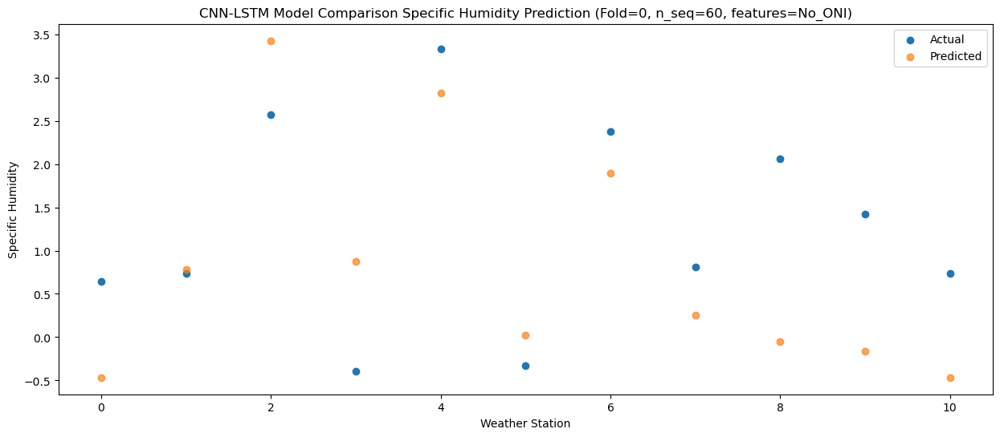

Predictions for (t+29):
    Weather_Station  Actual  Predicted
0                 0    3.11   0.729268
1                 1    2.04   1.979251
2                 2    4.02   4.619265
3                 3    2.53   2.069268
4                 4    7.25   4.019224
5                 5    0.80   1.219246
6                 6    3.38   3.089251
7                 7    1.71   1.449259
8                 8    3.64   1.139285
9                 9    3.04   1.029281
10               10    1.68   0.729241


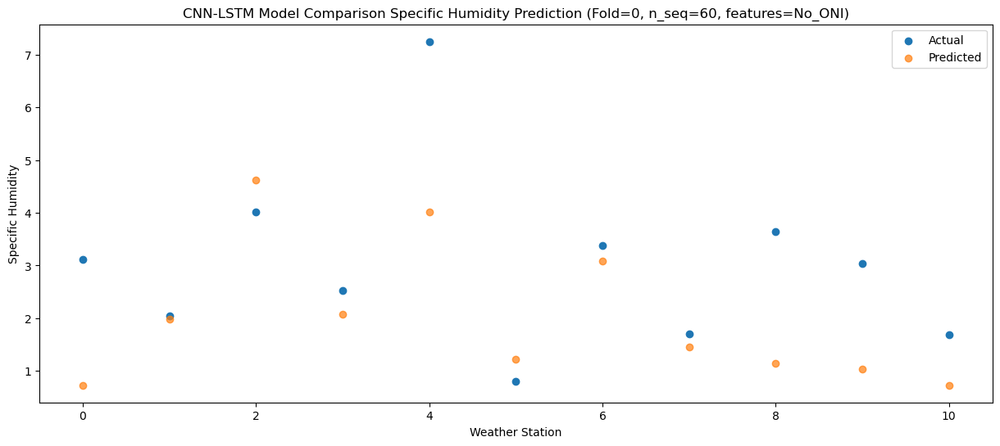

Predictions for (t+30):
    Weather_Station  Actual  Predicted
0                 0    7.88   4.623816
1                 1    6.28   5.873796
2                 2    8.16   8.513809
3                 3    6.77   5.963816
4                 4   10.95   7.913772
5                 5    5.58   5.113789
6                 6    7.74   6.983793
7                 7    6.00   5.343802
8                 8    7.83   5.033834
9                 9    7.65   4.923830
10               10    5.40   4.623789


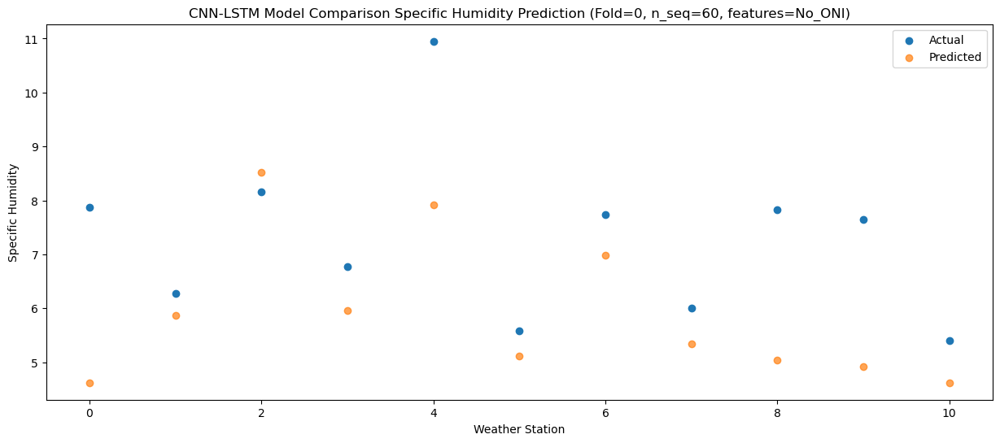

Predictions for (t+31):
    Weather_Station  Actual  Predicted
0                 0   10.80   6.513755
1                 1    8.89   7.763737
2                 2   10.94  10.403744
3                 3    8.78   7.853755
4                 4   11.92   9.803716
5                 5    6.67   7.003729
6                 6    9.62   8.873731
7                 7    7.45   7.233738
8                 8   10.01   6.923768
9                 9    9.33   6.813761
10               10    6.67   6.513726


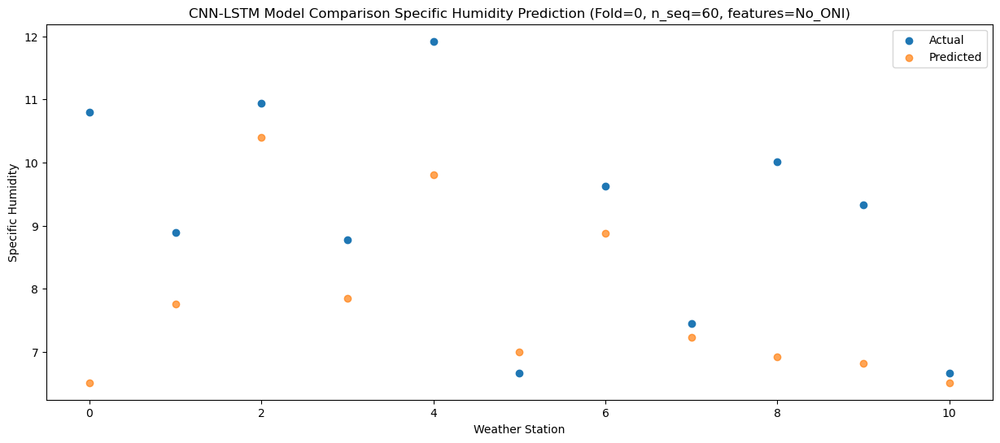

Predictions for (t+32):
    Weather_Station  Actual  Predicted
0                 0   12.38   8.904186
1                 1    9.79  10.154162
2                 2   13.14  12.794175
3                 3    9.99  10.244185
4                 4   11.68  12.194134
5                 5   11.00   9.394151
6                 6   13.24  11.264158
7                 7   10.82   9.624165
8                 8   13.67   9.314205
9                 9   12.91   9.204201
10               10    9.16   8.904158


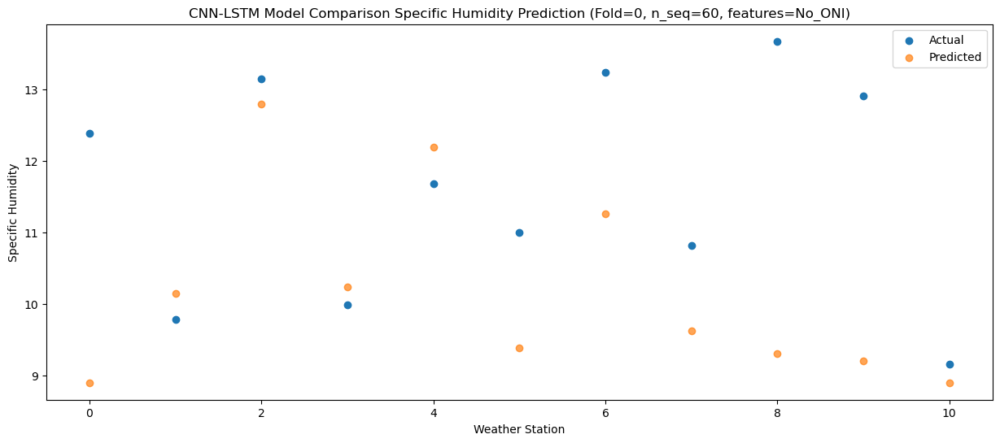

Predictions for (t+33):
    Weather_Station  Actual  Predicted
0                 0   11.96   8.471721
1                 1    9.22   9.721699
2                 2   12.44  12.361709
3                 3    9.27   9.811720
4                 4   12.77  11.761669
5                 5    9.21   8.961687
6                 6   11.89  10.831695
7                 7    9.75   9.191700
8                 8   12.70   8.881740
9                 9   11.37   8.771735
10               10   10.15   8.471692


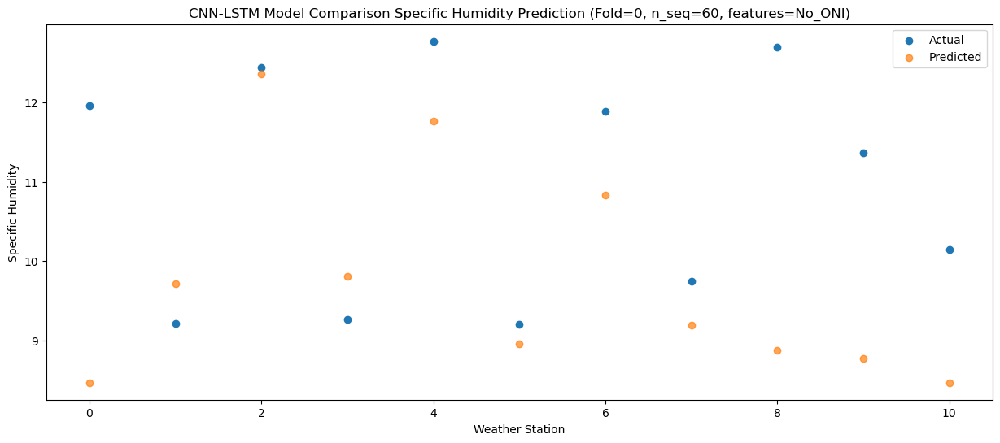

Predictions for (t+34):
    Weather_Station  Actual  Predicted
0                 0    7.41   5.160584
1                 1    6.16   6.410557
2                 2    8.71   9.050577
3                 3    5.89   6.500582
4                 4    9.94   8.450503
5                 5    6.51   5.650540
6                 6    8.45   7.520554
7                 7    6.96   5.880563
8                 8    8.25   5.570621
9                 9    8.31   5.460621
10               10    7.55   5.160557


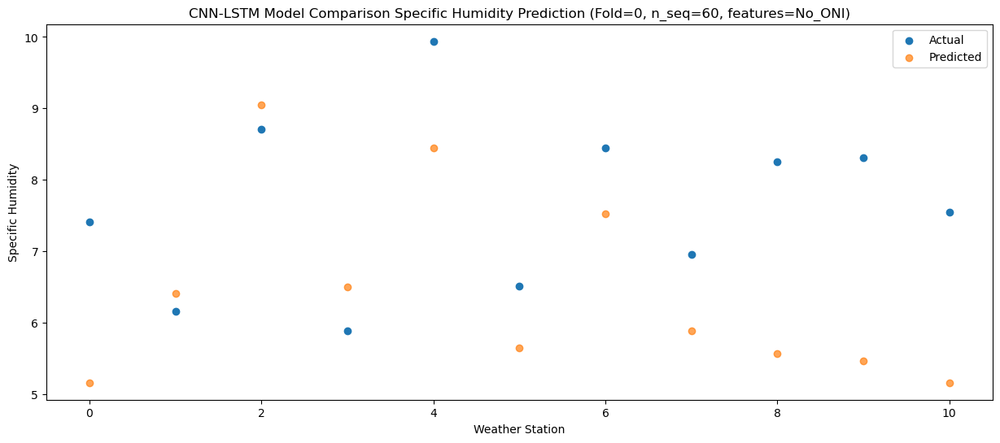

Predictions for (t+35):
    Weather_Station  Actual  Predicted
0                 0    2.13   0.655646
1                 1    1.02   1.905616
2                 2    3.71   4.545638
3                 3    0.79   1.995642
4                 4    5.14   3.945560
5                 5    1.87   1.145602
6                 6    3.89   3.015615
7                 7    2.54   1.375625
8                 8    3.02   1.065684
9                 9    2.52   0.955683
10               10    2.53   0.655615


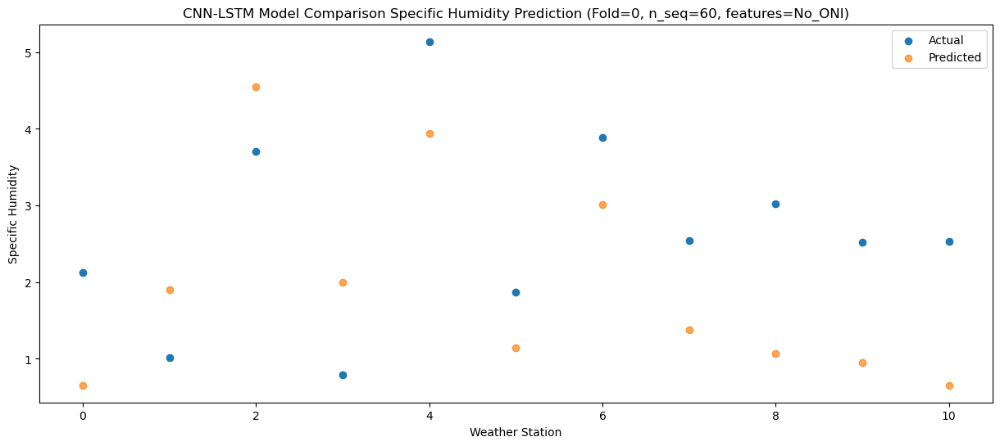

Predictions for (t+36):
    Weather_Station  Actual  Predicted
0                 0    1.59  -0.232554
1                 1    0.82   1.017418
2                 2    3.39   3.657439
3                 3    0.27   1.107445
4                 4    5.13   3.057370
5                 5    1.21   0.257407
6                 6    3.29   2.127419
7                 7    1.84   0.487428
8                 8    2.02   0.177480
9                 9    1.80   0.067479
10               10    1.39  -0.232583


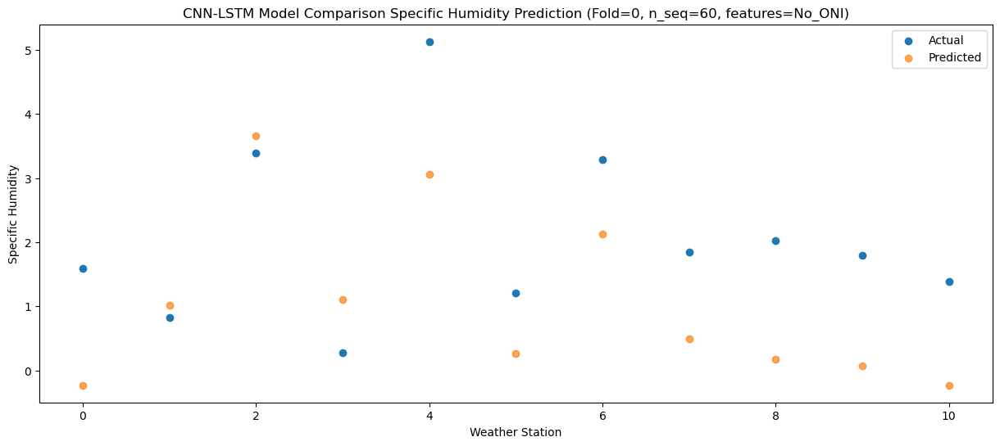

Predictions for (t+37):
    Weather_Station  Actual  Predicted
0                 0    1.13  -1.832249
1                 1   -0.38  -0.582279
2                 2    2.06   2.057740
3                 3   -0.23  -0.492251
4                 4    4.05   1.457678
5                 5   -2.14  -1.342294
6                 6    1.11   0.527720
7                 7   -0.50  -1.112273
8                 8    1.09  -1.422214
9                 9    0.87  -1.532219
10               10    0.22  -1.832280


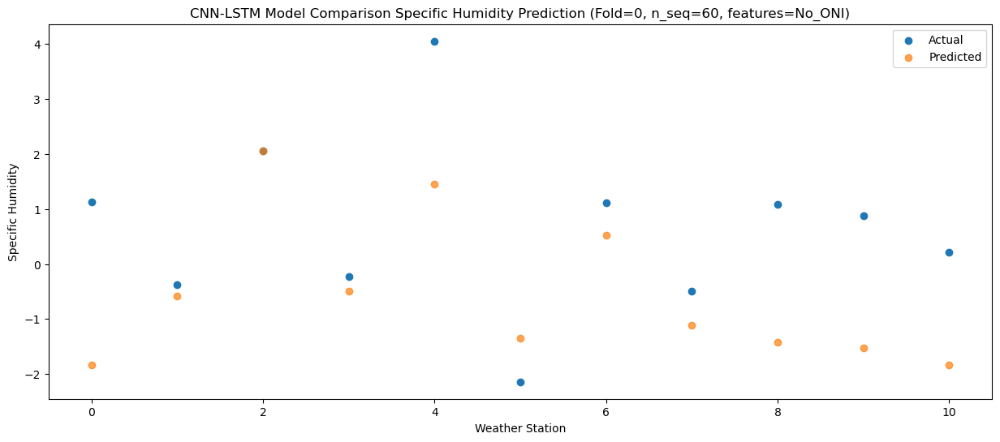

Predictions for (t+38):
    Weather_Station  Actual  Predicted
0                 0    0.73  -1.463745
1                 1   -0.29  -0.213768
2                 2    2.43   2.426240
3                 3   -0.04  -0.123747
4                 4    3.29   1.826211
5                 5   -1.39  -0.973774
6                 6    1.97   0.896231
7                 7    0.43  -0.743766
8                 8    1.69  -1.053729
9                 9    1.48  -1.163741
10               10    0.62  -1.463782


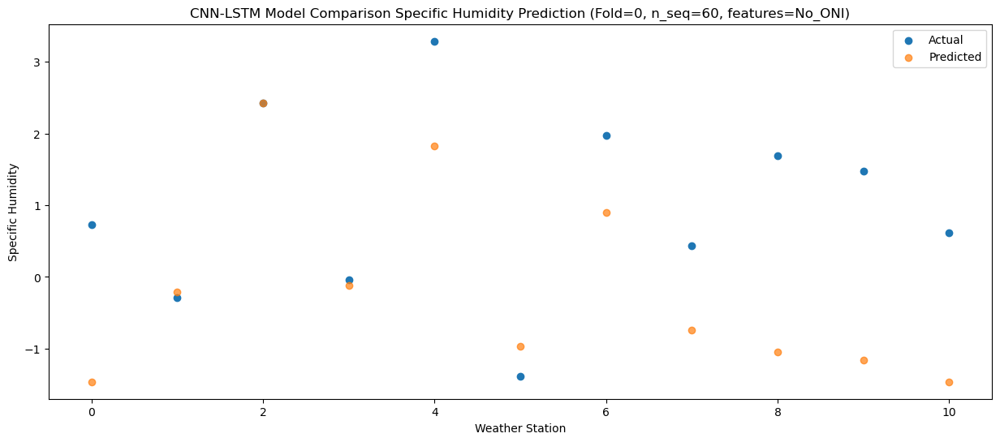

Predictions for (t+39):
    Weather_Station  Actual  Predicted
0                 0    1.35  -1.494246
1                 1    1.40  -0.244269
2                 2    3.54   2.395736
3                 3    0.63  -0.154248
4                 4    3.63   1.795714
5                 5   -0.46  -1.004275
6                 6    2.65   0.865731
7                 7    0.79  -0.774268
8                 8    1.76  -1.084231
9                 9    1.25  -1.194242
10               10    0.06  -1.494284


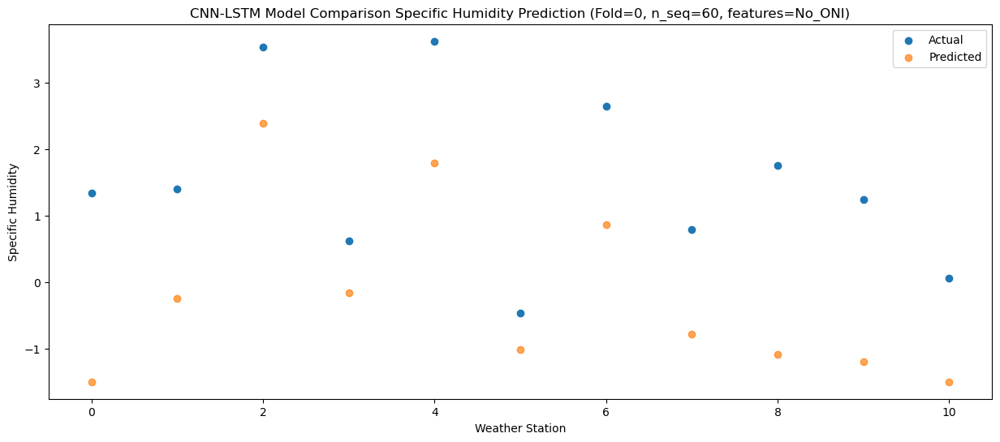

Predictions for (t+40):
    Weather_Station  Actual  Predicted
0                 0    1.95  -1.527975
1                 1    1.78  -0.278006
2                 2    2.90   2.362011
3                 3    1.71  -0.187981
4                 4    5.82   1.761953
5                 5   -0.68  -1.038017
6                 6    2.24   0.831995
7                 7    0.71  -0.808000
8                 8    2.20  -1.117944
9                 9    1.35  -1.227948
10               10    0.52  -1.528013


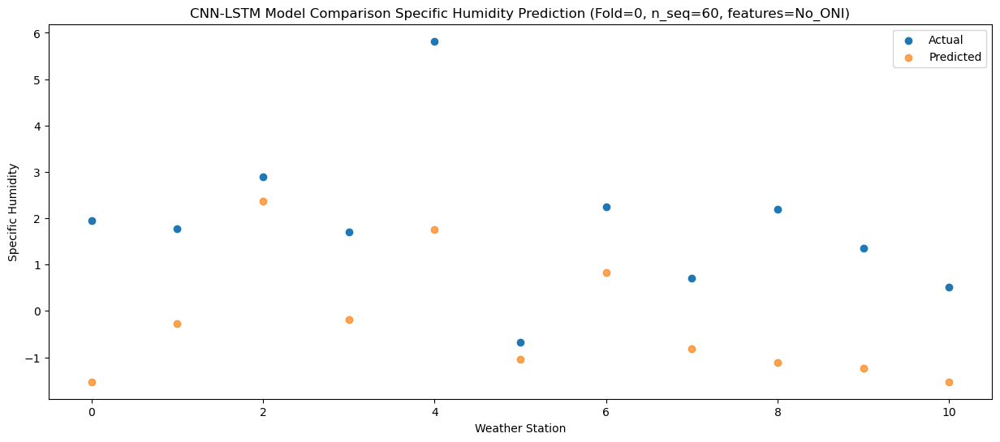

Predictions for (t+41):
    Weather_Station  Actual  Predicted
0                 0    2.94   0.073670
1                 1    2.57   1.323647
2                 2    4.34   3.963652
3                 3    2.11   1.413668
4                 4    6.58   3.363628
5                 5    2.00   0.563637
6                 6    4.45   2.433644
7                 7    2.99   0.793647
8                 8    3.42   0.483688
9                 9    3.08   0.373677
10               10    2.16   0.073633


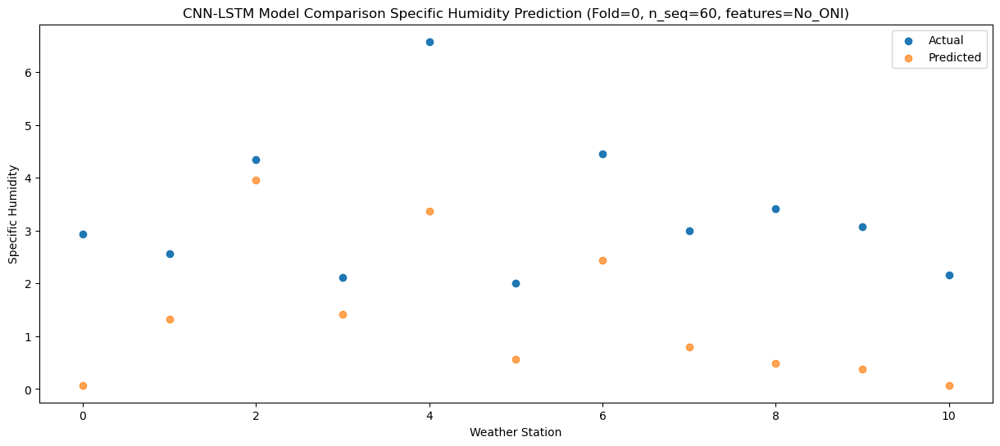

Predictions for (t+42):
    Weather_Station  Actual  Predicted
0                 0    6.62   2.287060
1                 1    4.76   3.537045
2                 2    7.12   6.177040
3                 3    4.96   3.627061
4                 4   10.52   5.577048
5                 5    2.76   2.777041
6                 6    6.04   4.647044
7                 7    4.31   3.007041
8                 8    6.91   2.697058
9                 9    5.52   2.587043
10               10    3.37   2.287021


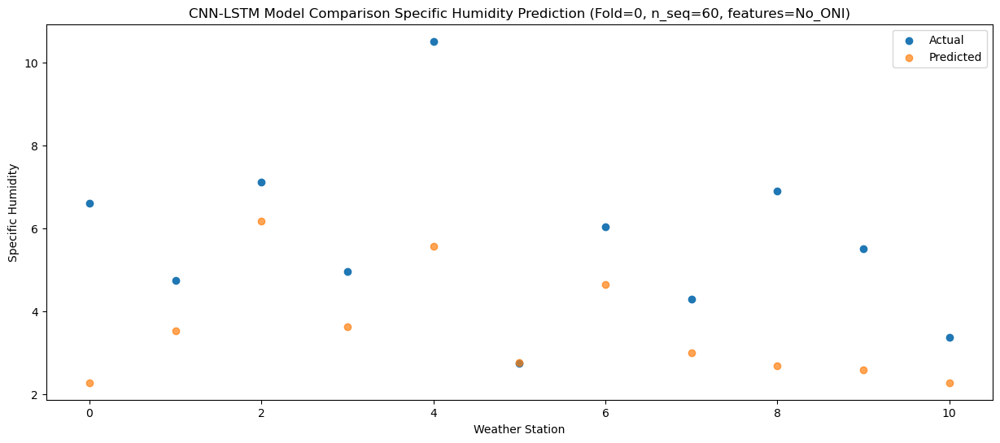

Predictions for (t+43):
    Weather_Station  Actual  Predicted
0                 0   10.41   4.916356
1                 1    8.09   6.166340
2                 2    9.70   8.806339
3                 3    9.11   6.256356
4                 4   14.64   8.206328
5                 5    6.66   5.406337
6                 6    8.77   7.276339
7                 7    6.93   5.636340
8                 8    9.19   5.326362
9                 9    8.14   5.216352
10               10    6.38   4.916319


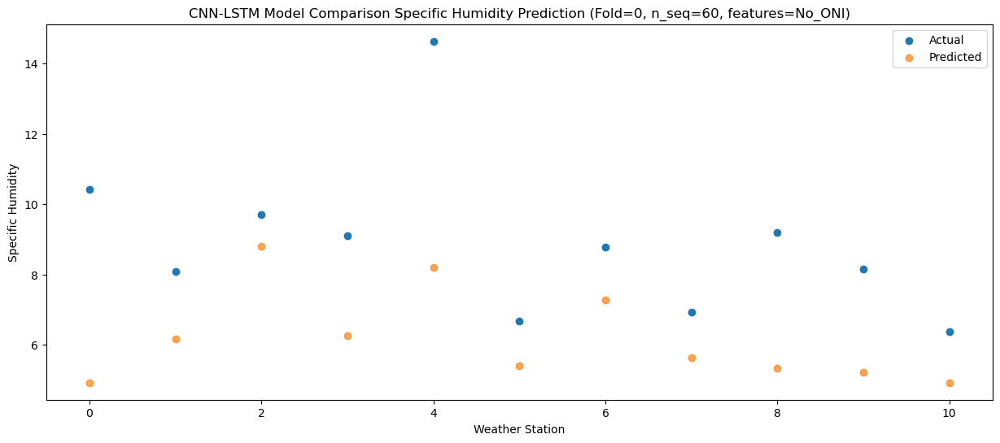

Predictions for (t+44):
    Weather_Station  Actual  Predicted
0                 0   12.70   7.928132
1                 1    9.76   9.178121
2                 2   12.56  11.818118
3                 3   10.14   9.268136
4                 4   13.22  11.218112
5                 5   11.01   8.418121
6                 6   12.51  10.288122
7                 7   11.28   8.648120
8                 8   12.74   8.338134
9                 9   11.96   8.228124
10               10   10.21   7.928096


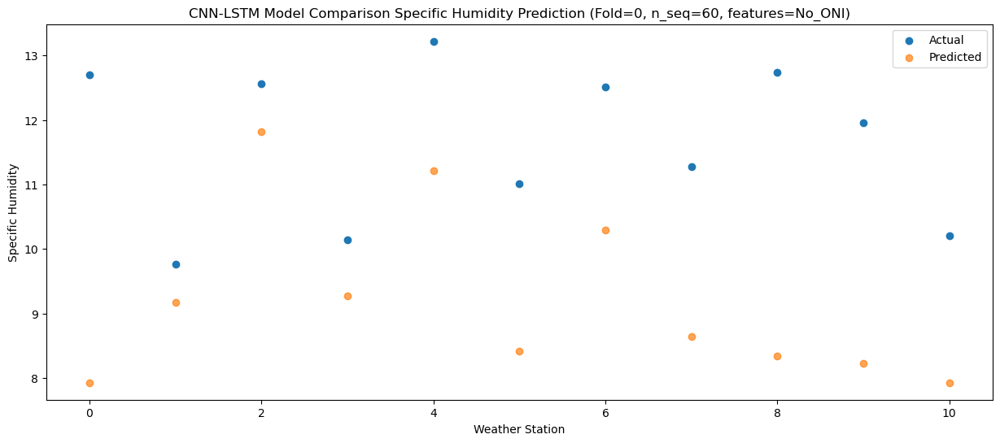

Predictions for (t+45):
    Weather_Station  Actual  Predicted
0                 0   12.32   7.397566
1                 1   10.54   8.647560
2                 2   12.65  11.287552
3                 3    9.89   8.737572
4                 4   11.40  10.687562
5                 5   10.12   7.887564
6                 6   12.14   9.757562
7                 7   10.22   8.117557
8                 8   12.74   7.807558
9                 9   10.66   7.697547
10               10    9.46   7.397529


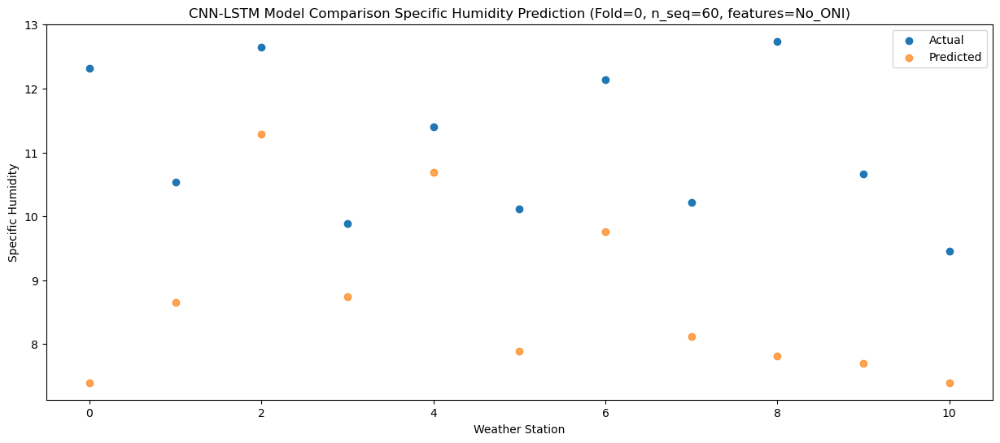

Predictions for (t+46):
    Weather_Station  Actual  Predicted
0                 0    8.35   4.718337
1                 1    6.52   5.968326
2                 2    9.07   8.608327
3                 3    7.71   6.058344
4                 4   11.36   8.008301
5                 5    7.00   5.208326
6                 6    9.20   7.078329
7                 7    7.42   5.438328
8                 8    8.67   5.128346
9                 9    7.94   5.018341
10               10    8.15   4.718301


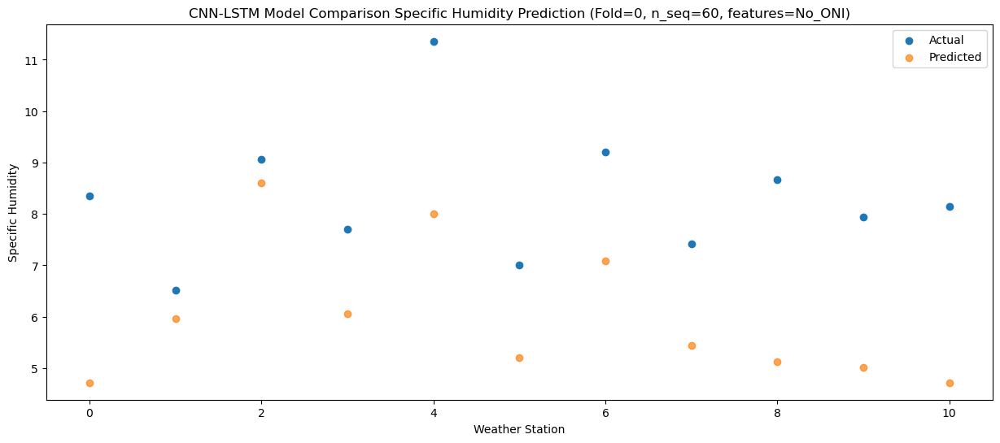

Predictions for (t+47):
    Weather_Station  Actual  Predicted
0                 0    4.32   1.297198
1                 1    1.82   2.547187
2                 2    5.16   5.187186
3                 3    3.14   2.637204
4                 4    7.61   4.587166
5                 5    2.60   1.787184
6                 6    4.94   3.657187
7                 7    3.67   2.017187
8                 8    4.61   1.707206
9                 9    4.70   1.597199
10               10    4.39   1.297161


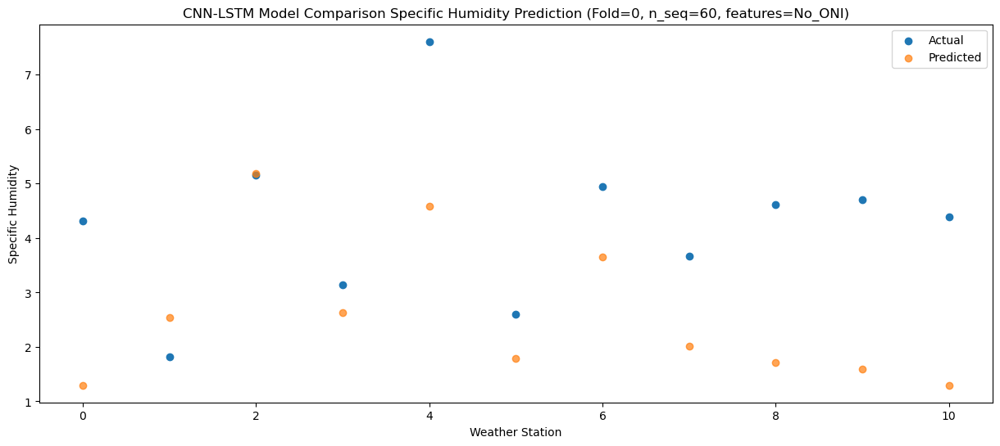

Predictions for (t+48):
    Weather_Station  Actual  Predicted
0                 0    1.14  -2.065159
1                 1   -0.36  -0.815169
2                 2    2.63   1.824828
3                 3    0.15  -0.725153
4                 4    4.81   1.224810
5                 5   -0.42  -1.575169
6                 6    1.61   0.294831
7                 7    0.15  -1.345169
8                 8    1.95  -1.655154
9                 9    1.35  -1.765161
10               10    0.98  -2.065195


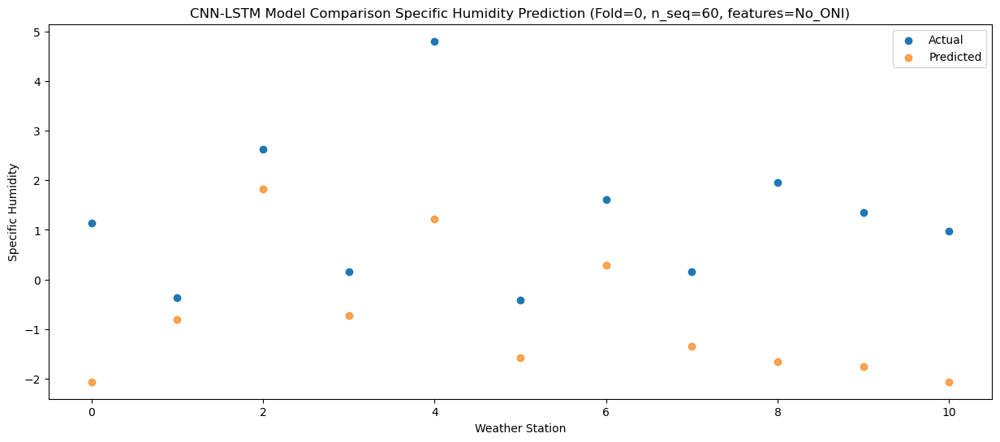

Predictions for (t+49):
    Weather_Station  Actual  Predicted
0                 0   -0.14  -2.194722
1                 1   -1.80  -0.944745
2                 2    1.82   1.695270
3                 3   -1.25  -0.854719
4                 4    2.95   1.095197
5                 5   -1.24  -1.704753
6                 6    1.54   0.165256
7                 7    0.35  -1.474737
8                 8    1.34  -1.784692
9                 9    1.54  -1.894691
10               10    1.51  -2.194759


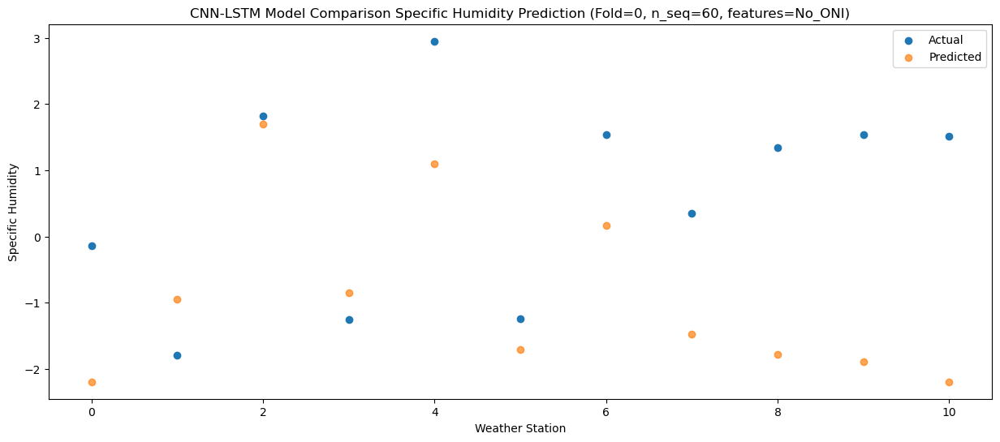

Predictions for (t+50):
    Weather_Station  Actual  Predicted
0                 0   -0.96  -3.255903
1                 1   -2.58  -2.005932
2                 2    1.02   0.634087
3                 3   -2.17  -1.915899
4                 4    1.77   0.034001
5                 5   -2.03  -2.765949
6                 6    0.87  -0.895933
7                 7   -0.34  -2.535924
8                 8    0.16  -2.845862
9                 9    0.57  -2.955859
10               10   -0.01  -3.255937


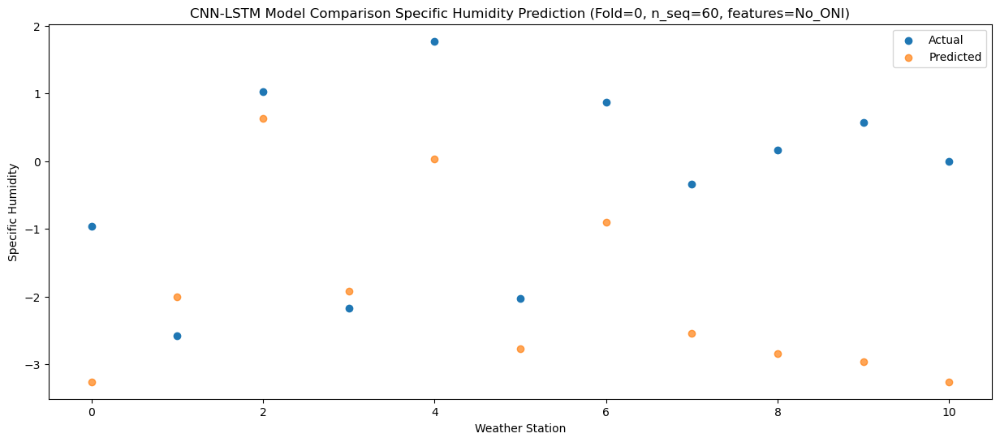

Predictions for (t+51):
    Weather_Station  Actual  Predicted
0                 0    0.94  -3.007676
1                 1   -1.36  -1.757693
2                 2    1.66   0.882309
3                 3   -0.39  -1.667670
4                 4    4.34   0.282274
5                 5   -2.13  -2.517701
6                 6    1.03  -0.647697
7                 7   -0.31  -2.287694
8                 8    1.92  -2.597662
9                 9    0.92  -2.707667
10               10    0.52  -3.007712


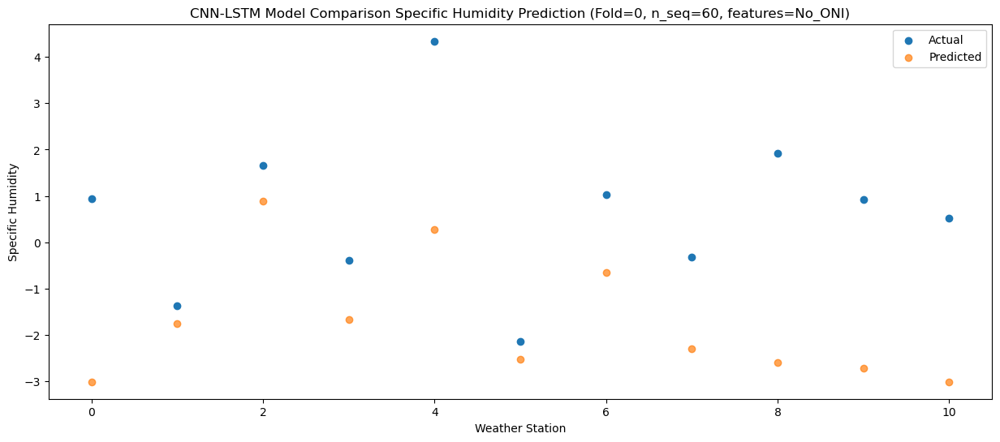

Predictions for (t+52):
    Weather_Station  Actual  Predicted
0                 0    2.20  -1.820873
1                 1    0.49  -0.570892
2                 2    3.29   2.069115
3                 3    1.40  -0.480865
4                 4    6.08   1.469058
5                 5   -0.21  -1.330909
6                 6    2.48   0.539100
7                 7    0.83  -1.100890
8                 8    2.79  -1.410843
9                 9    2.05  -1.520844
10               10    1.21  -1.820905


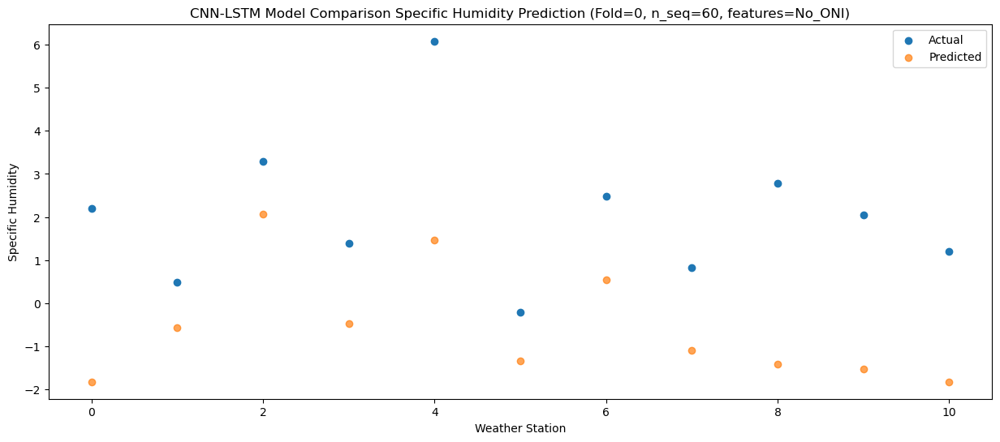

Predictions for (t+53):
    Weather_Station  Actual  Predicted
0                 0    4.51   0.180694
1                 1    2.40   1.430685
2                 2    5.03   4.070684
3                 3    3.45   1.520707
4                 4    8.32   3.470647
5                 5    1.13   0.670677
6                 6    4.54   2.540678
7                 7    2.85   0.900686
8                 8    5.02   0.590711
9                 9    4.42   0.480709
10               10    2.77   0.180663


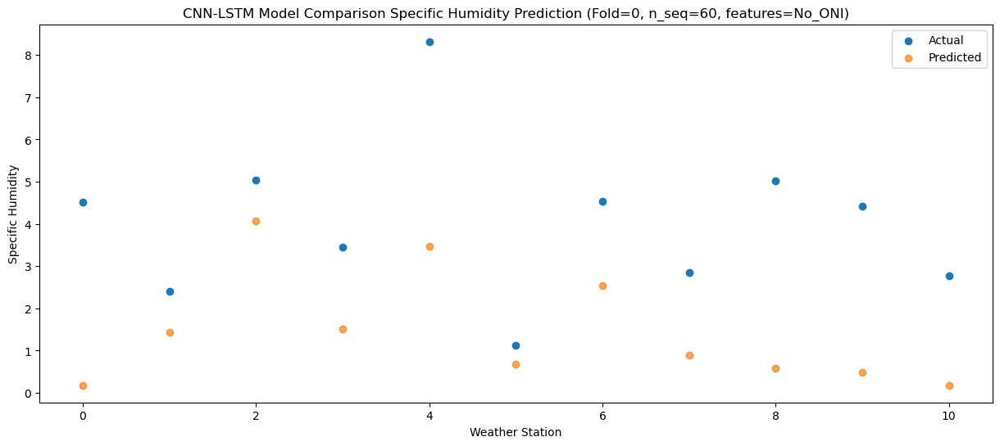

Predictions for (t+54):
    Weather_Station  Actual  Predicted
0                 0    8.98   3.843880
1                 1    6.98   5.093888
2                 2    8.78   7.733866
3                 3    8.02   5.183898
4                 4   12.57   7.133889
5                 5    5.19   4.333891
6                 6    8.45   6.203880
7                 7    6.67   4.563880
8                 8    9.30   4.253863
9                 9    8.22   4.143852
10               10    5.82   3.843847


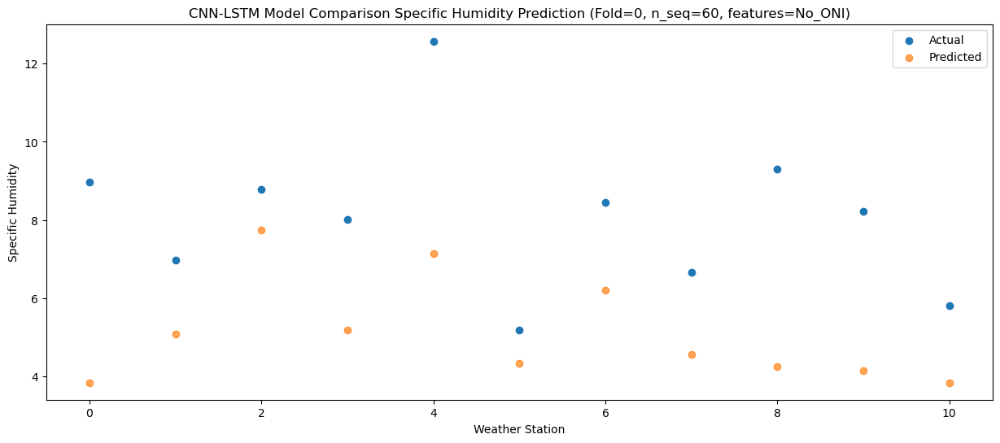

Predictions for (t+55):
    Weather_Station  Actual  Predicted
0                 0   10.37   5.719178
1                 1    8.58   6.969181
2                 2    9.91   9.609166
3                 3    9.53   7.059197
4                 4   14.22   9.009164
5                 5    7.16   6.209178
6                 6   10.27   8.079173
7                 7    8.36   6.439176
8                 8   11.72   6.129176
9                 9    9.29   6.019169
10               10    8.32   5.719147


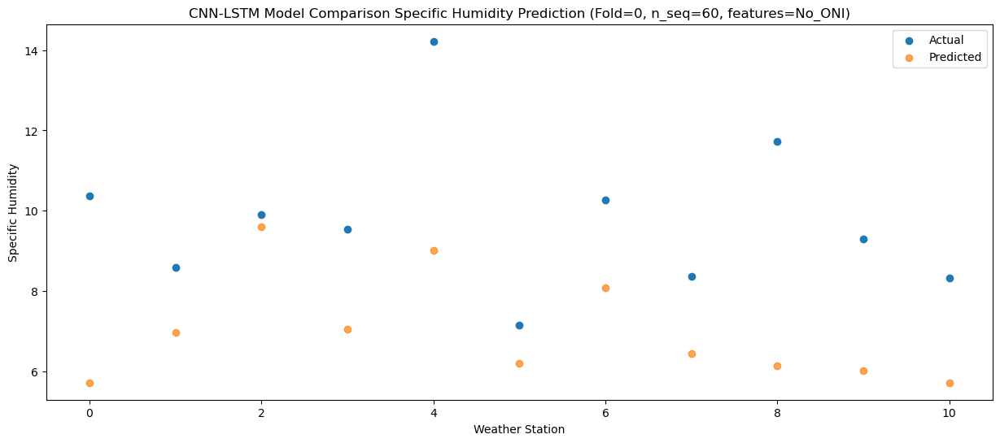

Predictions for (t+56):
    Weather_Station  Actual  Predicted
0                 0   11.66   7.505495
1                 1   10.75   8.755499
2                 2   13.14  11.395483
3                 3   10.93   8.845516
4                 4   13.96  10.795480
5                 5    9.95   7.995495
6                 6   12.80   9.865490
7                 7   11.25   8.225493
8                 8   12.90   7.915492
9                 9   10.79   7.805485
10               10    9.39   7.505462


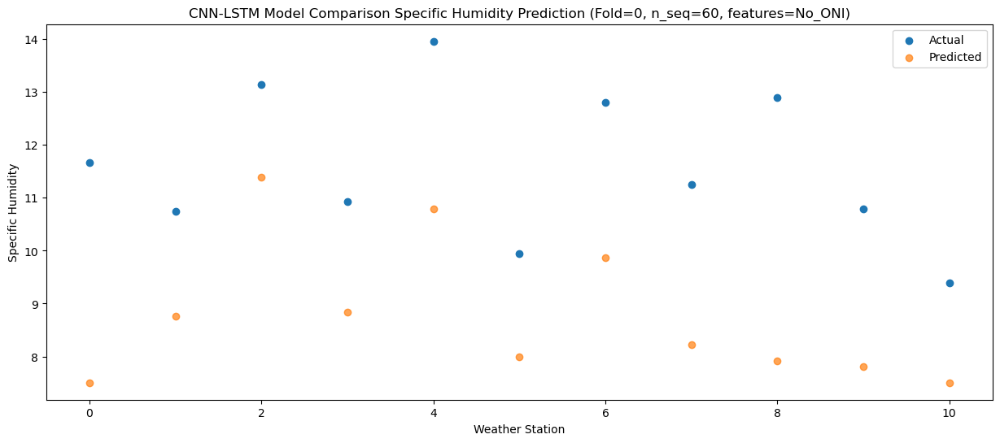

Predictions for (t+57):
    Weather_Station  Actual  Predicted
0                 0    9.83   6.364871
1                 1    9.25   7.614872
2                 2   11.45  10.254862
3                 3    9.79   7.704889
4                 4   13.61   9.654834
5                 5    8.94   6.854866
6                 6   11.64   8.724864
7                 7    9.82   7.084870
8                 8   11.23   6.774879
9                 9    9.99   6.664873
10               10    9.15   6.364837


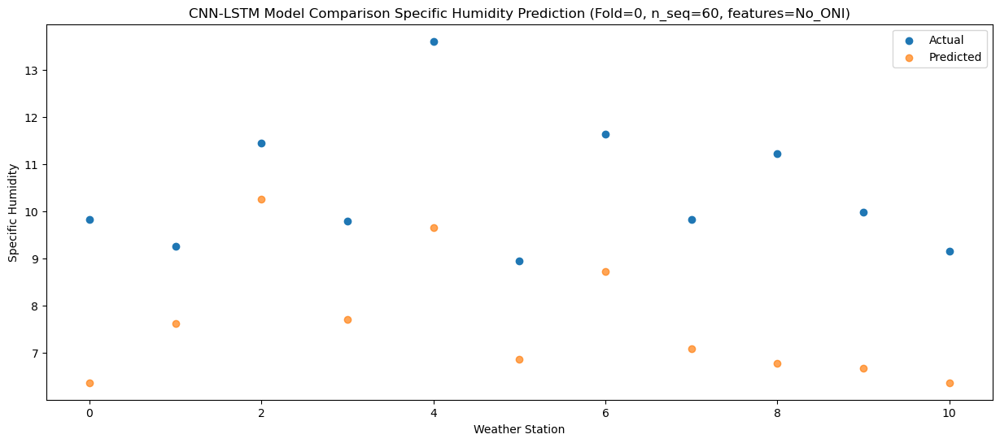

Predictions for (t+58):
    Weather_Station  Actual  Predicted
0                 0    8.36   4.154669
1                 1    8.38   5.404663
2                 2    9.76   8.044659
3                 3    8.23   5.494684
4                 4   11.12   7.444616
5                 5    6.99   4.644651
6                 6    9.91   6.514654
7                 7    8.23   4.874664
8                 8    9.19   4.564687
9                 9    7.64   4.454684
10               10    7.44   4.154635


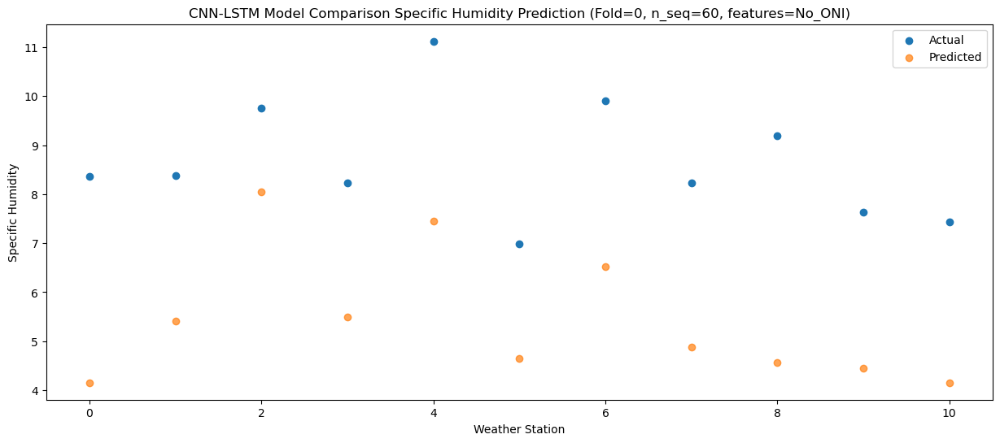

Predictions for (t+59):
    Weather_Station  Actual  Predicted
0                 0    2.98  -0.027083
1                 1    2.98   1.222909
2                 2    5.63   3.862907
3                 3    3.04   1.312931
4                 4    7.51   3.262857
5                 5    1.70   0.462896
6                 6    5.21   2.332900
7                 7    3.34   0.692910
8                 8    4.59   0.382937
9                 9    4.11   0.272934
10               10    3.24  -0.027119


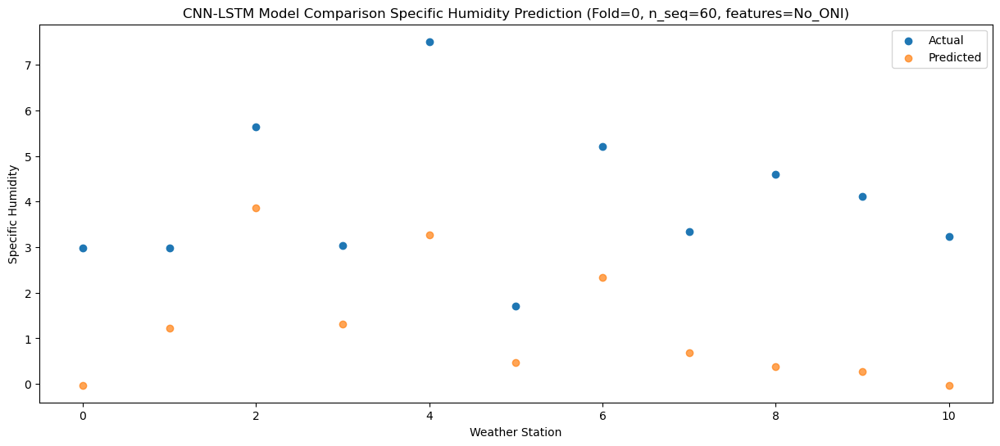

f, t:
[[ 3.000e-02 -8.600e-01  2.230e+00 -4.800e-01  4.290e+00 -8.100e-01
   1.380e+00 -5.000e-02  1.270e+00  7.800e-01  4.900e-01]
 [ 4.600e-01 -5.300e-01  2.480e+00  6.000e-02  3.040e+00 -8.500e-01
   1.500e+00  2.000e-01  1.360e+00  1.190e+00  6.100e-01]
 [ 3.700e-01 -9.700e-01  2.310e+00  3.000e-01  3.830e+00 -1.330e+00
   1.420e+00  2.300e-01  9.600e-01  6.900e-01  2.300e-01]
 [ 1.000e-02 -2.400e-01  2.860e+00  4.400e-01  3.220e+00 -1.440e+00
   1.780e+00  4.500e-01  9.500e-01  3.700e-01 -2.800e-01]
 [ 3.300e+00  3.640e+00  5.460e+00  4.750e+00  7.670e+00  3.200e-01
   3.410e+00  1.750e+00  3.210e+00  2.330e+00  1.320e+00]
 [ 2.950e+00  1.850e+00  4.210e+00  3.600e+00  7.390e+00  6.600e-01
   3.190e+00  1.690e+00  3.450e+00  2.390e+00  1.680e+00]
 [ 5.920e+00  4.170e+00  7.070e+00  5.750e+00  9.970e+00  3.790e+00
   6.290e+00  3.680e+00  6.670e+00  5.530e+00  4.580e+00]
 [ 9.680e+00  7.850e+00  1.098e+01  8.240e+00  1.233e+01  7.520e+00
   1.001e+01  8.350e+00  1.032e+01  8.220e+0

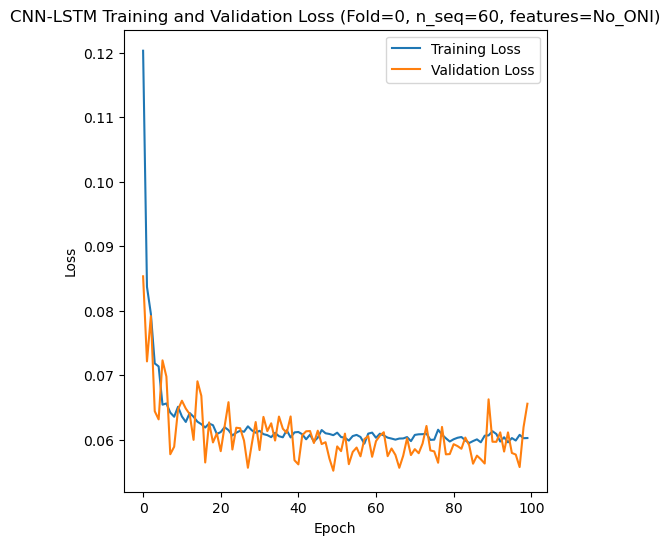

[[ 6.43  5.26  5.95 ... 15.04 10.09  9.76]
 [ 4.92  3.81  4.91 ... 12.52  8.69  7.9 ]
 [ 5.77  4.38  5.81 ... 14.28  9.78  9.52]
 ...
 [ 4.32  3.52  5.54 ... 12.    6.96  7.01]
 [ 3.07  3.12  5.08 ... 11.47  8.11  7.14]
 [ 2.37  2.06  3.5  ...  9.32  6.33  5.39]]
Epoch 1/100
84/84 [==============================] - 8s 39ms/step - loss: 0.1287 - accuracy: 0.2857 - mae: 0.1061 - rmse: 0.1287 - mape: 22.8507 - pearson: 0.5778 - val_loss: 0.0957 - val_accuracy: 0.0000e+00 - val_mae: 0.0753 - val_rmse: 0.0957 - val_mape: 17.8962 - val_pearson: 0.5687
Epoch 2/100
84/84 [==============================] - 2s 27ms/step - loss: 0.0874 - accuracy: 0.4167 - mae: 0.0701 - rmse: 0.0874 - mape: 15.7714 - pearson: 0.7067 - val_loss: 0.0848 - val_accuracy: 0.5000 - val_mae: 0.0699 - val_rmse: 0.0848 - val_mape: 14.9942 - val_pearson: 0.7691
Epoch 3/100
84/84 [==============================] - 3s 31ms/step - loss: 0.0728 - accuracy: 0.5357 - mae: 0.0582 - rmse: 0.0728 - mape: 13.0816 - pearson: 0.7630 -

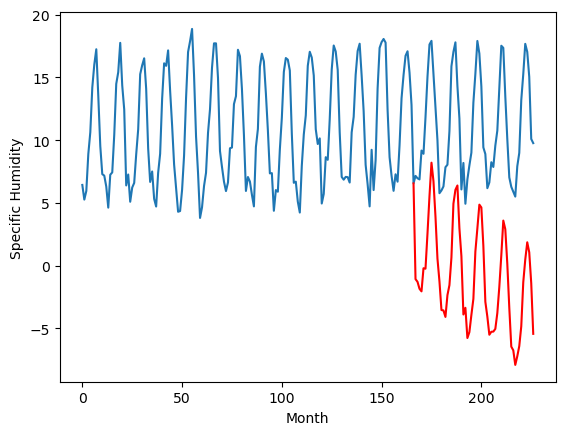

Weather Station 2:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
1.11		2.99		1.88
1.16		2.77		1.61
0.91		2.21		1.30
1.43		2.01		0.58
3.66		3.85		0.19
2.07		3.82		1.75
5.08		6.62		1.54
8.88		9.59		0.71
10.92		12.26		1.34
10.97		10.78		-0.19
8.07		7.98		-0.09
5.40		4.61		-0.79
2.34		2.80		0.46
-0.25		0.52		0.77
-0.23		0.49		0.72
-0.04		-0.03		0.01
1.49		1.71		0.22
1.85		2.51		0.66
4.77		4.71		-0.06
8.75		9.00		0.25
10.62		10.10		-0.52
10.83		10.45		-0.38
7.88		7.04		-0.84
5.84		4.81		-1.03
0.25		0.17		-0.08
2.42		0.70		-1.72
-0.58		-1.71		-1.13
0.37		-1.24		-1.61
1.05		0.13		-0.92
2.11		1.41		-0.70
6.28		5.18		-1.10
8.68		7.03		-1.65
11.35		8.92		-2.43
10.94		8.69		-2.25
7.58		5.64		-1.94
2.69		1.18		-1.51
2.21		-0.00		-2.21
0.62		-1.45		-2.07
1.03		-1.21		-2.24
2.15		-1.20		-3.35
1.28		-0.98		-2.26
2.88		0.28		-2.60
5.62		2.37		-3.25
7.97		4.88		-3.09
10.93		7.65		-3.28
11.06		6.96		-4.10
7.95		4.21		-3.74
4.10		0.70		-3.40
1.09		-2.39		-3.48
0.51		-2.69		-

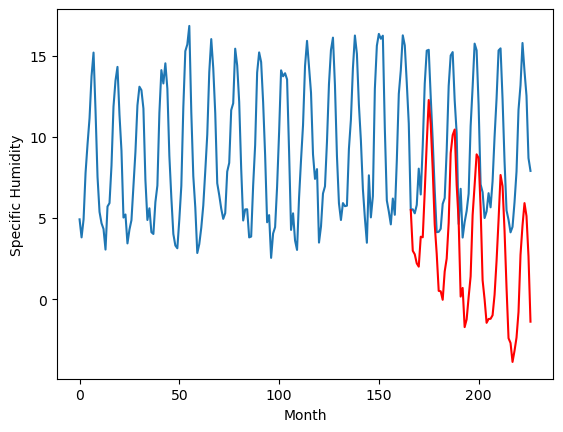

Weather Station 3:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
-0.05		1.48		1.53
0.86		1.26		0.40
0.35		0.70		0.35
0.74		0.50		-0.24
3.90		2.34		-1.56
2.28		2.31		0.03
5.05		5.11		0.06
8.90		8.08		-0.82
11.45		10.75		-0.70
10.97		9.27		-1.70
8.02		6.47		-1.55
5.26		3.10		-2.16
2.08		1.29		-0.79
-0.69		-0.99		-0.30
-0.54		-1.02		-0.48
-0.54		-1.54		-1.00
2.08		0.20		-1.88
1.79		1.00		-0.79
4.63		3.20		-1.43
9.15		7.49		-1.66
10.74		8.59		-2.15
10.96		8.94		-2.02
8.20		5.53		-2.67
5.45		3.30		-2.15
-0.05		-1.34		-1.29
2.59		-0.81		-3.40
-1.29		-3.22		-1.93
-0.26		-2.75		-2.49
0.53		-1.38		-1.91
2.29		-0.10		-2.39
6.65		3.67		-2.98
9.74		5.52		-4.22
11.37		7.41		-3.96
10.50		7.18		-3.32
6.99		4.13		-2.86
1.88		-0.33		-2.21
1.51		-1.51		-3.02
0.82		-2.96		-3.78
0.79		-2.72		-3.51
1.84		-2.71		-4.55
1.37		-2.49		-3.86
2.73		-1.23		-3.96
6.03		0.86		-5.17
8.68		3.37		-5.31
11.82		6.14		-5.68
11.75		5.45		-6.30
7.94		2.70		-5.24
3.43		-0.81		-4.24
0.88		-3.90		

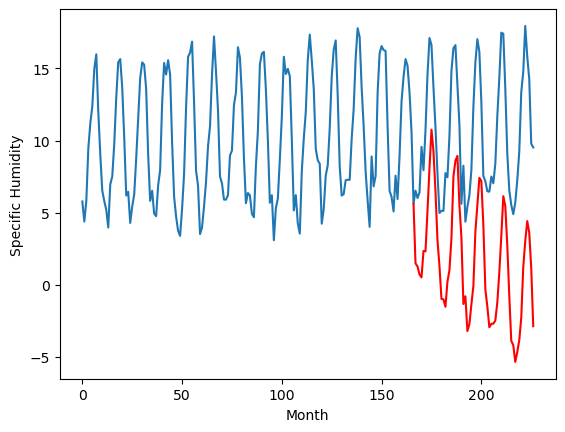

Weather Station 4:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
1.89		2.33		0.44
0.69		2.11		1.42
1.59		1.55		-0.04
0.89		1.35		0.46
5.25		3.19		-2.06
4.91		3.16		-1.75
6.89		5.96		-0.93
9.01		8.93		-0.08
11.52		11.60		0.08
10.41		10.12		-0.29
8.83		7.32		-1.51
5.43		3.95		-1.48
3.33		2.14		-1.19
0.78		-0.14		-0.92
0.44		-0.17		-0.61
0.51		-0.69		-1.20
3.15		1.05		-2.10
4.49		1.85		-2.64
8.38		4.05		-4.33
11.57		8.34		-3.23
12.05		9.44		-2.61
12.39		9.79		-2.60
9.30		6.38		-2.92
7.05		4.15		-2.90
2.60		-0.49		-3.09
5.52		0.04		-5.48
-0.13		-2.37		-2.24
0.04		-1.90		-1.94
1.72		-0.53		-2.25
5.88		0.75		-5.13
9.69		4.52		-5.17
10.74		6.37		-4.37
11.66		8.26		-3.40
11.91		8.03		-3.88
8.62		4.98		-3.64
3.66		0.52		-3.14
3.16		-0.66		-3.82
2.35		-2.11		-4.46
1.93		-1.87		-3.80
2.71		-1.86		-4.57
4.26		-1.64		-5.90
4.63		-0.38		-5.01
8.41		1.71		-6.70
11.81		4.22		-7.59
12.37		6.99		-5.38
10.70		6.30		-4.40
9.50		3.55		-5.95
6.08		0.04		-6.04
2.75		-3.05		-5.80

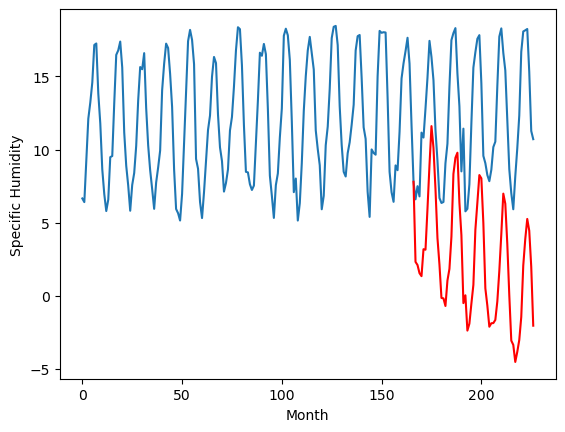

Weather Station 5:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
2.44		3.22		0.78
1.20		3.00		1.80
2.11		2.44		0.33
1.43		2.24		0.81
6.16		4.08		-2.08
5.85		4.05		-1.80
7.97		6.85		-1.12
10.26		9.82		-0.44
12.86		12.49		-0.37
11.41		11.01		-0.40
9.92		8.21		-1.71
6.07		4.84		-1.23
3.59		3.03		-0.56
0.77		0.75		-0.02
0.52		0.72		0.20
0.56		0.20		-0.36
3.28		1.94		-1.34
4.54		2.74		-1.80
8.57		4.94		-3.63
11.98		9.23		-2.75
12.16		10.33		-1.83
12.20		10.68		-1.52
9.10		7.27		-1.83
7.15		5.04		-2.11
2.56		0.40		-2.16
5.49		0.93		-4.56
-0.05		-1.48		-1.43
0.15		-1.01		-1.16
1.85		0.36		-1.49
5.95		1.64		-4.31
9.83		5.41		-4.42
10.95		7.26		-3.69
11.70		9.15		-2.55
12.08		8.92		-3.16
8.73		5.87		-2.86
3.83		1.41		-2.42
3.45		0.23		-3.22
2.63		-1.22		-3.85
2.15		-0.98		-3.13
2.75		-0.97		-3.72
4.45		-0.75		-5.20
4.90		0.51		-4.39
8.57		2.60		-5.97
11.83		5.11		-6.72
11.91		7.88		-4.03
10.51		7.19		-3.32
9.76		4.44		-5.32
6.37		0.93		-5.44
3.03		-2.16		-5.19
1.31

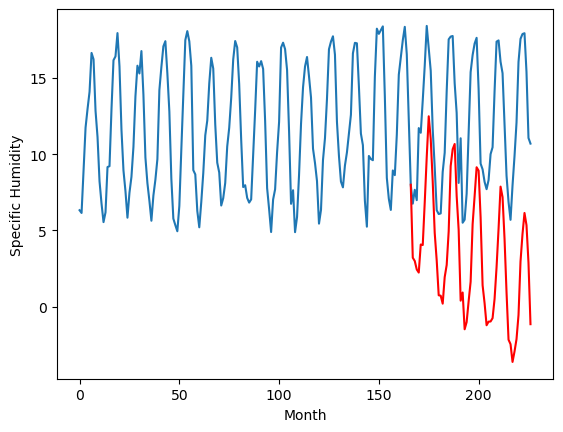

Weather Station 6:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
4.76		2.89		-1.87
3.28		2.67		-0.61
3.00		2.11		-0.89
3.18		1.91		-1.27
5.85		3.75		-2.10
4.84		3.72		-1.12
7.52		6.52		-1.00
9.34		9.49		0.15
10.33		12.16		1.83
9.10		10.68		1.58
8.67		7.88		-0.79
5.16		4.51		-0.65
4.60		2.70		-1.90
2.16		0.42		-1.74
2.99		0.39		-2.60
2.36		-0.13		-2.49
3.15		1.61		-1.54
4.45		2.41		-2.04
8.76		4.61		-4.15
10.93		8.90		-2.03
12.26		10.00		-2.26
12.48		10.35		-2.13
8.94		6.94		-2.00
5.83		4.71		-1.12
3.99		0.07		-3.92
2.94		0.60		-2.34
1.67		-1.81		-3.48
1.55		-1.34		-2.89
2.10		0.03		-2.07
4.37		1.31		-3.06
6.14		5.08		-1.06
8.74		6.93		-1.81
9.69		8.82		-0.87
11.80		8.59		-3.21
10.53		5.54		-4.99
7.34		1.08		-6.26
4.47		-0.10		-4.57
3.80		-1.55		-5.35
2.25		-1.31		-3.56
2.28		-1.30		-3.58
3.33		-1.08		-4.41
3.59		0.18		-3.41
7.96		2.27		-5.69
7.91		4.78		-3.13
10.08		7.55		-2.53
10.23		6.86		-3.37
9.87		4.11		-5.76
7.89		0.60		-7.29
5.26		-2.49		-7.75
3.39	

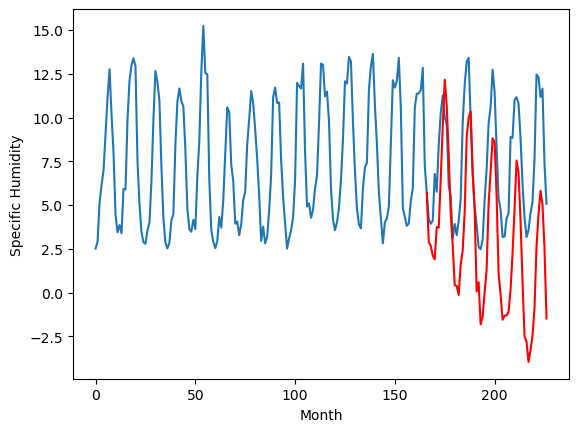

Weather Station 7:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
-2.55		-0.92		1.63
-2.52		-1.14		1.38
-2.94		-1.70		1.24
-2.46		-1.90		0.56
-0.49		-0.06		0.43
-1.14		-0.09		1.05
2.06		2.71		0.65
5.70		5.68		-0.02
8.14		8.35		0.21
8.16		6.87		-1.29
4.85		4.07		-0.78
2.36		0.70		-1.66
-0.75		-1.11		-0.36
-3.47		-3.39		0.08
-3.58		-3.42		0.16
-3.46		-3.94		-0.48
-1.90		-2.20		-0.30
-1.28		-1.40		-0.12
1.65		0.80		-0.85
6.00		5.09		-0.91
8.50		6.19		-2.31
8.79		6.54		-2.25
5.44		3.13		-2.31
3.31		0.90		-2.41
-2.62		-3.74		-1.12
-0.75		-3.21		-2.46
-3.75		-5.62		-1.87
-2.62		-5.15		-2.53
-1.87		-3.78		-1.91
-0.68		-2.50		-1.82
3.58		1.27		-2.31
6.30		3.12		-3.18
9.29		5.01		-4.28
8.20		4.78		-3.42
4.72		1.73		-2.99
-0.34		-2.73		-2.39
-0.83		-3.91		-3.08
-2.73		-5.36		-2.63
-2.37		-5.12		-2.75
-1.17		-5.11		-3.94
-1.93		-4.89		-2.96
-0.12		-3.63		-3.51
2.44		-1.54		-3.98
5.02		0.97		-4.05
8.64		3.74		-4.90
8.53		3.05		-5.48
5.56		0.30		-5.26
1.31		-3.21		-4.52

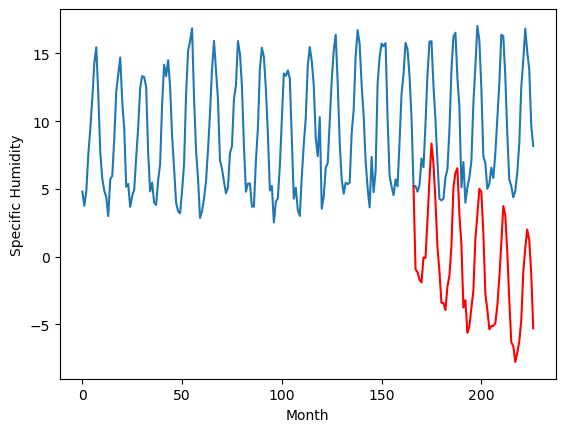

Weather Station 8:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
1.26		1.37		0.11
0.93		1.15		0.22
0.85		0.59		-0.26
0.73		0.39		-0.34
3.39		2.23		-1.16
3.65		2.20		-1.45
6.55		5.00		-1.55
10.38		7.97		-2.41
13.46		10.64		-2.82
11.29		9.16		-2.13
9.49		6.36		-3.13
4.67		2.99		-1.68
2.65		1.18		-1.47
0.33		-1.10		-1.43
0.20		-1.13		-1.33
-0.32		-1.65		-1.33
2.41		0.09		-2.32
3.64		0.89		-2.75
6.85		3.09		-3.76
11.61		7.38		-4.23
12.24		8.48		-3.76
12.09		8.83		-3.26
8.84		5.42		-3.42
6.11		3.19		-2.92
1.55		-1.45		-3.00
3.19		-0.92		-4.11
-0.56		-3.33		-2.77
0.12		-2.86		-2.98
1.65		-1.49		-3.14
3.84		-0.21		-4.05
8.29		3.56		-4.73
11.05		5.41		-5.64
12.02		7.30		-4.72
11.93		7.07		-4.86
7.97		4.02		-3.95
3.43		-0.44		-3.87
2.18		-1.62		-3.80
1.27		-3.07		-4.34
1.39		-2.83		-4.22
1.49		-2.82		-4.31
2.25		-2.60		-4.85
3.45		-1.34		-4.79
7.49		0.75		-6.74
10.41		3.26		-7.15
12.98		6.03		-6.95
12.56		5.34		-7.22
8.07		2.59		-5.48
4.82		-0.92		-5.74
2.11		-4.01

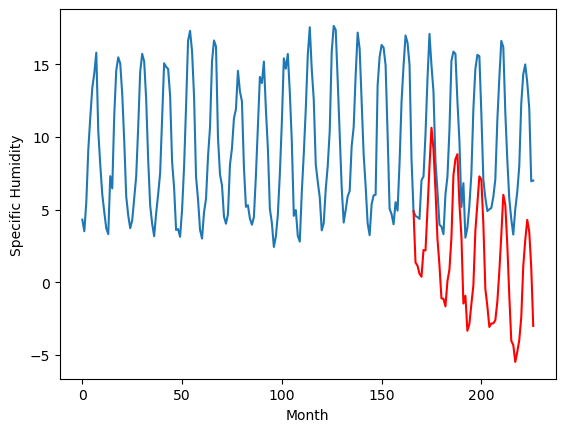

Weather Station 9:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
2.02		0.88		-1.14
1.18		0.66		-0.52
1.63		0.10		-1.53
1.01		-0.10		-1.11
4.03		1.74		-2.29
4.22		1.71		-2.51
7.55		4.51		-3.04
9.69		7.48		-2.21
13.05		10.15		-2.90
10.15		8.67		-1.48
8.67		5.87		-2.80
4.00		2.50		-1.50
2.89		0.69		-2.20
0.61		-1.59		-2.20
0.77		-1.62		-2.39
-0.04		-2.14		-2.10
2.57		-0.40		-2.97
3.73		0.40		-3.33
7.95		2.60		-5.35
11.09		6.89		-4.20
12.14		7.99		-4.15
11.72		8.34		-3.38
8.15		4.93		-3.22
5.71		2.70		-3.01
2.18		-1.94		-4.12
1.57		-1.41		-2.98
-0.41		-3.82		-3.41
0.12		-3.35		-3.47
1.21		-1.98		-3.19
4.33		-0.70		-5.03
8.57		3.07		-5.50
10.47		4.92		-5.55
9.83		6.81		-3.02
10.57		6.58		-3.99
7.83		3.53		-4.30
3.88		-0.93		-4.81
2.90		-2.11		-5.01
1.16		-3.56		-4.72
0.68		-3.32		-4.00
1.01		-3.31		-4.32
2.43		-3.09		-5.52
3.65		-1.83		-5.48
8.70		0.26		-8.44
11.28		2.77		-8.51
11.51		5.54		-5.97
9.68		4.85		-4.83
8.73		2.10		-6.63
5.30		-1.41		-6.71
2.63		-4.5

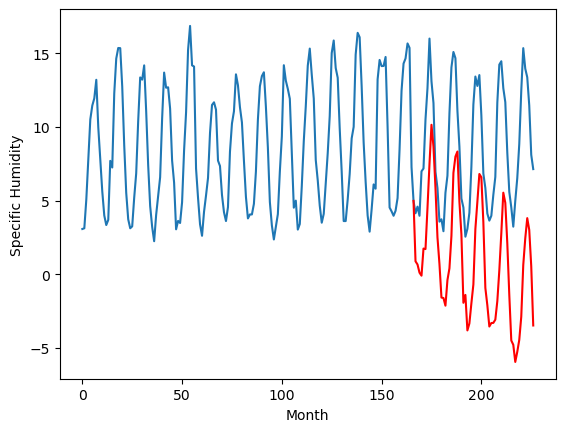

Weather Station 10:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
1.35		-0.37		-1.72
0.70		-0.59		-1.29
0.55		-1.15		-1.70
0.56		-1.35		-1.91
2.45		0.49		-1.96
2.61		0.46		-2.15
5.43		3.26		-2.17
7.14		6.23		-0.91
10.03		8.90		-1.13
8.71		7.42		-1.29
5.92		4.62		-1.30
2.40		1.25		-1.15
2.08		-0.56		-2.64
0.22		-2.84		-3.06
0.41		-2.87		-3.28
-0.33		-3.39		-3.06
1.49		-1.65		-3.14
1.66		-0.85		-2.51
6.81		1.35		-5.46
9.80		5.64		-4.16
11.04		6.74		-4.30
10.01		7.09		-2.92
7.05		3.68		-3.37
3.61		1.45		-2.16
1.25		-3.19		-4.44
0.27		-2.66		-2.93
-0.37		-5.07		-4.70
-0.45		-4.60		-4.15
0.51		-3.23		-3.74
1.48		-1.95		-3.43
4.04		1.82		-2.22
8.22		3.67		-4.55
8.87		5.56		-3.31
9.28		5.33		-3.95
7.28		2.28		-5.00
3.89		-2.18		-6.07
1.91		-3.36		-5.27
0.70		-4.81		-5.51
0.39		-4.57		-4.96
0.25		-4.56		-4.81
1.04		-4.34		-5.38
1.56		-3.08		-4.64
7.29		-0.99		-8.28
8.90		1.52		-7.38
10.83		4.29		-6.54
8.92		3.60		-5.32
7.27		0.85		-6.42
4.16		-2.66		-6.82
1.84		-5

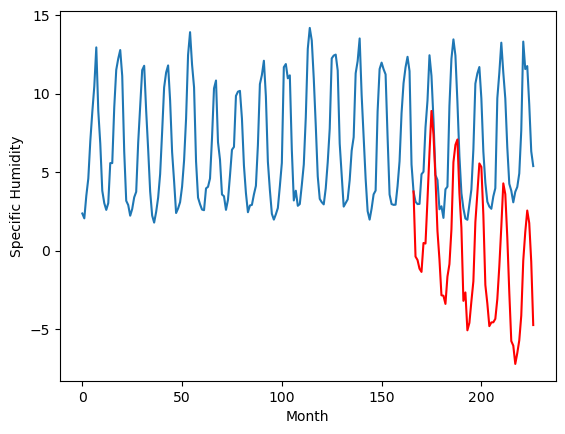

Weather Station 11:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
-1.82		-1.07		0.75
-1.83		-1.29		0.54
-1.98		-1.85		0.13
-1.91		-2.05		-0.14
-0.96		-0.21		0.75
-0.67		-0.24		0.43
1.90		2.56		0.66
5.54		5.53		-0.01
9.18		8.20		-0.98
9.09		6.72		-2.37
5.61		3.92		-1.69
2.69		0.55		-2.14
0.31		-1.26		-1.57
-1.85		-3.54		-1.69
-2.58		-3.57		-0.99
-2.54		-4.09		-1.55
-1.30		-2.35		-1.05
0.07		-1.55		-1.62
1.60		0.65		-0.95
6.92		4.94		-1.98
8.78		6.04		-2.74
9.12		6.39		-2.73
5.93		2.98		-2.95
4.07		0.75		-3.32
-1.12		-3.89		-2.77
-1.24		-3.36		-2.12
-2.85		-5.77		-2.92
-2.11		-5.30		-3.19
-1.09		-3.93		-2.84
-0.43		-2.65		-2.22
3.70		1.12		-2.58
5.29		2.97		-2.32
8.92		4.86		-4.06
8.49		4.63		-3.86
5.24		1.58		-3.66
1.80		-2.88		-4.68
0.30		-4.06		-4.36
-1.83		-5.51		-3.68
-0.97		-5.27		-4.30
-1.77		-5.26		-3.49
-1.74		-5.04		-3.30
0.87		-3.78		-4.65
1.17		-1.69		-2.86
4.46		0.82		-3.64
9.17		3.59		-5.58
6.88		2.90		-3.98
5.62		0.15		-5.47
2.57		-3.36		-5.93

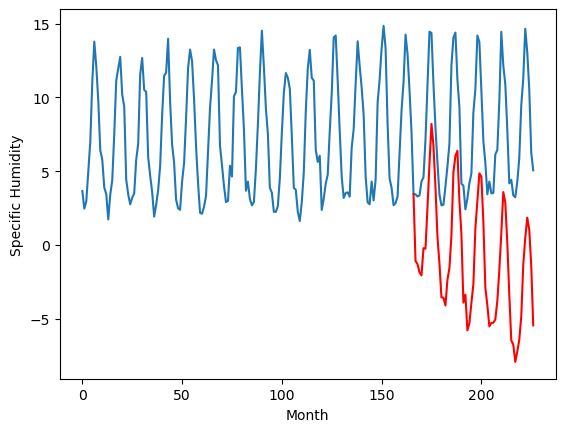

Predictions for (t+0):
    Weather_Station  Actual  Predicted
0                 0   -3.88  -1.074583
1                 1    1.11   2.985417
2                 2   -0.05   1.475417
3                 3    1.89   2.325417
4                 4    2.44   3.215417
5                 5    4.76   2.885417
6                 6   -2.55  -0.924582
7                 7    1.26   1.365417
8                 8    2.02   0.875417
9                 9    1.35  -0.374583
10               10   -1.82  -1.074582


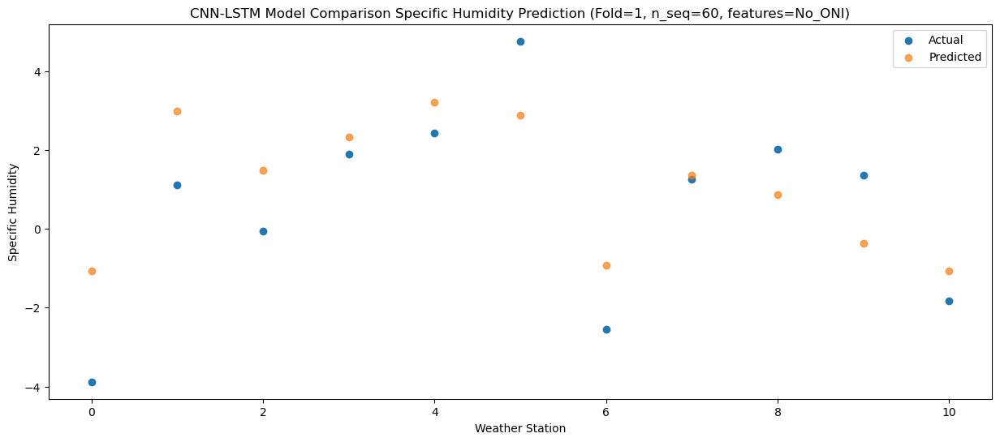

Predictions for (t+1):
    Weather_Station  Actual  Predicted
0                 0   -3.28  -1.290647
1                 1    1.16   2.769352
2                 2    0.86   1.259353
3                 3    0.69   2.109354
4                 4    1.20   2.999354
5                 5    3.28   2.669356
6                 6   -2.52  -1.140647
7                 7    0.93   1.149354
8                 8    1.18   0.659354
9                 9    0.70  -0.590645
10               10   -1.83  -1.290647


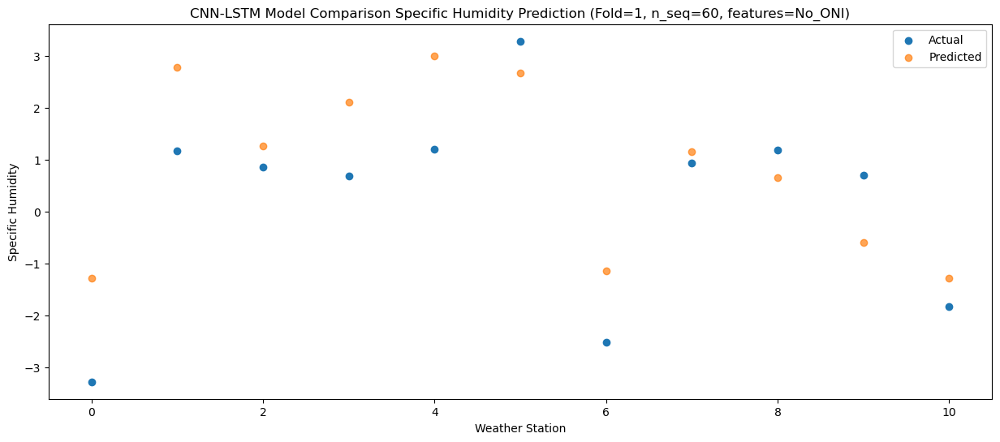

Predictions for (t+2):
    Weather_Station  Actual  Predicted
0                 0   -3.47  -1.847383
1                 1    0.91   2.212616
2                 2    0.35   0.702617
3                 3    1.59   1.552618
4                 4    2.11   2.442619
5                 5    3.00   2.112622
6                 6   -2.94  -1.697383
7                 7    0.85   0.592618
8                 8    1.63   0.102619
9                 9    0.55  -1.147379
10               10   -1.98  -1.847383


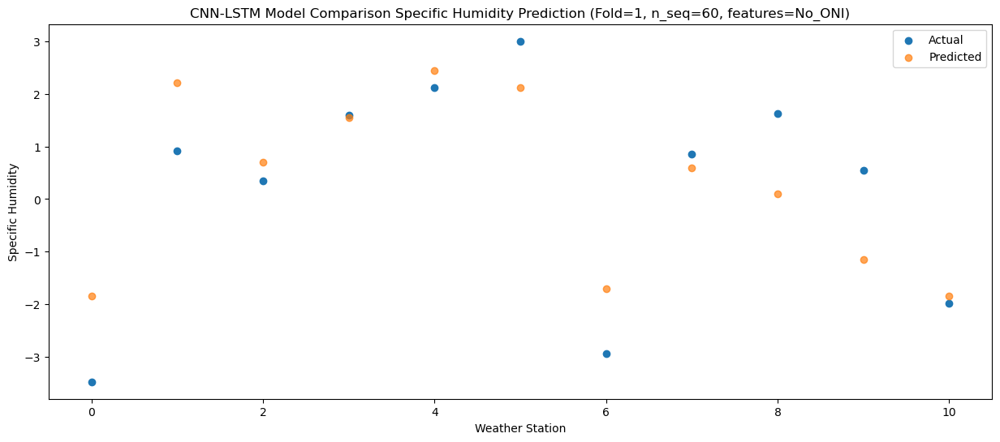

Predictions for (t+3):
    Weather_Station  Actual  Predicted
0                 0   -3.56  -2.050469
1                 1    1.43   2.009530
2                 2    0.74   0.499531
3                 3    0.89   1.349535
4                 4    1.43   2.239536
5                 5    3.18   1.909539
6                 6   -2.46  -1.900470
7                 7    0.73   0.389534
8                 8    1.01  -0.100465
9                 9    0.56  -1.350462
10               10   -1.91  -2.050470


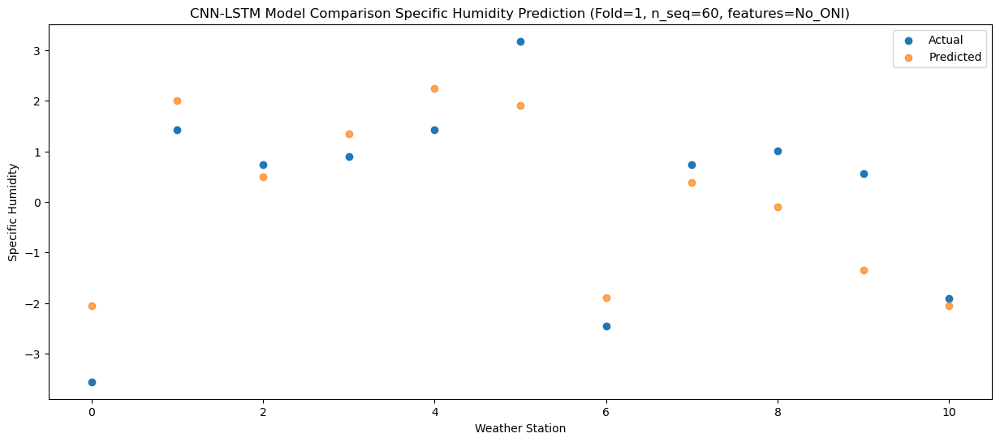

Predictions for (t+4):
    Weather_Station  Actual  Predicted
0                 0   -1.26  -0.206988
1                 1    3.66   3.853012
2                 2    3.90   2.343012
3                 3    5.25   3.193016
4                 4    6.16   4.083018
5                 5    5.85   3.753022
6                 6   -0.49  -0.056989
7                 7    3.39   2.233016
8                 8    4.03   1.743018
9                 9    2.45   0.493021
10               10   -0.96  -0.206989


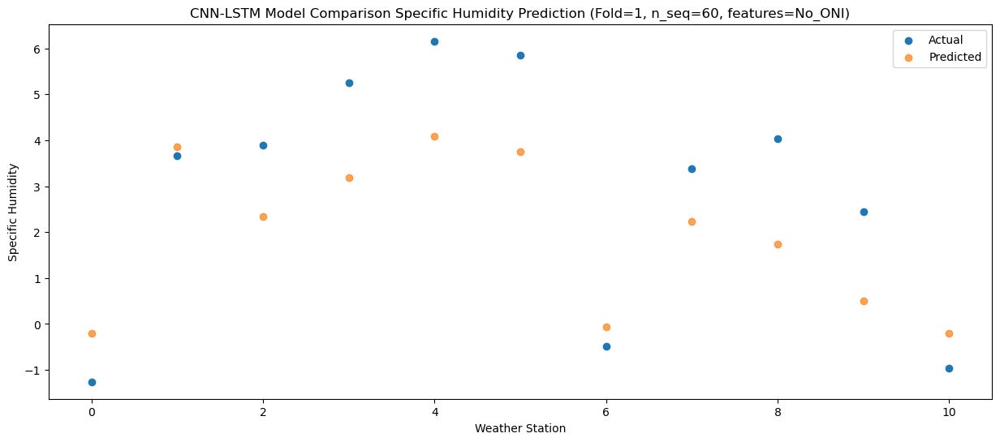

Predictions for (t+5):
    Weather_Station  Actual  Predicted
0                 0   -1.52  -0.244723
1                 1    2.07   3.815278
2                 2    2.28   2.305277
3                 3    4.91   3.155281
4                 4    5.85   4.045283
5                 5    4.84   3.715286
6                 6   -1.14  -0.094722
7                 7    3.65   2.195282
8                 8    4.22   1.705283
9                 9    2.61   0.455286
10               10   -0.67  -0.244722


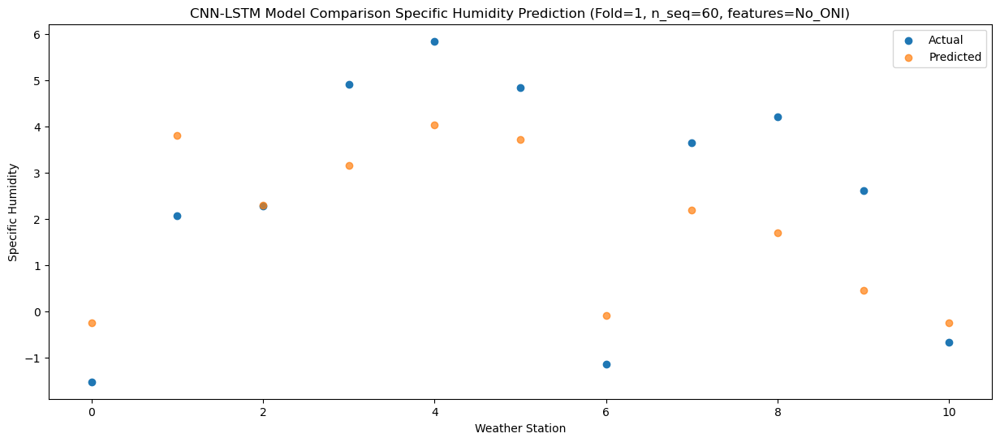

Predictions for (t+6):
    Weather_Station  Actual  Predicted
0                 0    1.38   2.561953
1                 1    5.08   6.621954
2                 2    5.05   5.111953
3                 3    6.89   5.961956
4                 4    7.97   6.851958
5                 5    7.52   6.521960
6                 6    2.06   2.711954
7                 7    6.55   5.001957
8                 8    7.55   4.511958
9                 9    5.43   3.261960
10               10    1.90   2.561954


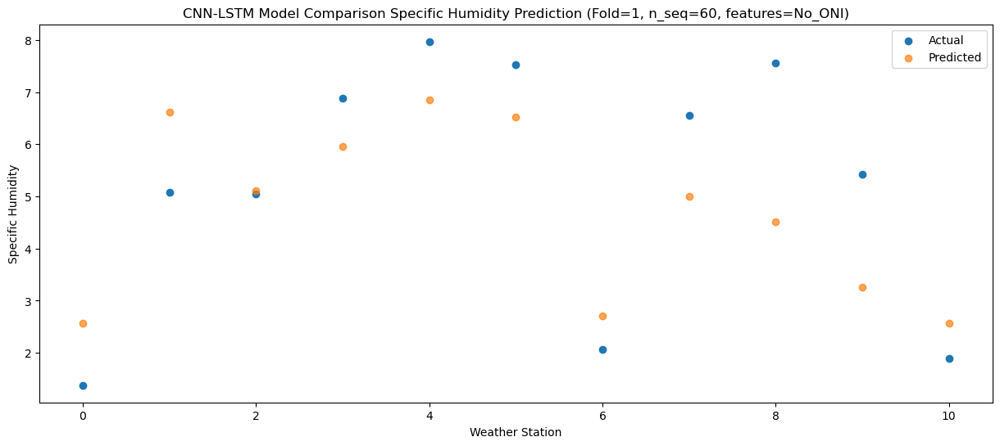

Predictions for (t+7):
    Weather_Station  Actual  Predicted
0                 0    4.62   5.531883
1                 1    8.88   9.591885
2                 2    8.90   8.081883
3                 3    9.01   8.931888
4                 4   10.26   9.821890
5                 5    9.34   9.491892
6                 6    5.70   5.681883
7                 7   10.38   7.971888
8                 8    9.69   7.481890
9                 9    7.14   6.231892
10               10    5.54   5.531883


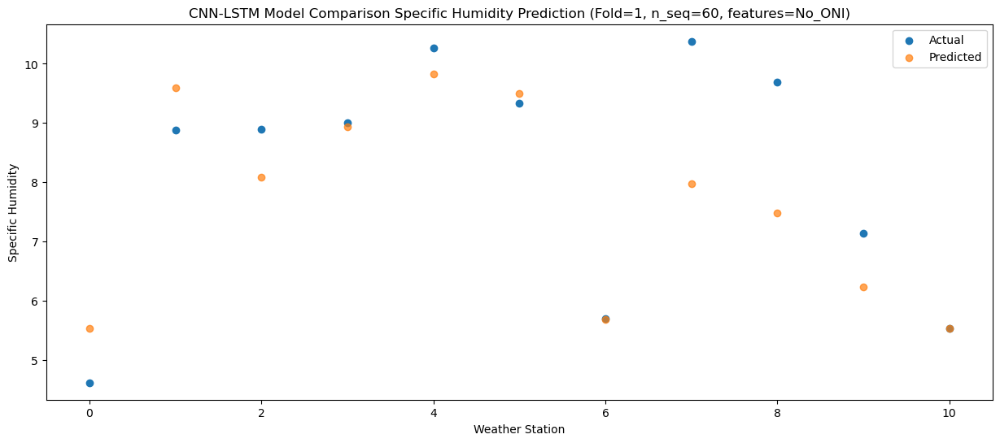

Predictions for (t+8):
    Weather_Station  Actual  Predicted
0                 0    7.19   8.202460
1                 1   10.92  12.262462
2                 2   11.45  10.752460
3                 3   11.52  11.602466
4                 4   12.86  12.492468
5                 5   10.33  12.162470
6                 6    8.14   8.352461
7                 7   13.46  10.642465
8                 8   13.05  10.152468
9                 9   10.03   8.902469
10               10    9.18   8.202461


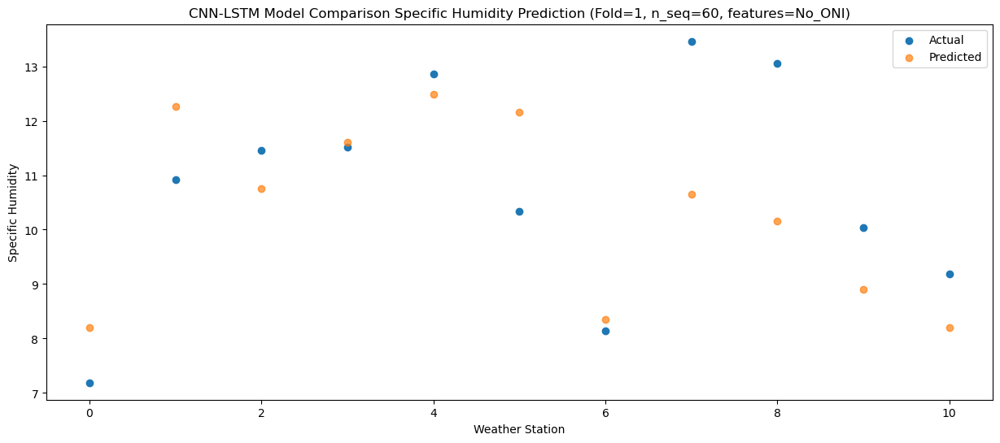

Predictions for (t+9):
    Weather_Station  Actual  Predicted
0                 0    7.48   6.721496
1                 1   10.97  10.781499
2                 2   10.97   9.271497
3                 3   10.41  10.121504
4                 4   11.41  11.011505
5                 5    9.10  10.681507
6                 6    8.16   6.871498
7                 7   11.29   9.161501
8                 8   10.15   8.671506
9                 9    8.71   7.421507
10               10    9.09   6.721497


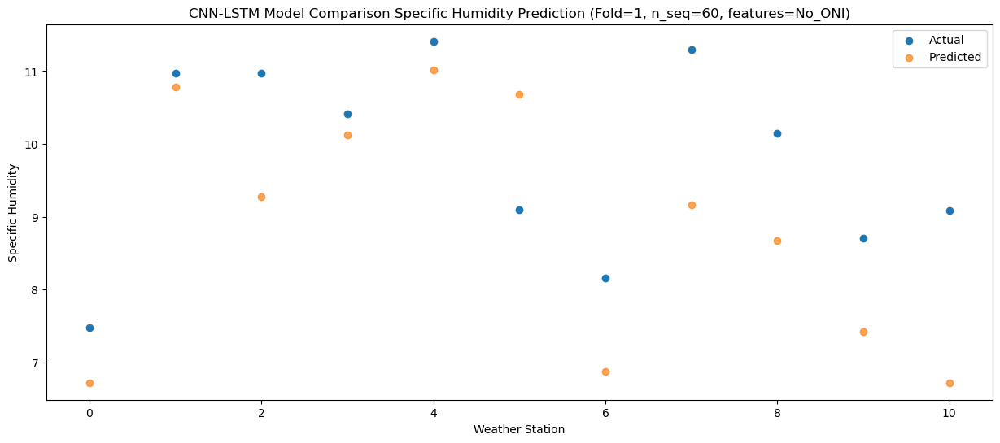

Predictions for (t+10):
    Weather_Station  Actual  Predicted
0                 0    4.86   3.918873
1                 1    8.07   7.978876
2                 2    8.02   6.468874
3                 3    8.83   7.318881
4                 4    9.92   8.208882
5                 5    8.67   7.878886
6                 6    4.85   4.068874
7                 7    9.49   6.358878
8                 8    8.67   5.868883
9                 9    5.92   4.618885
10               10    5.61   3.918873


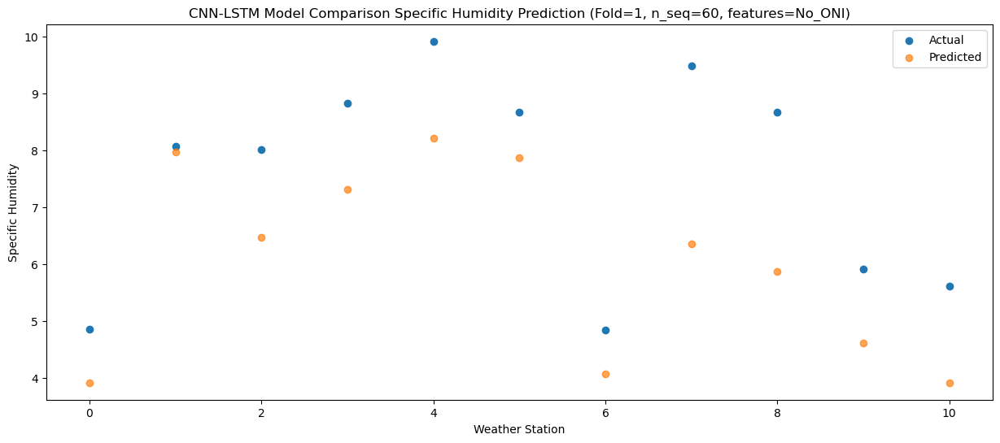

Predictions for (t+11):
    Weather_Station  Actual  Predicted
0                 0    2.18   0.551548
1                 1    5.40   4.611551
2                 2    5.26   3.101549
3                 3    5.43   3.951556
4                 4    6.07   4.841558
5                 5    5.16   4.511558
6                 6    2.36   0.701550
7                 7    4.67   2.991552
8                 8    4.00   2.501558
9                 9    2.40   1.251558
10               10    2.69   0.551549


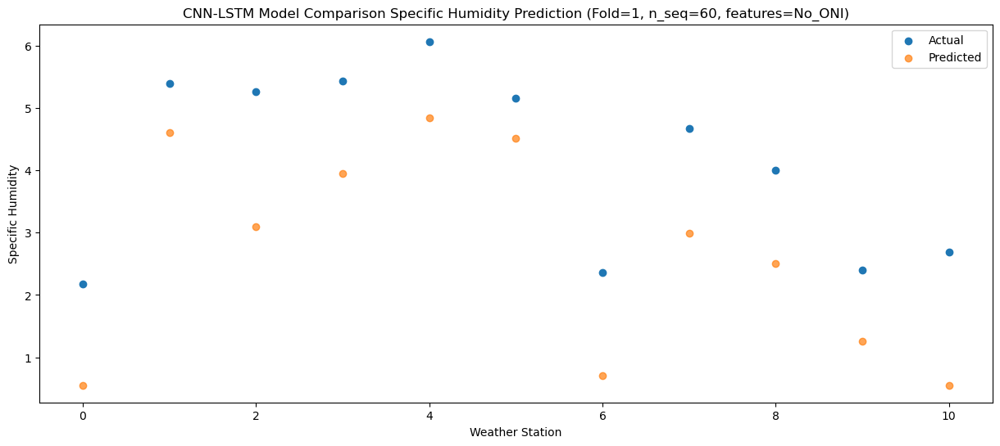

Predictions for (t+12):
    Weather_Station  Actual  Predicted
0                 0   -0.45  -1.259664
1                 1    2.34   2.800339
2                 2    2.08   1.290336
3                 3    3.33   2.140345
4                 4    3.59   3.030346
5                 5    4.60   2.700346
6                 6   -0.75  -1.109662
7                 7    2.65   1.180340
8                 8    2.89   0.690346
9                 9    2.08  -0.559654
10               10    0.31  -1.259664


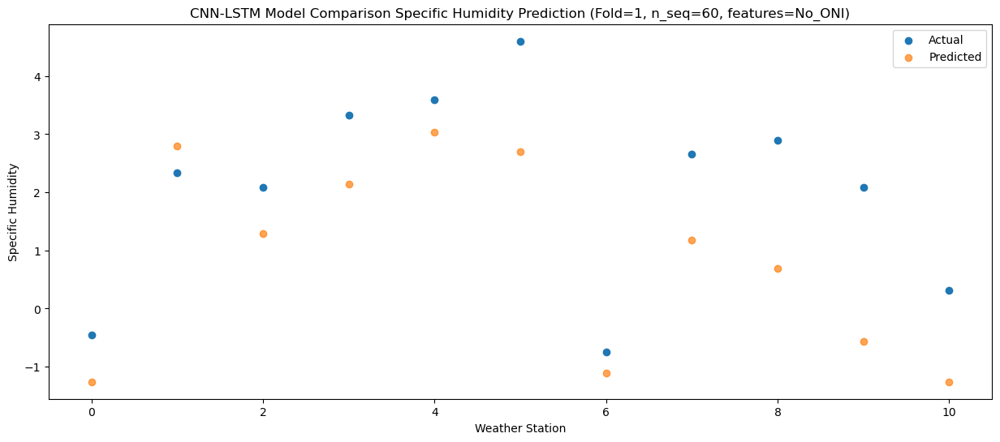

Predictions for (t+13):
    Weather_Station  Actual  Predicted
0                 0   -4.66  -3.538822
1                 1   -0.25   0.521182
2                 2   -0.69  -0.988821
3                 3    0.78  -0.138812
4                 4    0.77   0.751189
5                 5    2.16   0.421189
6                 6   -3.47  -3.388819
7                 7    0.33  -1.098817
8                 8    0.61  -1.588810
9                 9    0.22  -2.838811
10               10   -1.85  -3.538821


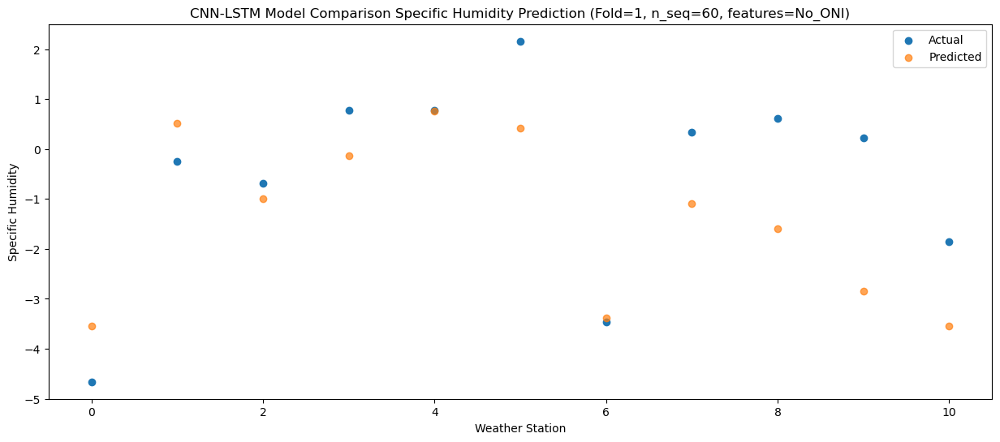

Predictions for (t+14):
    Weather_Station  Actual  Predicted
0                 0   -4.44  -3.568240
1                 1   -0.23   0.491764
2                 2   -0.54  -1.018239
3                 3    0.44  -0.168231
4                 4    0.52   0.721769
5                 5    2.99   0.391770
6                 6   -3.58  -3.418237
7                 7    0.20  -1.128235
8                 8    0.77  -1.618230
9                 9    0.41  -2.868230
10               10   -2.58  -3.568239


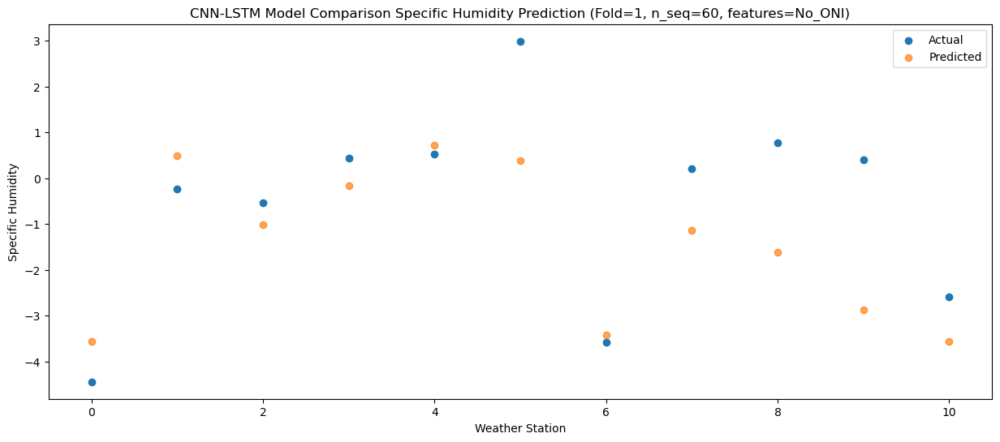

Predictions for (t+15):
    Weather_Station  Actual  Predicted
0                 0   -4.12  -4.088007
1                 1   -0.04  -0.028003
2                 2   -0.54  -1.538005
3                 3    0.51  -0.687999
4                 4    0.56   0.202002
5                 5    2.36  -0.127998
6                 6   -3.46  -3.938004
7                 7   -0.32  -1.648003
8                 8   -0.04  -2.137999
9                 9   -0.33  -3.387998
10               10   -2.54  -4.088006


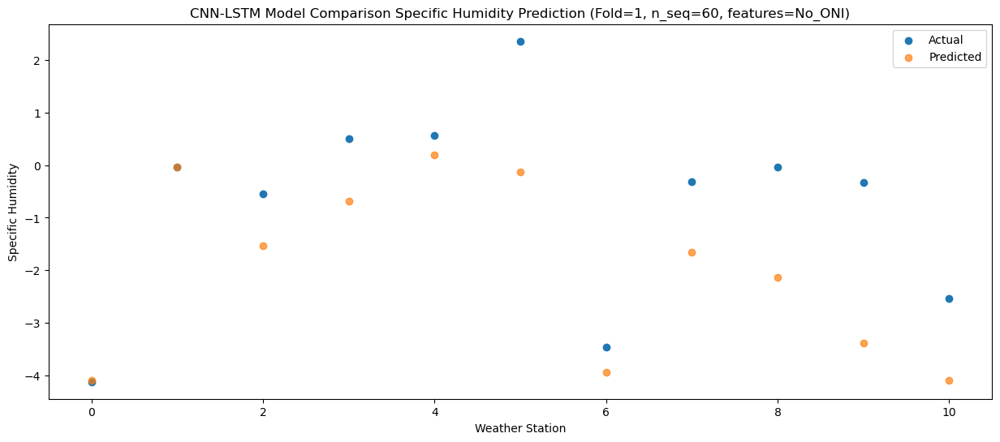

Predictions for (t+16):
    Weather_Station  Actual  Predicted
0                 0   -2.59  -2.349877
1                 1    1.49   1.710128
2                 2    2.08   0.200124
3                 3    3.15   1.050131
4                 4    3.28   1.940132
5                 5    3.15   1.610133
6                 6   -1.90  -2.199874
7                 7    2.41   0.090126
8                 8    2.57  -0.399868
9                 9    1.49  -1.649868
10               10   -1.30  -2.349876


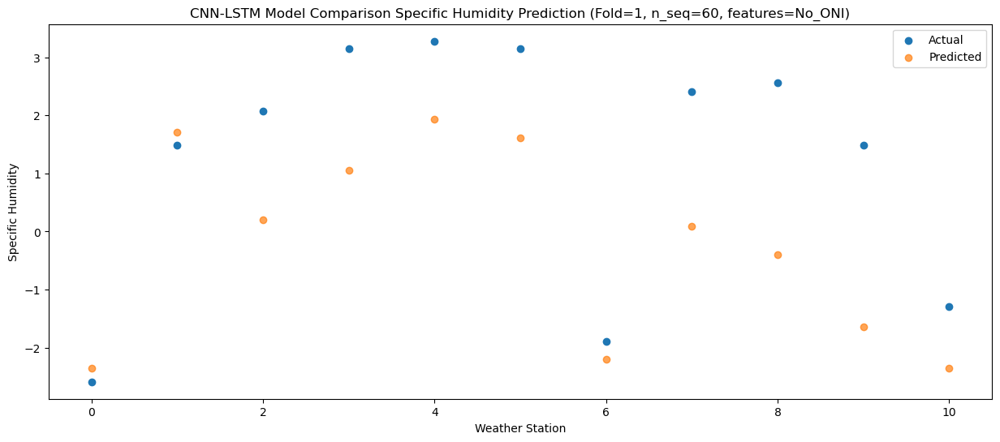

Predictions for (t+17):
    Weather_Station  Actual  Predicted
0                 0   -2.39  -1.552652
1                 1    1.85   2.507353
2                 2    1.79   0.997350
3                 3    4.49   1.847355
4                 4    4.54   2.737356
5                 5    4.45   2.407358
6                 6   -1.28  -1.402649
7                 7    3.64   0.887350
8                 8    3.73   0.397356
9                 9    1.66  -0.852642
10               10    0.07  -1.552651


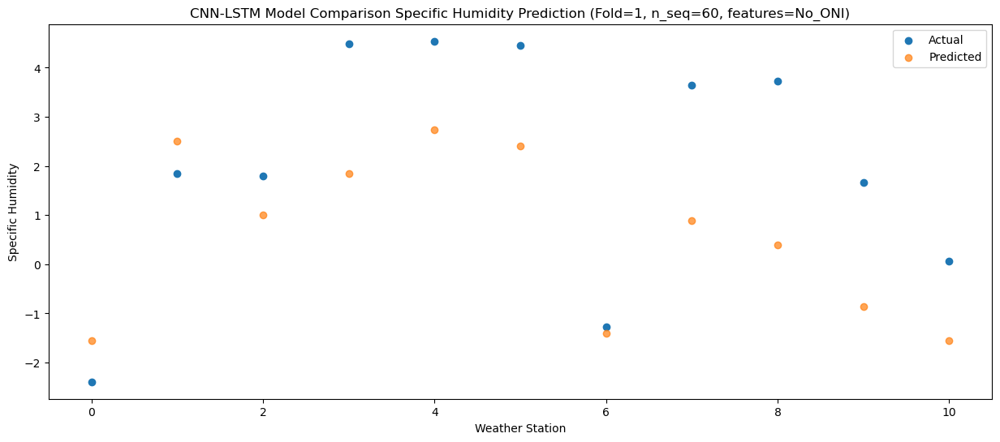

Predictions for (t+18):
    Weather_Station  Actual  Predicted
0                 0    0.29   0.652384
1                 1    4.77   4.712389
2                 2    4.63   3.202387
3                 3    8.38   4.052391
4                 4    8.57   4.942392
5                 5    8.76   4.612397
6                 6    1.65   0.802388
7                 7    6.85   3.092387
8                 8    7.95   2.602394
9                 9    6.81   1.352396
10               10    1.60   0.652386


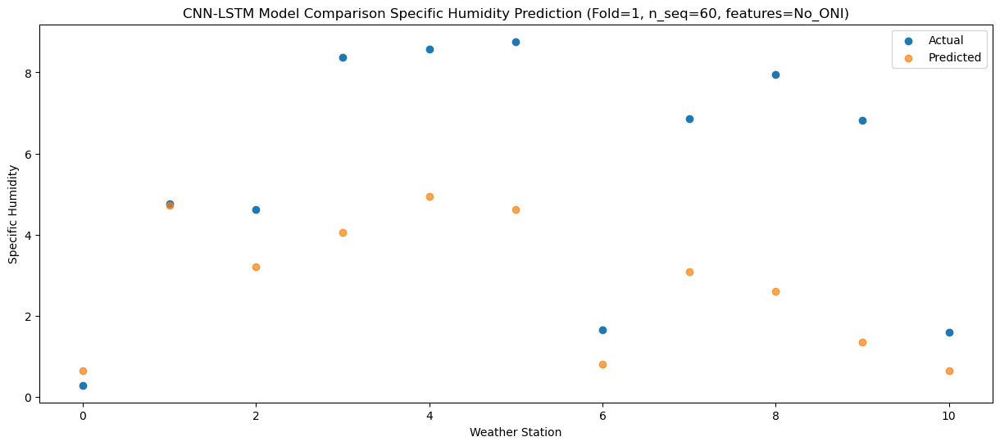

Predictions for (t+19):
    Weather_Station  Actual  Predicted
0                 0    5.45   4.936398
1                 1    8.75   8.996404
2                 2    9.15   7.486401
3                 3   11.57   8.336406
4                 4   11.98   9.226407
5                 5   10.93   8.896411
6                 6    6.00   5.086403
7                 7   11.61   7.376401
8                 8   11.09   6.886408
9                 9    9.80   5.636410
10               10    6.92   4.936400


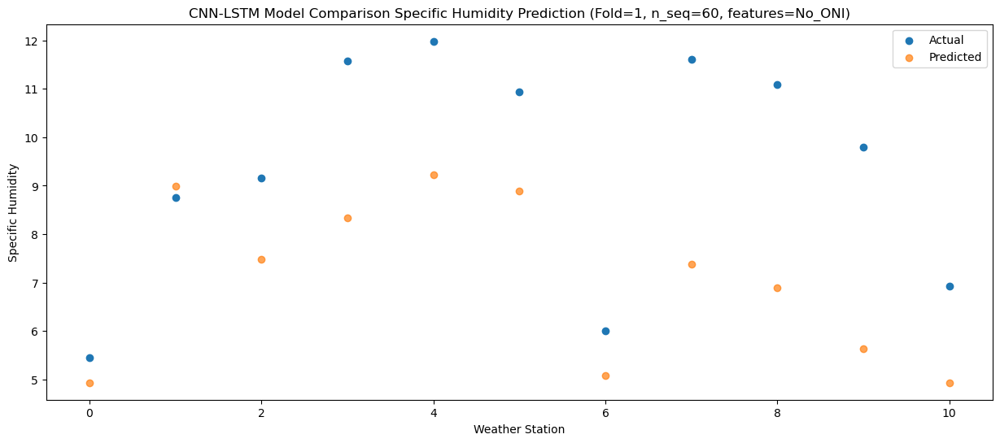

Predictions for (t+20):
    Weather_Station  Actual  Predicted
0                 0    6.60   6.040828
1                 1   10.62  10.100832
2                 2   10.74   8.590830
3                 3   12.05   9.440836
4                 4   12.16  10.330837
5                 5   12.26  10.000843
6                 6    8.50   6.190831
7                 7   12.24   8.480830
8                 8   12.14   7.990839
9                 9   11.04   6.740842
10               10    8.78   6.040829


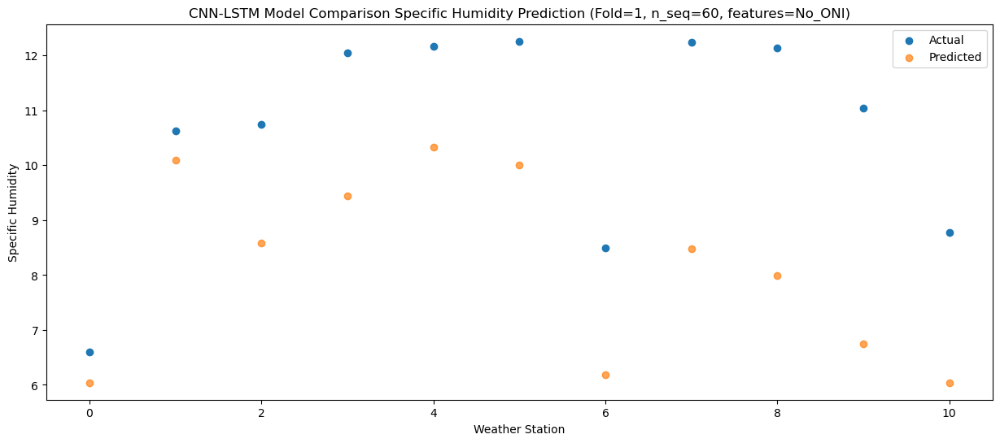

Predictions for (t+21):
    Weather_Station  Actual  Predicted
0                 0    7.36   6.385329
1                 1   10.83  10.445335
2                 2   10.96   8.935332
3                 3   12.39   9.785337
4                 4   12.20  10.675338
5                 5   12.48  10.345344
6                 6    8.79   6.535334
7                 7   12.09   8.825332
8                 8   11.72   8.335340
9                 9   10.01   7.085342
10               10    9.12   6.385330


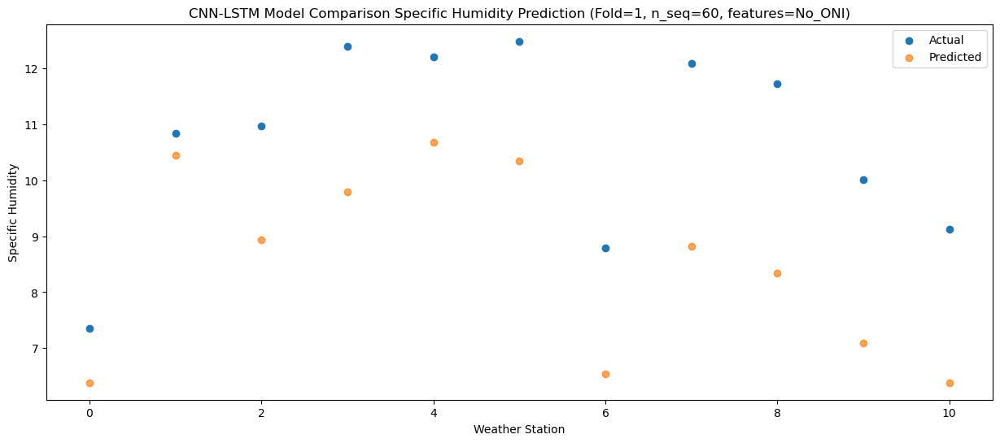

Predictions for (t+22):
    Weather_Station  Actual  Predicted
0                 0    3.88   2.975426
1                 1    7.88   7.035431
2                 2    8.20   5.525428
3                 3    9.30   6.375434
4                 4    9.10   7.265435
5                 5    8.94   6.935440
6                 6    5.44   3.125429
7                 7    8.84   5.415428
8                 8    8.15   4.925437
9                 9    7.05   3.675438
10               10    5.93   2.975426


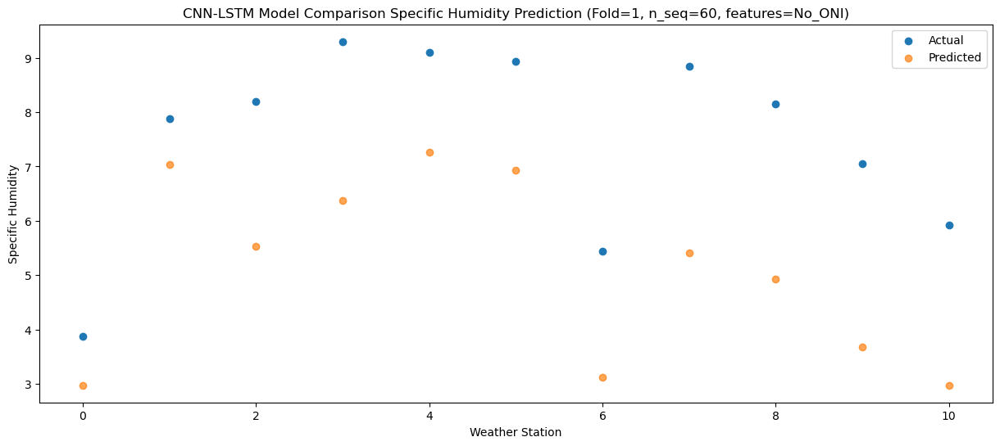

Predictions for (t+23):
    Weather_Station  Actual  Predicted
0                 0    1.30   0.750330
1                 1    5.84   4.810336
2                 2    5.45   3.300332
3                 3    7.05   4.150337
4                 4    7.15   5.040338
5                 5    5.83   4.710346
6                 6    3.31   0.900334
7                 7    6.11   3.190333
8                 8    5.71   2.700341
9                 9    3.61   1.450344
10               10    4.07   0.750330


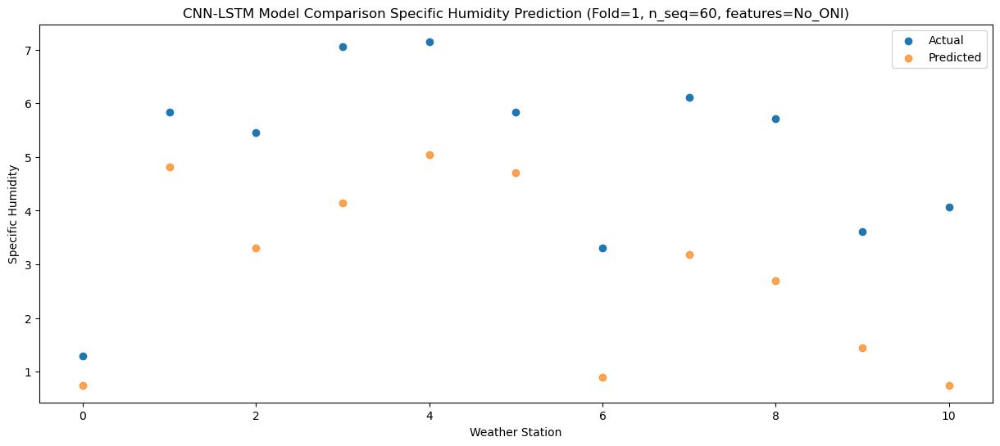

Predictions for (t+24):
    Weather_Station  Actual  Predicted
0                 0   -4.36  -3.892247
1                 1    0.25   0.167759
2                 2   -0.05  -1.342245
3                 3    2.60  -0.492238
4                 4    2.56   0.397763
5                 5    3.99   0.067771
6                 6   -2.62  -3.742242
7                 7    1.55  -1.452243
8                 8    2.18  -1.942234
9                 9    1.25  -3.192231
10               10   -1.12  -3.892247


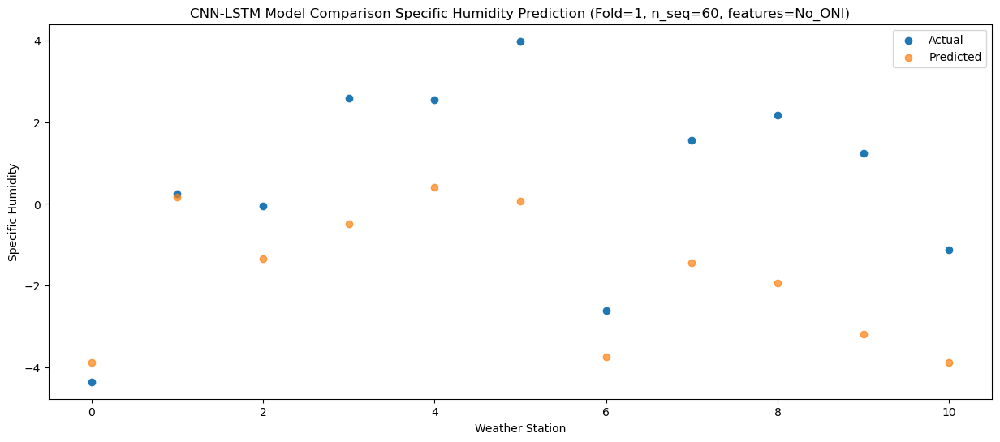

Predictions for (t+25):
    Weather_Station  Actual  Predicted
0                 0   -2.25  -3.358910
1                 1    2.42   0.701095
2                 2    2.59  -0.808909
3                 3    5.52   0.041100
4                 4    5.49   0.931101
5                 5    2.94   0.601109
6                 6   -0.75  -3.208906
7                 7    3.19  -0.918906
8                 8    1.57  -1.408895
9                 9    0.27  -2.658893
10               10   -1.24  -3.358912


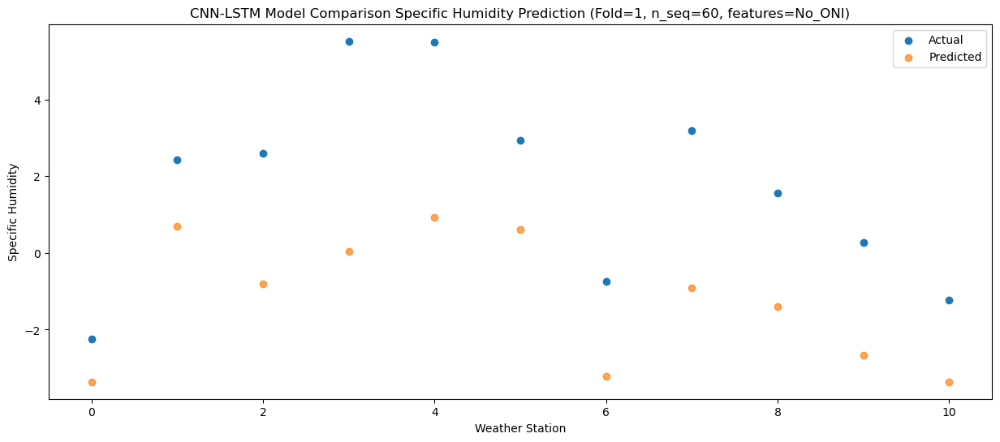

Predictions for (t+26):
    Weather_Station  Actual  Predicted
0                 0   -5.50  -5.769423
1                 1   -0.58  -1.709417
2                 2   -1.29  -3.219421
3                 3   -0.13  -2.369412
4                 4   -0.05  -1.479412
5                 5    1.67  -1.809402
6                 6   -3.75  -5.619419
7                 7   -0.56  -3.329419
8                 8   -0.41  -3.819407
9                 9   -0.37  -5.069404
10               10   -2.85  -5.769425


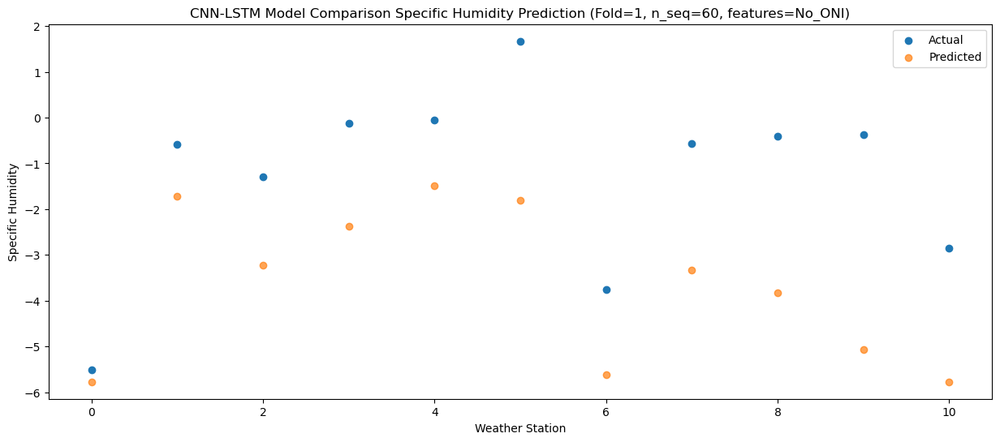

Predictions for (t+27):
    Weather_Station  Actual  Predicted
0                 0   -3.56  -5.297235
1                 1    0.37  -1.237230
2                 2   -0.26  -2.747233
3                 3    0.04  -1.897226
4                 4    0.15  -1.007226
5                 5    1.55  -1.337219
6                 6   -2.62  -5.147232
7                 7    0.12  -2.857232
8                 8    0.12  -3.347221
9                 9   -0.45  -4.597222
10               10   -2.11  -5.297238


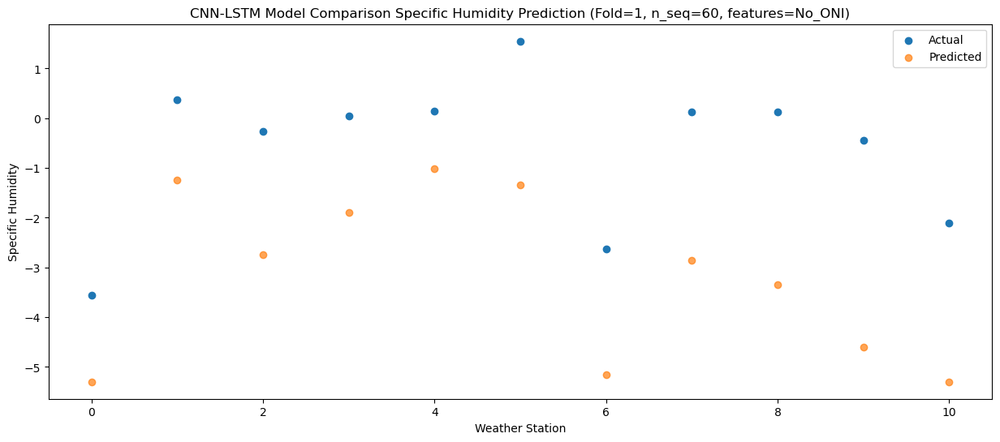

Predictions for (t+28):
    Weather_Station  Actual  Predicted
0                 0   -2.45  -3.930430
1                 1    1.05   0.129576
2                 2    0.53  -1.380428
3                 3    1.72  -0.530422
4                 4    1.85   0.359578
5                 5    2.10   0.029584
6                 6   -1.87  -3.780425
7                 7    1.65  -1.490425
8                 8    1.21  -1.980418
9                 9    0.51  -3.230419
10               10   -1.09  -3.930432


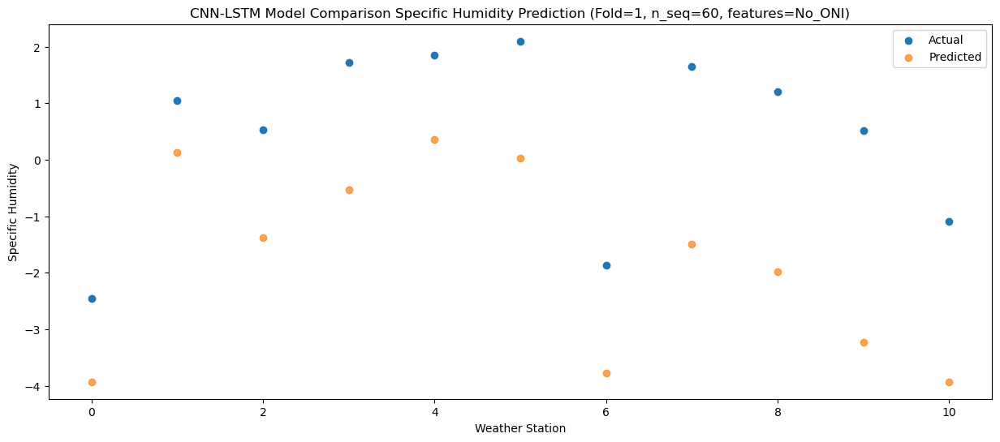

Predictions for (t+29):
    Weather_Station  Actual  Predicted
0                 0   -1.43  -2.649505
1                 1    2.11   1.410501
2                 2    2.29  -0.099503
3                 3    5.88   0.750503
4                 4    5.95   1.640503
5                 5    4.37   1.310510
6                 6   -0.68  -2.499500
7                 7    3.84  -0.209500
8                 8    4.33  -0.699493
9                 9    1.48  -1.949495
10               10   -0.43  -2.649507


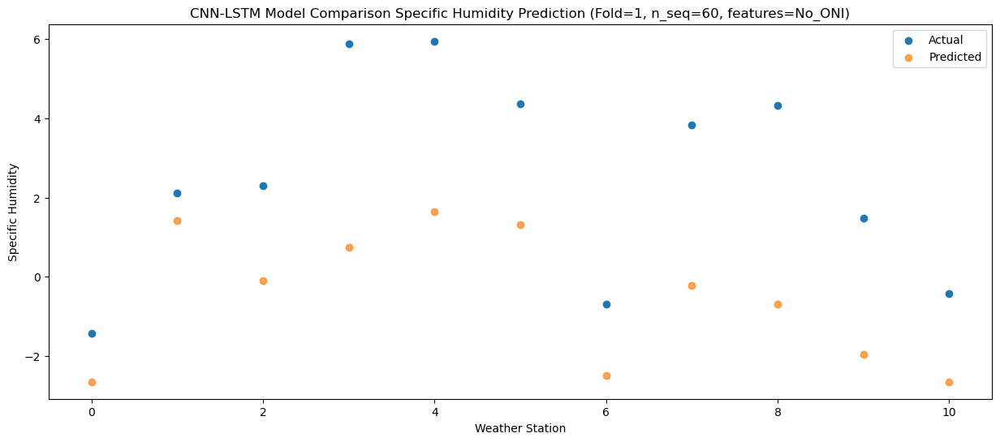

Predictions for (t+30):
    Weather_Station  Actual  Predicted
0                 0    2.55   1.123288
1                 1    6.28   5.183295
2                 2    6.65   3.673290
3                 3    9.69   4.523299
4                 4    9.83   5.413297
5                 5    6.14   5.083307
6                 6    3.58   1.273292
7                 7    8.29   3.563292
8                 8    8.57   3.073305
9                 9    4.04   1.823303
10               10    3.70   1.123285


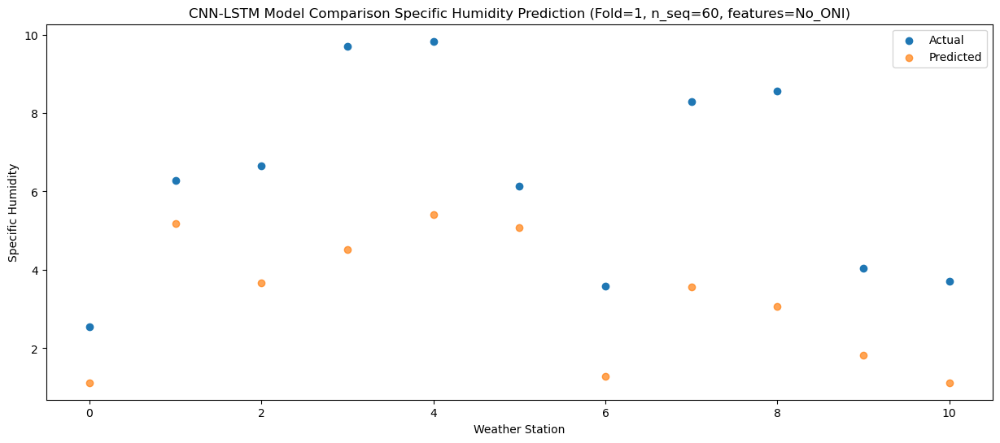

Predictions for (t+31):
    Weather_Station  Actual  Predicted
0                 0    4.85   2.966989
1                 1    8.68   7.026996
2                 2    9.74   5.516992
3                 3   10.74   6.367000
4                 4   10.95   7.256999
5                 5    8.74   6.927008
6                 6    6.30   3.116994
7                 7   11.05   5.406994
8                 8   10.47   4.917006
9                 9    8.22   3.667004
10               10    5.29   2.966987


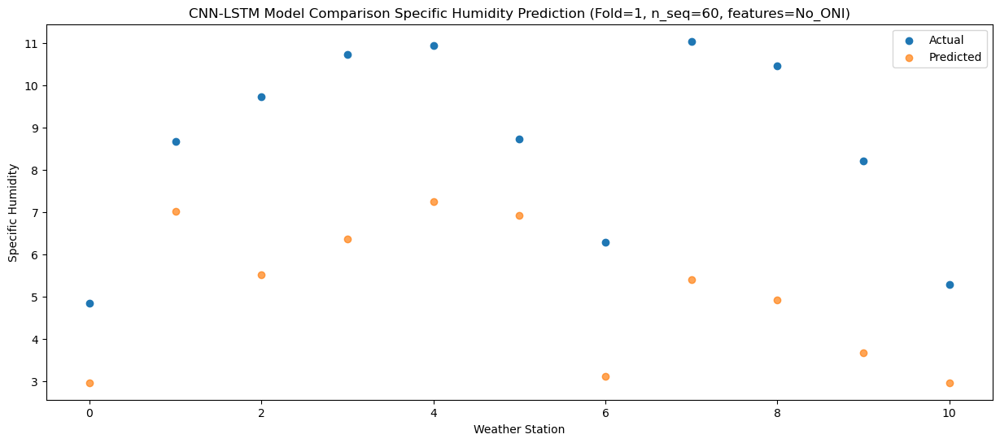

Predictions for (t+32):
    Weather_Station  Actual  Predicted
0                 0    7.47   4.858455
1                 1   11.35   8.918462
2                 2   11.37   7.408457
3                 3   11.66   8.258466
4                 4   11.70   9.148464
5                 5    9.69   8.818473
6                 6    9.29   5.008459
7                 7   12.02   7.298459
8                 8    9.83   6.808473
9                 9    8.87   5.558469
10               10    8.92   4.858452


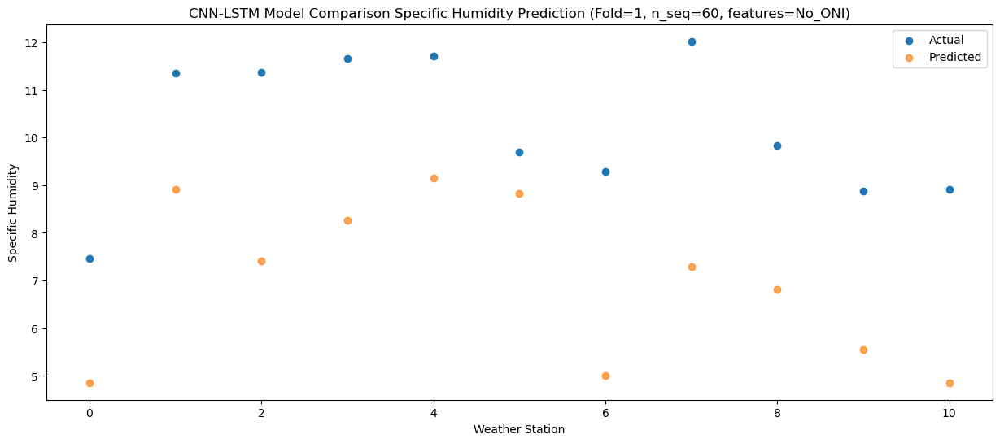

Predictions for (t+33):
    Weather_Station  Actual  Predicted
0                 0    6.47   4.634251
1                 1   10.94   8.694257
2                 2   10.50   7.184253
3                 3   11.91   8.034263
4                 4   12.08   8.924261
5                 5   11.80   8.594271
6                 6    8.20   4.784254
7                 7   11.93   7.074257
8                 8   10.57   6.584271
9                 9    9.28   5.334267
10               10    8.49   4.634248


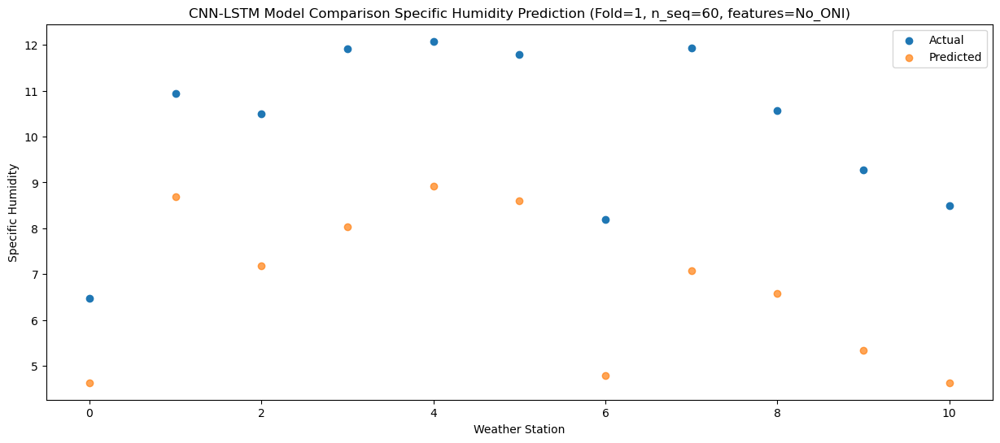

Predictions for (t+34):
    Weather_Station  Actual  Predicted
0                 0    3.85   1.577202
1                 1    7.58   5.637209
2                 2    6.99   4.127205
3                 3    8.62   4.977216
4                 4    8.73   5.867214
5                 5   10.53   5.537225
6                 6    4.72   1.727206
7                 7    7.97   4.017210
8                 8    7.83   3.527224
9                 9    7.28   2.277221
10               10    5.24   1.577199


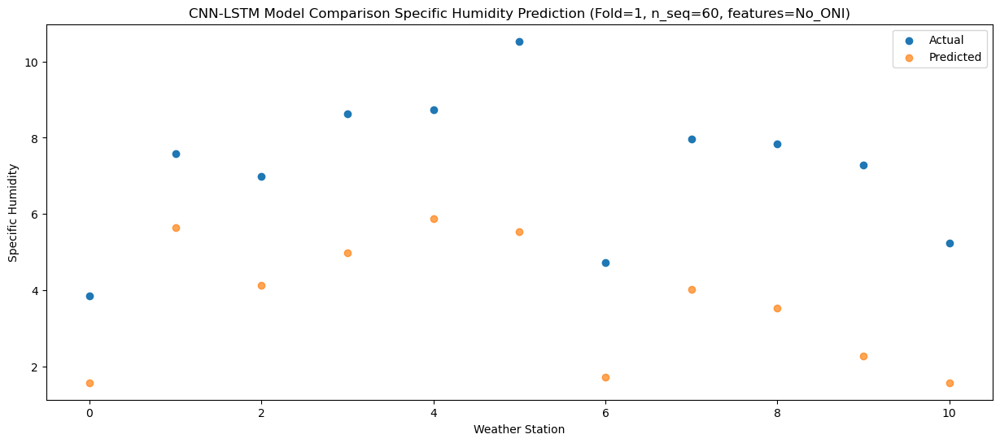

Predictions for (t+35):
    Weather_Station  Actual  Predicted
0                 0   -1.01  -2.882797
1                 1    2.69   1.177209
2                 2    1.88  -0.332795
3                 3    3.66   0.517216
4                 4    3.83   1.407214
5                 5    7.34   1.077223
6                 6   -0.34  -2.732793
7                 7    3.43  -0.442790
8                 8    3.88  -0.932776
9                 9    3.89  -2.182781
10               10    1.80  -2.882800


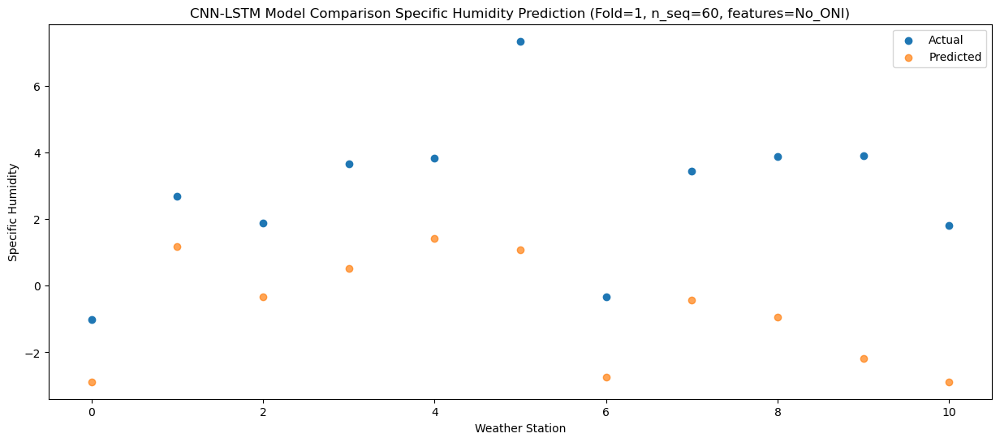

Predictions for (t+36):
    Weather_Station  Actual  Predicted
0                 0   -1.54  -4.063562
1                 1    2.21  -0.003556
2                 2    1.51  -1.513560
3                 3    3.16  -0.663549
4                 4    3.45   0.226449
5                 5    4.47  -0.103542
6                 6   -0.83  -3.913558
7                 7    2.18  -1.623555
8                 8    2.90  -2.113540
9                 9    1.91  -3.363546
10               10    0.30  -4.063565


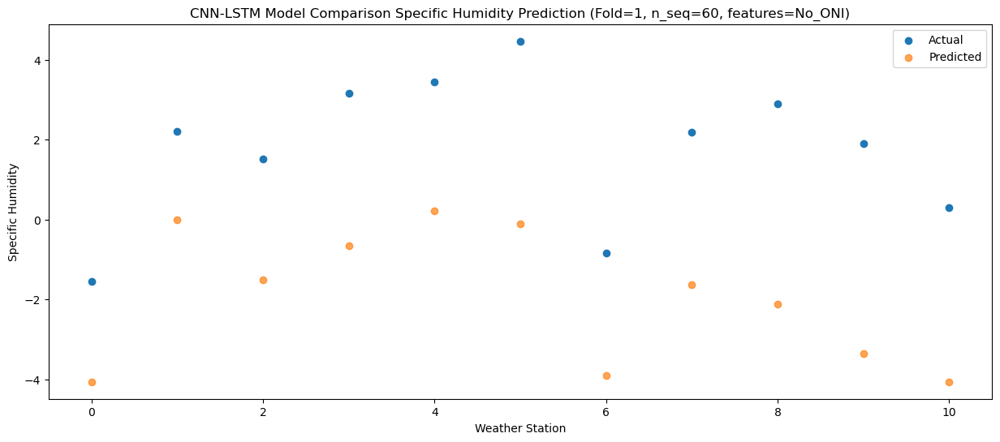

Predictions for (t+37):
    Weather_Station  Actual  Predicted
0                 0   -4.26  -5.506130
1                 1    0.62  -1.446124
2                 2    0.82  -2.956128
3                 3    2.35  -2.106118
4                 4    2.63  -1.216120
5                 5    3.80  -1.546112
6                 6   -2.73  -5.356127
7                 7    1.27  -3.066123
8                 8    1.16  -3.556109
9                 9    0.70  -4.806115
10               10   -1.83  -5.506133


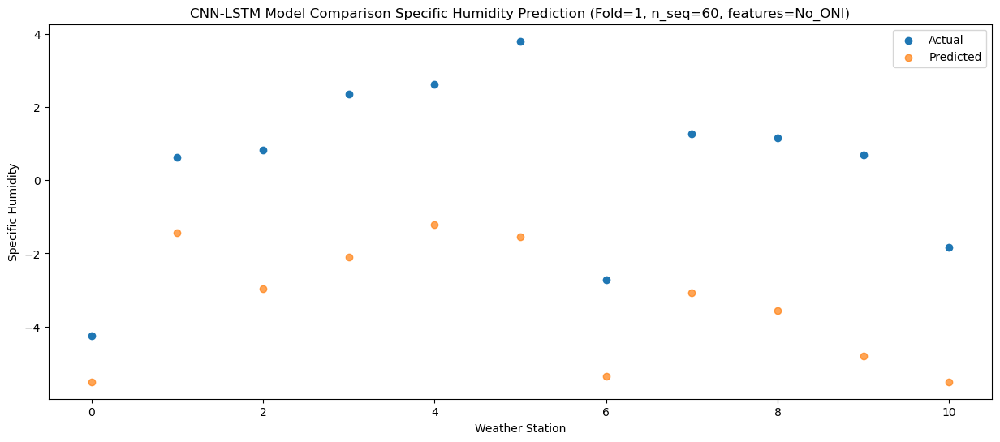

Predictions for (t+38):
    Weather_Station  Actual  Predicted
0                 0   -3.80  -5.268839
1                 1    1.03  -1.208833
2                 2    0.79  -2.718837
3                 3    1.93  -1.868826
4                 4    2.15  -0.978828
5                 5    2.25  -1.308820
6                 6   -2.37  -5.118835
7                 7    1.39  -2.828831
8                 8    0.68  -3.318818
9                 9    0.39  -4.568823
10               10   -0.97  -5.268842


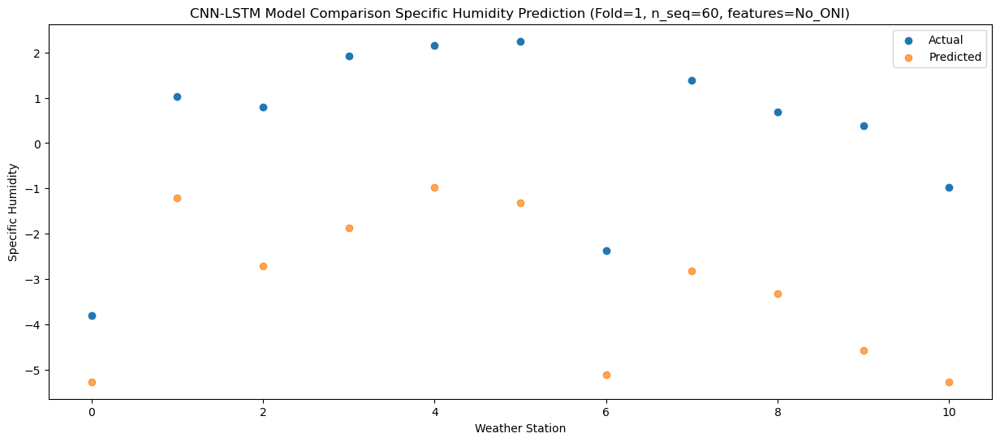

Predictions for (t+39):
    Weather_Station  Actual  Predicted
0                 0   -2.19  -5.258307
1                 1    2.15  -1.198301
2                 2    1.84  -2.708305
3                 3    2.71  -1.858293
4                 4    2.75  -0.968295
5                 5    2.28  -1.298287
6                 6   -1.17  -5.108304
7                 7    1.49  -2.818300
8                 8    1.01  -3.308284
9                 9    0.25  -4.558290
10               10   -1.77  -5.258310


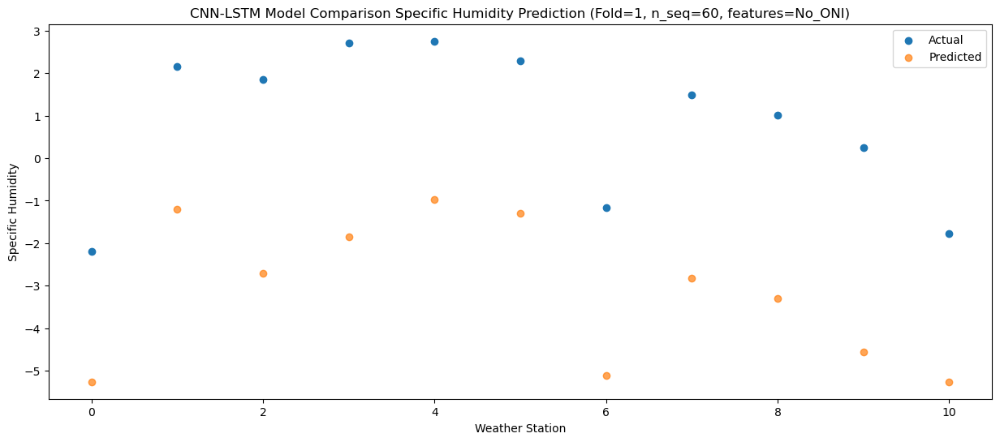

Predictions for (t+40):
    Weather_Station  Actual  Predicted
0                 0   -2.57  -5.040788
1                 1    1.28  -0.980781
2                 2    1.37  -2.490785
3                 3    4.26  -1.640774
4                 4    4.45  -0.750776
5                 5    3.33  -1.080769
6                 6   -1.93  -4.890784
7                 7    2.25  -2.600781
8                 8    2.43  -3.090767
9                 9    1.04  -4.340772
10               10   -1.74  -5.040791


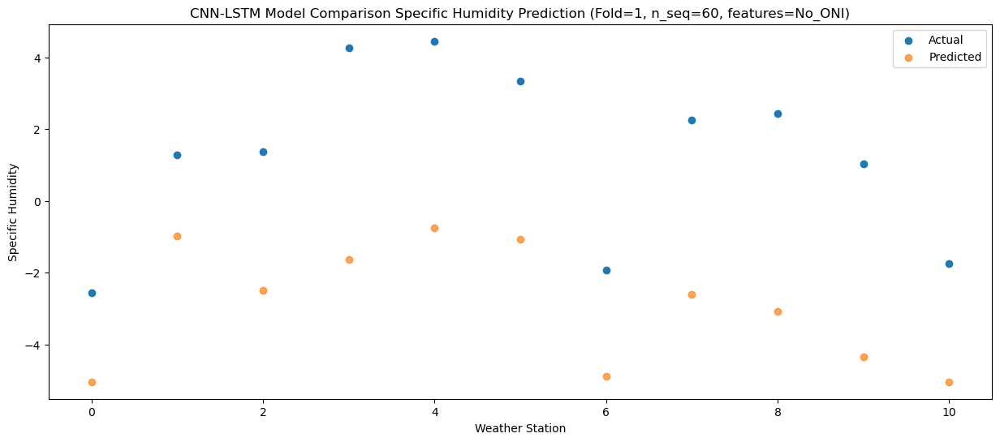

Predictions for (t+41):
    Weather_Station  Actual  Predicted
0                 0   -0.87  -3.779276
1                 1    2.88   0.280730
2                 2    2.73  -1.229273
3                 3    4.63  -0.379261
4                 4    4.90   0.510736
5                 5    3.59   0.180744
6                 6   -0.12  -3.629272
7                 7    3.45  -1.339268
8                 8    3.65  -1.829254
9                 9    1.56  -3.079259
10               10    0.87  -3.779278


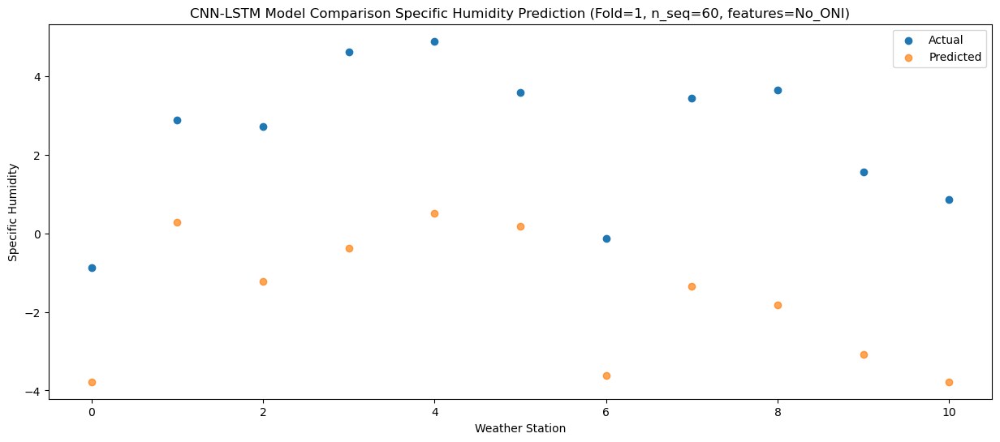

Predictions for (t+42):
    Weather_Station  Actual  Predicted
0                 0    0.33  -1.693859
1                 1    5.62   2.366147
2                 2    6.03   0.856144
3                 3    8.41   1.706157
4                 4    8.57   2.596154
5                 5    7.96   2.266163
6                 6    2.44  -1.543855
7                 7    7.49   0.746150
8                 8    8.70   0.256165
9                 9    7.29  -0.993840
10               10    1.17  -1.693861


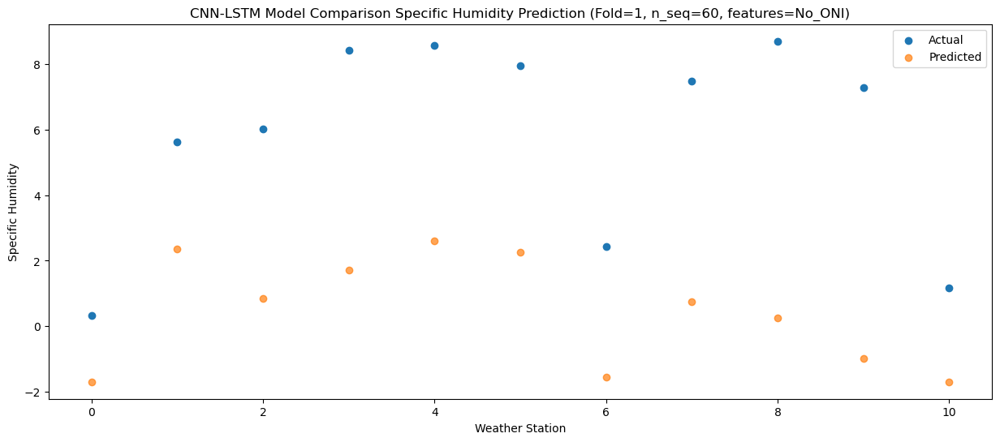

Predictions for (t+43):
    Weather_Station  Actual  Predicted
0                 0    3.68   0.819693
1                 1    7.97   4.879699
2                 2    8.68   3.369696
3                 3   11.81   4.219710
4                 4   11.83   5.109707
5                 5    7.91   4.779714
6                 6    5.02   0.969697
7                 7   10.41   3.259701
8                 8   11.28   2.769717
9                 9    8.90   1.519711
10               10    4.46   0.819690


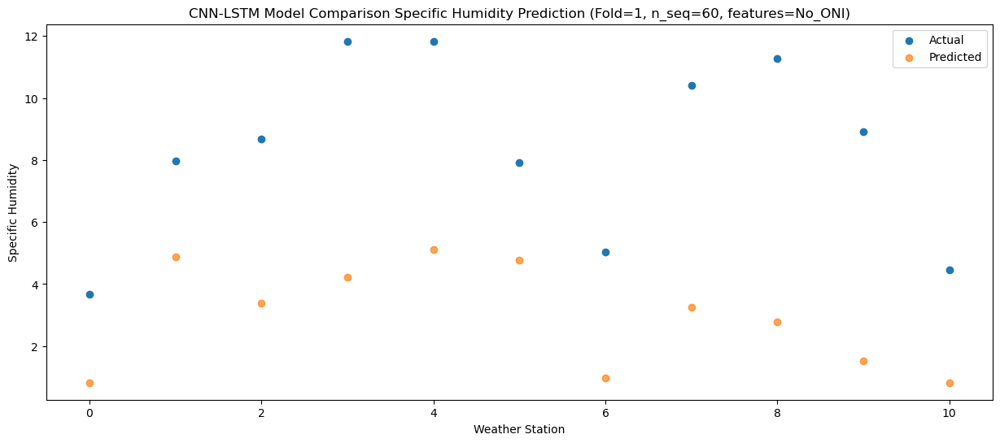

Predictions for (t+44):
    Weather_Station  Actual  Predicted
0                 0    7.09   3.588152
1                 1   10.93   7.648158
2                 2   11.82   6.138155
3                 3   12.37   6.988168
4                 4   11.91   7.878165
5                 5   10.08   7.548173
6                 6    8.64   3.738156
7                 7   12.98   6.028161
8                 8   11.51   5.538178
9                 9   10.83   4.288171
10               10    9.17   3.588147


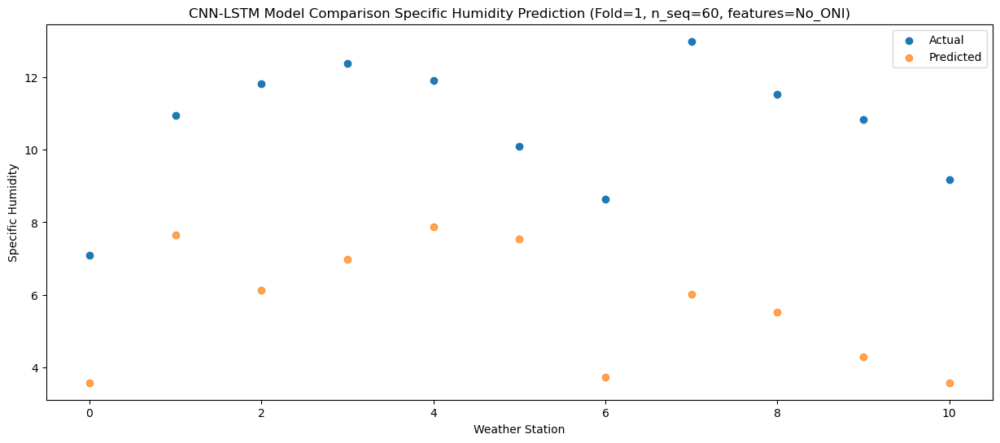

Predictions for (t+45):
    Weather_Station  Actual  Predicted
0                 0    6.92   2.900105
1                 1   11.06   6.960112
2                 2   11.75   5.450108
3                 3   10.70   6.300122
4                 4   10.51   7.190119
5                 5   10.23   6.860125
6                 6    8.53   3.050109
7                 7   12.56   5.340113
8                 8    9.68   4.850132
9                 9    8.92   3.600123
10               10    6.88   2.900101


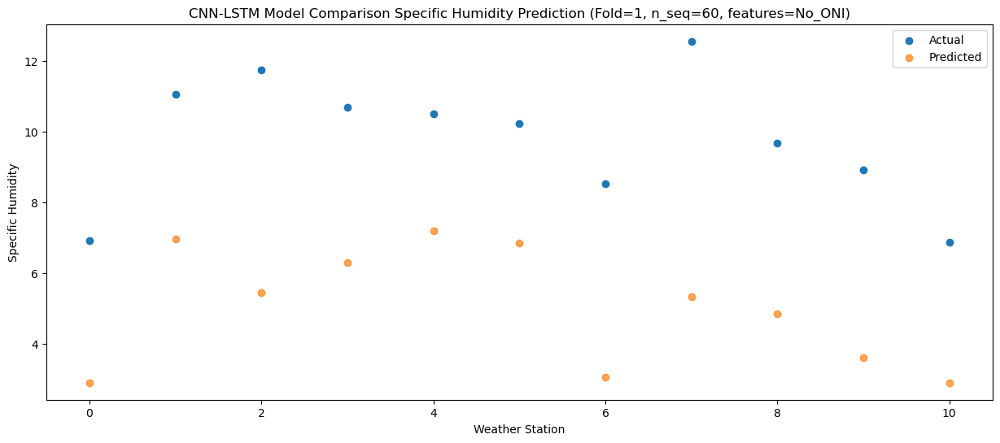

Predictions for (t+46):
    Weather_Station  Actual  Predicted
0                 0    3.06   0.153842
1                 1    7.95   4.213849
2                 2    7.94   2.703845
3                 3    9.50   3.553860
4                 4    9.76   4.443857
5                 5    9.87   4.113863
6                 6    5.56   0.303846
7                 7    8.07   2.593850
8                 8    8.73   2.103869
9                 9    7.27   0.853861
10               10    5.62   0.153837


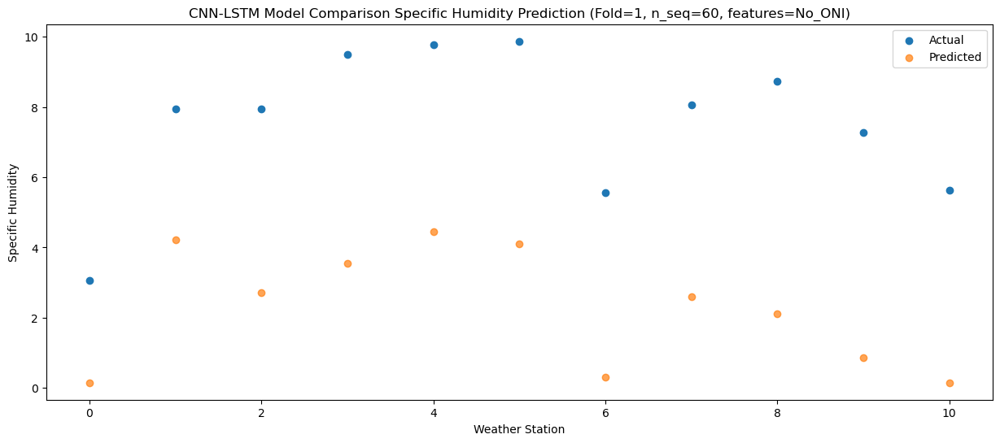

Predictions for (t+47):
    Weather_Station  Actual  Predicted
0                 0   -0.34  -3.357358
1                 1    4.10   0.702649
2                 2    3.43  -0.807355
3                 3    6.08   0.042661
4                 4    6.37   0.932658
5                 5    7.89   0.602663
6                 6    1.31  -3.207353
7                 7    4.82  -0.917349
8                 8    5.30  -1.407331
9                 9    4.16  -2.657339
10               10    2.57  -3.357362


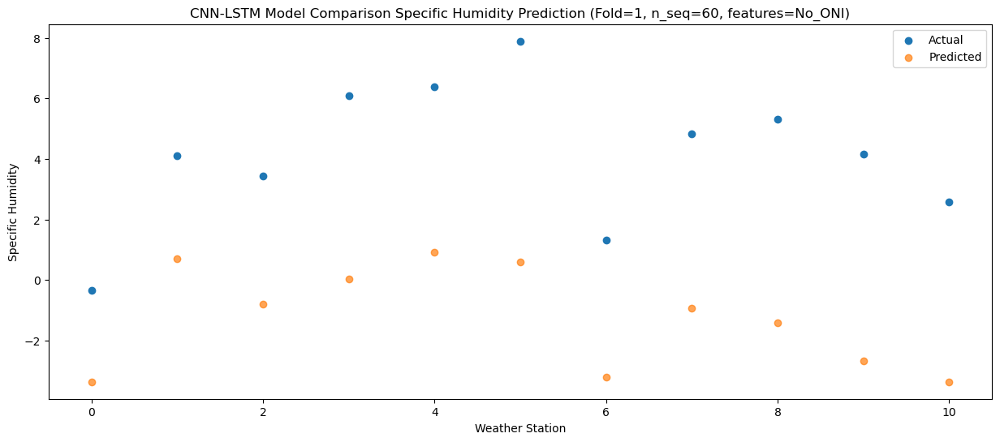

Predictions for (t+48):
    Weather_Station  Actual  Predicted
0                 0   -3.40  -6.454672
1                 1    1.09  -2.394665
2                 2    0.88  -3.904669
3                 3    2.75  -3.054653
4                 4    3.03  -2.164656
5                 5    5.26  -2.494652
6                 6   -2.04  -6.304668
7                 7    2.11  -4.014664
8                 8    2.63  -4.504646
9                 9    1.84  -5.754654
10               10   -1.09  -6.454677


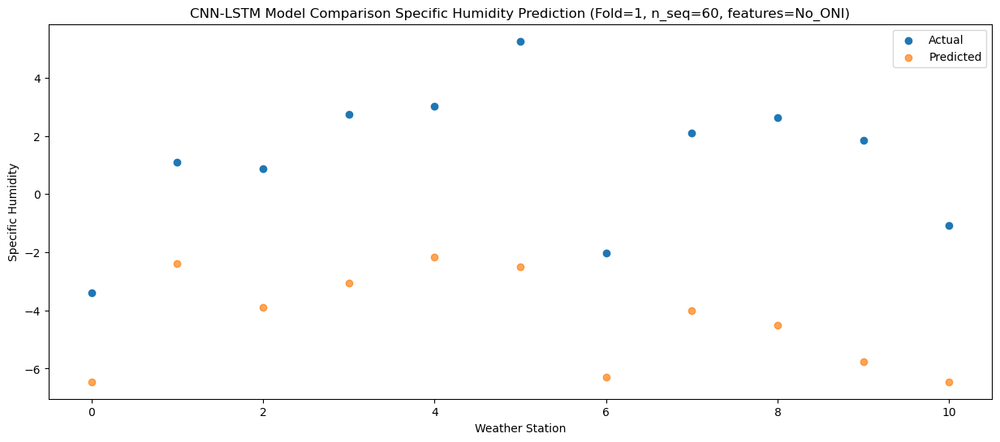

Predictions for (t+49):
    Weather_Station  Actual  Predicted
0                 0   -4.15  -6.746852
1                 1    0.51  -2.686846
2                 2   -0.14  -4.196850
3                 3    1.11  -3.346831
4                 4    1.31  -2.456834
5                 5    3.39  -2.786829
6                 6   -2.54  -6.596848
7                 7    0.72  -4.306844
8                 8    1.58  -4.796824
9                 9    1.40  -6.046831
10               10   -0.85  -6.746857


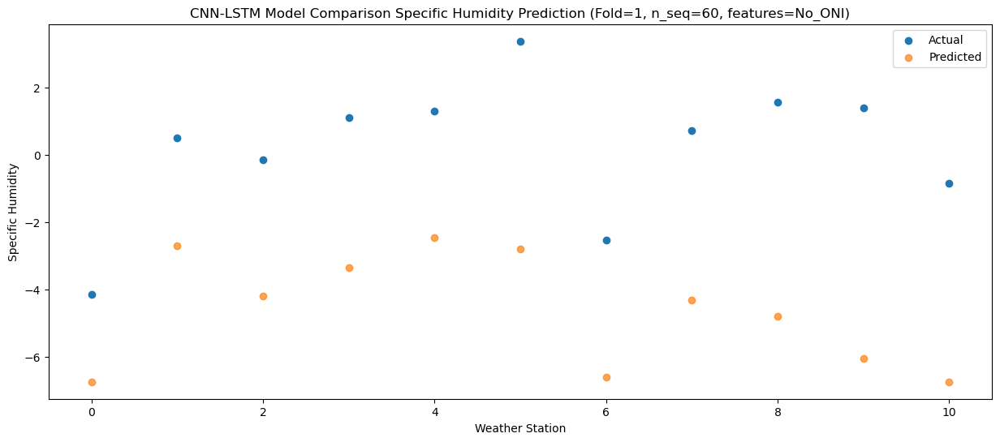

Predictions for (t+50):
    Weather_Station  Actual  Predicted
0                 0   -4.54  -7.911522
1                 1   -0.26  -3.851515
2                 2   -0.77  -5.361520
3                 3    0.01  -4.511502
4                 4    0.14  -3.621505
5                 5    2.24  -3.951499
6                 6   -3.36  -7.761518
7                 7   -0.35  -5.471513
8                 8    0.27  -5.961494
9                 9    0.66  -7.211501
10               10   -1.90  -7.911527


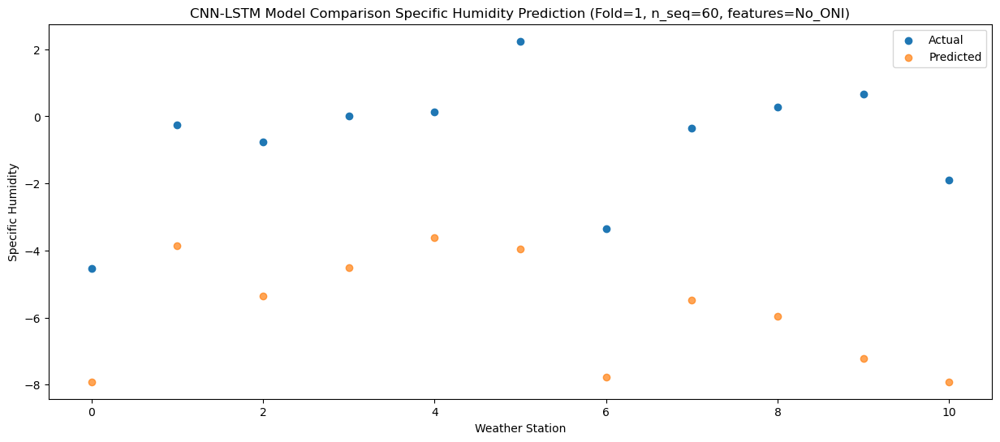

Predictions for (t+51):
    Weather_Station  Actual  Predicted
0                 0   -4.93  -7.225513
1                 1    0.08  -3.165507
2                 2    0.03  -4.675511
3                 3    2.26  -3.825494
4                 4    2.39  -2.935497
5                 5    2.65  -3.265491
6                 6   -2.88  -7.075509
7                 7    1.40  -4.785504
8                 8    2.02  -5.275485
9                 9    1.33  -6.525493
10               10   -2.03  -7.225518


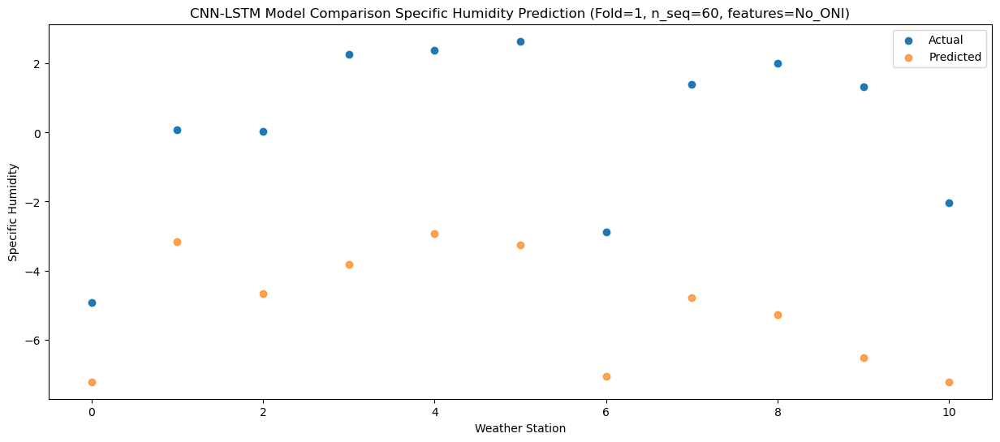

Predictions for (t+52):
    Weather_Station  Actual  Predicted
0                 0   -2.52  -6.414448
1                 1    1.59  -2.354441
2                 2    1.57  -3.864445
3                 3    4.17  -3.014428
4                 4    4.32  -2.124431
5                 5    3.61  -2.454427
6                 6   -1.54  -6.264444
7                 7    2.59  -3.974438
8                 8    3.57  -4.464420
9                 9    1.64  -5.714429
10               10   -1.00  -6.414453


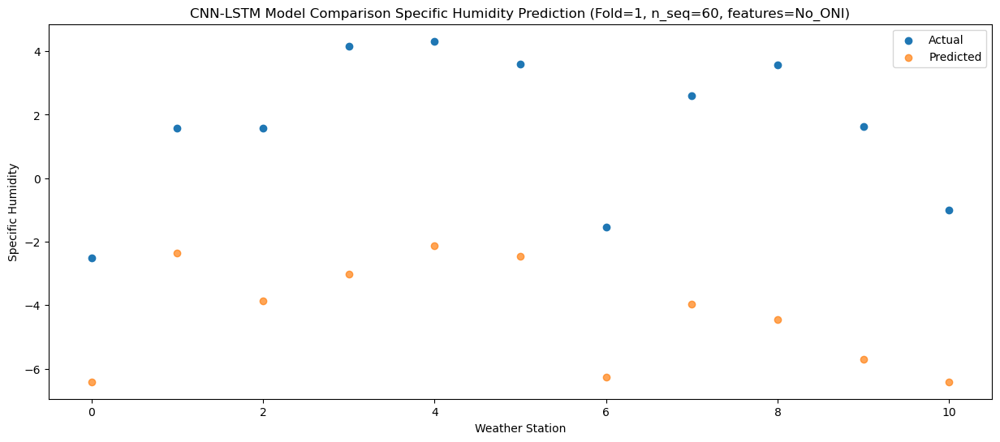

Predictions for (t+53):
    Weather_Station  Actual  Predicted
0                 0   -1.45  -4.837087
1                 1    3.48  -0.777080
2                 2    3.56  -2.287084
3                 3    6.42  -1.437067
4                 4    6.52  -0.547070
5                 5    4.25  -0.877068
6                 6    0.61  -4.687082
7                 7    4.36  -2.397075
8                 8    5.89  -2.887059
9                 9    2.50  -4.137069
10               10    0.61  -4.837092


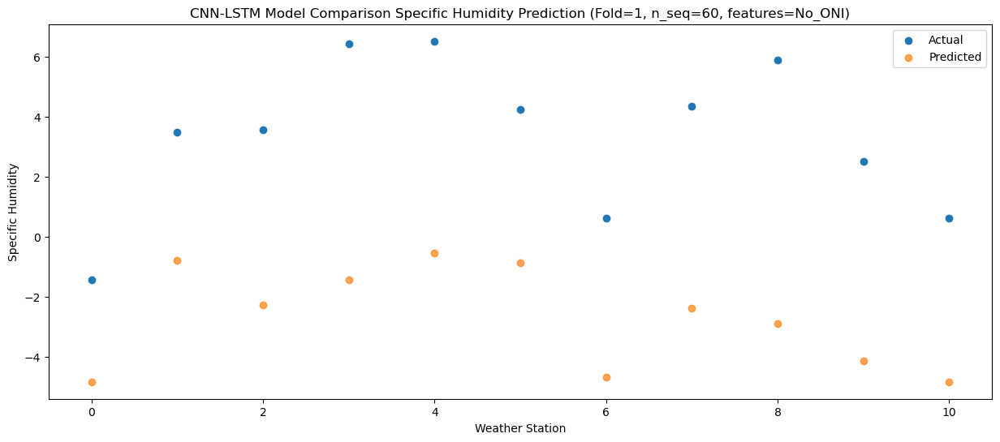

Predictions for (t+54):
    Weather_Station  Actual  Predicted
0                 0    2.75  -1.329579
1                 1    7.28   2.730429
2                 2    7.69   1.220424
3                 3   10.77   2.070443
4                 4   10.50   2.960440
5                 5    6.68   2.630442
6                 6    4.75  -1.179575
7                 7    8.67   1.110433
8                 8    9.49   0.620451
9                 9    5.23  -0.629559
10               10    4.19  -1.329583


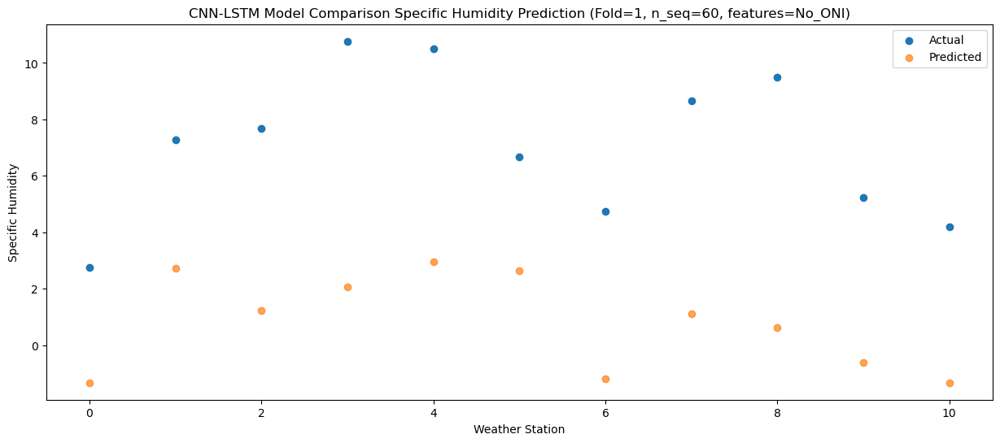

Predictions for (t+55):
    Weather_Station  Actual  Predicted
0                 0    4.82   0.476824
1                 1    8.79   4.536833
2                 2    9.12   3.026827
3                 3   12.16   3.876848
4                 4   12.01   4.766846
5                 5   11.53   4.436846
6                 6    6.71   0.626829
7                 7   10.69   2.916836
8                 8   12.40   2.426856
9                 9   10.90   1.176845
10               10    6.01   0.476821


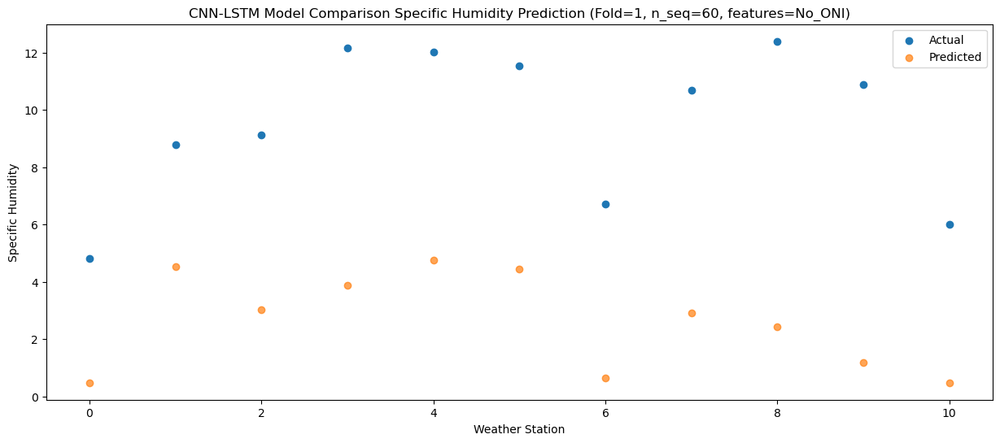

Predictions for (t+56):
    Weather_Station  Actual  Predicted
0                 0    7.24   1.858764
1                 1   11.39   5.918773
2                 2   12.29   4.408767
3                 3   12.24   5.258788
4                 4   12.33   6.148786
5                 5   11.38   5.818785
6                 6    9.09   2.008770
7                 7   11.36   4.298776
8                 8   11.01   3.808794
9                 9    9.15   2.558783
10               10    9.38   1.858761


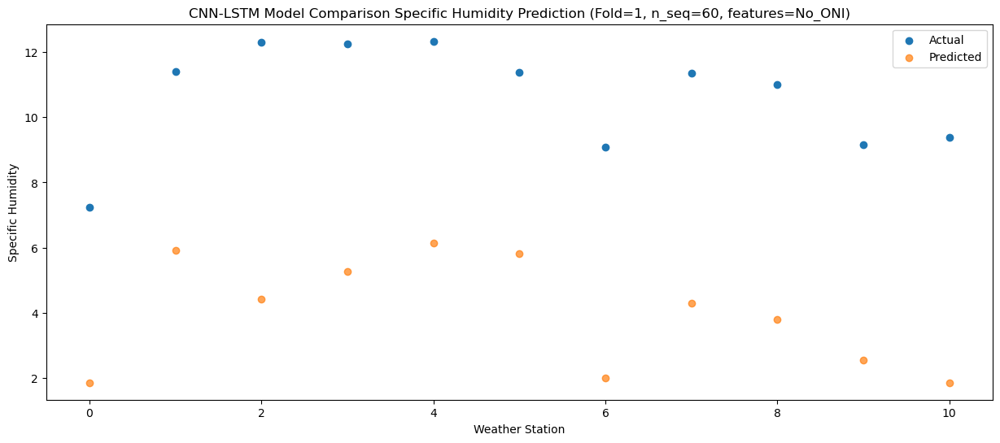

Predictions for (t+57):
    Weather_Station  Actual  Predicted
0                 0    6.60   1.060105
1                 1    9.66   5.120115
2                 2   10.17   3.610109
3                 3   12.33   4.460128
4                 4   12.38   5.350126
5                 5   10.24   5.020126
6                 6    7.37   1.210112
7                 7   10.12   3.500117
8                 8   10.42   3.010135
9                 9    9.34   1.760124
10               10    7.80   1.060102


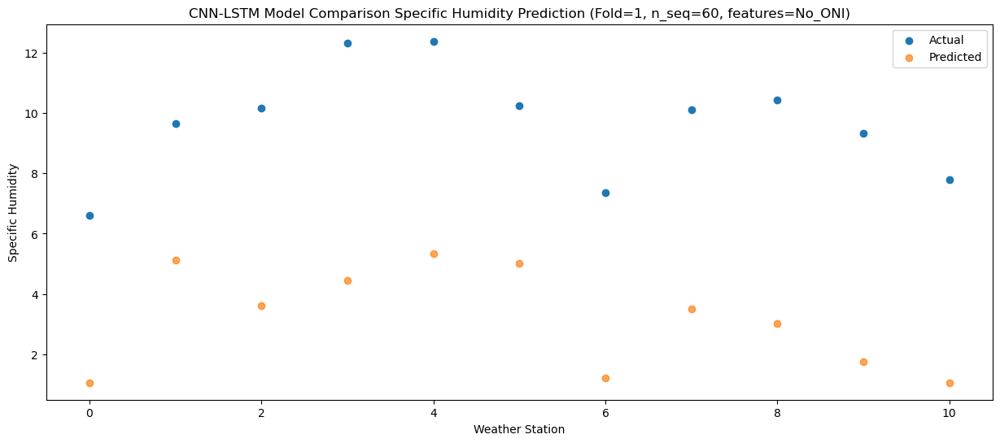

Predictions for (t+58):
    Weather_Station  Actual  Predicted
0                 0    4.61  -1.405828
1                 1    8.14   2.654182
2                 2    8.62   1.144176
3                 3    9.41   1.994197
4                 4    9.84   2.884194
5                 5   10.72   2.554193
6                 6    6.08  -1.255822
7                 7    8.36   1.034185
8                 8    8.51   0.544203
9                 9    6.90  -0.705808
10               10    5.31  -1.405831


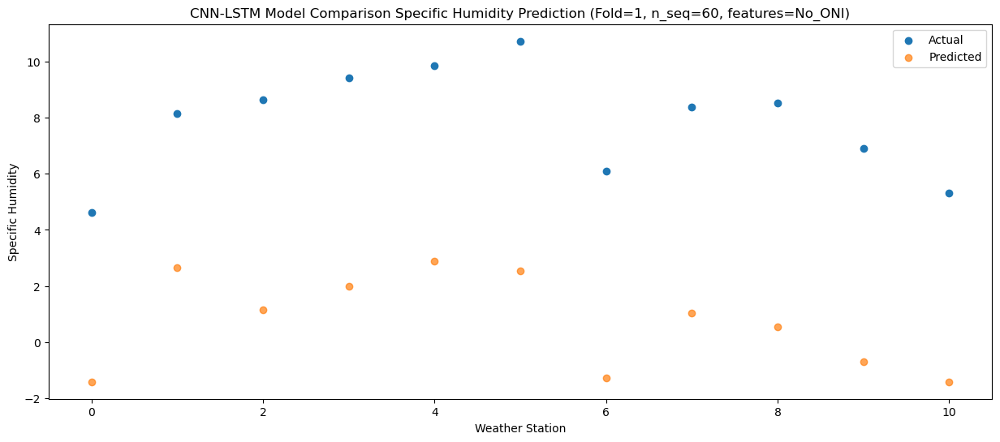

Predictions for (t+59):
    Weather_Station  Actual  Predicted
0                 0   -0.34  -5.435579
1                 1    4.31  -1.375570
2                 2    4.12  -2.885576
3                 3    5.36  -2.035557
4                 4    5.51  -1.145559
5                 5    6.45  -1.475562
6                 6    1.94  -5.285573
7                 7    3.32  -2.995567
8                 8    5.15  -3.485551
9                 9    3.91  -4.735564
10               10    1.00  -5.435582


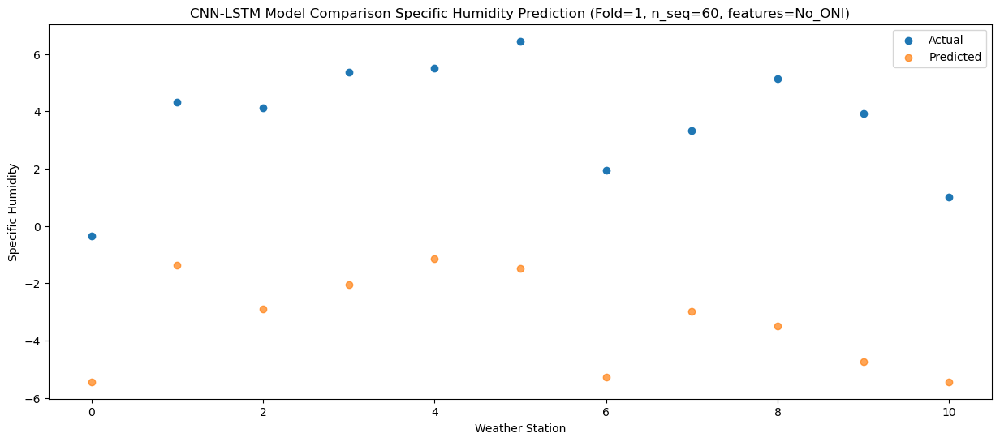

f, t:
[[-3.880e+00  1.110e+00 -5.000e-02  1.890e+00  2.440e+00  4.760e+00
  -2.550e+00  1.260e+00  2.020e+00  1.350e+00 -1.820e+00]
 [-3.280e+00  1.160e+00  8.600e-01  6.900e-01  1.200e+00  3.280e+00
  -2.520e+00  9.300e-01  1.180e+00  7.000e-01 -1.830e+00]
 [-3.470e+00  9.100e-01  3.500e-01  1.590e+00  2.110e+00  3.000e+00
  -2.940e+00  8.500e-01  1.630e+00  5.500e-01 -1.980e+00]
 [-3.560e+00  1.430e+00  7.400e-01  8.900e-01  1.430e+00  3.180e+00
  -2.460e+00  7.300e-01  1.010e+00  5.600e-01 -1.910e+00]
 [-1.260e+00  3.660e+00  3.900e+00  5.250e+00  6.160e+00  5.850e+00
  -4.900e-01  3.390e+00  4.030e+00  2.450e+00 -9.600e-01]
 [-1.520e+00  2.070e+00  2.280e+00  4.910e+00  5.850e+00  4.840e+00
  -1.140e+00  3.650e+00  4.220e+00  2.610e+00 -6.700e-01]
 [ 1.380e+00  5.080e+00  5.050e+00  6.890e+00  7.970e+00  7.520e+00
   2.060e+00  6.550e+00  7.550e+00  5.430e+00  1.900e+00]
 [ 4.620e+00  8.880e+00  8.900e+00  9.010e+00  1.026e+01  9.340e+00
   5.700e+00  1.038e+01  9.690e+00  7.140e+0

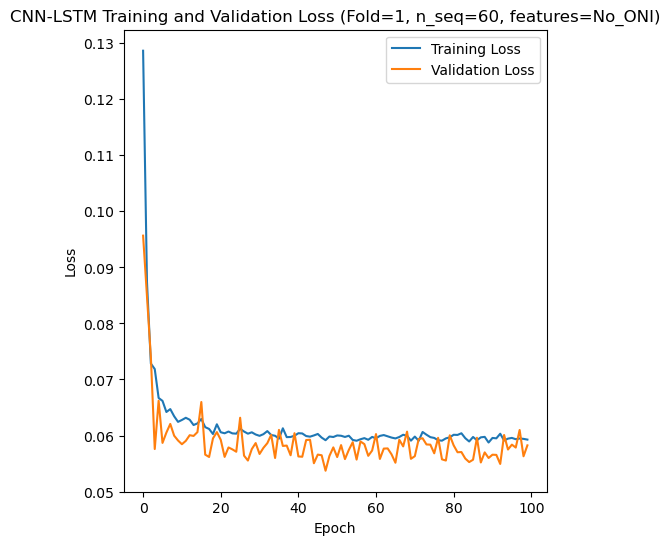

[[ 4.97  3.84  5.83 ... 12.86  8.48  8.25]
 [ 2.46  2.06  3.48 ...  9.57  6.71  5.1 ]
 [ 8.78  8.15  9.01 ... 20.36 15.38 12.95]
 ...
 [ 1.89  2.51  2.73 ...  7.42  4.53  3.35]
 [ 5.04  4.9   5.93 ... 10.09  8.19  4.88]
 [ 5.06  3.79  4.84 ... 13.58  8.96  7.8 ]]
Epoch 1/100
84/84 [==============================] - 8s 36ms/step - loss: 0.1252 - accuracy: 0.2262 - mae: 0.1041 - rmse: 0.1252 - mape: 22.6036 - pearson: 0.5919 - val_loss: 0.0698 - val_accuracy: 0.8000 - val_mae: 0.0575 - val_rmse: 0.0698 - val_mape: 12.0651 - val_pearson: 0.8775
Epoch 2/100
84/84 [==============================] - 2s 21ms/step - loss: 0.0922 - accuracy: 0.3095 - mae: 0.0749 - rmse: 0.0922 - mape: 16.6439 - pearson: 0.7075 - val_loss: 0.0570 - val_accuracy: 0.8000 - val_mae: 0.0429 - val_rmse: 0.0570 - val_mape: 9.7797 - val_pearson: 0.8494
Epoch 3/100
84/84 [==============================] - 2s 22ms/step - loss: 0.0790 - accuracy: 0.4286 - mae: 0.0633 - rmse: 0.0790 - mape: 14.1039 - pearson: 0.7470 - val_

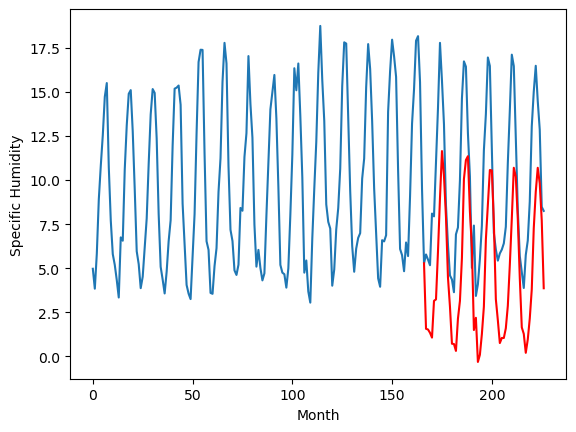

Weather Station 2:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
3.34		1.48		-1.86
2.83		1.44		-1.39
2.81		1.25		-1.56
2.87		0.98		-1.89
4.66		3.06		-1.60
4.95		3.14		-1.81
7.85		5.87		-1.98
9.27		8.89		-0.38
14.08		11.55		-2.53
12.65		10.14		-2.51
8.59		7.81		-0.78
4.86		4.39		-0.47
4.64		2.73		-1.91
2.91		0.63		-2.28
2.86		0.61		-2.25
2.18		0.22		-1.96
4.03		2.05		-1.98
4.15		3.06		-1.09
9.27		5.50		-3.77
12.18		9.97		-2.21
13.79		11.05		-2.74
12.17		11.26		-0.91
9.35		8.13		-1.22
5.96		6.07		0.11
3.53		1.41		-2.12
2.47		2.10		-0.37
2.14		-0.40		-2.54
2.05		0.00		-2.05
2.93		1.18		-1.75
4.08		2.73		-1.35
6.47		6.54		0.07
10.83		8.51		-2.32
12.17		10.48		-1.69
11.67		10.46		-1.21
9.10		7.52		-1.58
5.42		3.15		-2.27
3.92		1.96		-1.96
2.73		0.67		-2.06
2.72		0.96		-1.76
2.64		0.95		-1.69
3.33		1.51		-1.82
3.95		2.78		-1.17
9.73		5.09		-4.64
12.38		7.73		-4.65
14.44		10.61		-3.83
12.55		10.10		-2.45
9.96		7.70		-2.26
6.50		4.36		-2.14
3.94		1.56		-2.38
3.55	

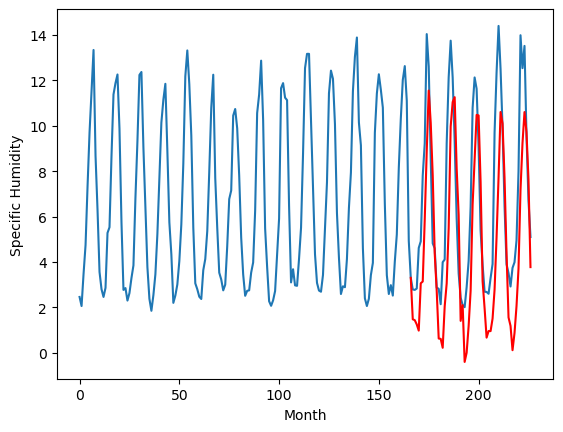

Weather Station 3:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
-2.46		-1.03		1.43
-2.15		-1.07		1.08
-3.71		-1.26		2.45
-2.83		-1.53		1.30
-1.66		0.55		2.21
-0.18		0.63		0.81
0.93		3.36		2.43
4.27		6.38		2.11
5.29		9.04		3.75
5.99		7.63		1.64
5.29		5.30		0.01
2.70		1.88		-0.82
-0.25		0.22		0.47
-4.92		-1.88		3.04
-4.43		-1.90		2.53
-2.30		-2.29		0.01
-2.08		-0.46		1.62
-1.11		0.55		1.66
0.20		2.99		2.79
3.98		7.46		3.48
4.38		8.54		4.16
5.00		8.75		3.75
3.72		5.62		1.90
1.06		3.56		2.50
-2.89		-1.10		1.79
-1.49		-0.41		1.08
-5.14		-2.91		2.23
-3.95		-2.51		1.44
-2.14		-1.33		0.81
-0.78		0.22		1.00
2.32		4.03		1.71
4.25		6.00		1.75
5.08		7.97		2.89
4.97		7.95		2.98
4.82		5.01		0.19
0.43		0.64		0.21
0.32		-0.55		-0.87
-3.34		-1.84		1.50
-3.72		-1.55		2.17
-1.87		-1.56		0.31
-1.48		-1.00		0.48
0.03		0.27		0.24
0.84		2.58		1.74
4.00		5.22		1.22
4.97		8.10		3.13
5.69		7.59		1.90
3.30		5.19		1.89
0.38		1.85		1.47
-2.12		-0.95		1.17
-2.69		-1.32		1.37
-3.76		-2

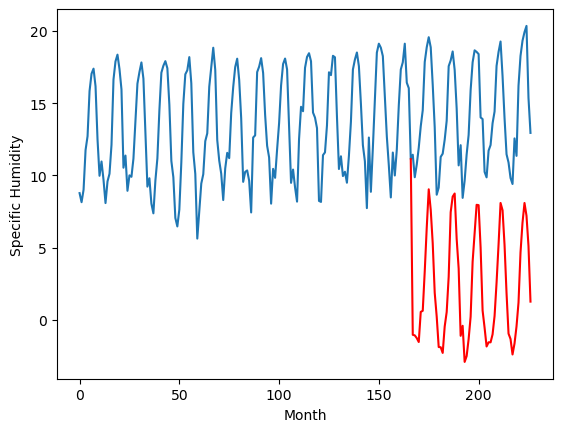

Weather Station 4:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
4.49		5.29		0.80
3.93		5.25		1.32
3.75		5.06		1.31
3.77		4.79		1.02
4.29		6.87		2.58
4.67		6.95		2.28
6.92		9.68		2.76
10.93		12.70		1.77
14.31		15.36		1.05
13.48		13.95		0.47
10.39		11.62		1.23
7.88		8.20		0.32
6.01		6.54		0.53
4.09		4.44		0.35
3.01		4.42		1.41
3.18		4.03		0.85
3.82		5.86		2.04
5.17		6.87		1.70
6.85		9.31		2.46
11.45		13.78		2.33
14.05		14.86		0.81
14.79		15.07		0.28
12.13		11.94		-0.19
9.17		9.88		0.71
4.72		5.22		0.50
4.36		5.91		1.55
3.03		3.41		0.38
3.60		3.81		0.21
4.36		4.99		0.63
5.06		6.54		1.48
8.36		10.35		1.99
10.62		12.32		1.70
13.98		14.29		0.31
14.66		14.27		-0.39
10.86		11.33		0.47
7.99		6.96		-1.03
6.17		5.77		-0.40
4.08		4.48		0.40
4.59		4.77		0.18
3.83		4.76		0.93
4.08		5.32		1.24
6.16		6.59		0.43
6.97		8.90		1.93
10.87		11.54		0.67
15.13		14.42		-0.71
12.79		13.91		1.12
11.78		11.51		-0.27
8.42		8.17		-0.25
4.59		5.37		0.78
4.88		5.00		0.12
3.55		3.92		0.3

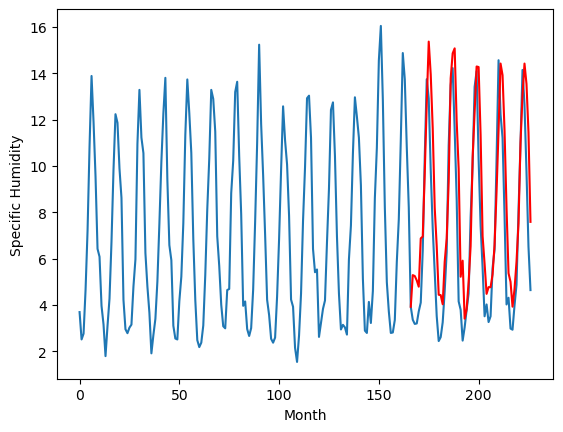

Weather Station 5:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
-2.07		0.20		2.27
-1.27		0.16		1.43
-1.24		-0.03		1.21
-0.92		-0.30		0.62
2.57		1.78		-0.79
1.61		1.86		0.25
3.73		4.59		0.86
7.07		7.61		0.54
9.20		10.27		1.07
8.47		8.86		0.39
6.67		6.53		-0.14
3.46		3.11		-0.35
0.73		1.45		0.72
-2.55		-0.65		1.90
-2.42		-0.67		1.75
-2.44		-1.06		1.38
0.85		0.77		-0.08
0.87		1.78		0.91
4.07		4.22		0.15
7.96		8.69		0.73
8.99		9.77		0.78
8.59		9.98		1.39
6.45		6.85		0.40
3.92		4.79		0.87
-1.74		0.13		1.87
1.54		0.82		-0.72
-3.37		-1.68		1.69
-1.91		-1.28		0.63
-1.06		-0.10		0.96
1.37		1.45		0.08
5.40		5.26		-0.14
7.70		7.23		-0.47
8.99		9.20		0.21
9.39		9.18		-0.21
5.88		6.24		0.36
0.70		1.87		1.17
0.26		0.68		0.42
-0.29		-0.61		-0.32
-0.38		-0.32		0.06
0.92		-0.33		-1.25
1.80		0.23		-1.57
2.35		1.50		-0.85
5.41		3.81		-1.60
8.72		6.45		-2.27
10.06		9.33		-0.73
10.09		8.82		-1.27
7.74		6.42		-1.32
2.51		3.08		0.57
-0.01		0.28		0.29
-1.60		-0.09		1.51
-2.47		-

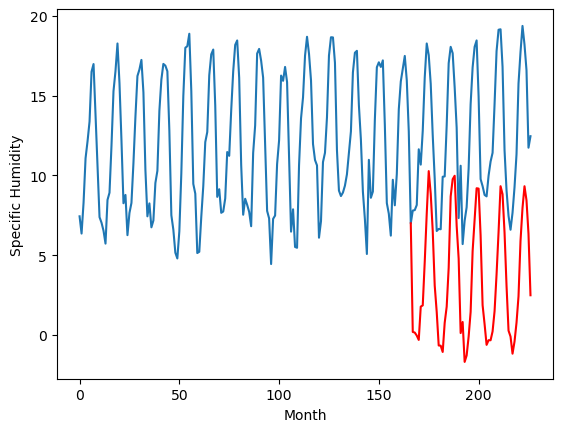

Weather Station 6:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
3.77		3.95		0.18
2.58		3.91		1.33
3.41		3.72		0.31
2.74		3.45		0.71
7.35		5.53		-1.82
6.83		5.61		-1.22
8.91		8.34		-0.57
11.03		11.36		0.33
13.61		14.02		0.41
12.17		12.61		0.44
10.72		10.28		-0.44
6.85		6.86		0.01
4.79		5.20		0.41
2.47		3.10		0.63
2.34		3.08		0.74
2.29		2.69		0.40
5.28		4.52		-0.76
6.85		5.53		-1.32
11.68		7.97		-3.71
14.32		12.44		-1.88
13.28		13.52		0.24
13.41		13.73		0.32
9.85		10.60		0.75
8.26		8.54		0.28
4.07		3.88		-0.19
6.94		4.57		-2.37
1.31		2.07		0.76
1.53		2.47		0.94
3.15		3.65		0.50
7.11		5.20		-1.91
10.76		9.01		-1.75
11.79		10.98		-0.81
12.89		12.95		0.06
13.35		12.93		-0.42
9.99		9.99		0.00
5.17		5.62		0.45
5.03		4.43		-0.60
4.12		3.14		-0.98
3.74		3.43		-0.31
4.19		3.42		-0.77
5.97		3.98		-1.99
6.52		5.25		-1.27
10.22		7.56		-2.66
13.68		10.20		-3.48
13.39		13.08		-0.31
11.96		12.57		0.61
11.41		10.17		-1.24
7.88		6.83		-1.05
4.71		4.03		-0.68
2.78		3.66		0.

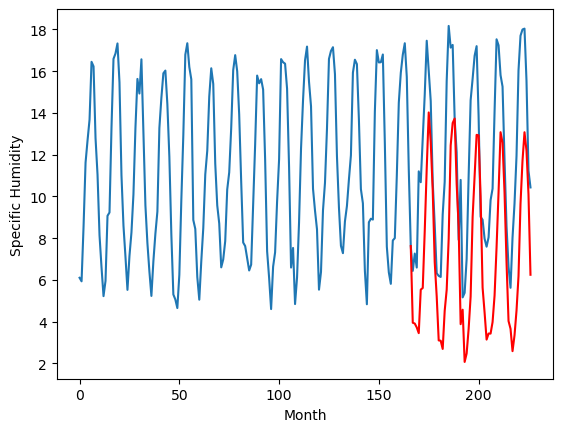

Weather Station 7:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
2.89		2.61		-0.28
1.79		2.57		0.78
2.47		2.38		-0.09
1.91		2.11		0.20
6.13		4.19		-1.94
5.71		4.27		-1.44
8.65		7.00		-1.65
10.93		10.02		-0.91
13.84		12.68		-1.16
11.14		11.27		0.13
10.20		8.94		-1.26
5.71		5.52		-0.19
4.12		3.86		-0.26
1.41		1.76		0.35
1.31		1.74		0.43
0.98		1.35		0.37
3.84		3.18		-0.66
5.16		4.19		-0.97
9.36		6.63		-2.73
13.11		11.10		-2.01
13.93		12.18		-1.75
14.31		12.39		-1.92
9.86		9.26		-0.60
7.25		7.20		-0.05
3.26		2.54		-0.72
5.76		3.23		-2.53
0.47		0.73		0.26
0.94		1.13		0.19
2.57		2.31		-0.26
6.47		3.86		-2.61
10.56		7.67		-2.89
11.36		9.64		-1.72
10.68		11.61		0.93
11.74		11.59		-0.15
9.07		8.65		-0.42
4.29		4.28		-0.01
3.84		3.09		-0.75
2.67		1.80		-0.87
1.89		2.09		0.20
2.29		2.08		-0.21
4.20		2.64		-1.56
4.87		3.91		-0.96
8.76		6.22		-2.54
12.66		8.86		-3.80
11.95		11.74		-0.21
9.90		11.23		1.33
9.27		8.83		-0.44
6.12		5.49		-0.63
3.50		2.69		-0.81
1.68		2.32	

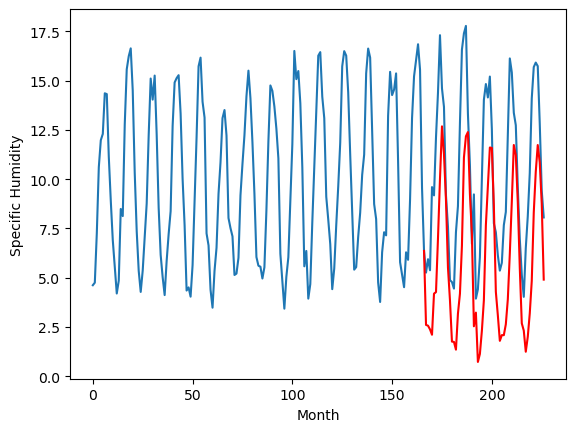

Weather Station 8:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
3.55		1.13		-2.42
3.10		1.09		-2.01
2.15		0.90		-1.25
2.68		0.63		-2.05
4.14		2.71		-1.43
2.74		2.79		0.05
2.98		5.52		2.54
4.66		8.54		3.88
8.10		11.20		3.10
6.37		9.79		3.42
5.72		7.46		1.74
2.65		4.04		1.39
2.70		2.38		-0.32
1.44		0.28		-1.16
1.72		0.26		-1.46
1.59		-0.13		-1.72
1.68		1.70		0.02
1.98		2.71		0.73
2.10		5.15		3.05
4.76		9.62		4.86
10.00		10.70		0.70
10.29		10.91		0.62
7.53		7.78		0.25
3.82		5.72		1.90
2.17		1.06		-1.11
2.30		1.75		-0.55
2.02		-0.75		-2.77
1.03		-0.35		-1.38
1.43		0.83		-0.60
1.44		2.38		0.94
1.37		6.19		4.82
6.87		8.16		1.29
9.43		10.13		0.70
11.40		10.11		-1.29
8.36		7.17		-1.19
6.28		2.80		-3.48
2.31		1.61		-0.70
3.13		0.32		-2.81
2.24		0.61		-1.63
2.12		0.60		-1.52
2.46		1.16		-1.30
1.62		2.43		0.81
3.62		4.74		1.12
3.42		7.38		3.96
6.77		10.26		3.49
8.96		9.75		0.79
7.15		7.35		0.20
4.70		4.01		-0.69
3.78		1.21		-2.57
2.26		0.84		-1.42
2.68		-0.24		-2.92

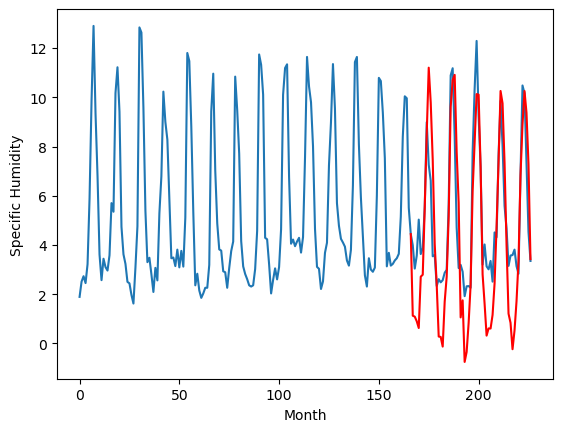

Weather Station 9:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
2.23		-1.60		-3.83
2.05		-1.64		-3.69
1.84		-1.83		-3.67
1.12		-2.10		-3.22
2.76		-0.02		-2.78
4.17		0.06		-4.11
4.93		2.79		-2.14
4.91		5.81		0.90
5.68		8.47		2.79
6.76		7.06		0.30
4.98		4.73		-0.25
3.85		1.31		-2.54
1.61		-0.35		-1.96
0.04		-2.45		-2.49
0.89		-2.47		-3.36
1.42		-2.86		-4.28
1.53		-1.03		-2.56
2.85		-0.02		-2.87
4.33		2.42		-1.91
5.58		6.89		1.31
6.73		7.97		1.24
6.13		8.18		2.05
5.67		5.05		-0.62
2.87		2.99		0.12
2.33		-1.67		-4.00
2.15		-0.98		-3.13
0.79		-3.48		-4.27
0.05		-3.08		-3.13
1.79		-1.90		-3.69
2.63		-0.35		-2.98
3.89		3.46		-0.43
5.66		5.43		-0.23
6.55		7.40		0.85
6.65		7.38		0.73
7.50		4.44		-3.06
5.73		0.07		-5.66
1.09		-1.12		-2.21
1.94		-2.41		-4.35
2.03		-2.12		-4.15
0.62		-2.13		-2.75
2.54		-1.57		-4.11
3.24		-0.30		-3.54
4.64		2.01		-2.63
5.02		4.65		-0.37
6.36		7.53		1.17
6.97		7.02		0.05
6.72		4.62		-2.10
4.42		1.28		-3.14
1.39		-1.52		-2.91
2.18		-1.8

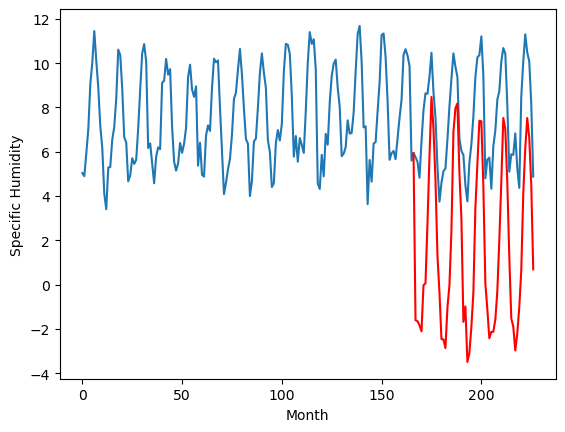

Weather Station 10:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
-0.17		1.55		1.72
-0.06		1.51		1.57
-0.08		1.32		1.40
0.31		1.05		0.74
1.94		3.13		1.19
1.85		3.21		1.36
5.18		5.94		0.76
8.69		8.96		0.27
11.54		11.62		0.08
11.53		10.21		-1.32
7.81		7.88		0.07
5.19		4.46		-0.73
2.54		2.80		0.26
-0.68		0.70		1.38
-0.80		0.68		1.48
-0.73		0.29		1.02
1.00		2.12		1.12
1.53		3.13		1.60
4.24		5.57		1.33
8.74		10.04		1.30
10.26		11.12		0.86
10.84		11.33		0.49
7.24		8.20		0.96
5.08		6.14		1.06
-0.48		1.48		1.96
1.37		2.17		0.80
-1.41		-0.33		1.08
-0.10		0.07		0.17
0.86		1.25		0.39
1.90		2.80		0.90
6.22		6.61		0.39
8.02		8.58		0.56
11.60		10.55		-1.05
10.03		10.53		0.50
6.60		7.59		0.99
2.24		3.22		0.98
1.77		2.03		0.26
-0.47		0.74		1.21
0.39		1.03		0.64
1.15		1.02		-0.13
0.84		1.58		0.74
2.97		2.85		-0.12
4.50		5.16		0.66
7.36		7.80		0.44
11.20		10.68		-0.52
10.71		10.17		-0.54
7.57		7.77		0.20
3.38		4.43		1.05
0.27		1.63		1.36
0.18		1.26		1.08
-0.51		0.18		0.69
-

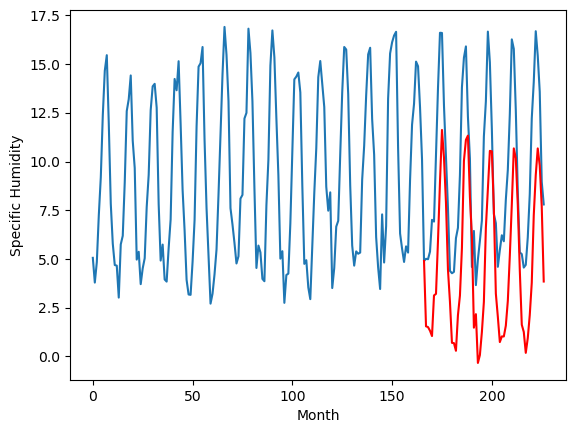

Weather Station 11:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
0.52		1.57		1.05
0.97		1.53		0.56
0.77		1.34		0.57
0.88		1.07		0.19
2.73		3.15		0.42
2.16		3.23		1.07
4.95		5.96		1.01
8.39		8.98		0.59
11.09		11.64		0.55
10.85		10.23		-0.62
8.24		7.90		-0.34
5.05		4.48		-0.57
1.93		2.82		0.89
0.14		0.72		0.58
0.15		0.70		0.55
0.39		0.31		-0.08
1.42		2.14		0.72
2.03		3.15		1.12
4.70		5.59		0.89
8.80		10.06		1.26
10.21		11.14		0.93
10.60		11.35		0.75
7.39		8.22		0.83
5.66		6.16		0.50
0.30		1.50		1.20
1.86		2.19		0.33
-0.56		-0.31		0.25
0.34		0.09		-0.25
0.96		1.27		0.31
2.23		2.82		0.59
6.39		6.63		0.24
8.35		8.60		0.25
11.56		10.57		-0.99
10.57		10.55		-0.02
7.09		7.61		0.52
2.43		3.24		0.81
1.81		2.05		0.24
0.72		0.76		0.04
0.99		1.05		0.06
1.39		1.04		-0.35
0.99		1.60		0.61
2.63		2.87		0.24
5.22		5.18		-0.04
7.06		7.82		0.76
10.37		10.70		0.33
10.48		10.19		-0.29
8.06		7.79		-0.27
3.95		4.45		0.50
1.00		1.65		0.65
0.79		1.28		0.49
0.17		0.20		0.03
0.57		0

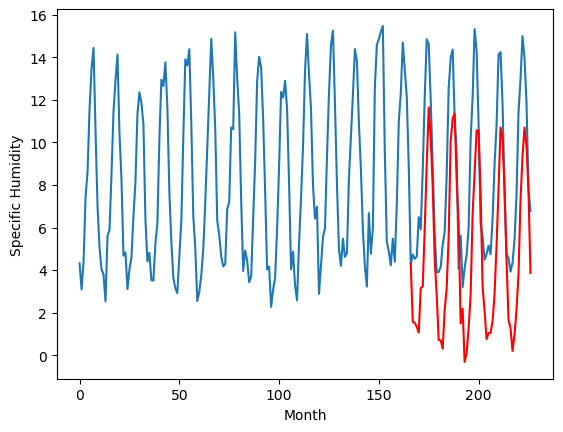

Predictions for (t+0):
    Weather_Station  Actual  Predicted
0                 0    0.85   1.565602
1                 1    3.34   1.475601
2                 2   -2.46  -1.034399
3                 3    4.49   5.285600
4                 4   -2.07   0.195602
5                 5    3.77   3.945602
6                 6    2.89   2.605603
7                 7    3.55   1.125602
8                 8    2.23  -1.604400
9                 9   -0.17   1.545602
10               10    0.52   1.565602


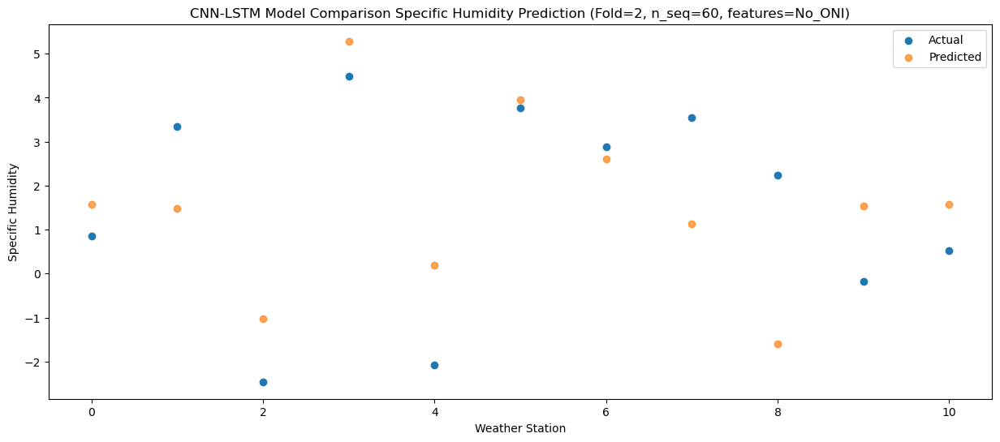

Predictions for (t+1):
    Weather_Station  Actual  Predicted
0                 0    1.35   1.526902
1                 1    2.83   1.436898
2                 2   -2.15  -1.073100
3                 3    3.93   5.246901
4                 4   -1.27   0.156901
5                 5    2.58   3.906899
6                 6    1.79   2.566900
7                 7    3.10   1.086896
8                 8    2.05  -1.643105
9                 9   -0.06   1.506903
10               10    0.97   1.526902


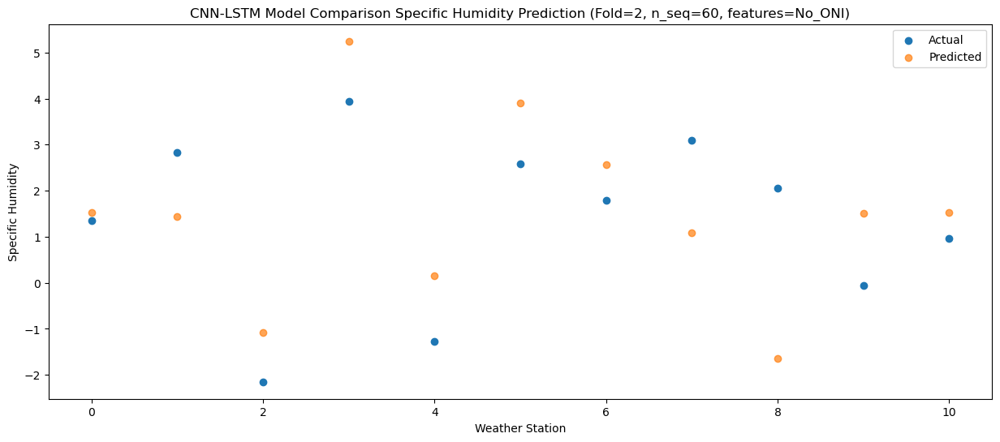

Predictions for (t+2):
    Weather_Station  Actual  Predicted
0                 0    1.06   1.338535
1                 1    2.81   1.248535
2                 2   -3.71  -1.261464
3                 3    3.75   5.058536
4                 4   -1.24  -0.031464
5                 5    3.41   3.718535
6                 6    2.47   2.378536
7                 7    2.15   0.898534
8                 8    1.84  -1.831467
9                 9   -0.08   1.318538
10               10    0.77   1.338537


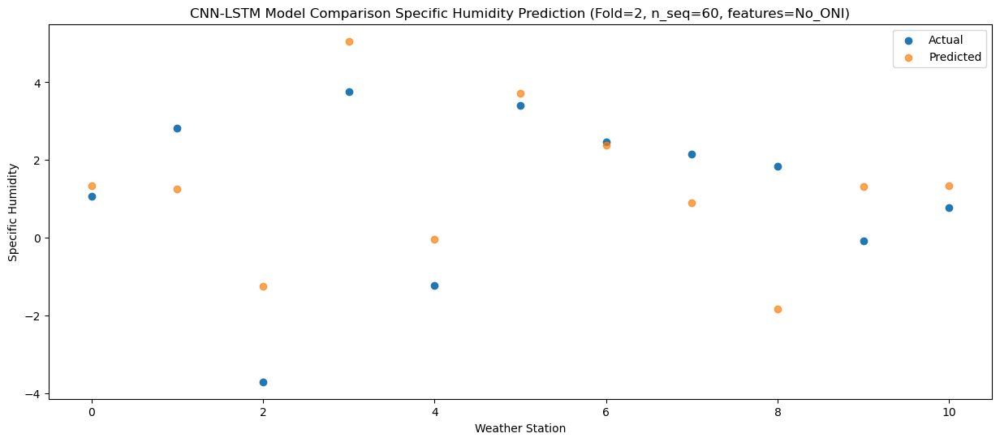

Predictions for (t+3):
    Weather_Station  Actual  Predicted
0                 0    0.74   1.066131
1                 1    2.87   0.976133
2                 2   -2.83  -1.533866
3                 3    3.77   4.786132
4                 4   -0.92  -0.303867
5                 5    2.74   3.446132
6                 6    1.91   2.106131
7                 7    2.68   0.626134
8                 8    1.12  -2.103869
9                 9    0.31   1.046134
10               10    0.88   1.066134


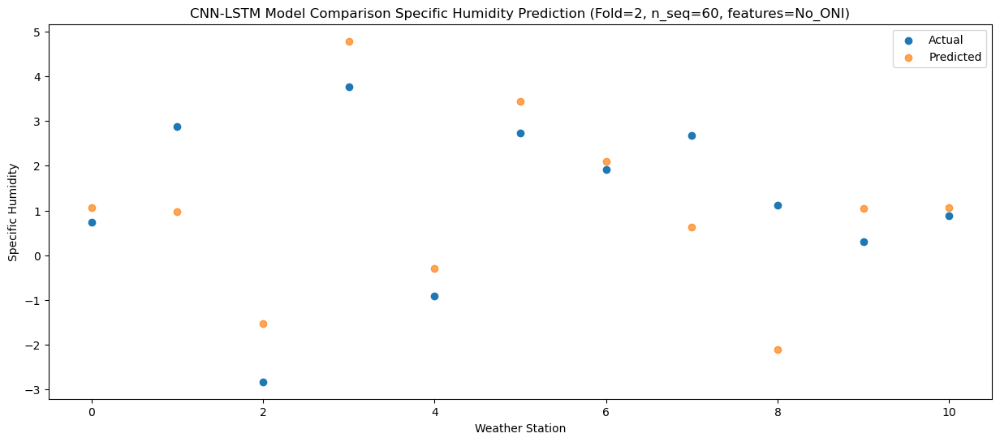

Predictions for (t+4):
    Weather_Station  Actual  Predicted
0                 0    3.67   3.151665
1                 1    4.66   3.061666
2                 2   -1.66   0.551666
3                 3    4.29   6.871666
4                 4    2.57   1.781668
5                 5    7.35   5.531664
6                 6    6.13   4.191665
7                 7    4.14   2.711666
8                 8    2.76  -0.018337
9                 9    1.94   3.131669
10               10    2.73   3.151669


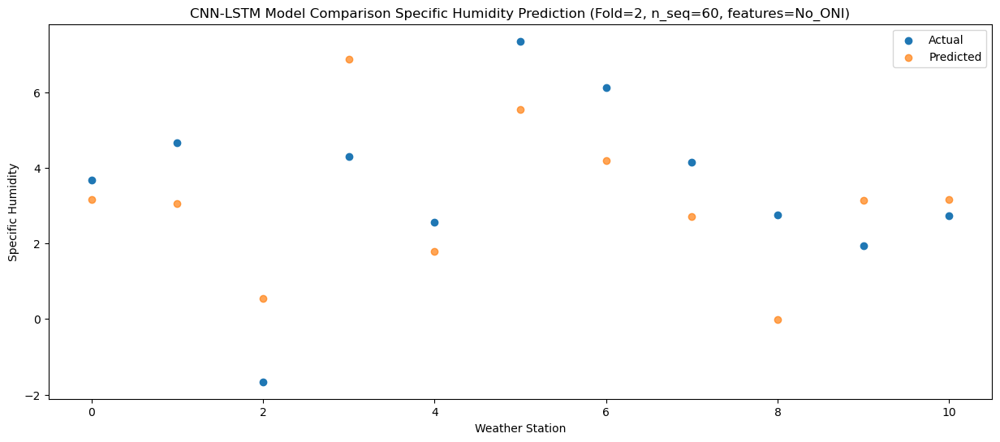

Predictions for (t+5):
    Weather_Station  Actual  Predicted
0                 0    3.51   3.230368
1                 1    4.95   3.140368
2                 2   -0.18   0.630369
3                 3    4.67   6.950370
4                 4    1.61   1.860370
5                 5    6.83   5.610366
6                 6    5.71   4.270366
7                 7    2.74   2.790366
8                 8    4.17   0.060366
9                 9    1.85   3.210371
10               10    2.16   3.230372


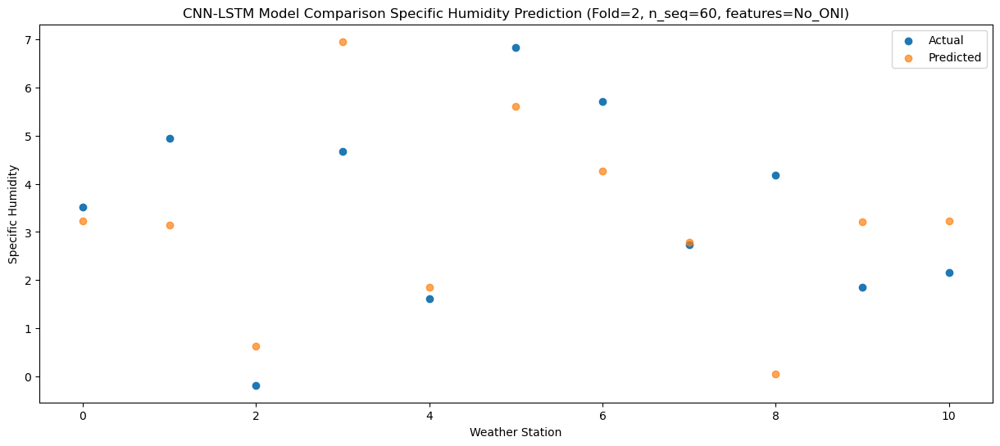

Predictions for (t+6):
    Weather_Station  Actual  Predicted
0                 0    6.50   5.960257
1                 1    7.85   5.870256
2                 2    0.93   3.360257
3                 3    6.92   9.680258
4                 4    3.73   4.590257
5                 5    8.91   8.340253
6                 6    8.65   7.000253
7                 7    2.98   5.520253
8                 8    4.93   2.790252
9                 9    5.18   5.940261
10               10    4.95   5.960261


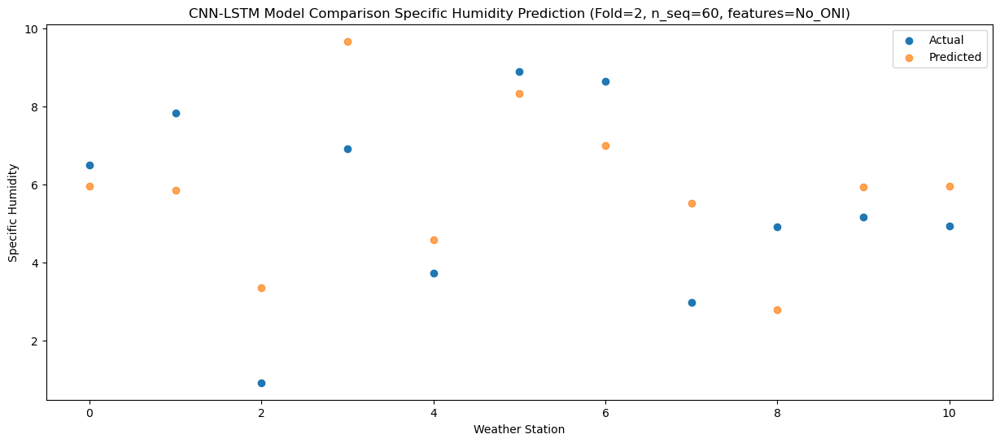

Predictions for (t+7):
    Weather_Station  Actual  Predicted
0                 0    9.65   8.978039
1                 1    9.27   8.888035
2                 2    4.27   6.378037
3                 3   10.93  12.698038
4                 4    7.07   7.608037
5                 5   11.03  11.358034
6                 6   10.93  10.018033
7                 7    4.66   8.538031
8                 8    4.91   5.808030
9                 9    8.69   8.958041
10               10    8.39   8.978045


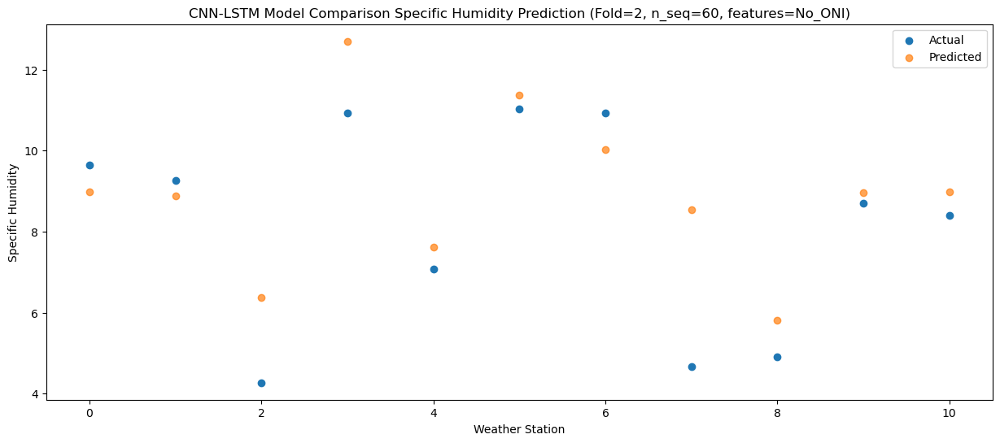

Predictions for (t+8):
    Weather_Station  Actual  Predicted
0                 0   13.35  11.643371
1                 1   14.08  11.553364
2                 2    5.29   9.043369
3                 3   14.31  15.363369
4                 4    9.20  10.273369
5                 5   13.61  14.023364
6                 6   13.84  12.683363
7                 7    8.10  11.203360
8                 8    5.68   8.473359
9                 9   11.54  11.623373
10               10   11.09  11.643378


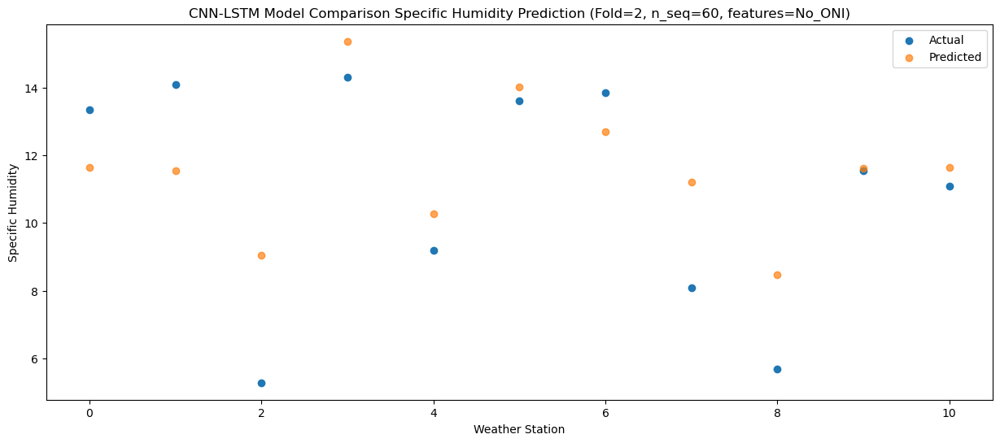

Predictions for (t+9):
    Weather_Station  Actual  Predicted
0                 0   11.19  10.225075
1                 1   12.65  10.135067
2                 2    5.99   7.625071
3                 3   13.48  13.945071
4                 4    8.47   8.855073
5                 5   12.17  12.605066
6                 6   11.14  11.265066
7                 7    6.37   9.785062
8                 8    6.76   7.055061
9                 9   11.53  10.205077
10               10   10.85  10.225081


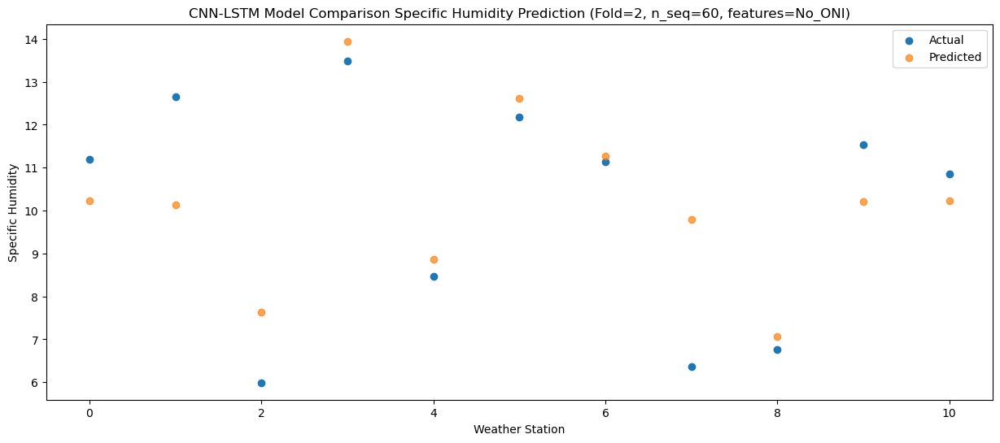

Predictions for (t+10):
    Weather_Station  Actual  Predicted
0                 0    8.73   7.904591
1                 1    8.59   7.814585
2                 2    5.29   5.304589
3                 3   10.39  11.624588
4                 4    6.67   6.534589
5                 5   10.72  10.284583
6                 6   10.20   8.944582
7                 7    5.72   7.464581
8                 8    4.98   4.734580
9                 9    7.81   7.884593
10               10    8.24   7.904598


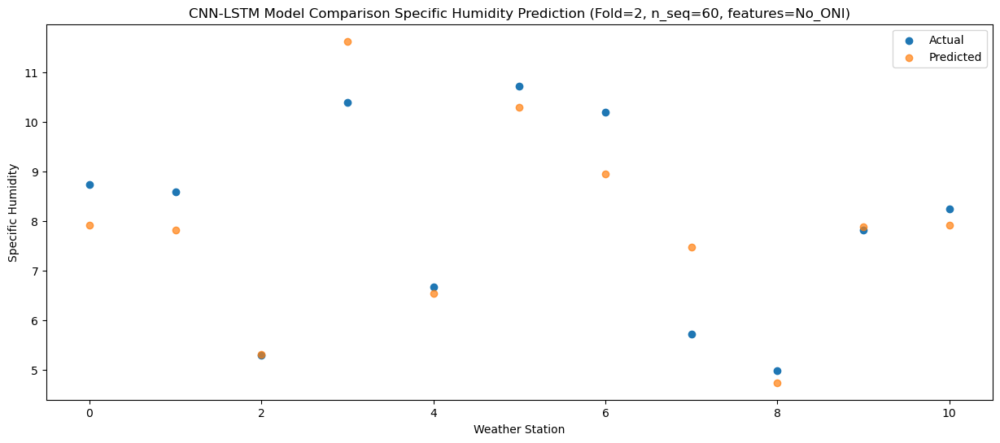

Predictions for (t+11):
    Weather_Station  Actual  Predicted
0                 0    4.14   4.475023
1                 1    4.86   4.385020
2                 2    2.70   1.875024
3                 3    7.88   8.195021
4                 4    3.46   3.105022
5                 5    6.85   6.855017
6                 6    5.71   5.515017
7                 7    2.65   4.035018
8                 8    3.85   1.305016
9                 9    5.19   4.455026
10               10    5.05   4.475030


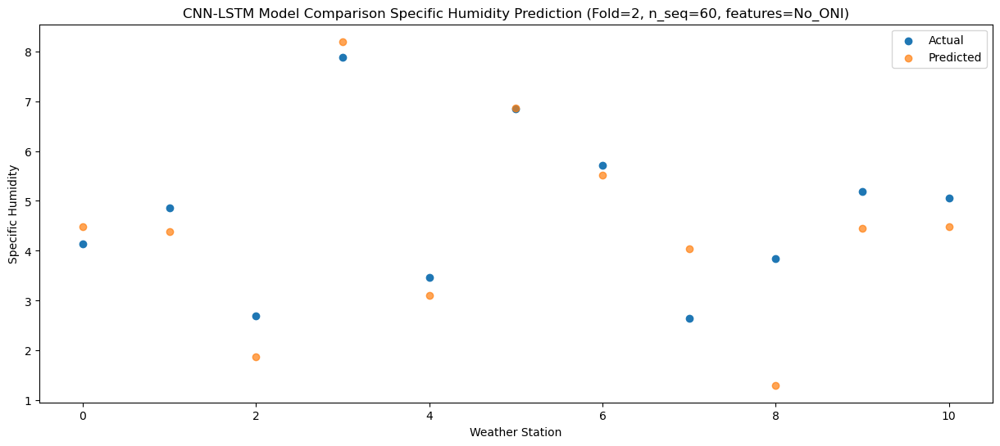

Predictions for (t+12):
    Weather_Station  Actual  Predicted
0                 0    1.89   2.820409
1                 1    4.64   2.730407
2                 2   -0.25   0.220412
3                 3    6.01   6.540409
4                 4    0.73   1.450409
5                 5    4.79   5.200405
6                 6    4.12   3.860404
7                 7    2.70   2.380406
8                 8    1.61  -0.349594
9                 9    2.54   2.800413
10               10    1.93   2.820417


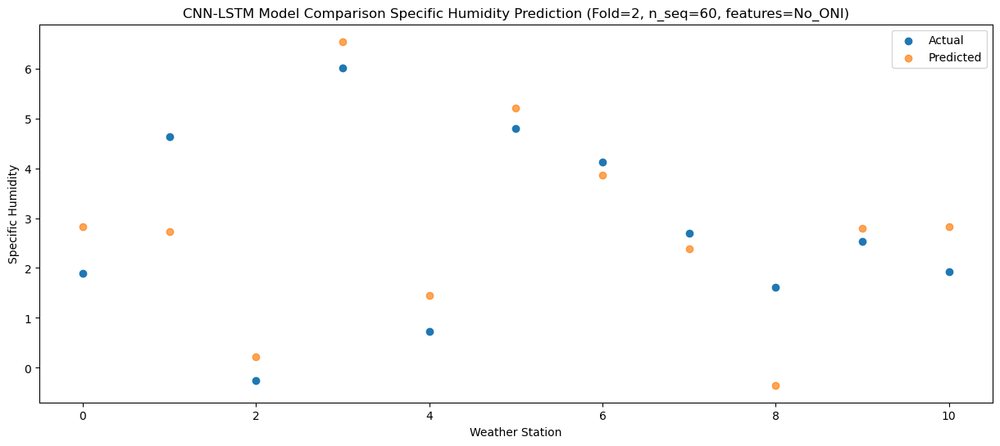

Predictions for (t+13):
    Weather_Station  Actual  Predicted
0                 0    0.16   0.718532
1                 1    2.91   0.628532
2                 2   -4.92  -1.881465
3                 3    4.09   4.438533
4                 4   -2.55  -0.651467
5                 5    2.47   3.098528
6                 6    1.41   1.758527
7                 7    1.44   0.278529
8                 8    0.04  -2.451470
9                 9   -0.68   0.698537
10               10    0.14   0.718541


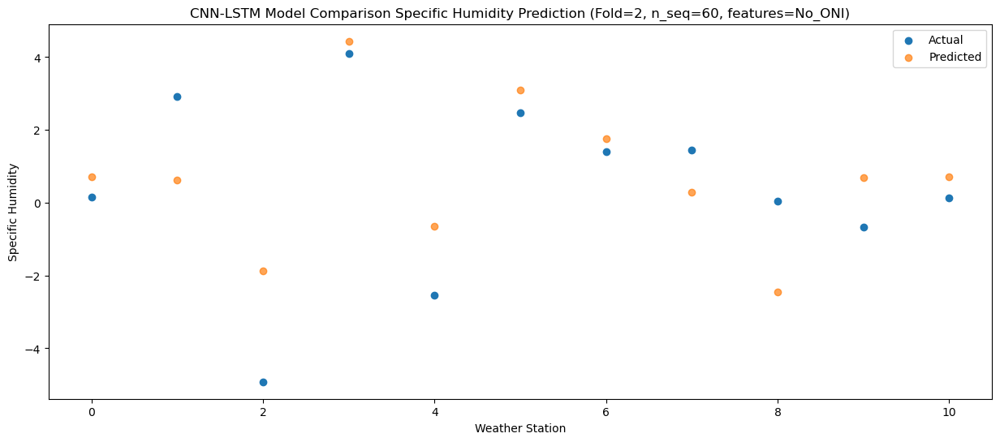

Predictions for (t+14):
    Weather_Station  Actual  Predicted
0                 0   -0.07   0.703082
1                 1    2.86   0.613080
2                 2   -4.43  -1.896916
3                 3    3.01   4.423084
4                 4   -2.42  -0.666918
5                 5    2.34   3.083078
6                 6    1.31   1.743079
7                 7    1.72   0.263079
8                 8    0.89  -2.466923
9                 9   -0.80   0.683087
10               10    0.15   0.703090


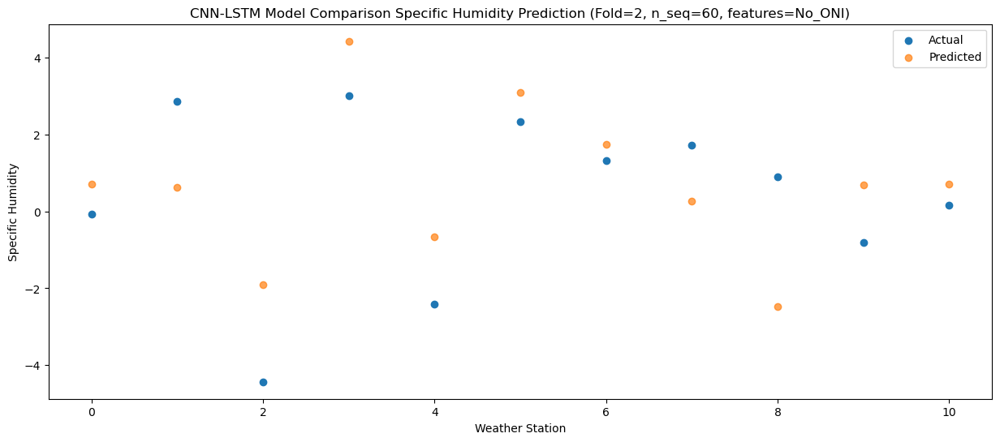

Predictions for (t+15):
    Weather_Station  Actual  Predicted
0                 0   -0.79   0.310633
1                 1    2.18   0.220631
2                 2   -2.30  -2.289365
3                 3    3.18   4.030635
4                 4   -2.44  -1.059366
5                 5    2.29   2.690630
6                 6    0.98   1.350631
7                 7    1.59  -0.129372
8                 8    1.42  -2.859372
9                 9   -0.73   0.290642
10               10    0.39   0.310644


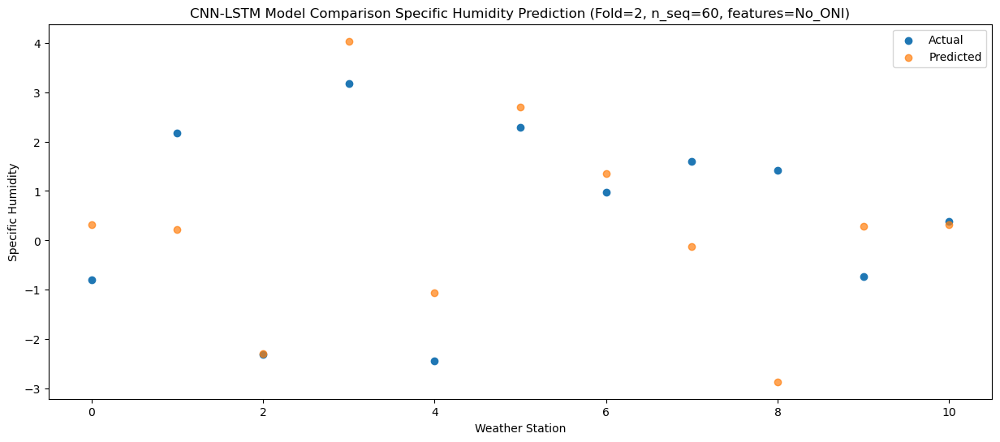

Predictions for (t+16):
    Weather_Station  Actual  Predicted
0                 0    2.49   2.136696
1                 1    4.03   2.046691
2                 2   -2.08  -0.463303
3                 3    3.82   5.856698
4                 4    0.85   0.766695
5                 5    5.28   4.516691
6                 6    3.84   3.176693
7                 7    1.68   1.696689
8                 8    1.53  -1.033313
9                 9    1.00   2.116705
10               10    1.42   2.136706


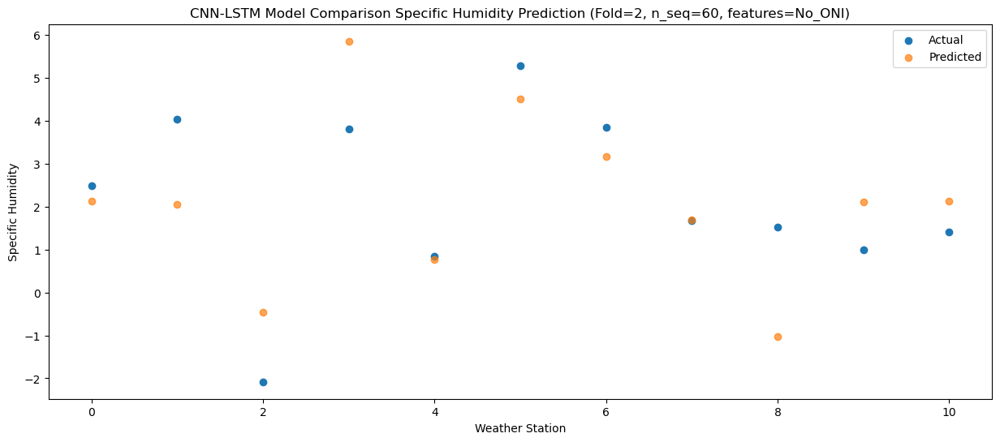

Predictions for (t+17):
    Weather_Station  Actual  Predicted
0                 0    2.88   3.145337
1                 1    4.15   3.055332
2                 2   -1.11   0.545339
3                 3    5.17   6.865339
4                 4    0.87   1.775335
5                 5    6.85   5.525333
6                 6    5.16   4.185333
7                 7    1.98   2.705330
8                 8    2.85  -0.024670
9                 9    1.53   3.125346
10               10    2.03   3.145346


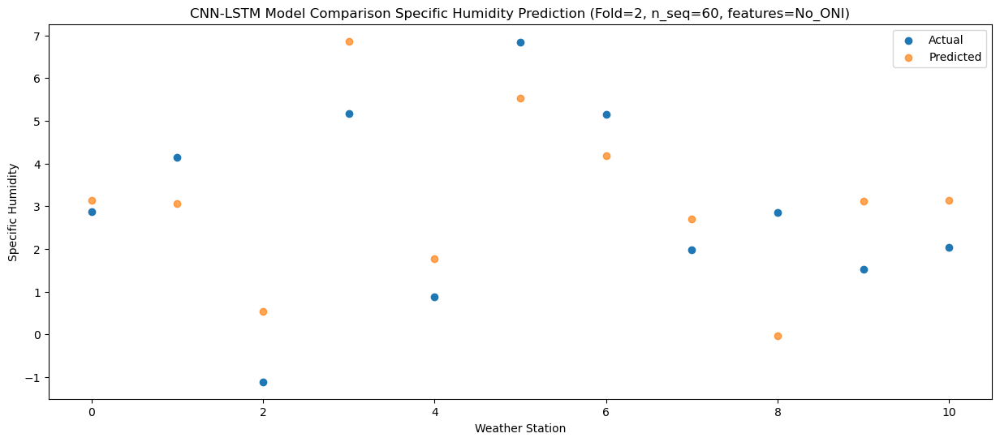

Predictions for (t+18):
    Weather_Station  Actual  Predicted
0                 0    5.55   5.591031
1                 1    9.27   5.501026
2                 2    0.20   2.991031
3                 3    6.85   9.311033
4                 4    4.07   4.221029
5                 5   11.68   7.971028
6                 6    9.36   6.631027
7                 7    2.10   5.151022
8                 8    4.33   2.421025
9                 9    4.24   5.571039
10               10    4.70   5.591039


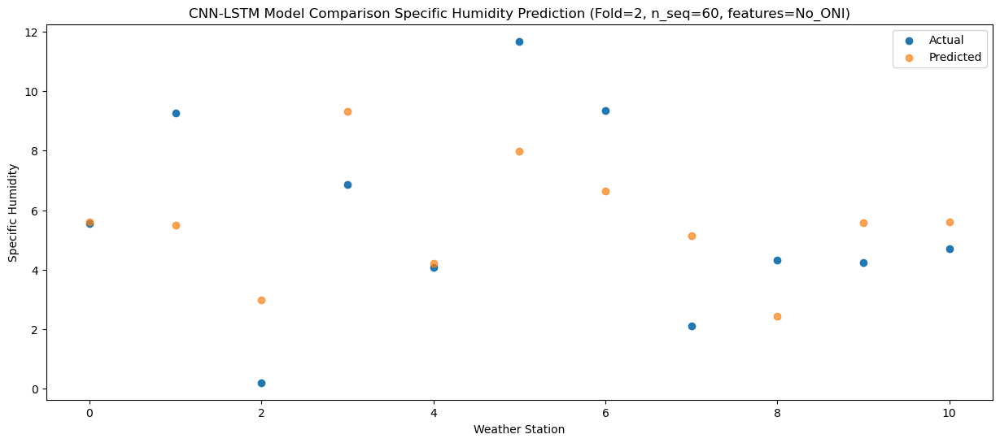

Predictions for (t+19):
    Weather_Station  Actual  Predicted
0                 0   10.20  10.058058
1                 1   12.18   9.968051
2                 2    3.98   7.458056
3                 3   11.45  13.778059
4                 4    7.96   8.688055
5                 5   14.32  12.438054
6                 6   13.11  11.098052
7                 7    4.76   9.618048
8                 8    5.58   6.888048
9                 9    8.74  10.038064
10               10    8.80  10.058064


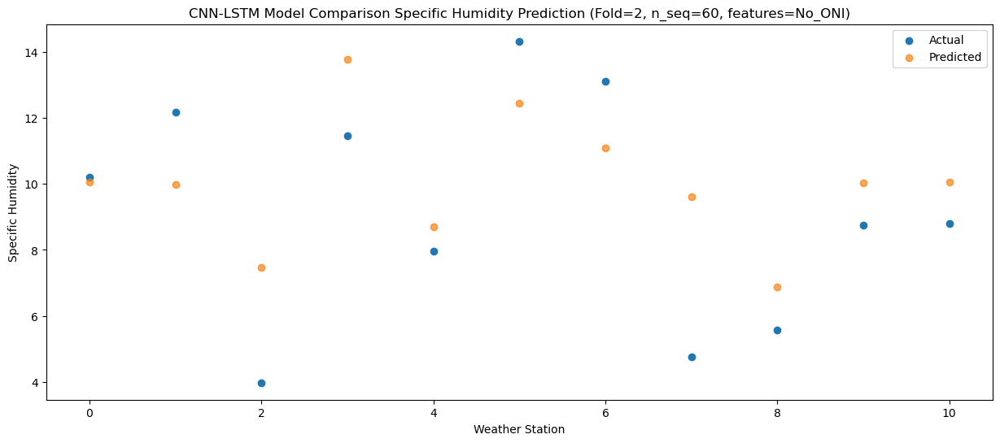

Predictions for (t+20):
    Weather_Station  Actual  Predicted
0                 0   12.30  11.136571
1                 1   13.79  11.046562
2                 2    4.38   8.536567
3                 3   14.05  14.856570
4                 4    8.99   9.766567
5                 5   13.28  13.516567
6                 6   13.93  12.176564
7                 7   10.00  10.696558
8                 8    6.73   7.966558
9                 9   10.26  11.116576
10               10   10.21  11.136577


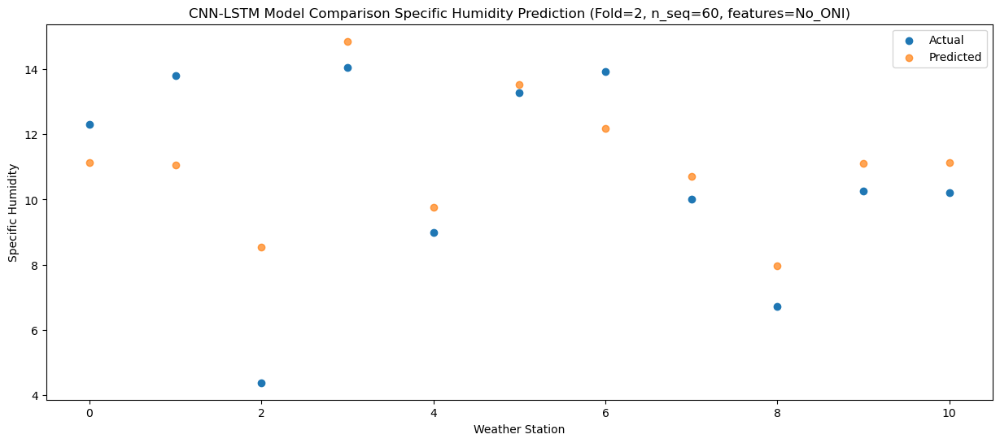

Predictions for (t+21):
    Weather_Station  Actual  Predicted
0                 0   12.00  11.352111
1                 1   12.17  11.262102
2                 2    5.00   8.752106
3                 3   14.79  15.072109
4                 4    8.59   9.982107
5                 5   13.41  13.732106
6                 6   14.31  12.392103
7                 7   10.29  10.912100
8                 8    6.13   8.182099
9                 9   10.84  11.332115
10               10   10.60  11.352116


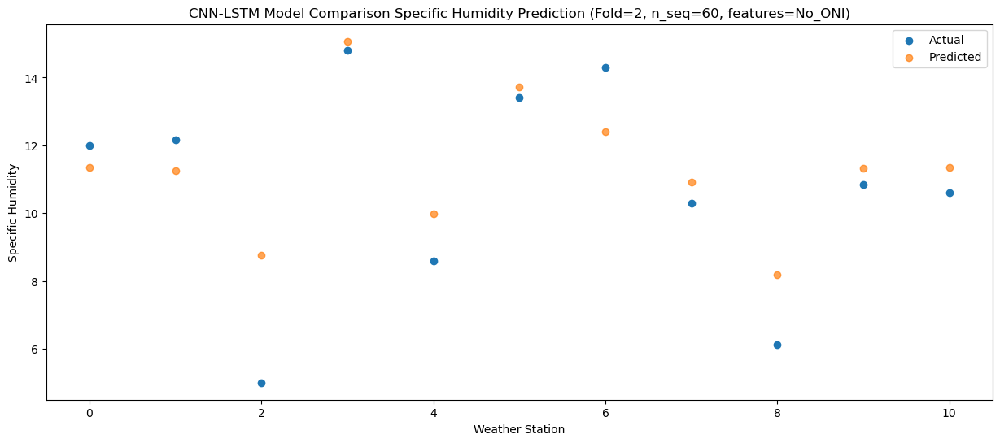

Predictions for (t+22):
    Weather_Station  Actual  Predicted
0                 0    8.23   8.215396
1                 1    9.35   8.125387
2                 2    3.72   5.615392
3                 3   12.13  11.935394
4                 4    6.45   6.845392
5                 5    9.85  10.595391
6                 6    9.86   9.255388
7                 7    7.53   7.775385
8                 8    5.67   5.045386
9                 9    7.24   8.195399
10               10    7.39   8.215399


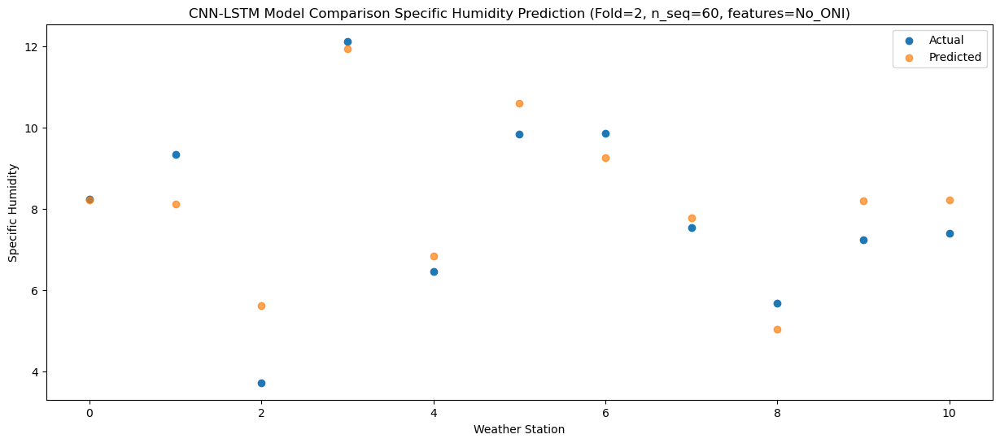

Predictions for (t+23):
    Weather_Station  Actual  Predicted
0                 0    5.78   6.159149
1                 1    5.96   6.069138
2                 2    1.06   3.559142
3                 3    9.17   9.879145
4                 4    3.92   4.789144
5                 5    8.26   8.539141
6                 6    7.25   7.199139
7                 7    3.82   5.719136
8                 8    2.87   2.989135
9                 9    5.08   6.139151
10               10    5.66   6.159151


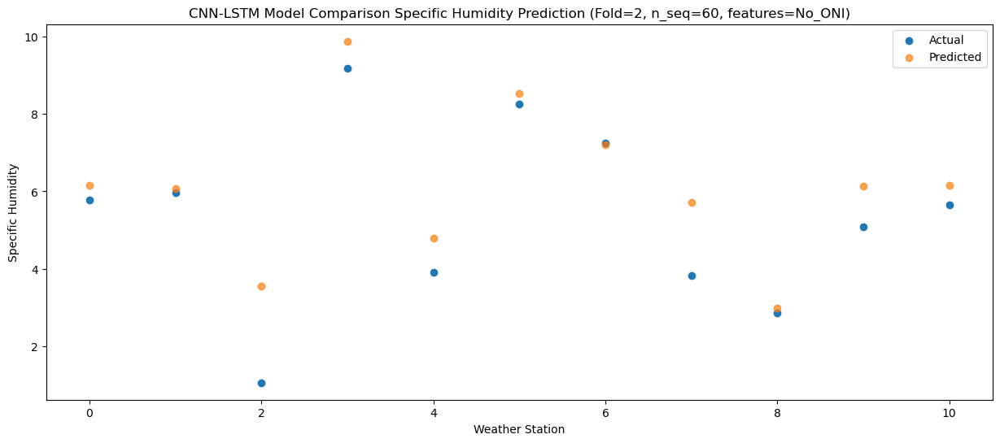

Predictions for (t+24):
    Weather_Station  Actual  Predicted
0                 0    0.59   1.496192
1                 1    3.53   1.406180
2                 2   -2.89  -1.103815
3                 3    4.72   5.216188
4                 4   -1.74   0.126187
5                 5    4.07   3.876185
6                 6    3.26   2.536183
7                 7    2.17   1.056179
8                 8    2.33  -1.673822
9                 9   -0.48   1.476194
10               10    0.30   1.496194


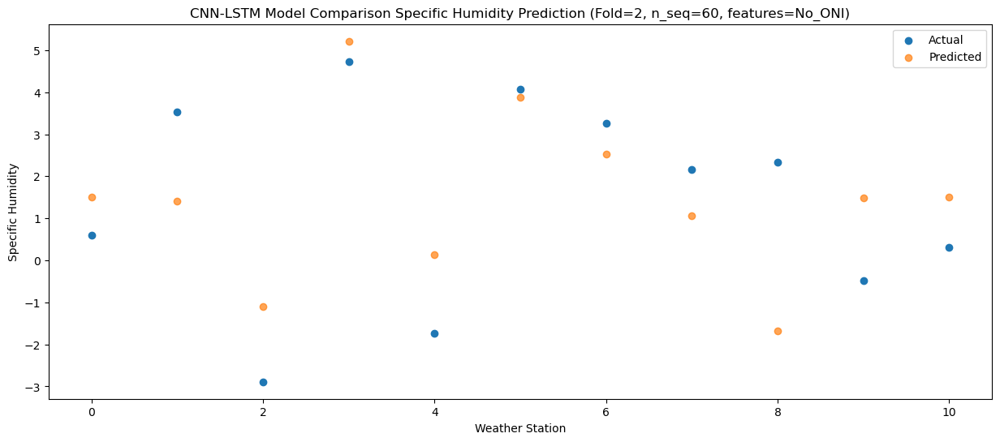

Predictions for (t+25):
    Weather_Station  Actual  Predicted
0                 0    2.99   2.189424
1                 1    2.47   2.099410
2                 2   -1.49  -0.410585
3                 3    4.36   5.909419
4                 4    1.54   0.819418
5                 5    6.94   4.569417
6                 6    5.76   3.229414
7                 7    2.30   1.749409
8                 8    2.15  -0.980596
9                 9    1.37   2.169427
10               10    1.86   2.189428


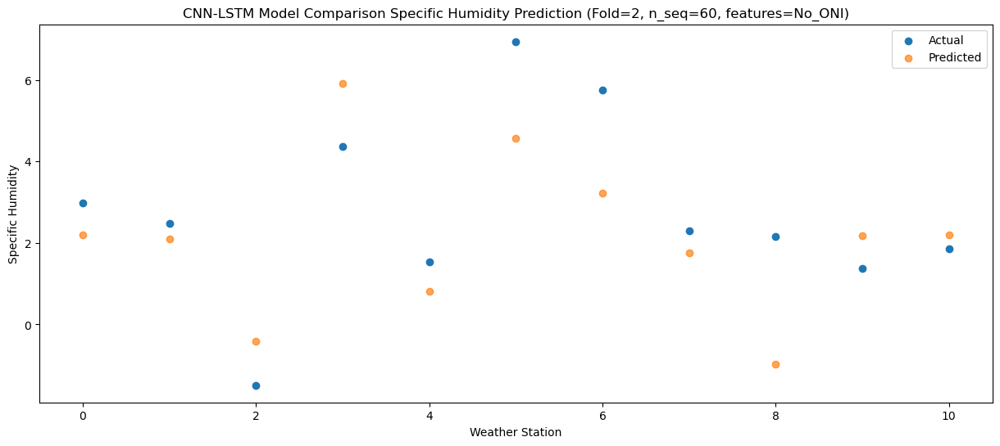

Predictions for (t+26):
    Weather_Station  Actual  Predicted
0                 0   -1.00  -0.312677
1                 1    2.14  -0.402688
2                 2   -5.14  -2.912684
3                 3    3.03   3.407319
4                 4   -3.37  -1.682682
5                 5    1.31   2.067317
6                 6    0.47   0.727313
7                 7    2.02  -0.752689
8                 8    0.79  -3.482694
9                 9   -1.41  -0.332675
10               10   -0.56  -0.312675


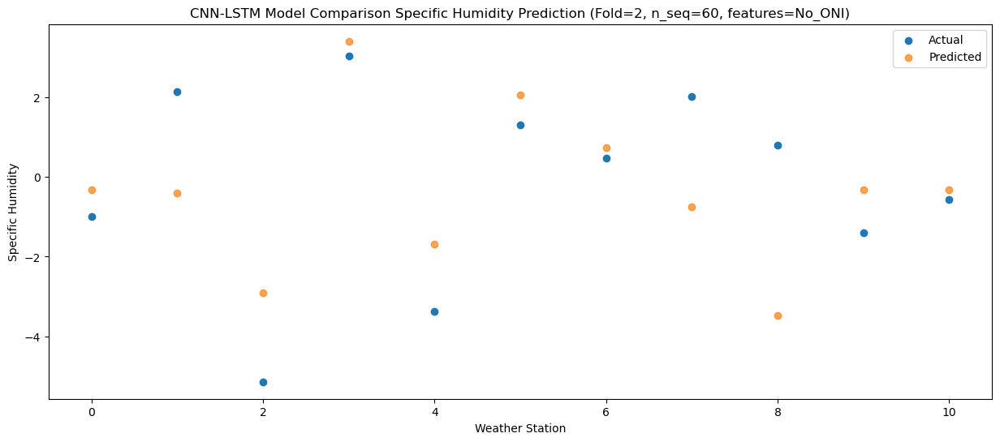

Predictions for (t+27):
    Weather_Station  Actual  Predicted
0                 0   -0.34   0.091921
1                 1    2.05   0.001908
2                 2   -3.95  -2.508087
3                 3    3.60   3.811916
4                 4   -1.91  -1.278085
5                 5    1.53   2.471914
6                 6    0.94   1.131910
7                 7    1.03  -0.348093
8                 8    0.05  -3.078099
9                 9   -0.10   0.071924
10               10    0.34   0.091925


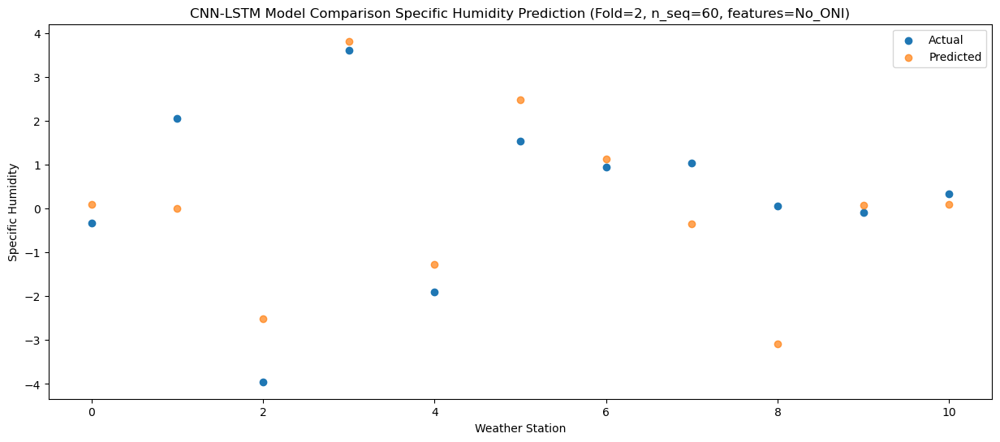

Predictions for (t+28):
    Weather_Station  Actual  Predicted
0                 0    1.09   1.271049
1                 1    2.93   1.181037
2                 2   -2.14  -1.328959
3                 3    4.36   4.991044
4                 4   -1.06  -0.098957
5                 5    3.15   3.651041
6                 6    2.57   2.311038
7                 7    1.43   0.831035
8                 8    1.79  -1.898969
9                 9    0.86   1.251054
10               10    0.96   1.271053


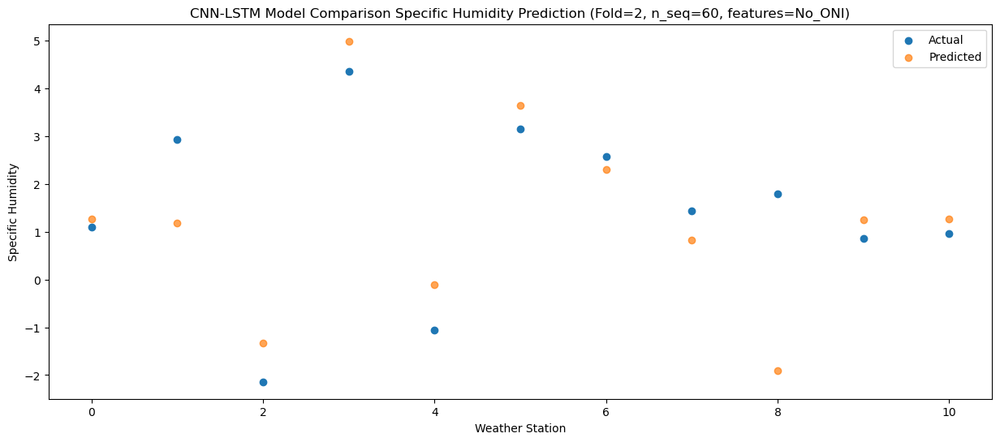

Predictions for (t+29):
    Weather_Station  Actual  Predicted
0                 0    2.99   2.820793
1                 1    4.08   2.730782
2                 2   -0.78   0.220783
3                 3    5.06   6.540787
4                 4    1.37   1.450786
5                 5    7.11   5.200785
6                 6    6.47   3.860781
7                 7    1.44   2.380780
8                 8    2.63  -0.349225
9                 9    1.90   2.800796
10               10    2.23   2.820795


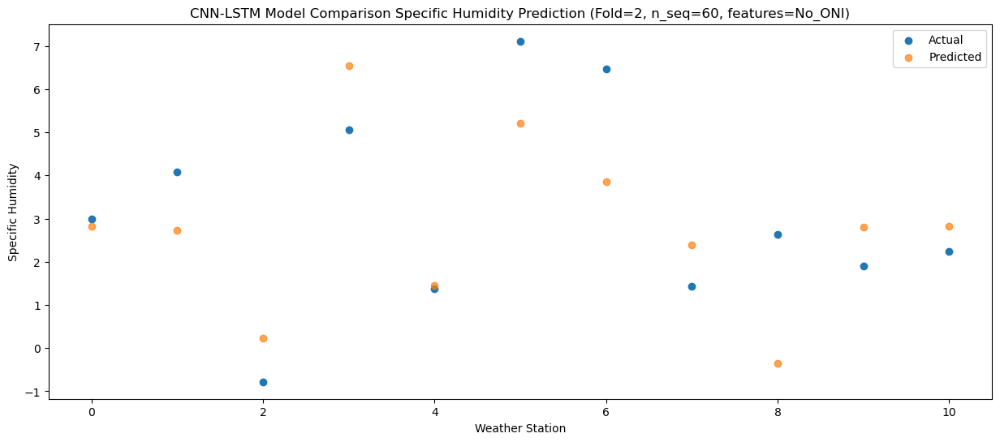

Predictions for (t+30):
    Weather_Station  Actual  Predicted
0                 0    7.25   6.630333
1                 1    6.47   6.540322
2                 2    2.32   4.030323
3                 3    8.36  10.350326
4                 4    5.40   5.260327
5                 5   10.76   9.010324
6                 6   10.56   7.670320
7                 7    1.37   6.190320
8                 8    3.89   3.460315
9                 9    6.22   6.610336
10               10    6.39   6.630333


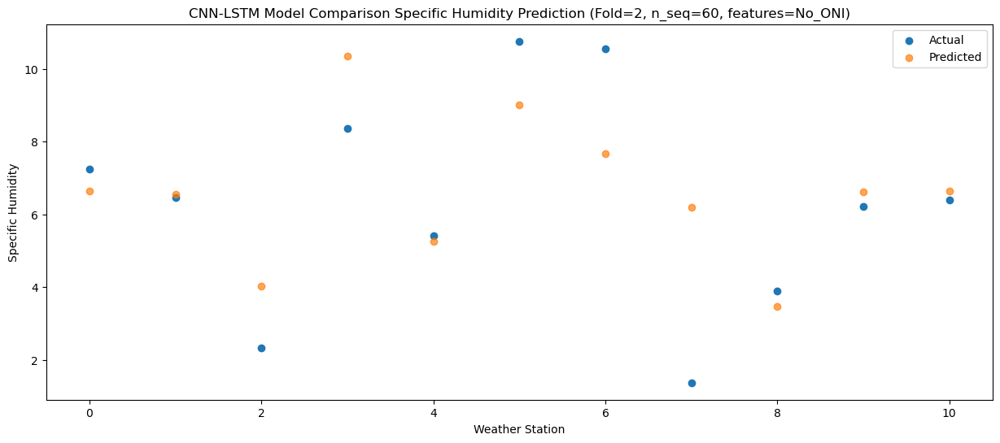

Predictions for (t+31):
    Weather_Station  Actual  Predicted
0                 0    9.30   8.599431
1                 1   10.83   8.509416
2                 2    4.25   5.999419
3                 3   10.62  12.319423
4                 4    7.70   7.229428
5                 5   11.79  10.979423
6                 6   11.36   9.639417
7                 7    6.87   8.159414
8                 8    5.66   5.429409
9                 9    8.02   8.579434
10               10    8.35   8.599432


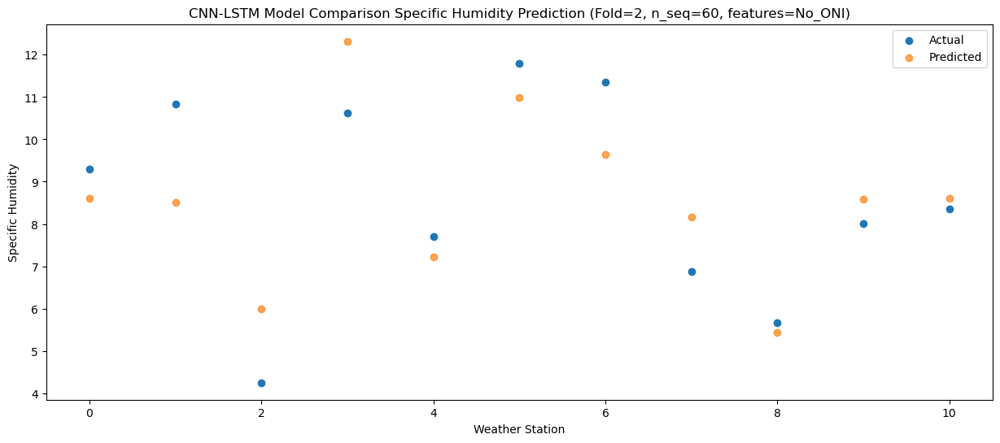

Predictions for (t+32):
    Weather_Station  Actual  Predicted
0                 0   12.52  10.570350
1                 1   12.17  10.480335
2                 2    5.08   7.970339
3                 3   13.98  14.290343
4                 4    8.99   9.200348
5                 5   12.89  12.950342
6                 6   10.68  11.610336
7                 7    9.43  10.130335
8                 8    6.55   7.400330
9                 9   11.60  10.550354
10               10   11.56  10.570352


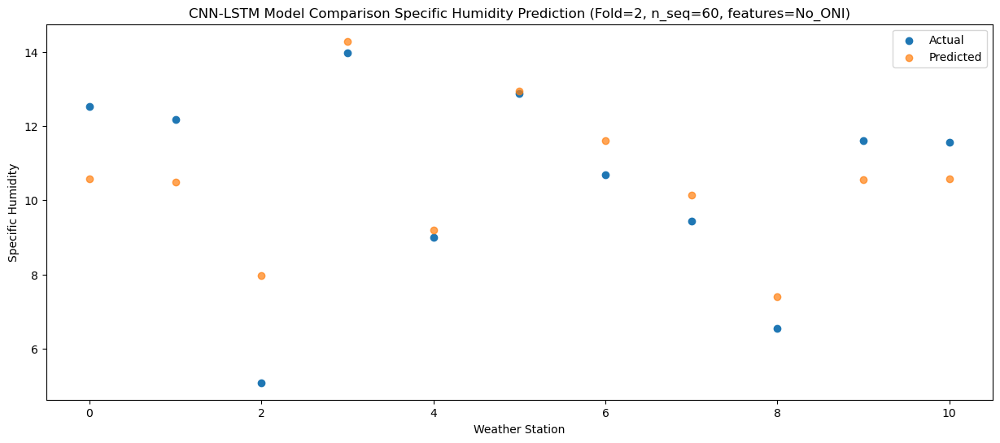

Predictions for (t+33):
    Weather_Station  Actual  Predicted
0                 0   12.04  10.545841
1                 1   11.67  10.455829
2                 2    4.97   7.945831
3                 3   14.66  14.265834
4                 4    9.39   9.175839
5                 5   13.35  12.925835
6                 6   11.74  11.585828
7                 7   11.40  10.105827
8                 8    6.65   7.375821
9                 9   10.03  10.525846
10               10   10.57  10.545843


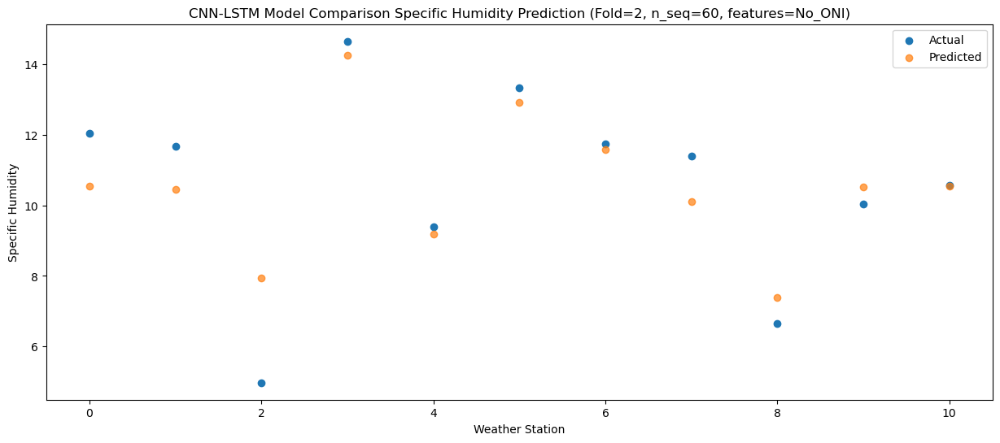

Predictions for (t+34):
    Weather_Station  Actual  Predicted
0                 0    7.29   7.614973
1                 1    9.10   7.524961
2                 2    4.82   5.014963
3                 3   10.86  11.334966
4                 4    5.88   6.244971
5                 5    9.99   9.994966
6                 6    9.07   8.654959
7                 7    8.36   7.174958
8                 8    7.50   4.444951
9                 9    6.60   7.594978
10               10    7.09   7.614975


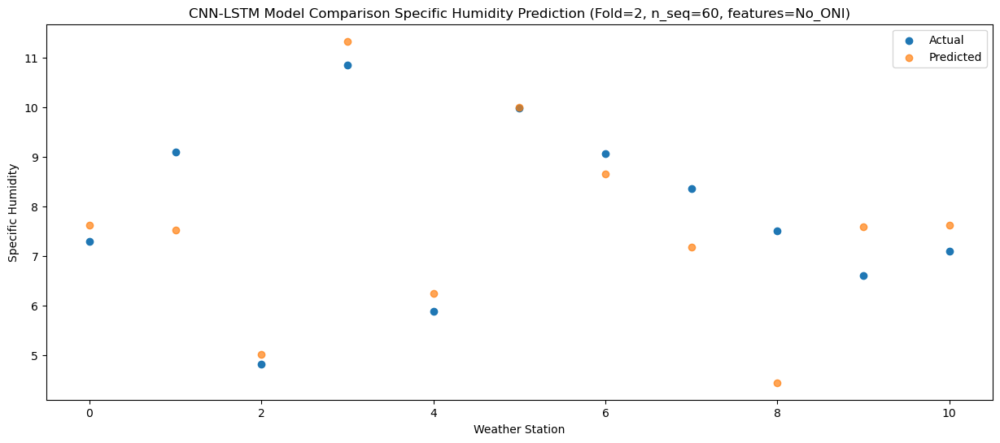

Predictions for (t+35):
    Weather_Station  Actual  Predicted
0                 0    2.57   3.244468
1                 1    5.42   3.154456
2                 2    0.43   0.644459
3                 3    7.99   6.964462
4                 4    0.70   1.874467
5                 5    5.17   5.624463
6                 6    4.29   4.284454
7                 7    6.28   2.804453
8                 8    5.73   0.074447
9                 9    2.24   3.224474
10               10    2.43   3.244471


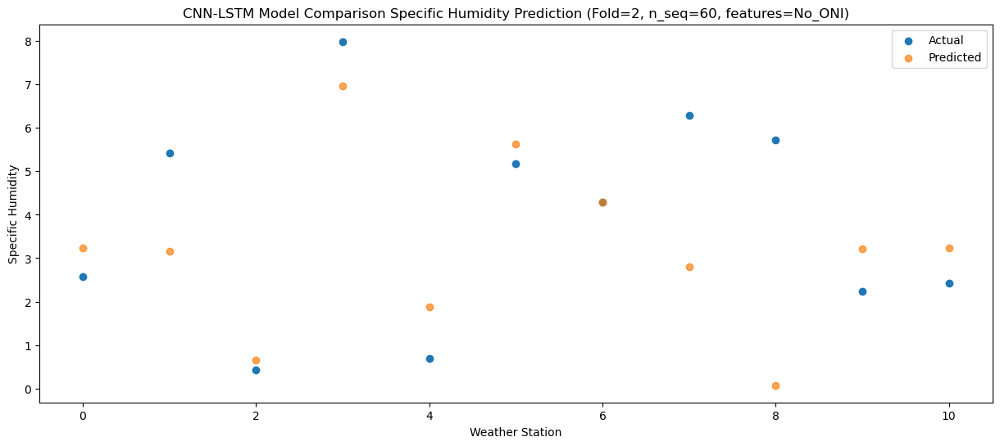

Predictions for (t+36):
    Weather_Station  Actual  Predicted
0                 0    1.63   2.051702
1                 1    3.92   1.961691
2                 2    0.32  -0.548306
3                 3    6.17   5.771696
4                 4    0.26   0.681701
5                 5    5.03   4.431698
6                 6    3.84   3.091688
7                 7    2.31   1.611689
8                 8    1.09  -1.118317
9                 9    1.77   2.031708
10               10    1.81   2.051705


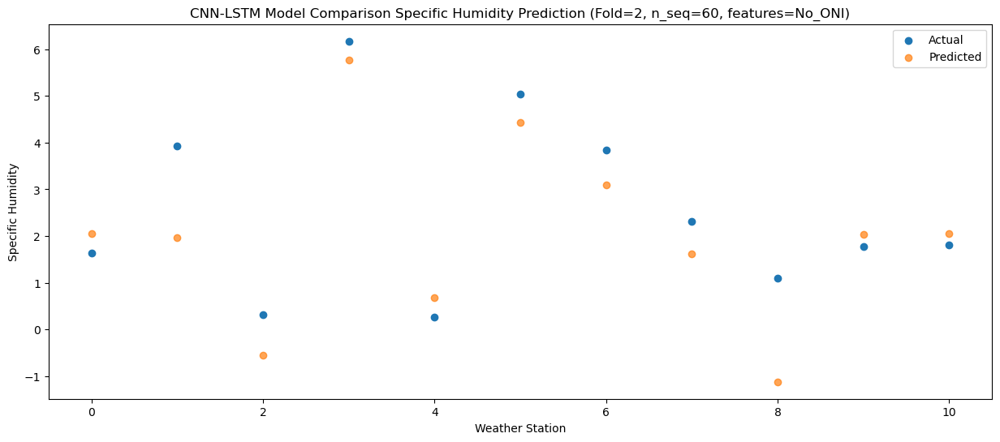

Predictions for (t+37):
    Weather_Station  Actual  Predicted
0                 0    1.00   0.756823
1                 1    2.73   0.666812
2                 2   -3.34  -1.843184
3                 3    4.08   4.476816
4                 4   -0.29  -0.613178
5                 5    4.12   3.136821
6                 6    2.67   1.796809
7                 7    3.13   0.316811
8                 8    1.94  -2.413195
9                 9   -0.47   0.736829
10               10    0.72   0.756828


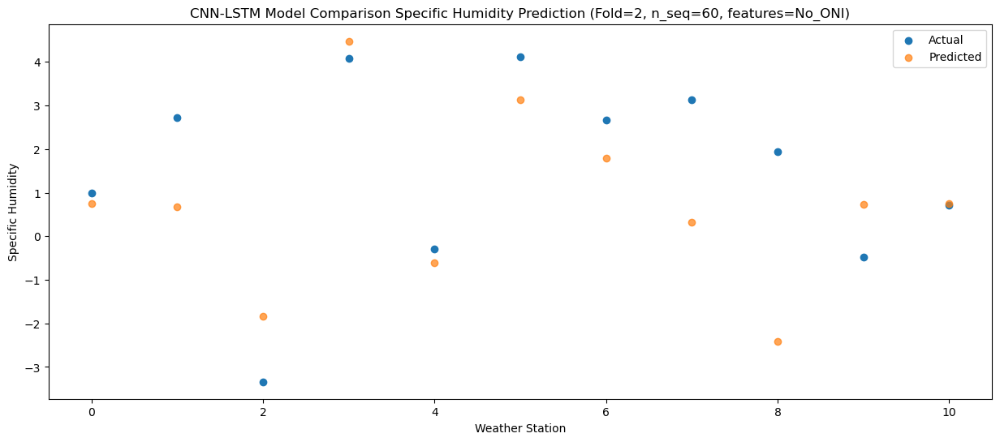

Predictions for (t+38):
    Weather_Station  Actual  Predicted
0                 0    1.41   1.047763
1                 1    2.72   0.957751
2                 2   -3.72  -1.552245
3                 3    4.59   4.767754
4                 4   -0.38  -0.322239
5                 5    3.74   3.427759
6                 6    1.89   2.087748
7                 7    2.24   0.607749
8                 8    2.03  -2.122256
9                 9    0.39   1.027769
10               10    0.99   1.047767


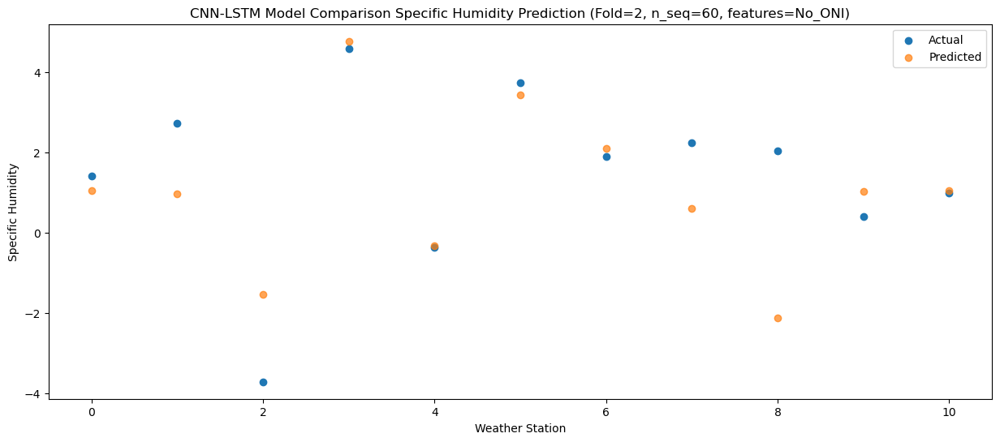

Predictions for (t+39):
    Weather_Station  Actual  Predicted
0                 0    1.63   1.044692
1                 1    2.64   0.954680
2                 2   -1.87  -1.555315
3                 3    3.83   4.764685
4                 4    0.92  -0.325309
5                 5    4.19   3.424688
6                 6    2.29   2.084676
7                 7    2.12   0.604679
8                 8    0.62  -2.125326
9                 9    1.15   1.024699
10               10    1.39   1.044697


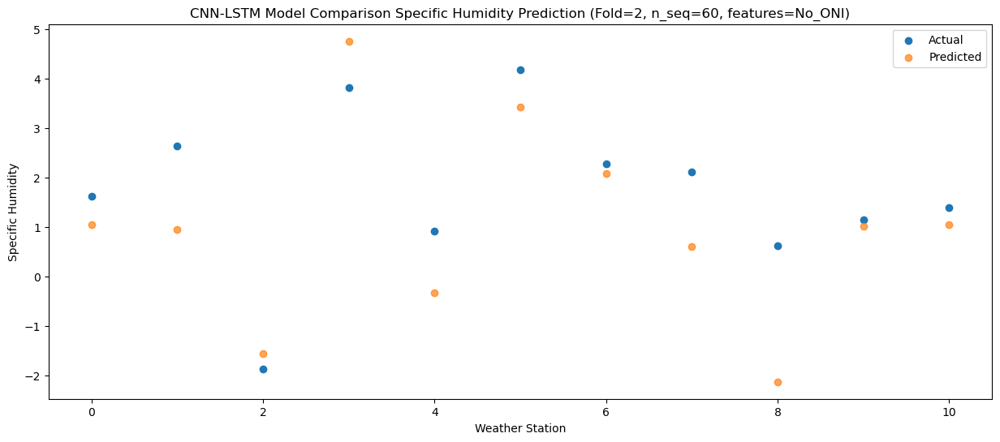

Predictions for (t+40):
    Weather_Station  Actual  Predicted
0                 0    1.98   1.597698
1                 1    3.33   1.507685
2                 2   -1.48  -1.002309
3                 3    4.08   5.317689
4                 4    1.80   0.227695
5                 5    5.97   3.977695
6                 6    4.20   2.637682
7                 7    2.46   1.157684
8                 8    2.54  -1.572321
9                 9    0.84   1.577703
10               10    0.99   1.597701


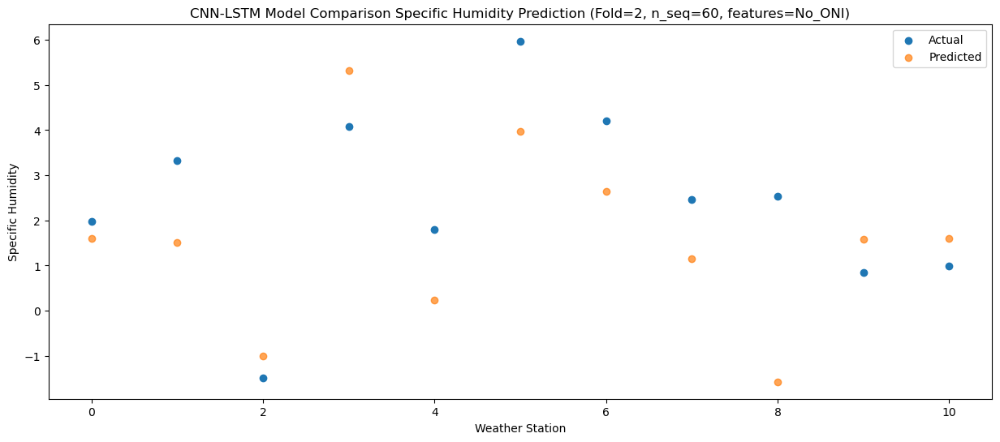

Predictions for (t+41):
    Weather_Station  Actual  Predicted
0                 0    2.92   2.868485
1                 1    3.95   2.778469
2                 2    0.03   0.268473
3                 3    6.16   6.588473
4                 4    2.35   1.498481
5                 5    6.52   5.248480
6                 6    4.87   3.908467
7                 7    1.62   2.428468
8                 8    3.24  -0.301538
9                 9    2.97   2.848488
10               10    2.63   2.868483


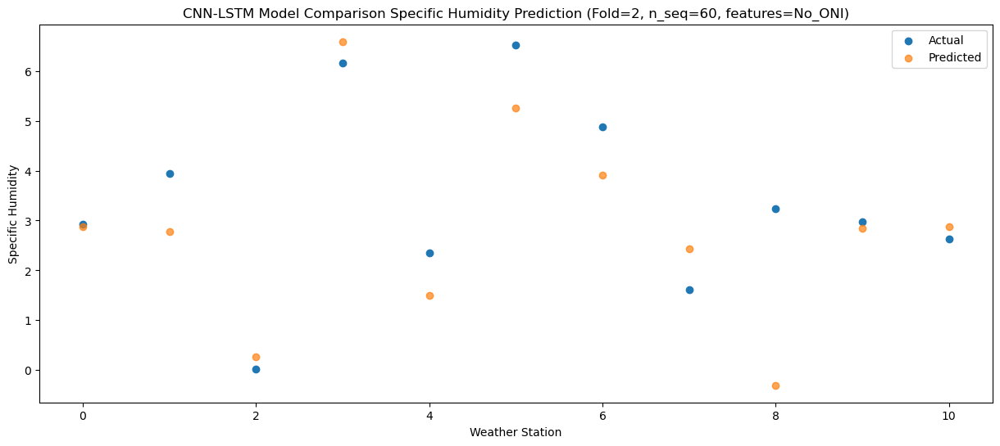

Predictions for (t+42):
    Weather_Station  Actual  Predicted
0                 0    6.53   5.179447
1                 1    9.73   5.089431
2                 2    0.84   2.579434
3                 3    6.97   8.899434
4                 4    5.41   3.809443
5                 5   10.22   7.559441
6                 6    8.76   6.219429
7                 7    3.62   4.739429
8                 8    4.64   2.009422
9                 9    4.50   5.159449
10               10    5.22   5.179443


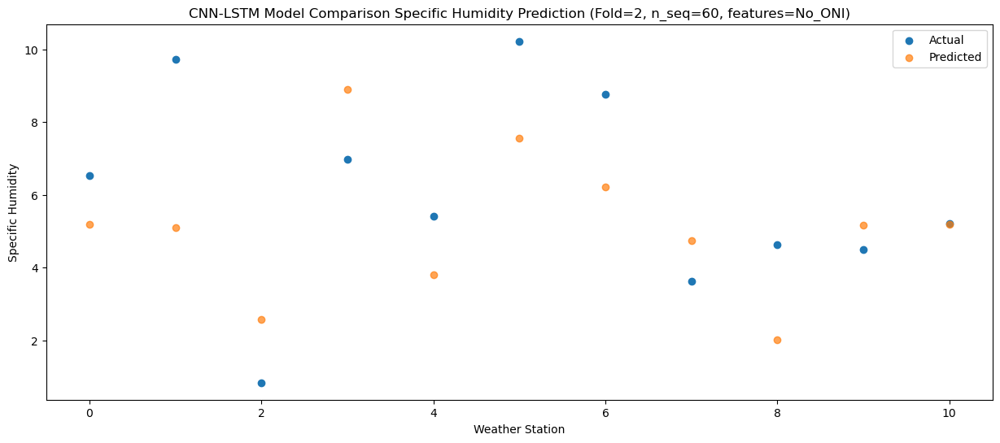

Predictions for (t+43):
    Weather_Station  Actual  Predicted
0                 0    9.50   7.823747
1                 1   12.38   7.733731
2                 2    4.00   5.223734
3                 3   10.87  11.543734
4                 4    8.72   6.453743
5                 5   13.68  10.203740
6                 6   12.66   8.863728
7                 7    3.42   7.383727
8                 8    5.02   4.653721
9                 9    7.36   7.803748
10               10    7.06   7.823744


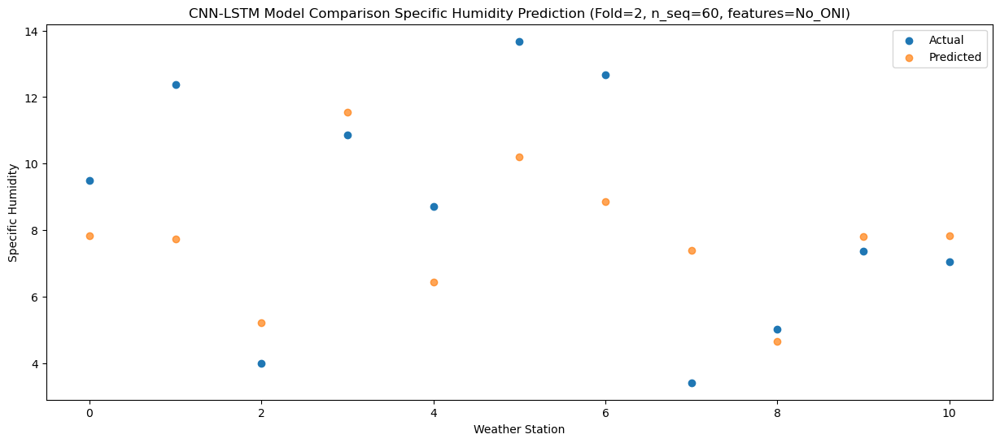

Predictions for (t+44):
    Weather_Station  Actual  Predicted
0                 0   12.68  10.696738
1                 1   14.44  10.606721
2                 2    4.97   8.096723
3                 3   15.13  14.416722
4                 4   10.06   9.326735
5                 5   13.39  13.076730
6                 6   11.95  11.736718
7                 7    6.77  10.256717
8                 8    6.36   7.526711
9                 9   11.20  10.676739
10               10   10.37  10.696735


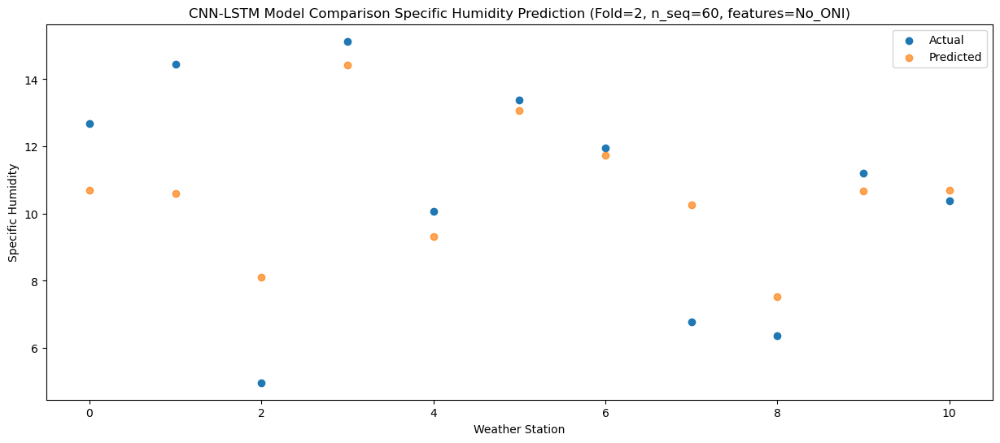

Predictions for (t+45):
    Weather_Station  Actual  Predicted
0                 0   12.03  10.194171
1                 1   12.55  10.104149
2                 2    5.69   7.594153
3                 3   12.79  13.914152
4                 4   10.09   8.824166
5                 5   11.96  12.574159
6                 6    9.90  11.234148
7                 7    8.96   9.754145
8                 8    6.97   7.024137
9                 9   10.71  10.174171
10               10   10.48  10.194168


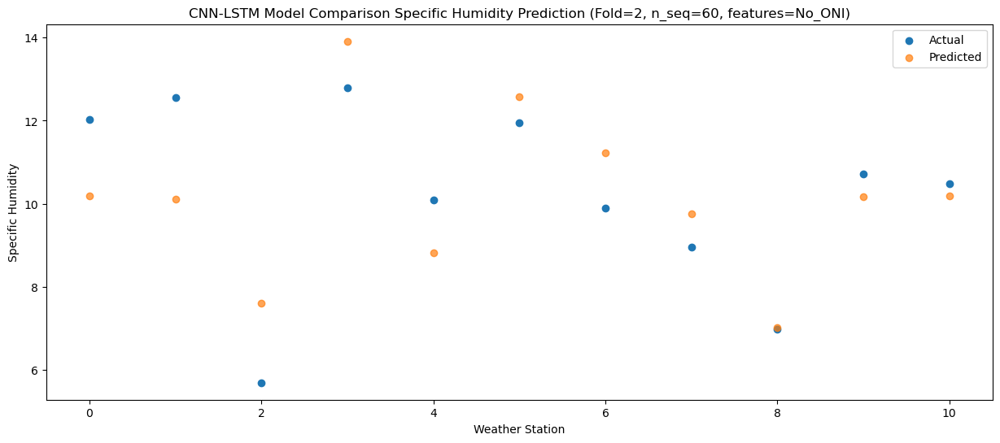

Predictions for (t+46):
    Weather_Station  Actual  Predicted
0                 0    8.00   7.788804
1                 1    9.96   7.698781
2                 2    3.30   5.188786
3                 3   11.78  11.508785
4                 4    7.74   6.418799
5                 5   11.41  10.168791
6                 6    9.27   8.828779
7                 7    7.15   7.348776
8                 8    6.72   4.618769
9                 9    7.57   7.768805
10               10    8.06   7.788802


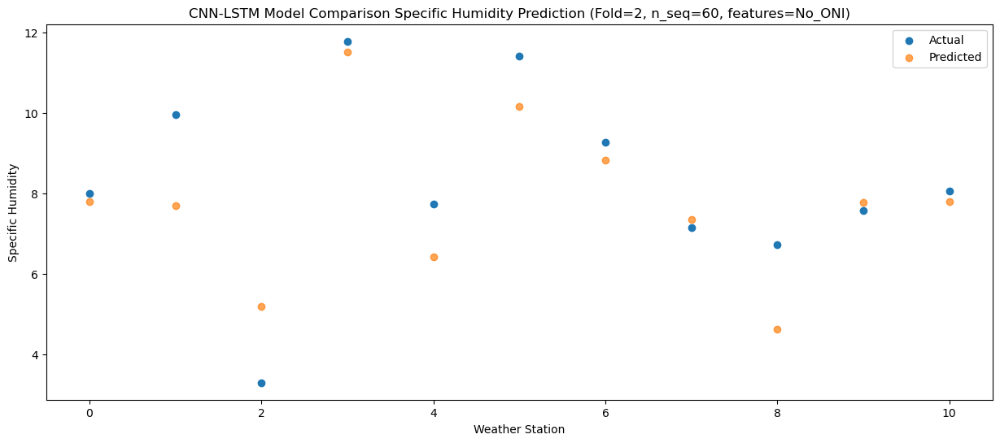

Predictions for (t+47):
    Weather_Station  Actual  Predicted
0                 0    3.90   4.447275
1                 1    6.50   4.357252
2                 2    0.38   1.847256
3                 3    8.42   8.167257
4                 4    2.51   3.077270
5                 5    7.88   6.827262
6                 6    6.12   5.487250
7                 7    4.70   4.007247
8                 8    4.42   1.277240
9                 9    3.38   4.427276
10               10    3.95   4.447273


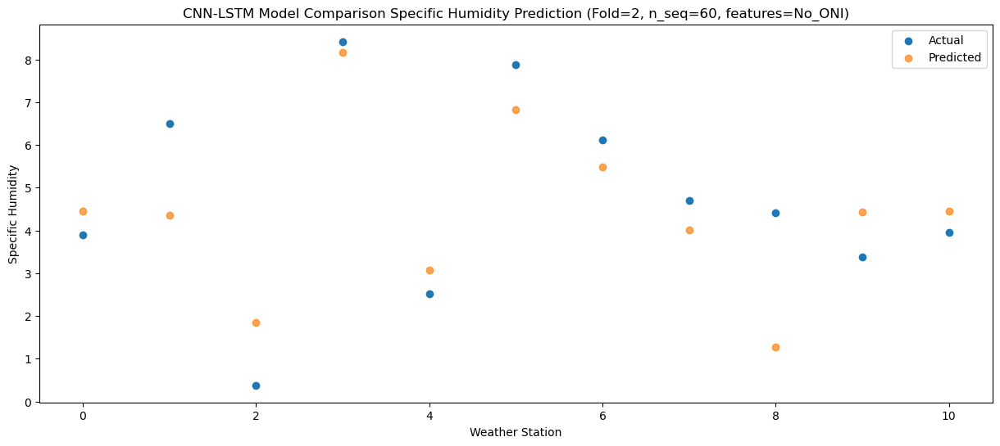

Predictions for (t+48):
    Weather_Station  Actual  Predicted
0                 0    1.26   1.646834
1                 1    3.94   1.556810
2                 2   -2.12  -0.953184
3                 3    4.59   5.366818
4                 4   -0.01   0.276829
5                 5    4.71   4.026820
6                 6    3.50   2.686810
7                 7    3.78   1.206807
8                 8    1.39  -1.523199
9                 9    0.27   1.626834
10               10    1.00   1.646832


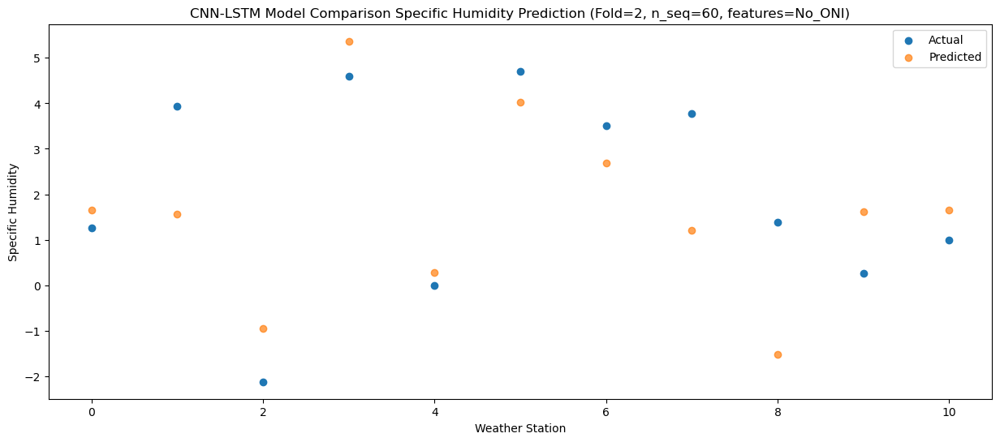

Predictions for (t+49):
    Weather_Station  Actual  Predicted
0                 0    0.34   1.276173
1                 1    3.55   1.186145
2                 2   -2.69  -1.323848
3                 3    4.88   4.996153
4                 4   -1.60  -0.093833
5                 5    2.78   3.656157
6                 6    1.68   2.316145
7                 7    2.26   0.836142
8                 8    2.18  -1.893863
9                 9    0.18   1.256173
10               10    0.79   1.276170


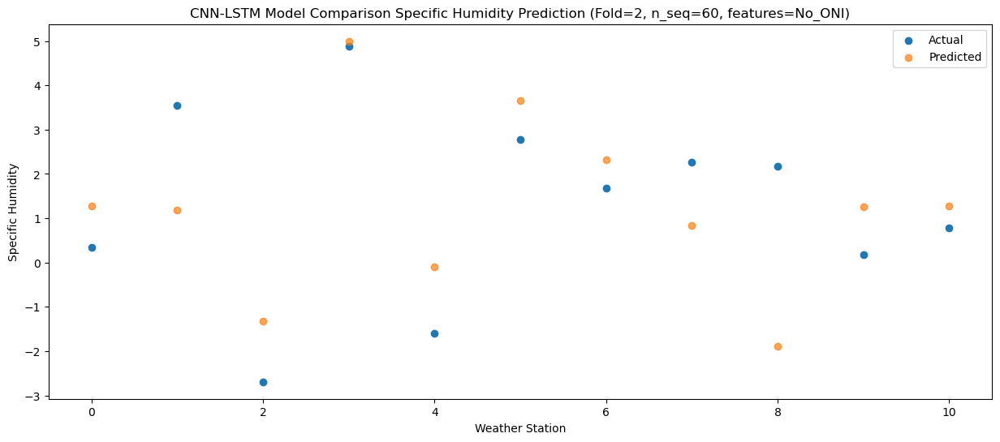

Predictions for (t+50):
    Weather_Station  Actual  Predicted
0                 0   -0.55   0.203841
1                 1    2.96   0.113814
2                 2   -3.76  -2.396177
3                 3    3.55   3.923823
4                 4   -2.47  -1.166164
5                 5    1.77   2.583826
6                 6    0.56   1.243814
7                 7    2.68  -0.236187
8                 8    2.15  -2.966193
9                 9   -0.51   0.183842
10               10    0.17   0.203839


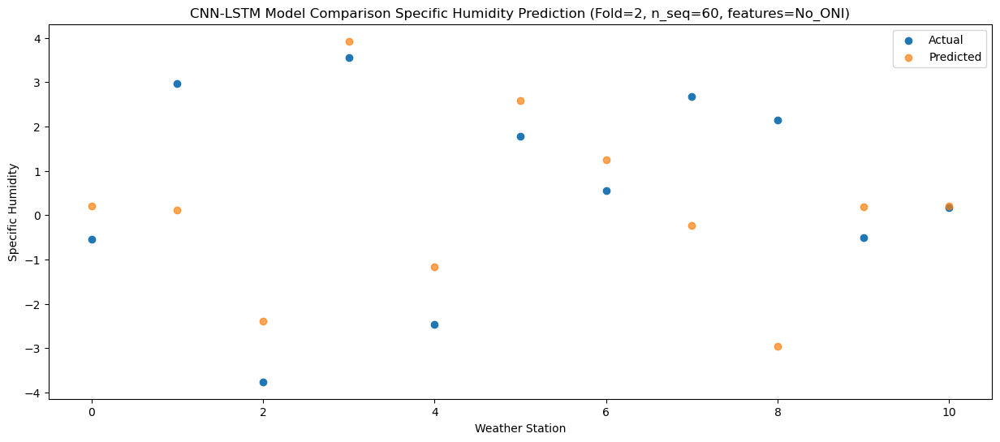

Predictions for (t+51):
    Weather_Station  Actual  Predicted
0                 0    1.32   0.963100
1                 1    3.78   0.873075
2                 2   -4.18  -1.636917
3                 3    3.50   4.683082
4                 4   -1.41  -0.406907
5                 5    4.17   3.343088
6                 6    3.03   2.003074
7                 7    2.70   0.523075
8                 8    3.12  -2.206930
9                 9   -0.37   0.943102
10               10    0.57   0.963098


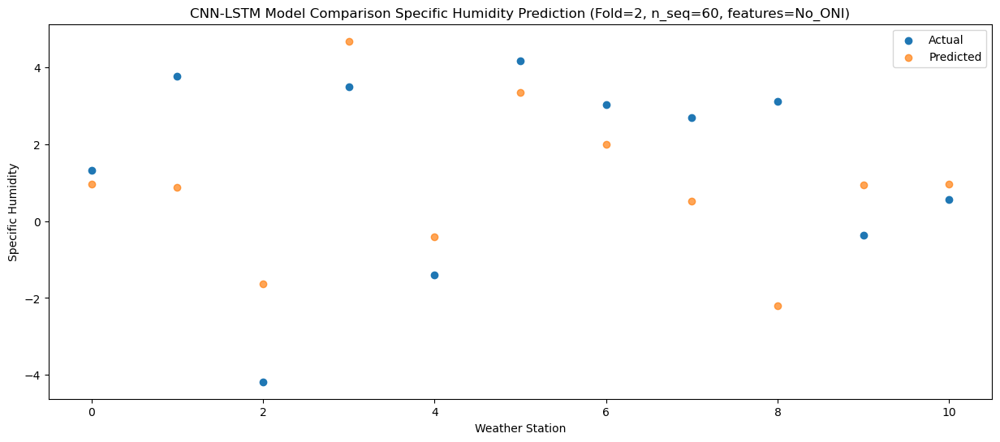

Predictions for (t+52):
    Weather_Station  Actual  Predicted
0                 0    2.14   2.147467
1                 1    4.03   2.057439
2                 2   -1.02  -0.452554
3                 3    4.55   5.867446
4                 4    0.19   0.777459
5                 5    5.81   4.527450
6                 6    4.65   3.187438
7                 7    2.92   1.707437
8                 8    1.56  -1.022572
9                 9    1.04   2.127467
10               10    1.67   2.147463


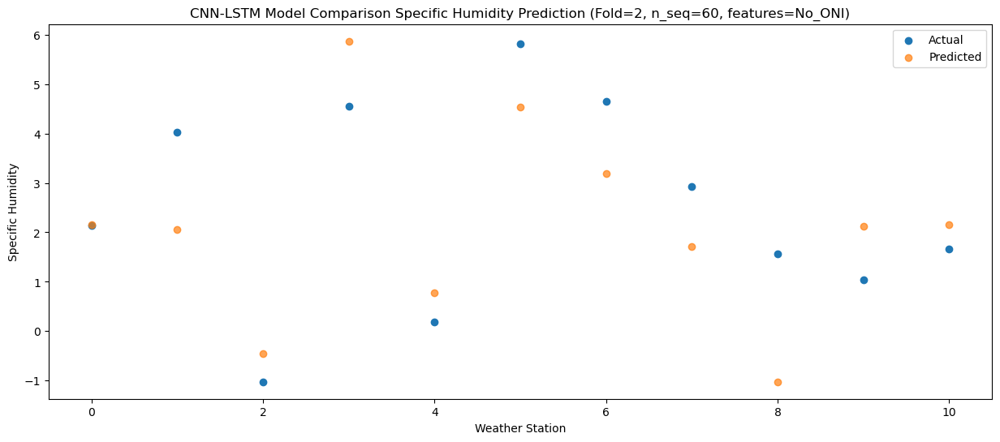

Predictions for (t+53):
    Weather_Station  Actual  Predicted
0                 0    4.35   3.799457
1                 1    4.99   3.709426
2                 2   -2.23   1.199435
3                 3    5.44   7.519435
4                 4    2.26   2.429448
5                 5    8.09   6.179438
6                 6    6.85   4.839425
7                 7    2.25   3.359423
8                 8    0.66   0.629414
9                 9    3.26   3.779455
10               10    3.78   3.799452


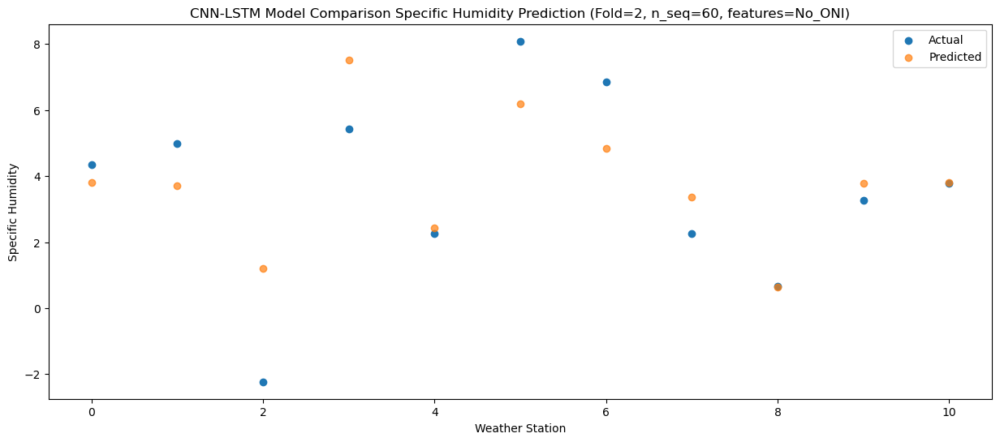

Predictions for (t+54):
    Weather_Station  Actual  Predicted
0                 0    8.61   7.262032
1                 1    8.02   7.172002
2                 2    2.63   4.662012
3                 3    8.62  10.982012
4                 4    6.69   5.892023
5                 5   12.19   9.642012
6                 6   10.63   8.302000
7                 7    1.94   6.822000
8                 8    4.76   4.091991
9                 9    7.14   7.242031
10               10    7.64   7.262028


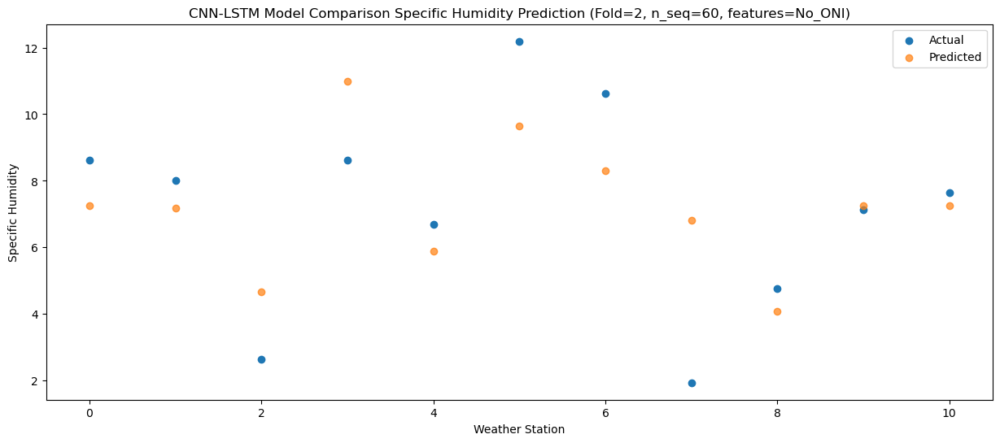

Predictions for (t+55):
    Weather_Station  Actual  Predicted
0                 0   10.58   9.328180
1                 1   14.03   9.238150
2                 2    4.69   6.728160
3                 3   11.54  13.048160
4                 4    8.66   7.958172
5                 5   13.85  11.708162
6                 6   12.22  10.368149
7                 7    5.99   8.888148
8                 8    6.36   6.158140
9                 9    9.01   9.308180
10               10    9.19   9.328175


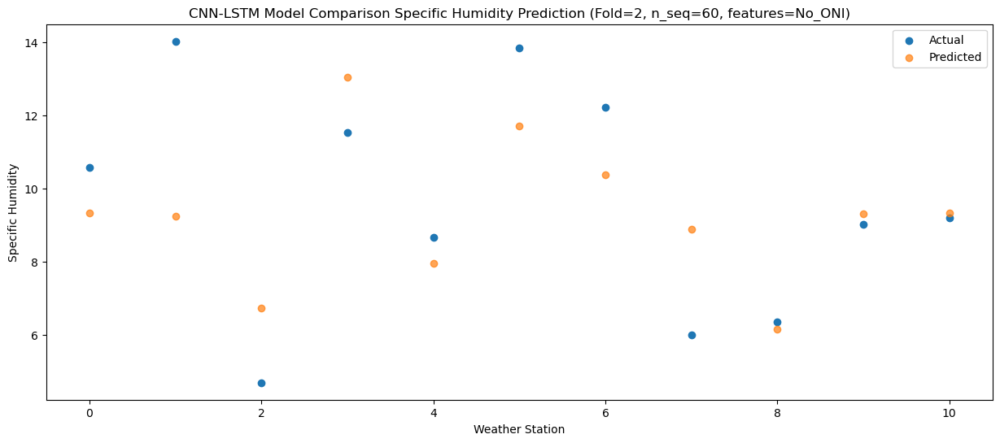

Predictions for (t+56):
    Weather_Station  Actual  Predicted
0                 0   12.05  10.695322
1                 1   12.58  10.605295
2                 2    5.74   8.095303
3                 3   14.71  14.415305
4                 4   10.30   9.325316
5                 5   14.15  13.075305
6                 6   12.45  11.735293
7                 7    9.59  10.255292
8                 8    7.59   7.525284
9                 9   11.62  10.675323
10               10   11.23  10.695319


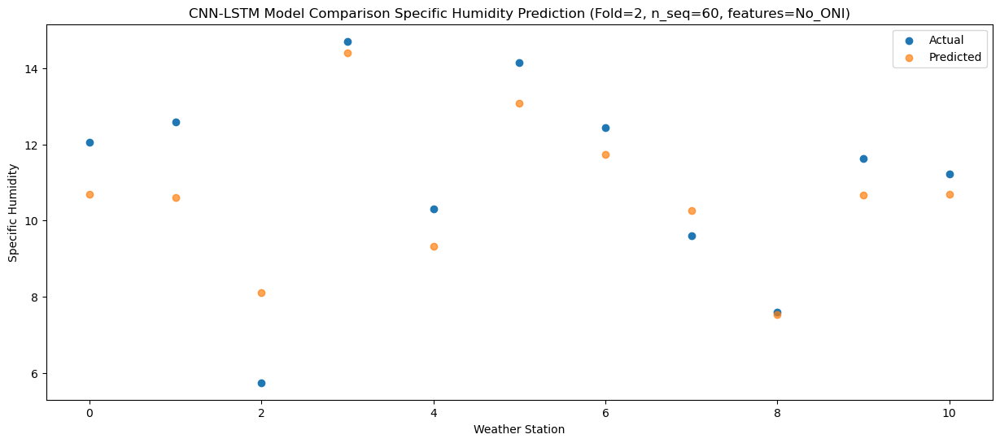

Predictions for (t+57):
    Weather_Station  Actual  Predicted
0                 0   10.05   9.814974
1                 1   13.56   9.724946
2                 2    6.34   7.214954
3                 3   13.21  13.534956
4                 4    9.13   8.444965
5                 5   14.19  12.194954
6                 6   12.27  10.854942
7                 7    9.27   9.374943
8                 8    6.77   6.644935
9                 9   10.36   9.794973
10               10   10.22   9.814968


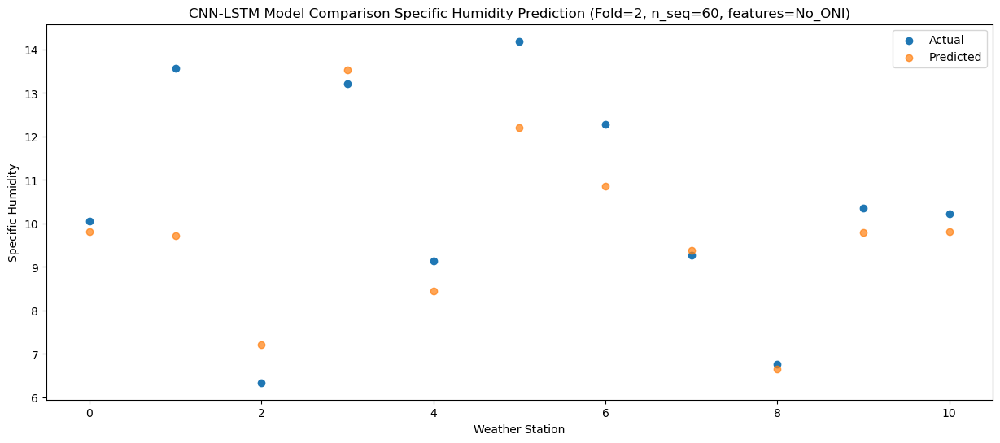

Predictions for (t+58):
    Weather_Station  Actual  Predicted
0                 0    8.43   7.722019
1                 1    9.61   7.631990
2                 2    6.77   5.121997
3                 3   10.32  11.441999
4                 4    7.53   6.352010
5                 5   11.70  10.101999
6                 6    9.37   8.761987
7                 7    6.53   7.281986
8                 8    6.38   4.551979
9                 9    8.51   7.702018
10               10    8.12   7.722012


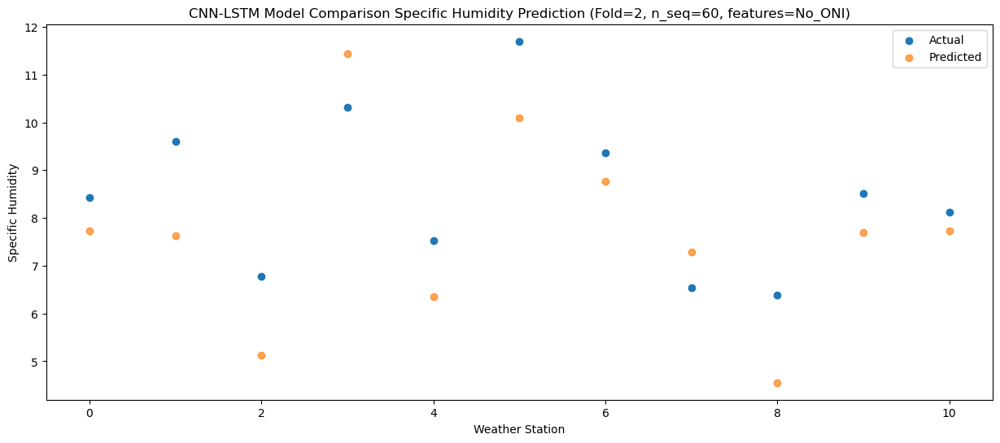

Predictions for (t+59):
    Weather_Station  Actual  Predicted
0                 0    4.05   3.864426
1                 1    6.75   3.774400
2                 2    1.79   1.264407
3                 3    7.08   7.584406
4                 4    2.67   2.494418
5                 5    7.38   6.244408
6                 6    5.95   4.904396
7                 7    3.64   3.424397
8                 8    4.48   0.694390
9                 9    3.89   3.844426
10               10    4.05   3.864420


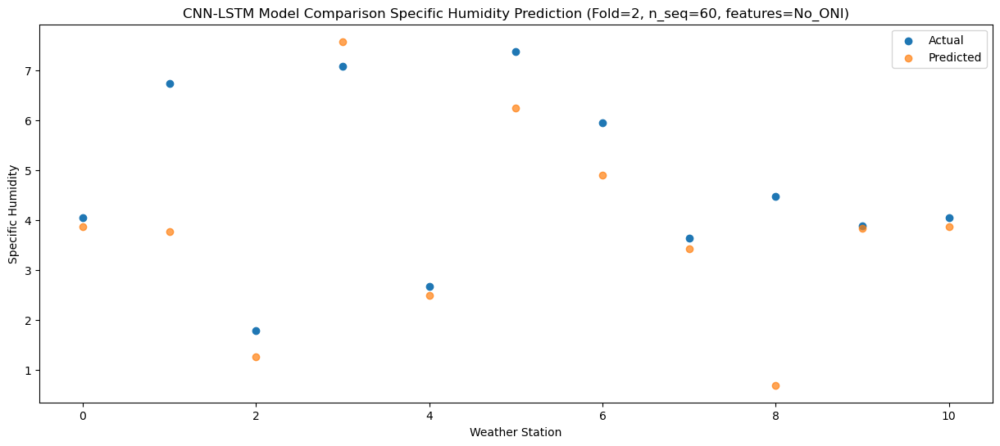

f, t:
[[ 8.500e-01  3.340e+00 -2.460e+00  4.490e+00 -2.070e+00  3.770e+00
   2.890e+00  3.550e+00  2.230e+00 -1.700e-01  5.200e-01]
 [ 1.350e+00  2.830e+00 -2.150e+00  3.930e+00 -1.270e+00  2.580e+00
   1.790e+00  3.100e+00  2.050e+00 -6.000e-02  9.700e-01]
 [ 1.060e+00  2.810e+00 -3.710e+00  3.750e+00 -1.240e+00  3.410e+00
   2.470e+00  2.150e+00  1.840e+00 -8.000e-02  7.700e-01]
 [ 7.400e-01  2.870e+00 -2.830e+00  3.770e+00 -9.200e-01  2.740e+00
   1.910e+00  2.680e+00  1.120e+00  3.100e-01  8.800e-01]
 [ 3.670e+00  4.660e+00 -1.660e+00  4.290e+00  2.570e+00  7.350e+00
   6.130e+00  4.140e+00  2.760e+00  1.940e+00  2.730e+00]
 [ 3.510e+00  4.950e+00 -1.800e-01  4.670e+00  1.610e+00  6.830e+00
   5.710e+00  2.740e+00  4.170e+00  1.850e+00  2.160e+00]
 [ 6.500e+00  7.850e+00  9.300e-01  6.920e+00  3.730e+00  8.910e+00
   8.650e+00  2.980e+00  4.930e+00  5.180e+00  4.950e+00]
 [ 9.650e+00  9.270e+00  4.270e+00  1.093e+01  7.070e+00  1.103e+01
   1.093e+01  4.660e+00  4.910e+00  8.690e+0

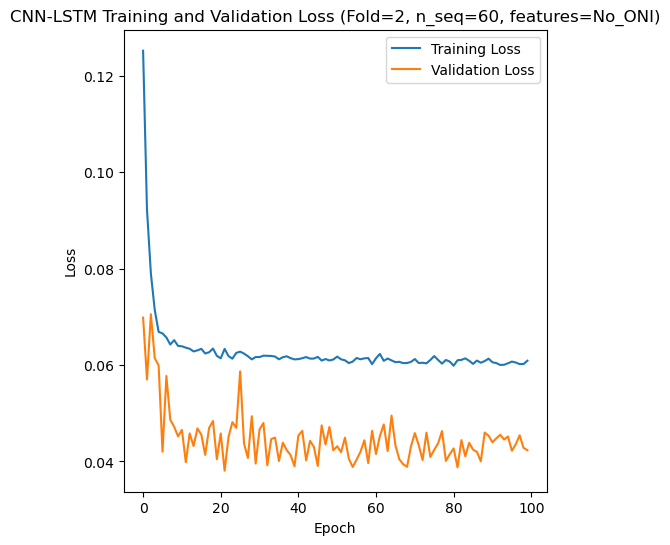

[[ 5.11  3.7   4.74 ... 13.5   8.68  7.66]
 [ 3.73  2.91  5.05 ... 11.19  6.96  6.57]
 [ 5.56  5.41  5.55 ...  8.56  7.45  5.59]
 ...
 [ 2.73  2.21  3.23 ...  5.    3.95  3.09]
 [ 5.93  5.59  5.49 ...  8.63  7.04  6.11]
 [ 3.71  2.55  2.84 ...  9.78  6.68  4.77]]
Epoch 1/100
84/84 [==============================] - 11s 37ms/step - loss: 0.1313 - accuracy: 0.1548 - mae: 0.1080 - rmse: 0.1313 - mape: 23.5456 - pearson: 0.5904 - val_loss: 0.1398 - val_accuracy: 0.3000 - val_mae: 0.1150 - val_rmse: 0.1398 - val_mape: 23.9832 - val_pearson: 0.6672
Epoch 2/100
84/84 [==============================] - 2s 23ms/step - loss: 0.0877 - accuracy: 0.2143 - mae: 0.0711 - rmse: 0.0877 - mape: 15.6945 - pearson: 0.7382 - val_loss: 0.0828 - val_accuracy: 0.0000e+00 - val_mae: 0.0687 - val_rmse: 0.0828 - val_mape: 14.9248 - val_pearson: 0.6484
Epoch 3/100
84/84 [==============================] - 2s 21ms/step - loss: 0.0748 - accuracy: 0.3214 - mae: 0.0600 - rmse: 0.0748 - mape: 13.5748 - pearson: 0.7708 

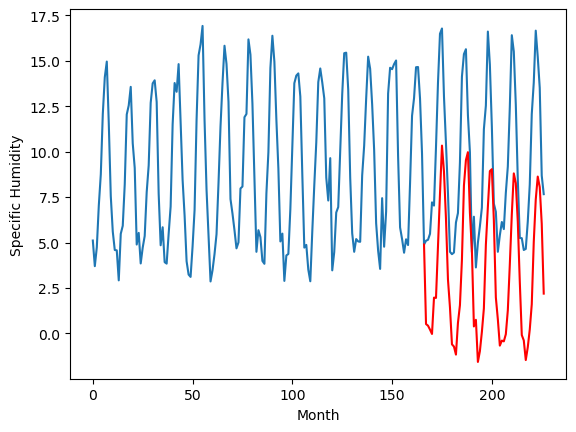

Weather Station 2:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
2.24		1.92		-0.32
1.83		1.83		-0.00
1.80		1.61		-0.19
1.44		1.37		-0.07
4.04		3.37		-0.67
4.19		3.35		-0.84
7.16		6.19		-0.97
10.69		9.06		-1.63
13.43		11.73		-1.70
10.76		10.31		-0.45
9.32		7.71		-1.61
4.75		4.37		-0.38
3.25		2.84		-0.41
1.21		0.80		-0.41
1.12		0.68		-0.44
0.56		0.24		-0.32
3.07		1.98		-1.09
4.24		2.95		-1.29
7.76		5.46		-2.30
12.29		9.53		-2.76
13.17		10.93		-2.24
13.34		11.37		-1.97
9.37		8.04		-1.33
7.18		5.98		-1.20
2.75		1.79		-0.96
3.72		2.15		-1.57
0.53		-0.16		-0.69
0.90		0.43		-0.47
2.37		1.49		-0.88
4.67		2.78		-1.89
9.12		6.28		-2.84
11.74		8.36		-3.38
11.95		10.33		-1.62
12.56		10.43		-2.13
8.71		7.63		-1.08
4.25		3.38		-0.87
3.22		2.18		-1.04
2.03		0.73		-1.30
1.95		1.01		-0.94
2.11		0.97		-1.14
3.05		1.36		-1.69
3.92		2.67		-1.25
8.33		5.19		-3.14
10.97		7.95		-3.02
13.24		10.20		-3.04
13.48		9.67		-3.81
9.41		7.54		-1.87
5.97		4.24		-1.73
3.09		1.31		-1.78
2.2

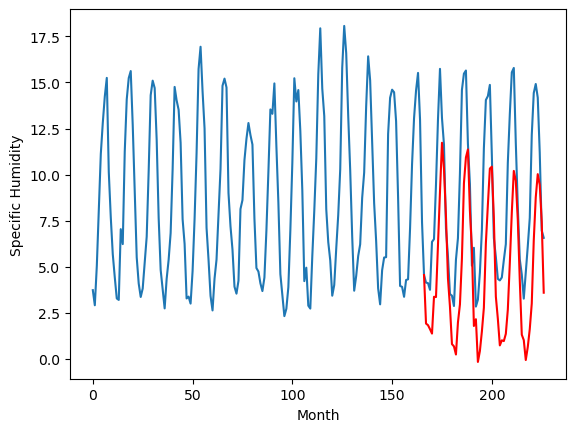

Weather Station 3:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
3.79		0.54		-3.25
4.33		0.45		-3.88
3.95		0.23		-3.72
3.26		-0.01		-3.27
4.34		1.99		-2.35
5.71		1.97		-3.74
5.52		4.81		-0.71
7.06		7.68		0.62
7.28		10.35		3.07
8.80		8.93		0.13
8.32		6.34		-1.98
6.44		2.99		-3.45
3.75		1.46		-2.29
3.15		-0.58		-3.73
3.59		-0.70		-4.29
3.53		-1.14		-4.67
3.61		0.60		-3.01
4.23		1.57		-2.66
4.63		4.08		-0.55
7.08		8.15		1.07
7.78		9.55		1.77
7.31		9.99		2.68
6.02		6.66		0.64
4.88		4.60		-0.28
5.46		0.41		-5.05
3.96		0.77		-3.19
3.68		-1.54		-5.22
2.90		-0.95		-3.85
4.24		0.11		-4.13
3.91		1.40		-2.51
4.09		4.90		0.81
5.26		6.98		1.72
6.43		8.95		2.52
7.22		9.05		1.83
6.93		6.25		-0.68
5.76		2.00		-3.76
3.04		0.80		-2.24
3.88		-0.65		-4.53
4.03		-0.37		-4.40
2.90		-0.41		-3.31
4.42		-0.02		-4.44
4.62		1.29		-3.33
5.56		3.81		-1.75
6.33		6.57		0.24
7.43		8.82		1.39
8.50		8.29		-0.21
6.96		6.16		-0.80
5.80		2.86		-2.94
3.69		-0.07		-3.76
3.92		-0.36		-4.28
4.46	

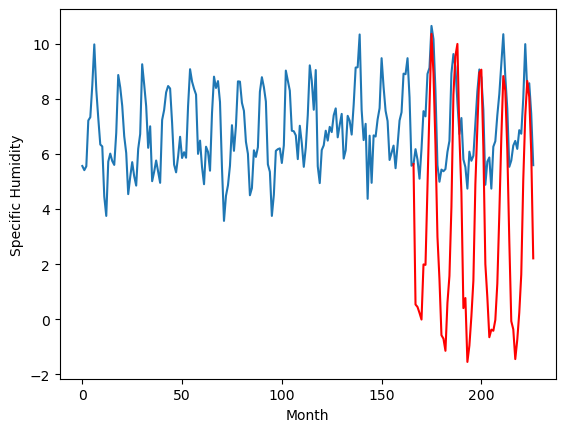

Weather Station 4:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
1.02		2.37		1.35
1.55		2.28		0.73
1.15		2.06		0.91
0.97		1.82		0.85
2.83		3.82		0.99
2.75		3.80		1.05
6.18		6.64		0.46
9.42		9.51		0.09
12.52		12.18		-0.34
11.44		10.76		-0.68
8.87		8.16		-0.71
5.18		4.82		-0.36
2.29		3.29		1.00
0.68		1.25		0.57
0.41		1.13		0.72
0.34		0.69		0.35
1.64		2.43		0.79
2.83		3.40		0.57
5.36		5.91		0.55
10.78		9.98		-0.80
11.41		11.38		-0.03
12.29		11.82		-0.47
8.82		8.49		-0.33
6.76		6.43		-0.33
1.07		2.24		1.17
2.21		2.60		0.39
-0.11		0.29		0.40
0.41		0.88		0.47
1.39		1.94		0.55
2.66		3.23		0.57
7.08		6.73		-0.35
9.34		8.81		-0.53
12.38		10.78		-1.60
11.25		10.88		-0.37
8.00		8.08		0.08
2.85		3.83		0.98
2.04		2.63		0.59
1.01		1.18		0.17
1.55		1.46		-0.09
1.37		1.42		0.05
1.24		1.81		0.57
2.78		3.12		0.34
5.69		5.64		-0.05
7.71		8.40		0.69
11.36		10.65		-0.71
10.81		10.12		-0.69
8.34		7.99		-0.35
4.81		4.69		-0.12
1.42		1.76		0.34
1.44		1.47		0.03
0.70		0.39		-0.31


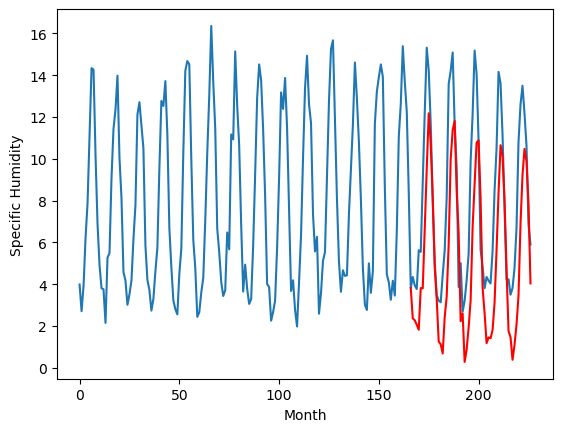

Weather Station 5:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
2.49		0.80		-1.69
0.99		0.71		-0.28
-1.30		0.49		1.79
-2.06		0.25		2.31
0.01		2.25		2.24
0.33		2.23		1.90
4.03		5.07		1.04
7.12		7.94		0.82
11.07		10.61		-0.46
8.69		9.19		0.50
5.73		6.59		0.86
1.01		3.25		2.24
-0.09		1.72		1.81
-2.02		-0.32		1.70
-2.22		-0.44		1.78
-3.05		-0.88		2.17
-0.57		0.86		1.43
0.49		1.83		1.34
2.91		4.34		1.43
7.37		8.41		1.04
9.32		9.81		0.49
9.41		10.25		0.84
5.64		6.92		1.28
3.69		4.86		1.17
-1.43		0.67		2.10
-0.73		1.03		1.76
-3.19		-1.28		1.91
-2.57		-0.69		1.88
-1.00		0.37		1.37
0.56		1.66		1.10
4.65		5.16		0.51
6.75		7.24		0.49
9.34		9.21		-0.13
8.84		9.31		0.47
5.74		6.51		0.77
0.74		2.26		1.52
-0.65		1.06		1.71
-1.77		-0.39		1.38
-1.39		-0.11		1.28
-0.51		-0.15		0.36
-0.84		0.24		1.08
0.39		1.55		1.16
3.57		4.07		0.50
5.70		6.83		1.13
9.47		9.08		-0.39
9.86		8.55		-1.31
5.75		6.42		0.67
2.13		3.12		0.99
-1.04		0.19		1.23
-1.45		-0.10		1.35
-2.32		-1.18		1.14

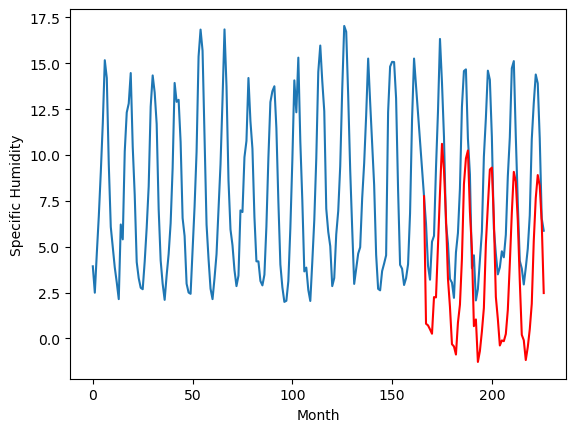

Weather Station 6:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
0.44		0.74		0.30
0.73		0.65		-0.08
0.23		0.43		0.20
-0.02		0.19		0.21
1.97		2.19		0.22
2.09		2.17		0.08
5.30		5.01		-0.29
8.03		7.88		-0.15
11.19		10.55		-0.64
9.97		9.13		-0.84
6.79		6.53		-0.26
3.37		3.19		-0.18
1.60		1.66		0.06
-0.06		-0.38		-0.32
-0.37		-0.50		-0.13
-0.89		-0.94		-0.05
1.14		0.80		-0.34
2.44		1.77		-0.67
4.68		4.28		-0.40
9.90		8.35		-1.55
11.15		9.75		-1.40
11.32		10.19		-1.13
8.02		6.86		-1.16
6.40		4.80		-1.60
0.53		0.61		0.08
1.58		0.97		-0.61
-0.93		-1.34		-0.41
-0.40		-0.75		-0.35
0.91		0.31		-0.60
2.44		1.60		-0.84
6.67		5.10		-1.57
8.74		7.18		-1.56
11.52		9.15		-2.37
10.32		9.25		-1.07
7.55		6.45		-1.10
2.25		2.20		-0.05
1.03		1.00		-0.03
0.27		-0.45		-0.72
0.85		-0.17		-1.02
0.52		-0.21		-0.73
0.95		0.18		-0.77
2.26		1.49		-0.77
4.86		4.01		-0.85
7.02		6.77		-0.25
11.53		9.02		-2.51
10.65		8.49		-2.16
7.42		6.36		-1.06
4.04		3.06		-0.98
0.85		0.13		-0.72
0.81		-

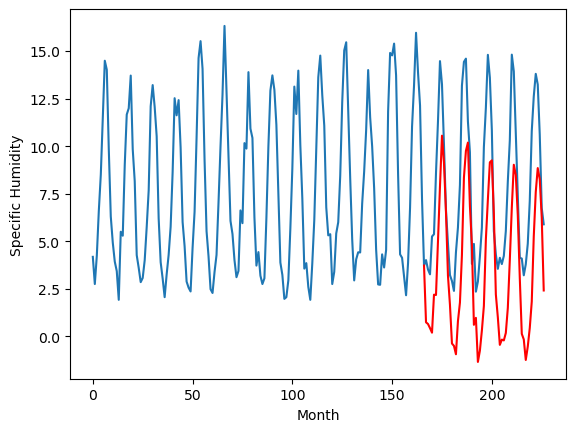

Weather Station 7:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
4.78		0.99		-3.79
4.41		0.90		-3.51
4.37		0.68		-3.69
4.33		0.44		-3.89
4.96		2.44		-2.52
5.31		2.42		-2.89
6.44		5.26		-1.18
7.50		8.13		0.63
9.02		10.80		1.78
7.81		9.38		1.57
6.67		6.79		0.12
5.02		3.44		-1.58
4.96		1.91		-3.05
4.15		-0.13		-4.28
4.32		-0.25		-4.57
4.38		-0.69		-5.07
4.69		1.05		-3.64
5.16		2.02		-3.14
6.56		4.53		-2.03
7.89		8.60		0.71
10.34		10.00		-0.34
8.91		10.44		1.53
7.21		7.11		-0.10
6.12		5.05		-1.07
5.41		0.86		-4.55
4.70		1.22		-3.48
4.22		-1.09		-5.31
4.01		-0.50		-4.51
4.69		0.56		-4.13
5.19		1.85		-3.34
6.00		5.35		-0.65
7.94		7.43		-0.51
10.93		9.40		-1.53
10.77		9.50		-1.27
7.82		6.70		-1.12
6.21		2.45		-3.76
4.55		1.25		-3.30
4.58		-0.20		-4.78
4.55		0.08		-4.47
4.17		0.04		-4.13
4.47		0.43		-4.04
5.10		1.74		-3.36
7.26		4.26		-3.00
7.49		7.02		-0.47
8.33		9.27		0.94
9.98		8.74		-1.24
7.36		6.61		-0.75
6.11		3.31		-2.80
4.78		0.38		-4.40
4.65		0.09		-4.56


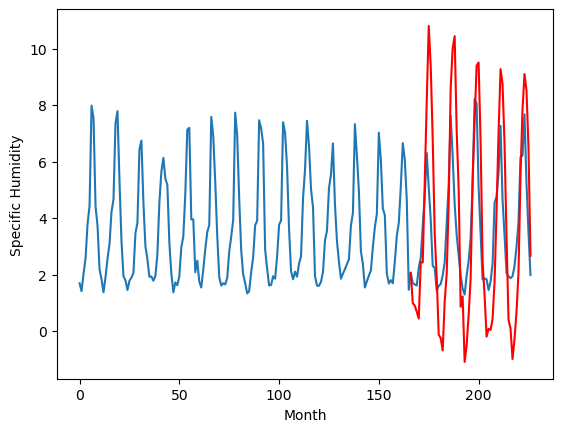

Weather Station 8:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
2.69		-1.50		-4.19
3.68		-1.59		-5.27
2.56		-1.81		-4.37
2.14		-2.05		-4.19
3.88		-0.05		-3.93
3.69		-0.07		-3.76
2.99		2.77		-0.22
3.32		5.64		2.32
3.80		8.31		4.51
4.67		6.89		2.22
3.41		4.30		0.89
2.40		0.95		-1.45
2.38		-0.58		-2.96
1.55		-2.62		-4.17
2.36		-2.74		-5.10
1.88		-3.18		-5.06
2.18		-1.44		-3.62
1.87		-0.47		-2.34
2.43		2.04		-0.39
3.85		6.11		2.26
9.21		7.51		-1.70
6.78		7.95		1.17
5.06		4.62		-0.44
3.96		2.56		-1.40
2.69		-1.63		-4.32
2.83		-1.27		-4.10
1.84		-3.58		-5.42
1.41		-2.99		-4.40
2.03		-1.93		-3.96
2.03		-0.64		-2.67
2.29		2.86		0.57
4.05		4.94		0.89
7.48		6.91		-0.57
10.55		7.01		-3.54
6.64		4.21		-2.43
3.91		-0.04		-3.95
2.14		-1.24		-3.38
2.89		-2.69		-5.58
3.28		-2.41		-5.69
2.03		-2.45		-4.48
3.07		-2.06		-5.13
2.22		-0.75		-2.97
3.76		1.77		-1.99
4.26		4.53		0.27
5.23		6.78		1.55
7.81		6.25		-1.56
6.87		4.12		-2.75
3.81		0.82		-2.99
2.80		-2.11		-4.91
2.72		

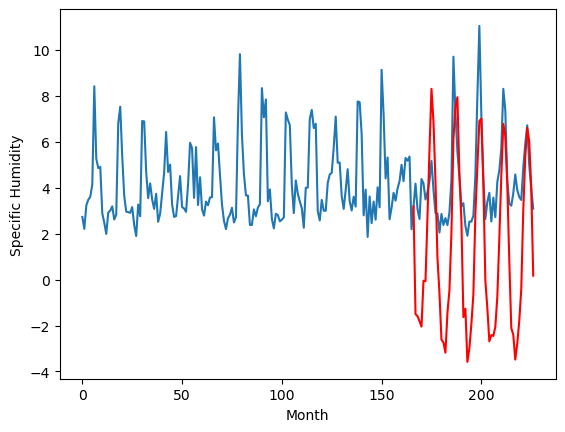

Weather Station 9:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
3.33		-0.46		-3.79
4.56		-0.55		-5.11
3.88		-0.77		-4.65
2.99		-1.01		-4.00
3.47		0.99		-2.48
4.53		0.97		-3.56
5.39		3.81		-1.58
5.61		6.68		1.07
6.08		9.35		3.27
6.88		7.93		1.05
6.49		5.34		-1.15
4.29		1.99		-2.30
3.13		0.46		-2.67
2.79		-1.58		-4.37
3.46		-1.70		-5.16
3.11		-2.14		-5.25
2.76		-0.40		-3.16
3.69		0.57		-3.12
4.13		3.08		-1.05
5.56		7.15		1.59
6.04		8.55		2.51
6.43		8.99		2.56
5.79		5.66		-0.13
4.76		3.60		-1.16
4.98		-0.59		-5.57
3.73		-0.23		-3.96
3.40		-2.54		-5.94
2.56		-1.95		-4.51
3.56		-0.89		-4.45
3.66		0.40		-3.26
4.03		3.90		-0.13
5.52		5.98		0.46
6.35		7.95		1.60
6.81		8.05		1.24
6.21		5.25		-0.96
4.90		1.00		-3.90
2.65		-0.20		-2.85
3.44		-1.65		-5.09
3.27		-1.37		-4.64
2.41		-1.41		-3.82
3.21		-1.02		-4.23
3.59		0.29		-3.30
5.18		2.81		-2.37
5.24		5.57		0.33
6.08		7.82		1.74
7.35		7.29		-0.06
6.80		5.16		-1.64
5.37		1.86		-3.51
4.28		-1.07		-5.35
4.66		-1.36		-6

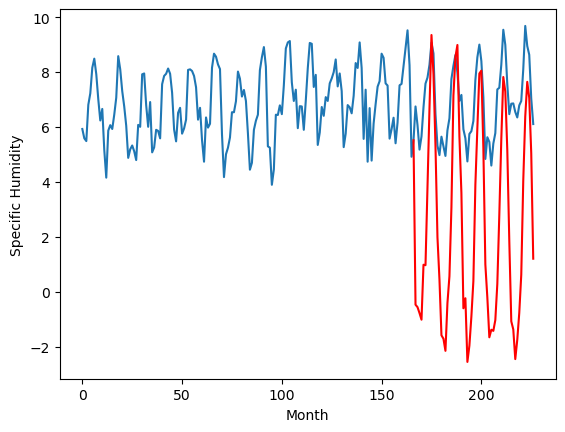

Weather Station 10:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
2.25		2.74		0.49
1.89		2.65		0.76
1.61		2.43		0.82
1.69		2.19		0.50
2.18		4.19		2.01
2.68		4.17		1.49
4.91		7.01		2.10
9.02		9.88		0.86
13.00		12.55		-0.45
11.93		11.13		-0.80
8.56		8.54		-0.02
6.03		5.19		-0.84
3.87		3.66		-0.21
1.91		1.62		-0.29
0.82		1.50		0.68
0.97		1.06		0.09
1.75		2.80		1.05
3.13		3.77		0.64
4.70		6.28		1.58
9.60		10.35		0.75
11.81		11.75		-0.06
12.19		12.19		-0.00
9.59		8.86		-0.73
7.05		6.80		-0.25
2.52		2.61		0.09
2.22		2.97		0.75
0.74		0.66		-0.08
1.33		1.25		-0.08
2.17		2.31		0.14
2.82		3.60		0.78
6.21		7.10		0.89
8.55		9.18		0.63
11.71		11.15		-0.56
11.85		11.25		-0.60
8.18		8.45		0.27
5.55		4.20		-1.35
3.70		3.00		-0.70
1.73		1.55		-0.18
2.30		1.83		-0.47
1.59		1.79		0.20
1.80		2.18		0.38
4.04		3.49		-0.55
4.56		6.01		1.45
8.26		8.77		0.51
13.11		11.02		-2.09
10.54		10.49		-0.05
9.57		8.36		-1.21
6.18		5.06		-1.12
2.38		2.13		-0.25
2.71		1.84		-0.87
1.41		0.76		

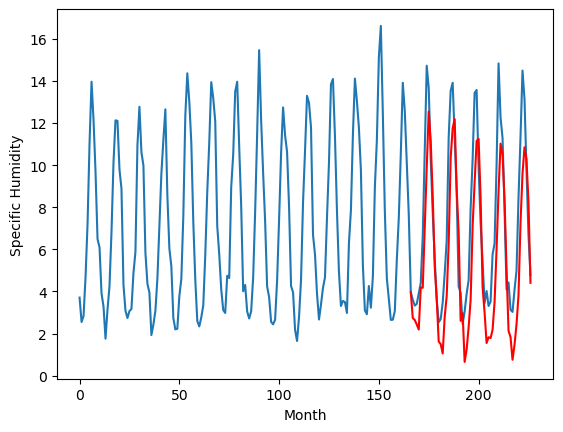

Weather Station 11:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
-0.54		0.52		1.06
-0.66		0.43		1.09
-0.74		0.21		0.95
-0.75		-0.03		0.72
0.21		1.97		1.76
0.64		1.95		1.31
3.17		4.79		1.62
6.74		7.66		0.92
10.09		10.33		0.24
9.45		8.91		-0.54
6.16		6.32		0.16
3.39		2.97		-0.42
1.06		1.44		0.38
-0.79		-0.60		0.19
-1.48		-0.72		0.76
-1.62		-1.16		0.46
-0.34		0.58		0.92
1.07		1.55		0.48
2.66		4.06		1.40
7.53		8.13		0.60
9.22		9.53		0.31
9.54		9.97		0.43
6.62		6.64		0.02
4.72		4.58		-0.14
-0.20		0.39		0.59
-0.30		0.75		1.05
-1.81		-1.56		0.25
-1.11		-0.97		0.14
-0.17		0.09		0.26
0.47		1.38		0.91
4.65		4.88		0.23
6.05		6.96		0.91
9.03		8.93		-0.10
8.66		9.03		0.37
5.64		6.23		0.59
2.22		1.98		-0.24
1.00		0.78		-0.22
-0.92		-0.67		0.25
-0.14		-0.39		-0.25
-0.89		-0.43		0.46
-0.76		-0.04		0.72
1.67		1.27		-0.40
2.14		3.79		1.65
5.83		6.55		0.72
9.81		8.80		-1.01
8.57		8.27		-0.30
6.88		6.14		-0.74
3.61		2.84		-0.77
-0.07		-0.09		-0.02
0.31		-0.38		-0.69
-0.82		-

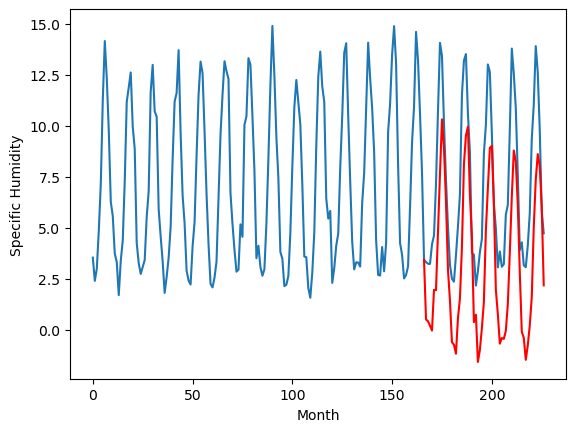

Predictions for (t+0):
    Weather_Station  Actual  Predicted
0                 0   -1.29   0.517673
1                 1    2.24   1.917674
2                 2    3.79   0.537664
3                 3    1.02   2.367673
4                 4    2.49   0.797672
5                 5    0.44   0.737671
6                 6    4.78   0.987667
7                 7    2.69  -1.502333
8                 8    3.33  -0.462336
9                 9    2.25   2.737668
10               10   -0.54   0.517670


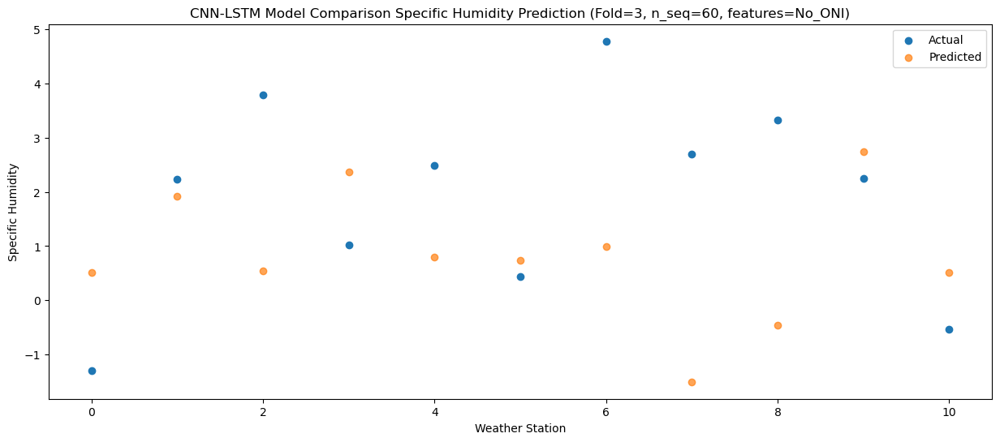

Predictions for (t+1):
    Weather_Station  Actual  Predicted
0                 0   -1.08   0.428718
1                 1    1.83   1.828724
2                 2    4.33   0.448744
3                 3    1.55   2.278717
4                 4    0.99   0.708717
5                 5    0.73   0.648714
6                 6    4.41   0.898740
7                 7    3.68  -1.591257
8                 8    4.56  -0.551256
9                 9    1.89   2.648720
10               10   -0.66   0.428718


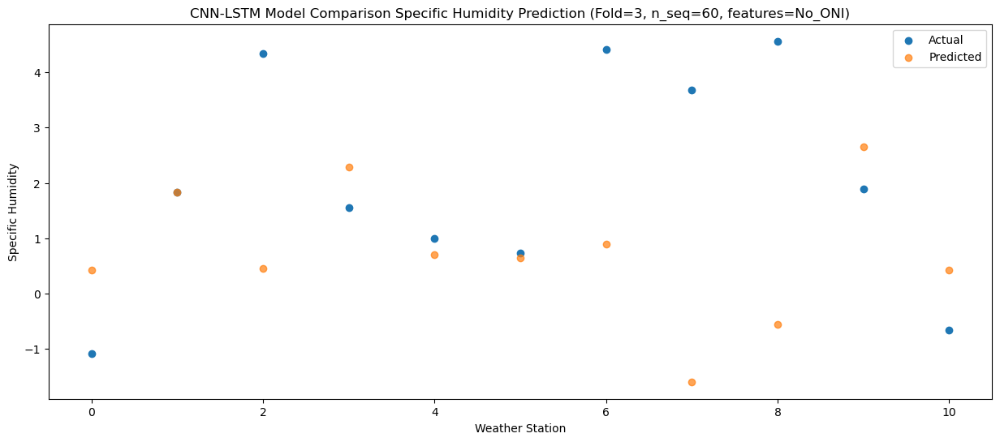

Predictions for (t+2):
    Weather_Station  Actual  Predicted
0                 0   -1.03   0.211032
1                 1    1.80   1.611041
2                 2    3.95   0.231094
3                 3    1.15   2.061031
4                 4   -1.30   0.491033
5                 5    0.23   0.431030
6                 6    4.37   0.681078
7                 7    2.56  -1.808911
8                 8    3.88  -0.768906
9                 9    1.61   2.431043
10               10   -0.74   0.211038


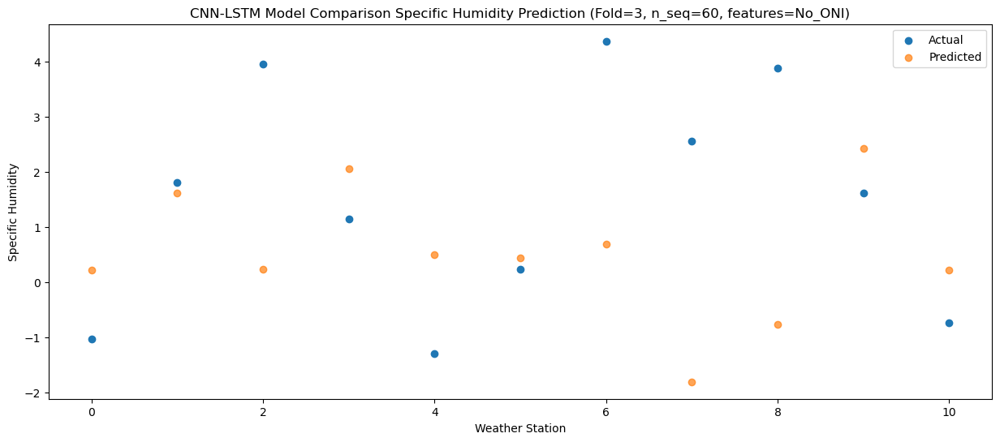

Predictions for (t+3):
    Weather_Station  Actual  Predicted
0                 0   -0.70  -0.027115
1                 1    1.44   1.372894
2                 2    3.26  -0.007065
3                 3    0.97   1.822886
4                 4   -2.06   0.252888
5                 5   -0.02   0.192884
6                 6    4.33   0.442927
7                 7    2.14  -2.047065
8                 8    2.99  -1.007066
9                 9    1.69   2.192897
10               10   -0.75  -0.027108


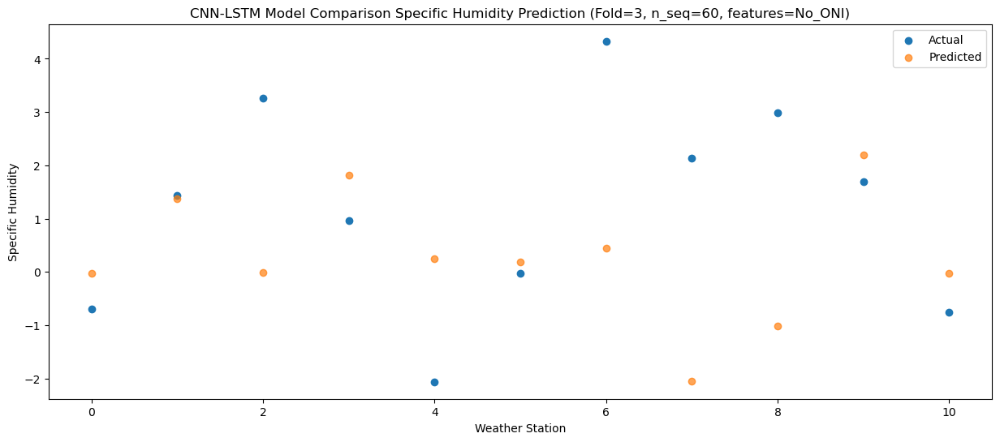

Predictions for (t+4):
    Weather_Station  Actual  Predicted
0                 0    1.03   1.971654
1                 1    4.04   3.371665
2                 2    4.34   1.991743
3                 3    2.83   3.821657
4                 4    0.01   2.251660
5                 5    1.97   2.191654
6                 6    4.96   2.441724
7                 7    3.88  -0.048264
8                 8    3.47   0.991740
9                 9    2.18   4.191677
10               10    0.21   1.971670


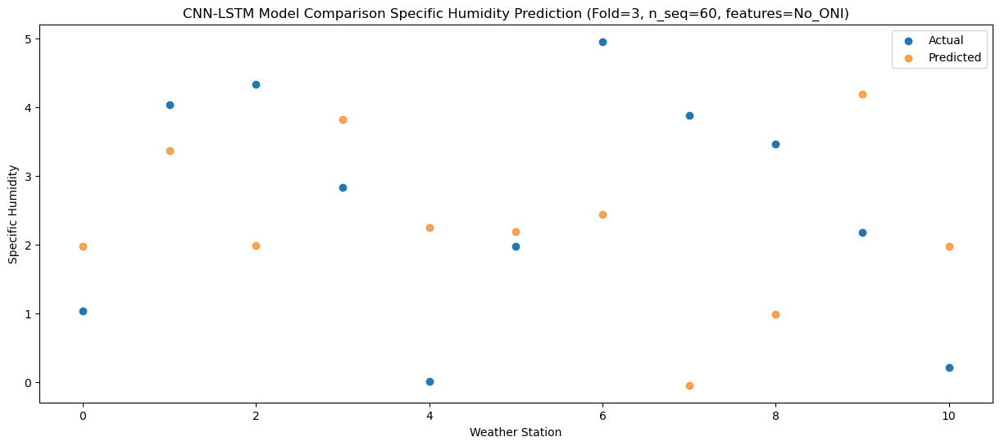

Predictions for (t+5):
    Weather_Station  Actual  Predicted
0                 0    0.85   1.954235
1                 1    4.19   3.354240
2                 2    5.71   1.974335
3                 3    2.75   3.804238
4                 4    0.33   2.234238
5                 5    2.09   2.174237
6                 6    5.31   2.424310
7                 7    3.69  -0.065676
8                 8    4.53   0.974333
9                 9    2.68   4.174264
10               10    0.64   1.954256


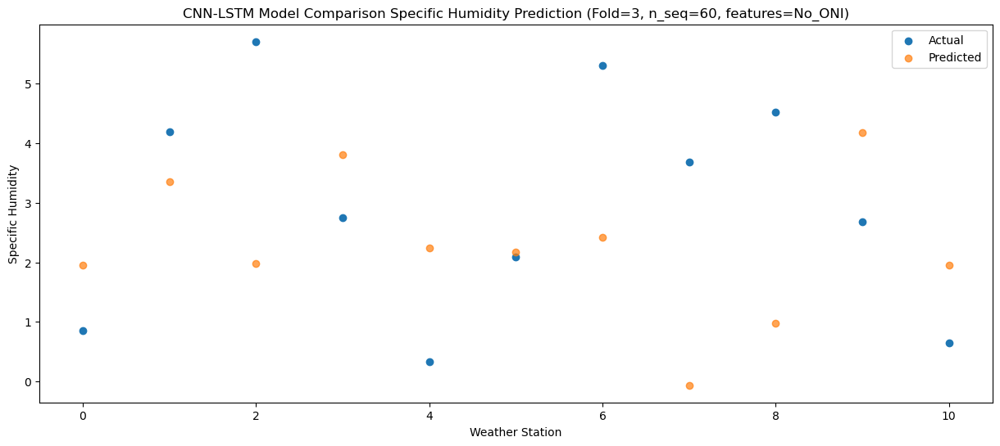

Predictions for (t+6):
    Weather_Station  Actual  Predicted
0                 0    4.07   4.794524
1                 1    7.16   6.194529
2                 2    5.52   4.814615
3                 3    6.18   6.644527
4                 4    4.03   5.074523
5                 5    5.30   5.014522
6                 6    6.44   5.264591
7                 7    2.99   2.774605
8                 8    5.39   3.814612
9                 9    4.91   7.014549
10               10    3.17   4.794542


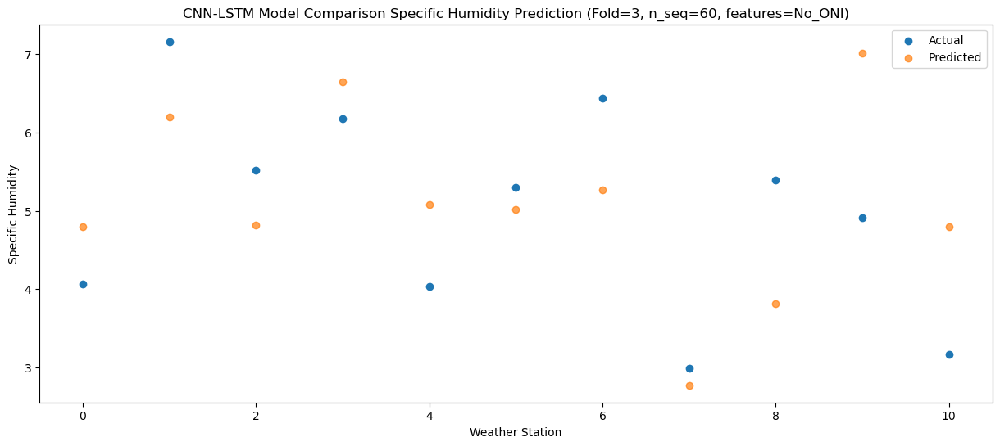

Predictions for (t+7):
    Weather_Station  Actual  Predicted
0                 0    7.61   7.664508
1                 1   10.69   9.064510
2                 2    7.06   7.684607
3                 3    9.42   9.514507
4                 4    7.12   7.944502
5                 5    8.03   7.884503
6                 6    7.50   8.134581
7                 7    3.32   5.644596
8                 8    5.61   6.684605
9                 9    9.02   9.884536
10               10    6.74   7.664524


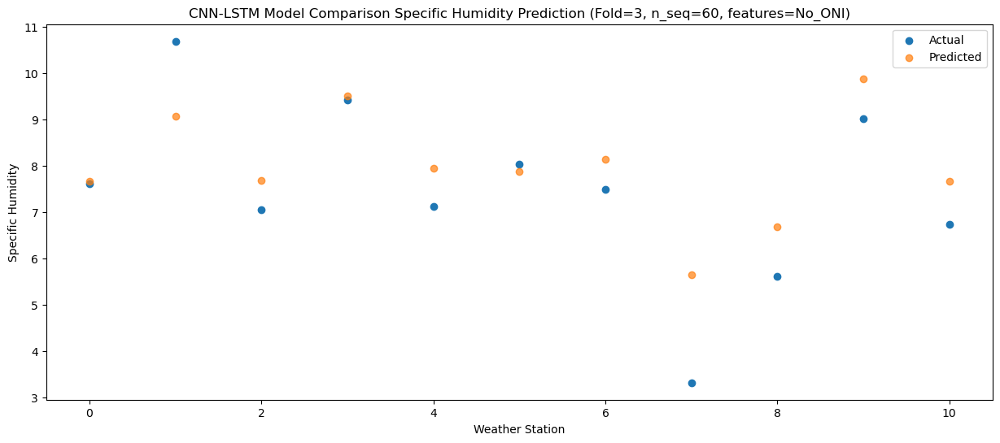

Predictions for (t+8):
    Weather_Station  Actual  Predicted
0                 0   10.30  10.329341
1                 1   13.43  11.729345
2                 2    7.28  10.349445
3                 3   12.52  12.179338
4                 4   11.07  10.609333
5                 5   11.19  10.549334
6                 6    9.02  10.799422
7                 7    3.80   8.309437
8                 8    6.08   9.349442
9                 9   13.00  12.549369
10               10   10.09  10.329355


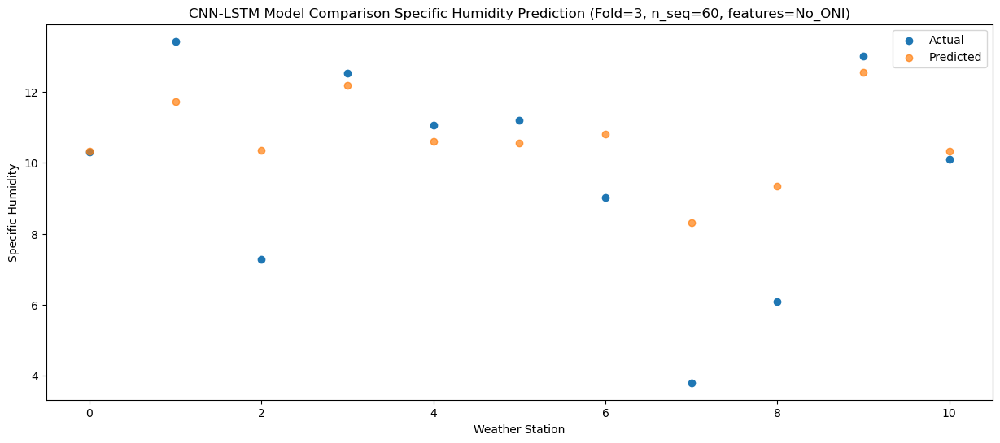

Predictions for (t+9):
    Weather_Station  Actual  Predicted
0                 0   10.59   8.906142
1                 1   10.76  10.306148
2                 2    8.80   8.926253
3                 3   11.44  10.756139
4                 4    8.69   9.186135
5                 5    9.97   9.126138
6                 6    7.81   9.376228
7                 7    4.67   6.886244
8                 8    6.88   7.926249
9                 9   11.93  11.126172
10               10    9.45   8.906158


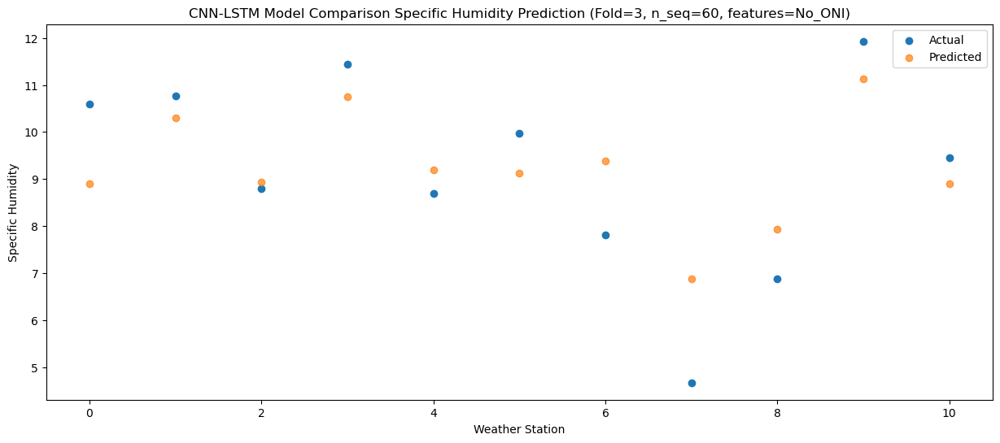

Predictions for (t+10):
    Weather_Station  Actual  Predicted
0                 0    6.85   6.314984
1                 1    9.32   7.714991
2                 2    8.32   6.335136
3                 3    8.87   8.164981
4                 4    5.73   6.594979
5                 5    6.79   6.534981
6                 6    6.67   6.785101
7                 7    3.41   4.295123
8                 8    6.49   5.335135
9                 9    8.56   8.535027
10               10    6.16   6.315009


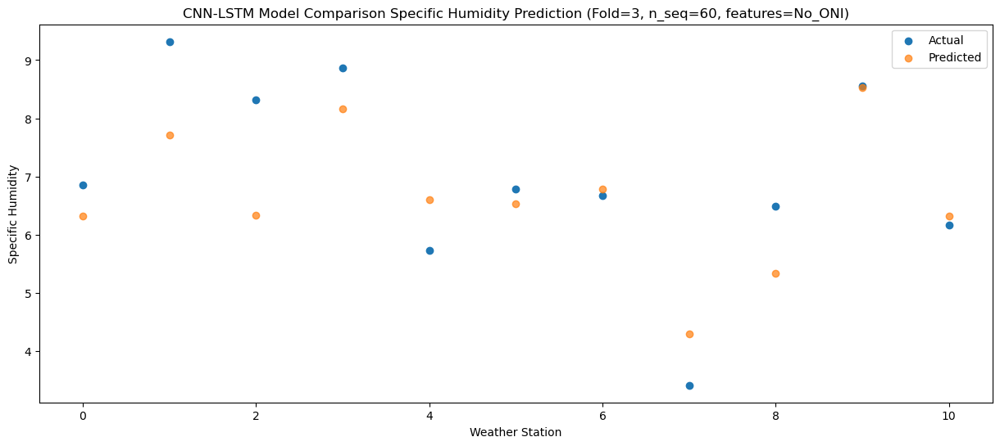

Predictions for (t+11):
    Weather_Station  Actual  Predicted
0                 0    4.27   2.967399
1                 1    4.75   4.367400
2                 2    6.44   2.987562
3                 3    5.18   4.817397
4                 4    1.01   3.247393
5                 5    3.37   3.187399
6                 6    5.02   3.437520
7                 7    2.40   0.947542
8                 8    4.29   1.987559
9                 9    6.03   5.187451
10               10    3.39   2.967433


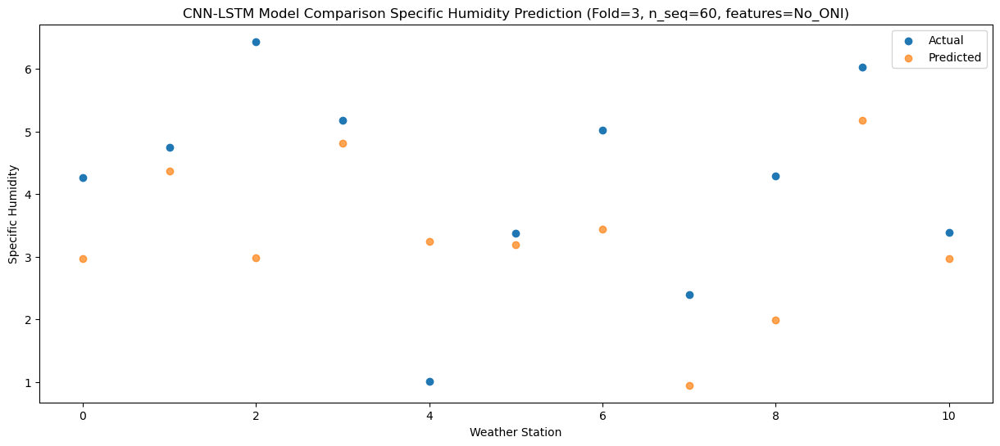

Predictions for (t+12):
    Weather_Station  Actual  Predicted
0                 0    1.53   1.435197
1                 1    3.25   2.835196
2                 2    3.75   1.455364
3                 3    2.29   3.285193
4                 4   -0.09   1.715188
5                 5    1.60   1.655196
6                 6    4.96   1.905318
7                 7    2.38  -0.584659
8                 8    3.13   0.455361
9                 9    3.87   3.655251
10               10    1.06   1.435233


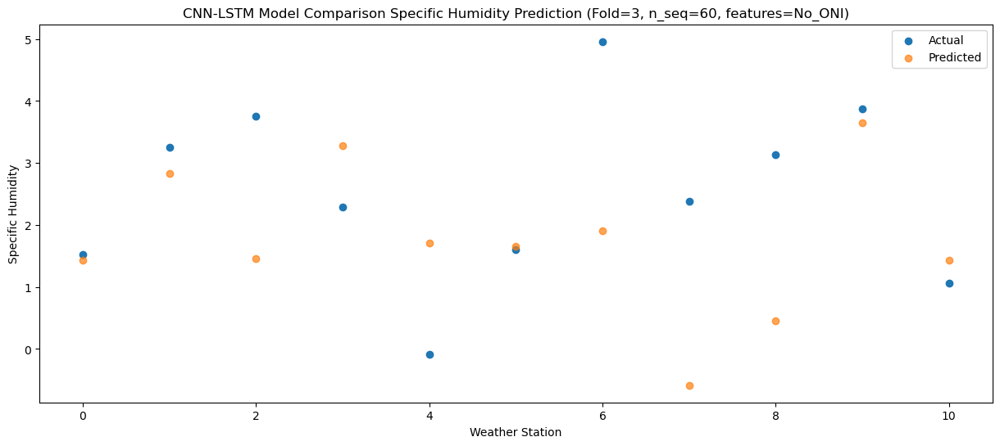

Predictions for (t+13):
    Weather_Station  Actual  Predicted
0                 0   -1.69  -0.596346
1                 1    1.21   0.803652
2                 2    3.15  -0.576205
3                 3    0.68   1.253650
4                 4   -2.02  -0.316359
5                 5   -0.06  -0.376350
6                 6    4.15  -0.126245
7                 7    1.55  -2.616226
8                 8    2.79  -1.576205
9                 9    1.91   1.623701
10               10   -0.79  -0.596315


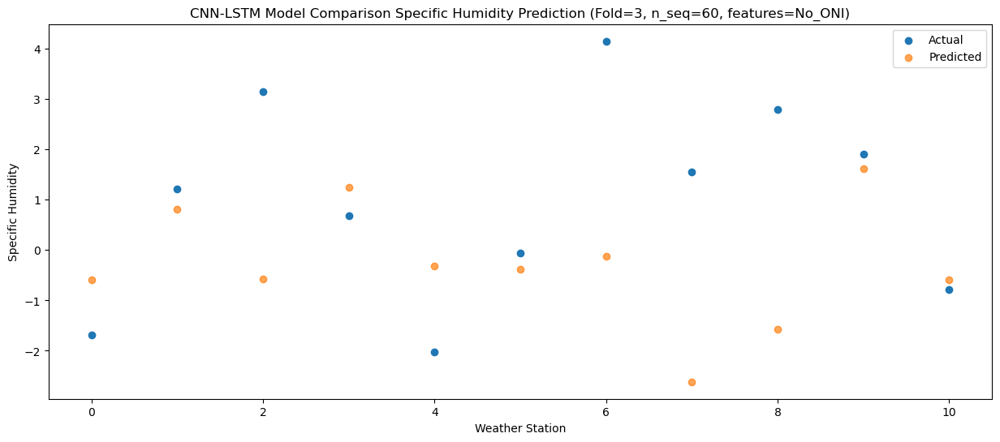

Predictions for (t+14):
    Weather_Station  Actual  Predicted
0                 0   -1.82  -0.720652
1                 1    1.12   0.679340
2                 2    3.59  -0.700515
3                 3    0.41   1.129341
4                 4   -2.22  -0.440669
5                 5   -0.37  -0.500660
6                 6    4.32  -0.250559
7                 7    2.36  -2.740540
8                 8    3.46  -1.700515
9                 9    0.82   1.499388
10               10   -1.48  -0.720625


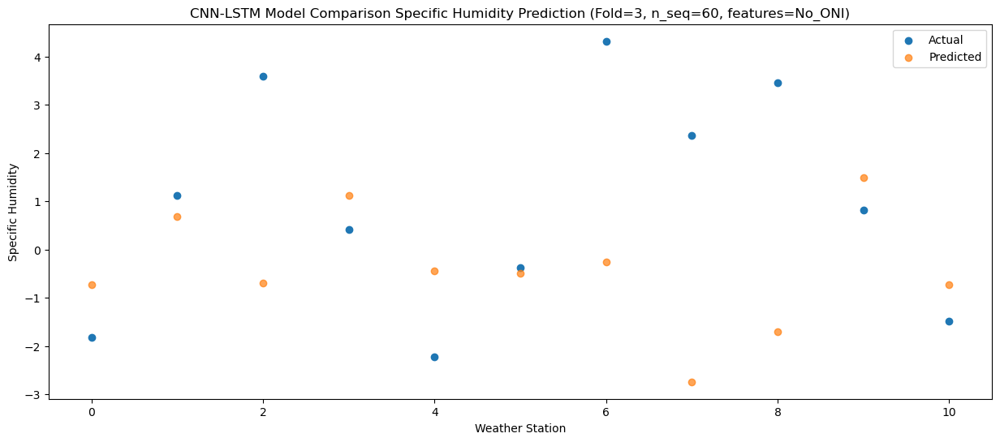

Predictions for (t+15):
    Weather_Station  Actual  Predicted
0                 0   -1.73  -1.161312
1                 1    0.56   0.238681
2                 2    3.53  -1.141152
3                 3    0.34   0.688680
4                 4   -3.05  -0.881331
5                 5   -0.89  -0.941323
6                 6    4.38  -0.691207
7                 7    1.88  -3.181181
8                 8    3.11  -2.141149
9                 9    0.97   1.058732
10               10   -1.62  -1.161284


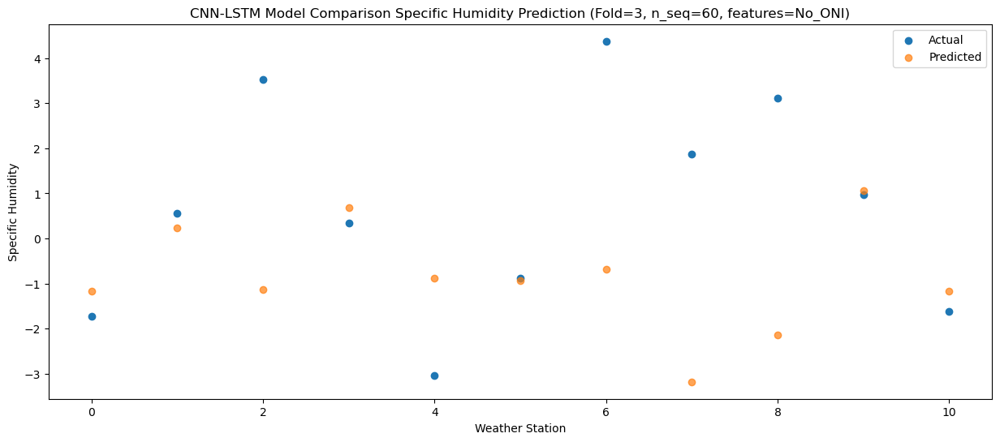

Predictions for (t+16):
    Weather_Station  Actual  Predicted
0                 0   -0.08   0.576957
1                 1    3.07   1.976949
2                 2    3.61   0.597140
3                 3    1.64   2.426948
4                 4   -0.57   0.856938
5                 5    1.14   0.796944
6                 6    4.69   1.047078
7                 7    2.18  -1.442894
8                 8    2.76  -0.402856
9                 9    1.75   2.797006
10               10   -0.34   0.576985


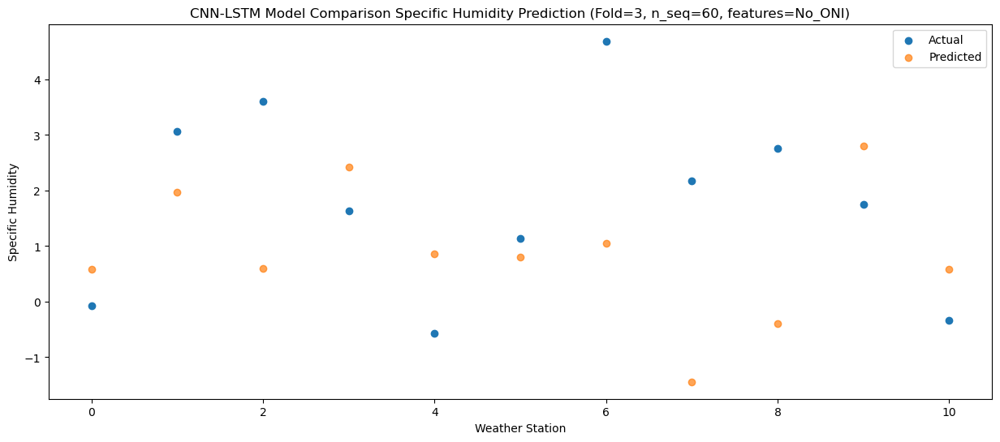

Predictions for (t+17):
    Weather_Station  Actual  Predicted
0                 0    0.44   1.554311
1                 1    4.24   2.954302
2                 2    4.23   1.574498
3                 3    2.83   3.404302
4                 4    0.49   1.834295
5                 5    2.44   1.774302
6                 6    5.16   2.024436
7                 7    1.87  -0.465536
8                 8    3.69   0.574505
9                 9    3.13   3.774363
10               10    1.07   1.554340


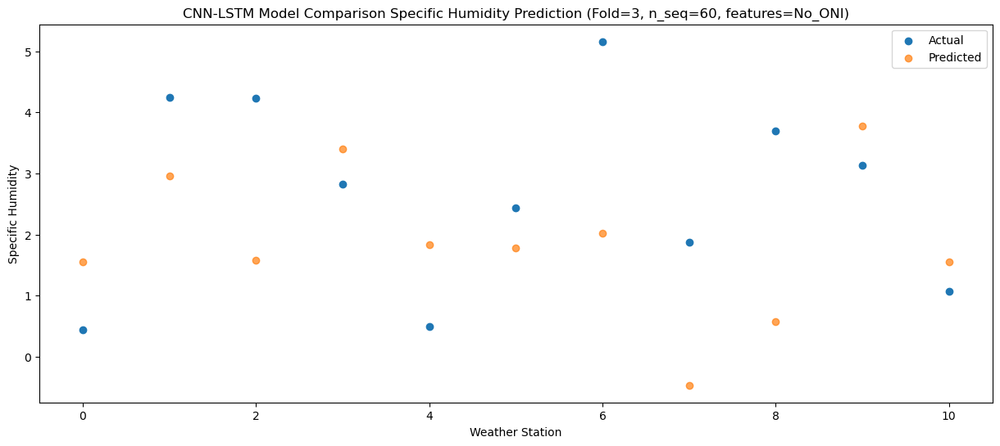

Predictions for (t+18):
    Weather_Station  Actual  Predicted
0                 0    3.22   4.060699
1                 1    7.76   5.460690
2                 2    4.63   4.080904
3                 3    5.36   5.910688
4                 4    2.91   4.340683
5                 5    4.68   4.280690
6                 6    6.56   4.530835
7                 7    2.43   2.040867
8                 8    4.13   3.080909
9                 9    4.70   6.280755
10               10    2.66   4.060730


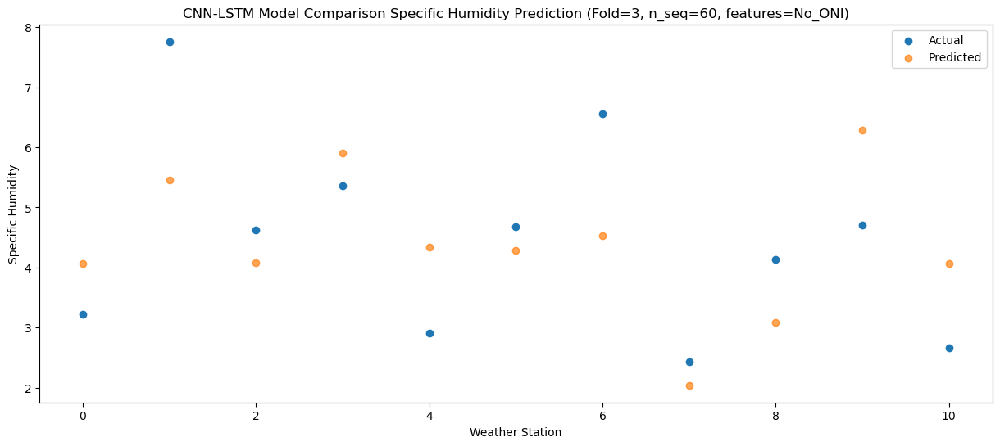

Predictions for (t+19):
    Weather_Station  Actual  Predicted
0                 0    7.94   8.128097
1                 1   12.29   9.528089
2                 2    7.08   8.148264
3                 3   10.78   9.978088
4                 4    7.37   8.408084
5                 5    9.90   8.348091
6                 6    7.89   8.598209
7                 7    3.85   6.108233
8                 8    5.56   7.148271
9                 9    9.60  10.348143
10               10    7.53   8.128124


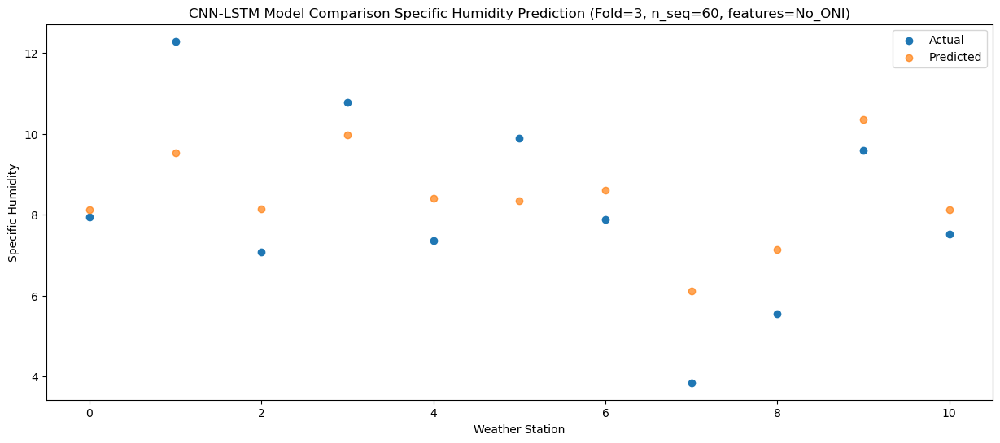

Predictions for (t+20):
    Weather_Station  Actual  Predicted
0                 0    9.18   9.533326
1                 1   13.17  10.933313
2                 2    7.78   9.553455
3                 3   11.41  11.383315
4                 4    9.32   9.813307
5                 5   11.15   9.753316
6                 6   10.34  10.003410
7                 7    9.21   7.513431
8                 8    6.04   8.553464
9                 9   11.81  11.753358
10               10    9.22   9.533344


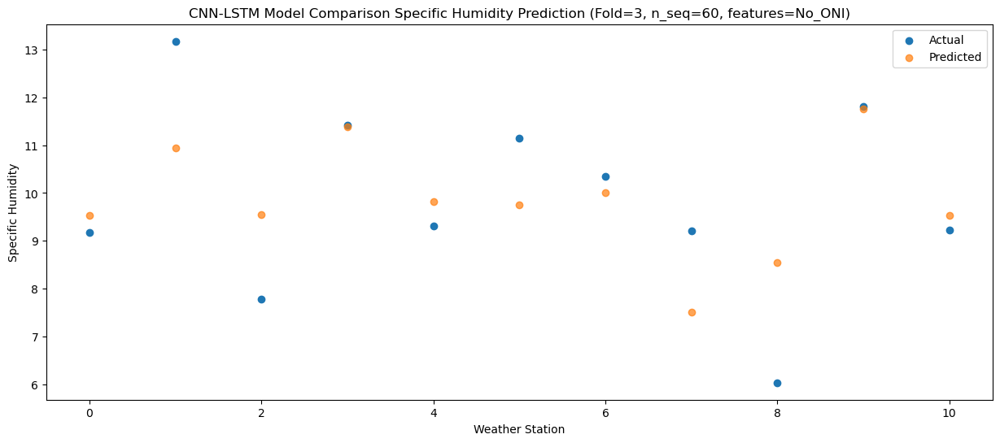

Predictions for (t+21):
    Weather_Station  Actual  Predicted
0                 0    9.45   9.966717
1                 1   13.34  11.366704
2                 2    7.31   9.986818
3                 3   12.29  11.816709
4                 4    9.41  10.246700
5                 5   11.32  10.186708
6                 6    8.91  10.436785
7                 7    6.78   7.946801
8                 8    6.43   8.986828
9                 9   12.19  12.186742
10               10    9.54   9.966731


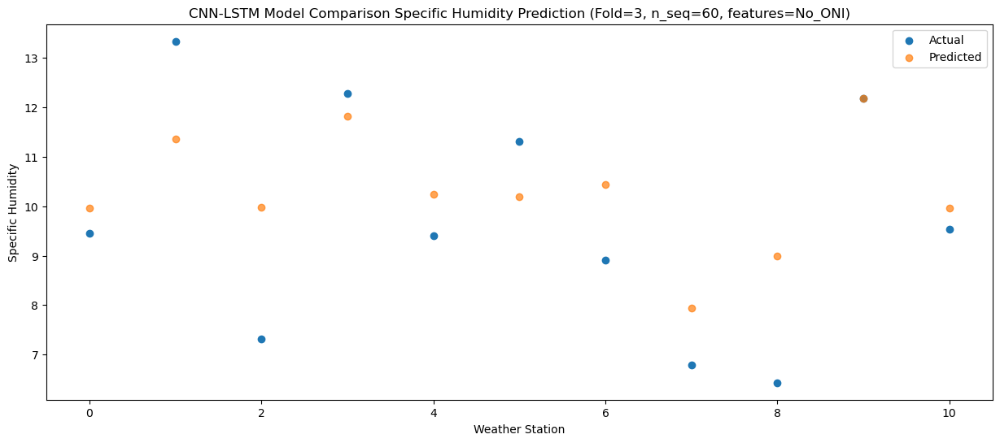

Predictions for (t+22):
    Weather_Station  Actual  Predicted
0                 0    5.83   6.635975
1                 1    9.37   8.035961
2                 2    6.02   6.656066
3                 3    8.82   8.485969
4                 4    5.64   6.915959
5                 5    8.02   6.855969
6                 6    7.21   7.106034
7                 7    5.06   4.616048
8                 8    5.79   5.656073
9                 9    9.59   8.856000
10               10    6.62   6.635990


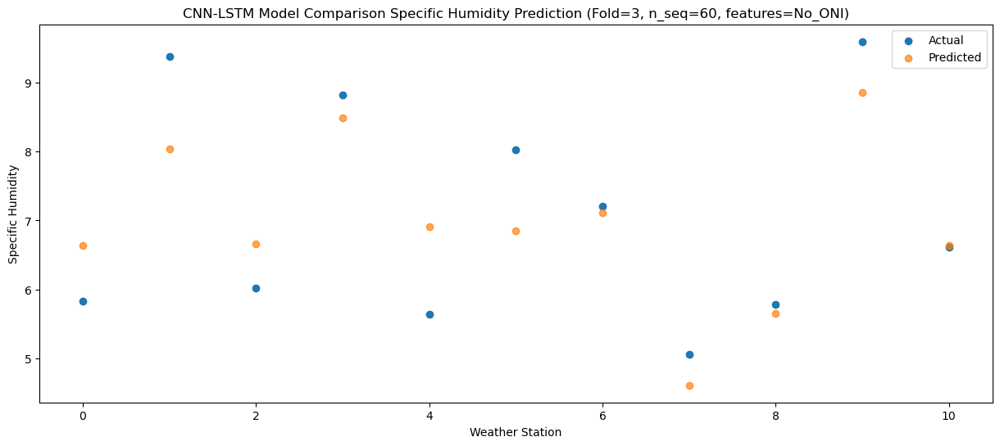

Predictions for (t+23):
    Weather_Station  Actual  Predicted
0                 0    3.79   4.582062
1                 1    7.18   5.982046
2                 2    4.88   4.602141
3                 3    6.76   6.432053
4                 4    3.69   4.862044
5                 5    6.40   4.802053
6                 6    6.12   5.052111
7                 7    3.96   2.562125
8                 8    4.76   3.602150
9                 9    7.05   6.802082
10               10    4.72   4.582073


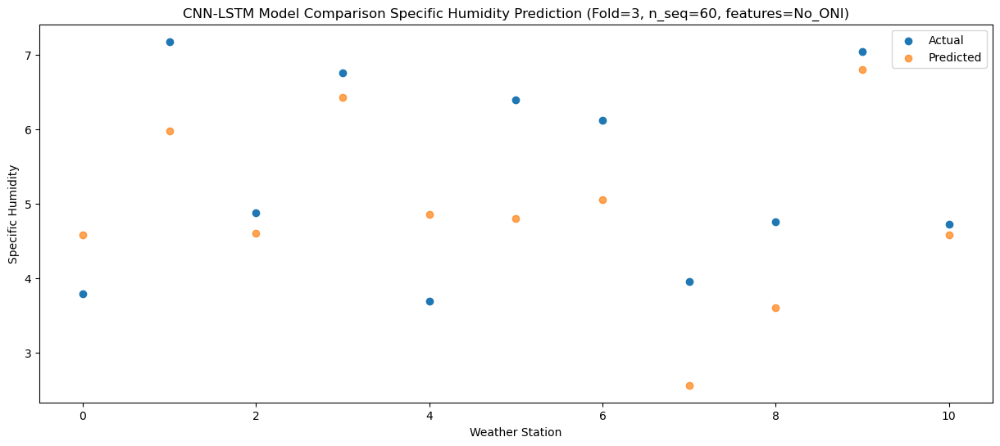

Predictions for (t+24):
    Weather_Station  Actual  Predicted
0                 0   -1.71   0.387022
1                 1    2.75   1.787004
2                 2    5.46   0.407082
3                 3    1.07   2.237014
4                 4   -1.43   0.667003
5                 5    0.53   0.607014
6                 6    5.41   0.857059
7                 7    2.69  -1.632931
8                 8    4.98  -0.592909
9                 9    2.52   2.607038
10               10   -0.20   0.387029


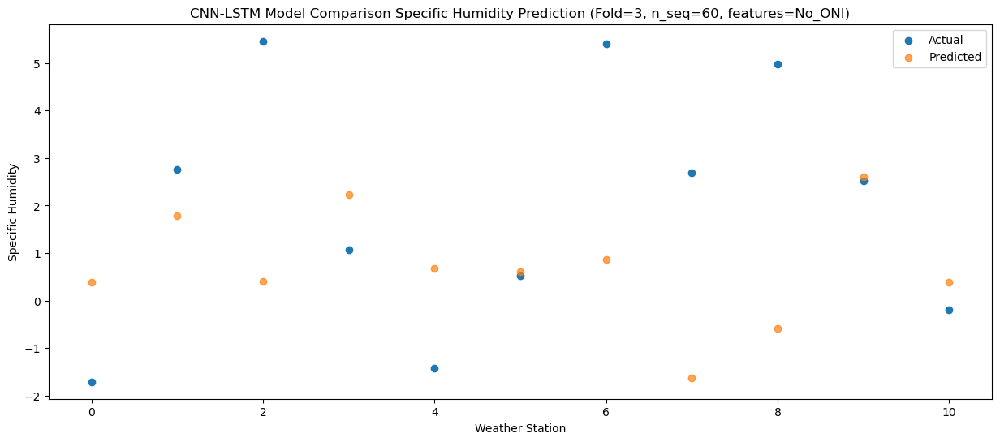

Predictions for (t+25):
    Weather_Station  Actual  Predicted
0                 0    0.24   0.752130
1                 1    3.72   2.152111
2                 2    3.96   0.772187
3                 3    2.21   2.602123
4                 4   -0.73   1.032110
5                 5    1.58   0.972124
6                 6    4.70   1.222166
7                 7    2.83  -1.267826
8                 8    3.73  -0.227805
9                 9    2.22   2.972147
10               10   -0.30   0.752141


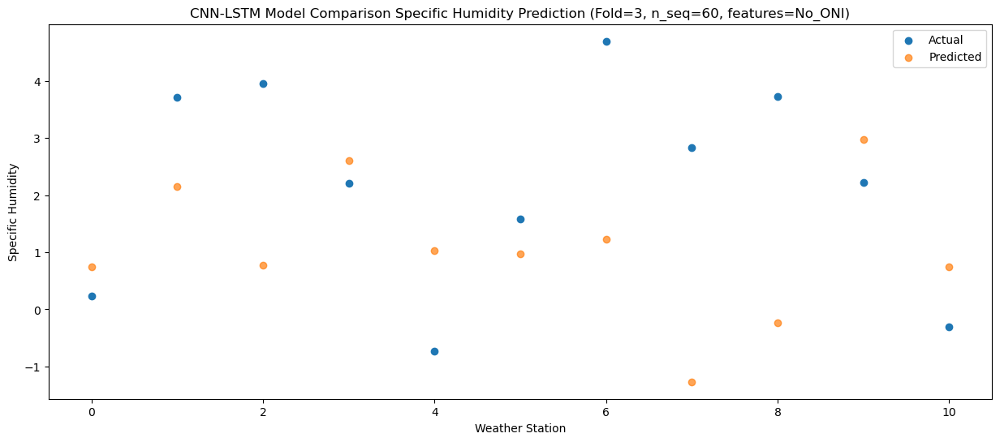

Predictions for (t+26):
    Weather_Station  Actual  Predicted
0                 0   -2.55  -1.564539
1                 1    0.53  -0.164563
2                 2    3.68  -1.544477
3                 3   -0.11   0.285455
4                 4   -3.19  -1.284558
5                 5   -0.93  -1.344543
6                 6    4.22  -1.094500
7                 7    1.84  -3.584495
8                 8    3.40  -2.544469
9                 9    0.74   0.655484
10               10   -1.81  -1.564523


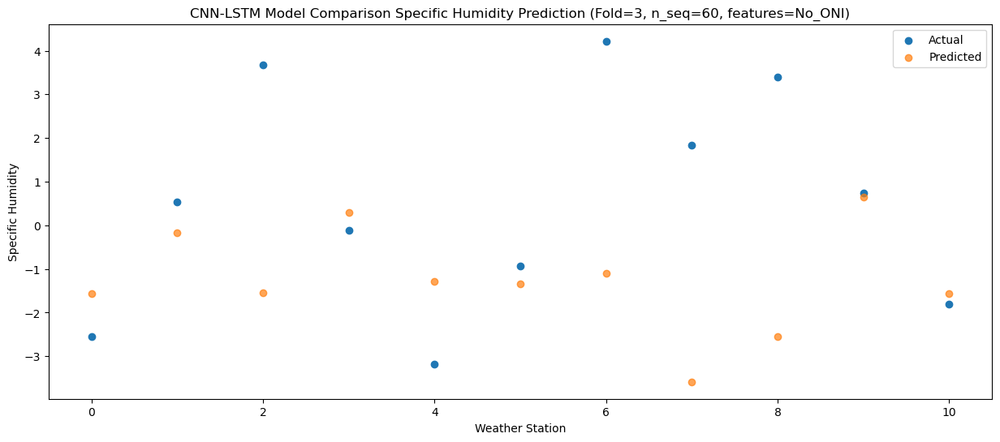

Predictions for (t+27):
    Weather_Station  Actual  Predicted
0                 0   -1.19  -0.973360
1                 1    0.90   0.426620
2                 2    2.90  -0.953320
3                 3    0.41   0.876632
4                 4   -2.57  -0.693379
5                 5   -0.40  -0.753369
6                 6    4.01  -0.503333
7                 7    1.41  -2.993330
8                 8    2.56  -1.953309
9                 9    1.33   1.246649
10               10   -1.11  -0.973355


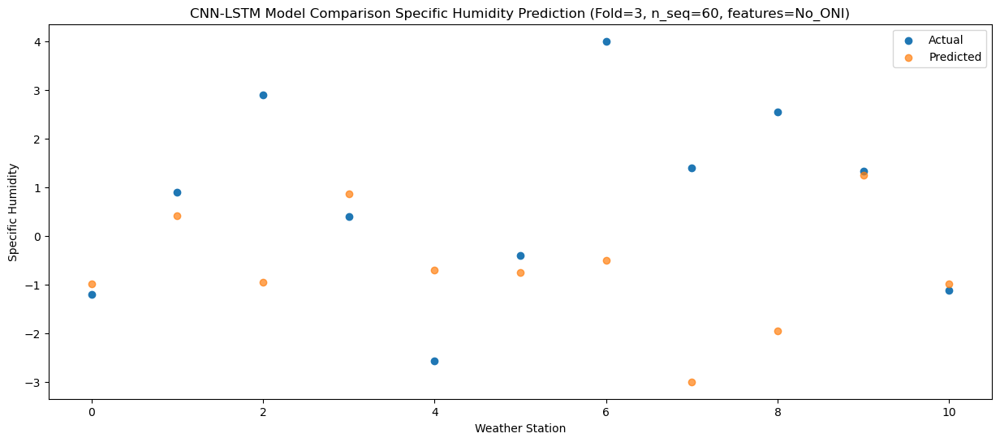

Predictions for (t+28):
    Weather_Station  Actual  Predicted
0                 0   -0.29   0.087340
1                 1    2.37   1.487317
2                 2    4.24   0.107332
3                 3    1.39   1.937334
4                 4   -1.00   0.367318
5                 5    0.91   0.307334
6                 6    4.69   0.557333
7                 7    2.03  -1.932672
8                 8    3.56  -0.892661
9                 9    2.17   2.307340
10               10   -0.17   0.087340


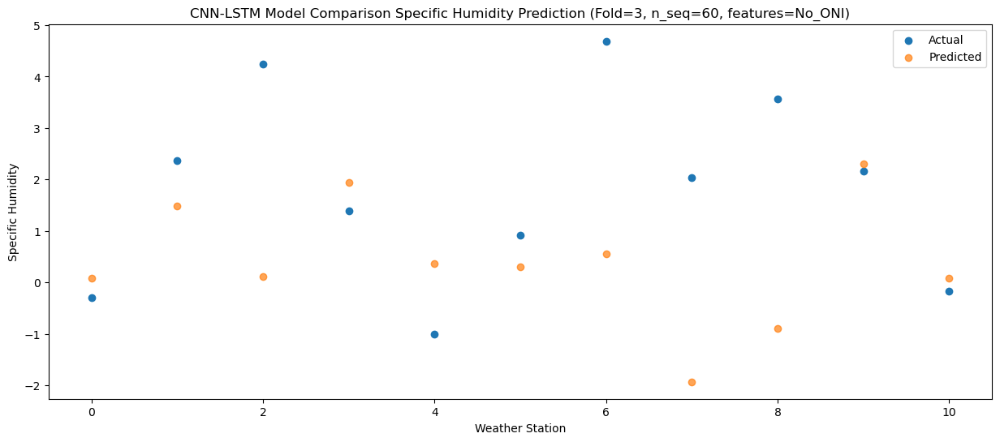

Predictions for (t+29):
    Weather_Station  Actual  Predicted
0                 0    0.74   1.378159
1                 1    4.67   2.778133
2                 2    3.91   1.398140
3                 3    2.66   3.228153
4                 4    0.56   1.658135
5                 5    2.44   1.598153
6                 6    5.19   1.848141
7                 7    2.03  -0.641866
8                 8    3.66   0.398149
9                 9    2.82   3.598155
10               10    0.47   1.378155


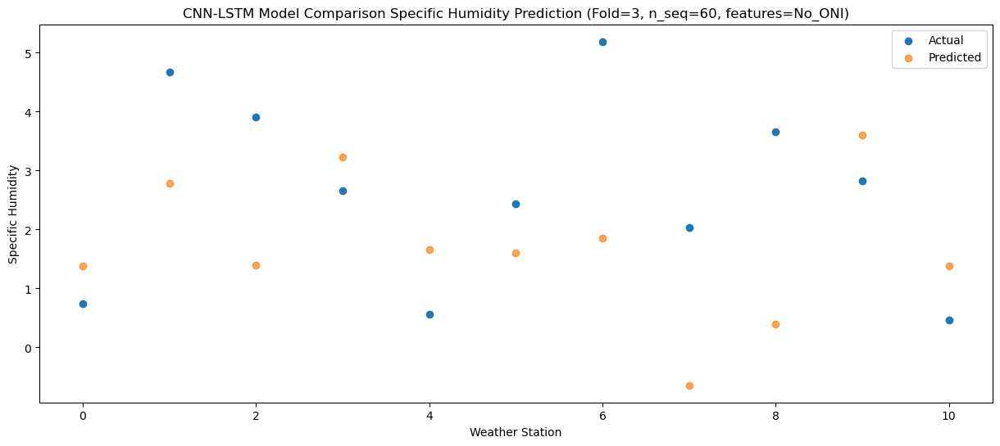

Predictions for (t+30):
    Weather_Station  Actual  Predicted
0                 0    5.05   4.881793
1                 1    9.12   6.281768
2                 2    4.09   4.901750
3                 3    7.08   6.731786
4                 4    4.65   5.161766
5                 5    6.67   5.101786
6                 6    6.00   5.351759
7                 7    2.29   2.861748
8                 8    4.03   3.901761
9                 9    6.21   7.101781
10               10    4.65   4.881784


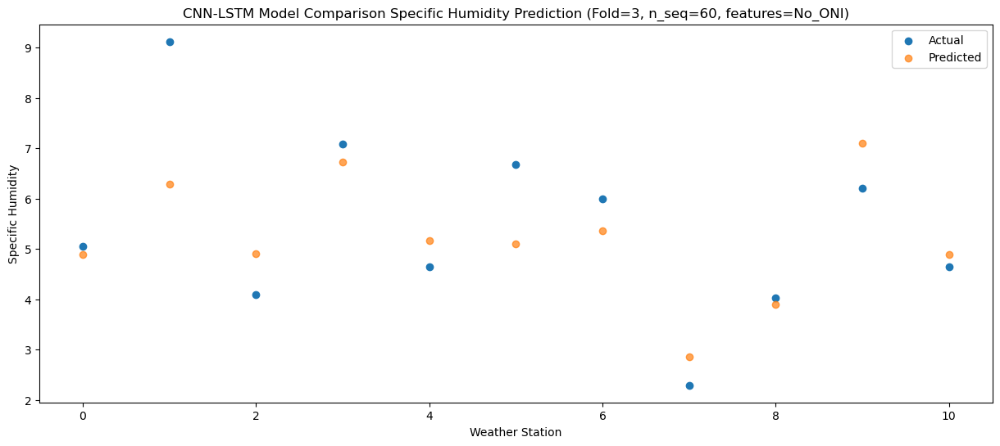

Predictions for (t+31):
    Weather_Station  Actual  Predicted
0                 0    6.35   6.957690
1                 1   11.74   8.357667
2                 2    5.26   6.977634
3                 3    9.34   8.807685
4                 4    6.75   7.237666
5                 5    8.74   7.177685
6                 6    7.94   7.427648
7                 7    4.05   4.937632
8                 8    5.52   5.977644
9                 9    8.55   9.177678
10               10    6.05   6.957680


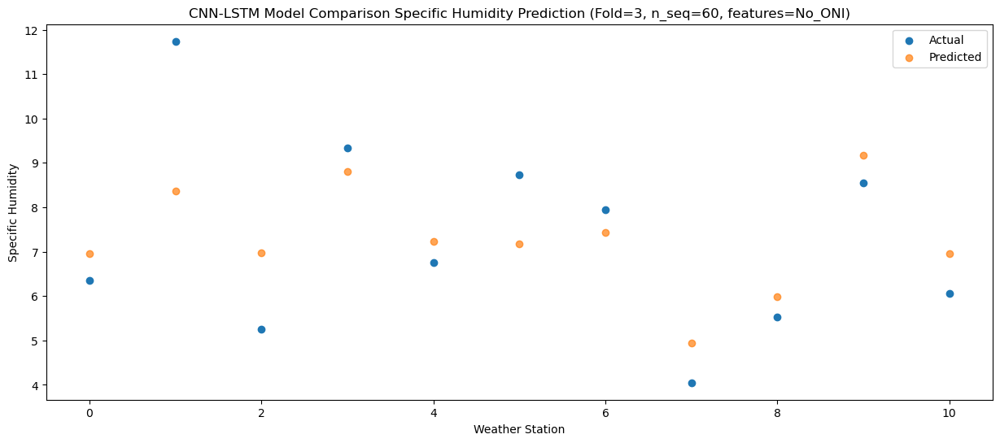

Predictions for (t+32):
    Weather_Station  Actual  Predicted
0                 0   10.42   8.927921
1                 1   11.95  10.327896
2                 2    6.43   8.947872
3                 3   12.38  10.777915
4                 4    9.34   9.207892
5                 5   11.52   9.147914
6                 6   10.93   9.397884
7                 7    7.48   6.907867
8                 8    6.35   7.947884
9                 9   11.71  11.147911
10               10    9.03   8.927910


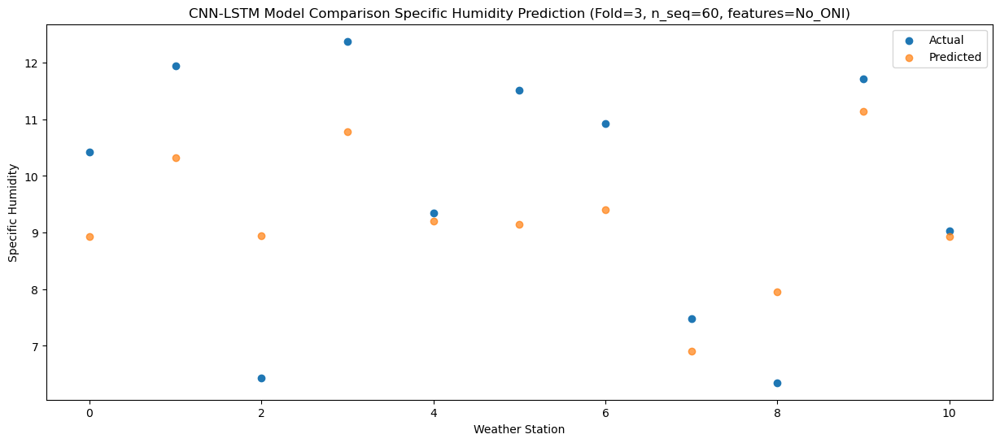

Predictions for (t+33):
    Weather_Station  Actual  Predicted
0                 0    8.61   9.033433
1                 1   12.56  10.433408
2                 2    7.22   9.053371
3                 3   11.25  10.883426
4                 4    8.84   9.313402
5                 5   10.32   9.253426
6                 6   10.77   9.503387
7                 7   10.55   7.013366
8                 8    6.81   8.053384
9                 9   11.85  11.253420
10               10    8.66   9.033419


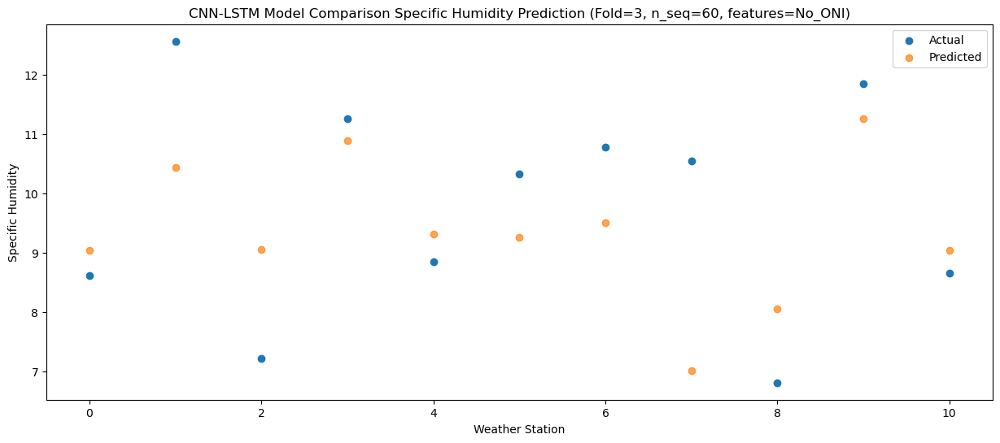

Predictions for (t+34):
    Weather_Station  Actual  Predicted
0                 0    5.19   6.228853
1                 1    8.71   7.628830
2                 2    6.93   6.248783
3                 3    8.00   8.078845
4                 4    5.74   6.508820
5                 5    7.55   6.448842
6                 6    7.82   6.698803
7                 7    6.64   4.208781
8                 8    6.21   5.248796
9                 9    8.18   8.448833
10               10    5.64   6.228832


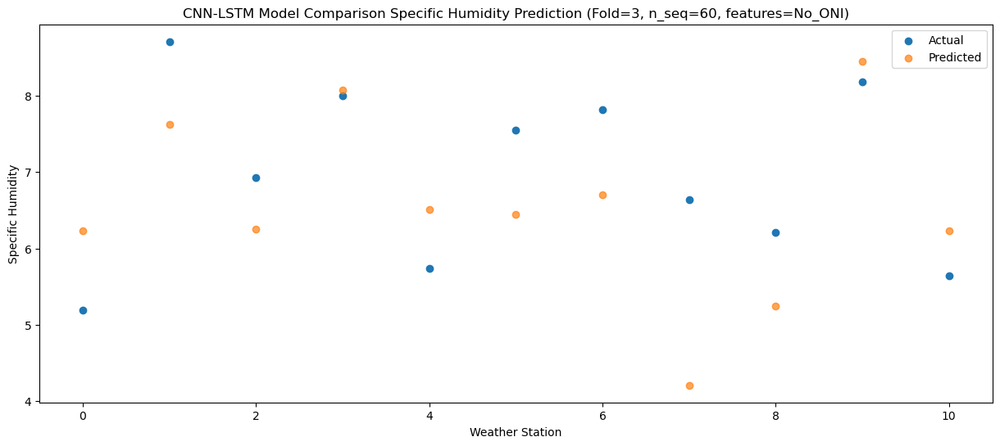

Predictions for (t+35):
    Weather_Station  Actual  Predicted
0                 0    0.96   1.982983
1                 1    4.25   3.382963
2                 2    5.76   2.002902
3                 3    2.85   3.832973
4                 4    0.74   2.262949
5                 5    2.25   2.202968
6                 6    6.21   2.452929
7                 7    3.91  -0.037095
8                 8    4.90   1.002915
9                 9    5.55   4.202956
10               10    2.22   1.982956


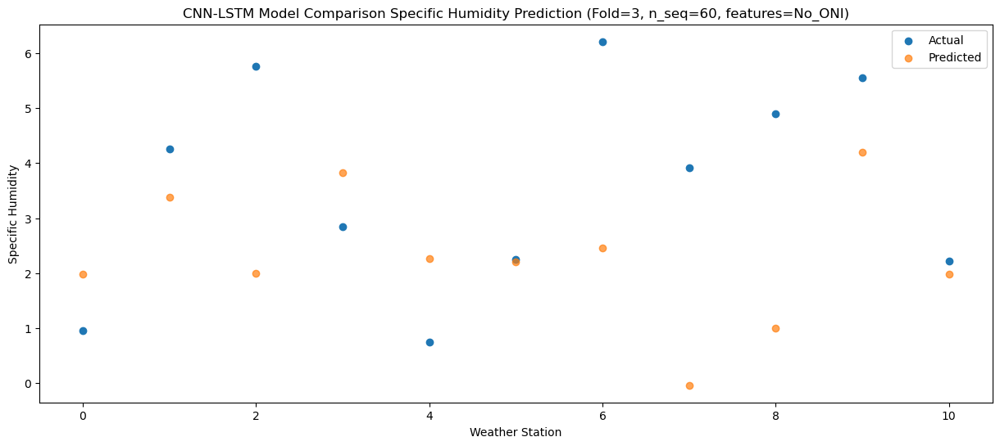

Predictions for (t+36):
    Weather_Station  Actual  Predicted
0                 0    0.51   0.776332
1                 1    3.22   2.176310
2                 2    3.04   0.796249
3                 3    2.04   2.626319
4                 4   -0.65   1.056297
5                 5    1.03   0.996315
6                 6    4.55   1.246276
7                 7    2.14  -1.243748
8                 8    2.65  -0.203737
9                 9    3.70   2.996305
10               10    1.00   0.776305


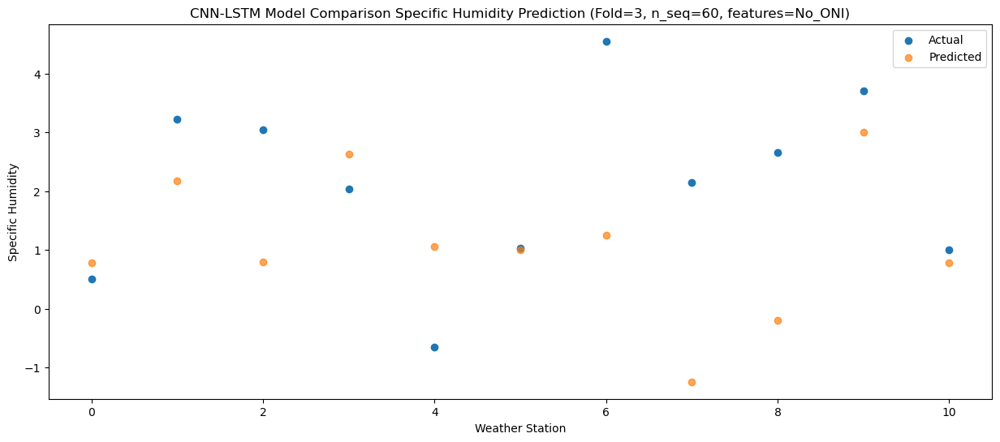

Predictions for (t+37):
    Weather_Station  Actual  Predicted
0                 0   -1.69  -0.668315
1                 1    2.03   0.731665
2                 2    3.88  -0.648424
3                 3    1.01   1.181669
4                 4   -1.77  -0.388356
5                 5    0.27  -0.448337
6                 6    4.58  -0.198386
7                 7    2.89  -2.688414
8                 8    3.44  -1.648408
9                 9    1.73   1.551644
10               10   -0.92  -0.668352


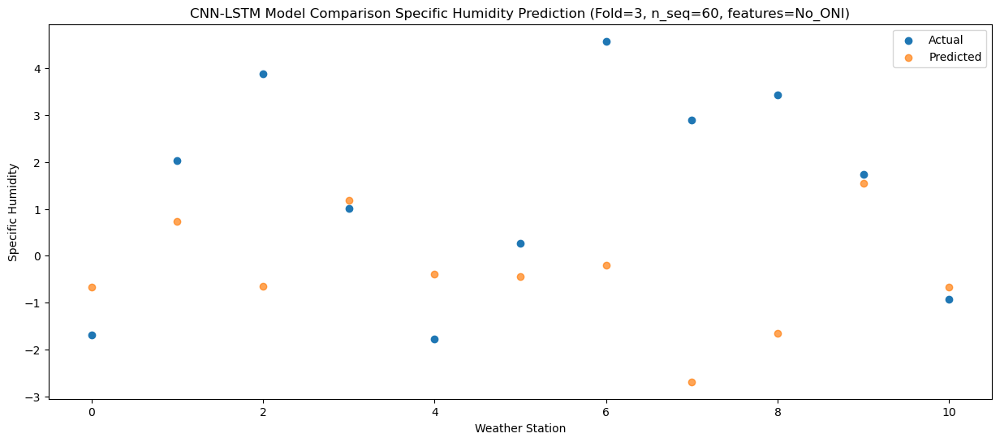

Predictions for (t+38):
    Weather_Station  Actual  Predicted
0                 0   -0.78  -0.392295
1                 1    1.95   1.007691
2                 2    4.03  -0.372405
3                 3    1.55   1.457687
4                 4   -1.39  -0.112331
5                 5    0.85  -0.172317
6                 6    4.55   0.077637
7                 7    3.28  -2.412389
8                 8    3.27  -1.372388
9                 9    2.30   1.827660
10               10   -0.14  -0.392333


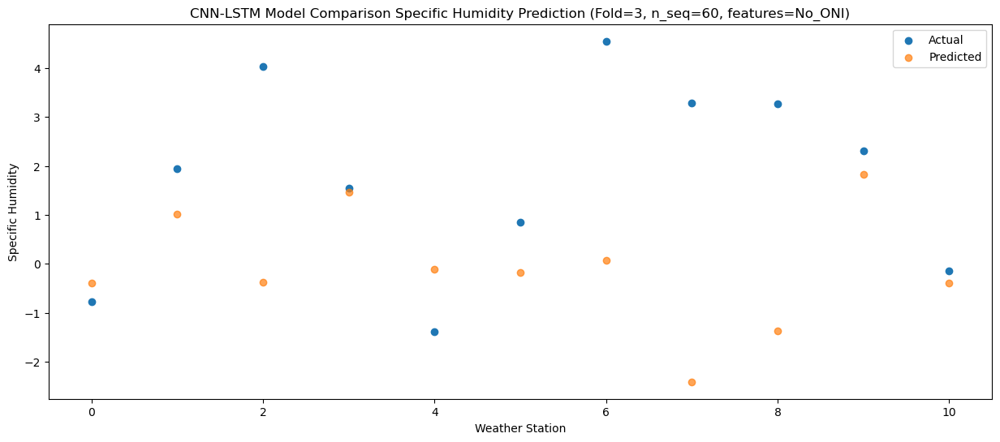

Predictions for (t+39):
    Weather_Station  Actual  Predicted
0                 0   -0.05  -0.433889
1                 1    2.11   0.966095
2                 2    2.90  -0.414009
3                 3    1.37   1.416089
4                 4   -0.51  -0.153930
5                 5    0.52  -0.213918
6                 6    4.17   0.036034
7                 7    2.03  -2.453993
8                 8    2.41  -1.413993
9                 9    1.59   1.786058
10               10   -0.89  -0.433936


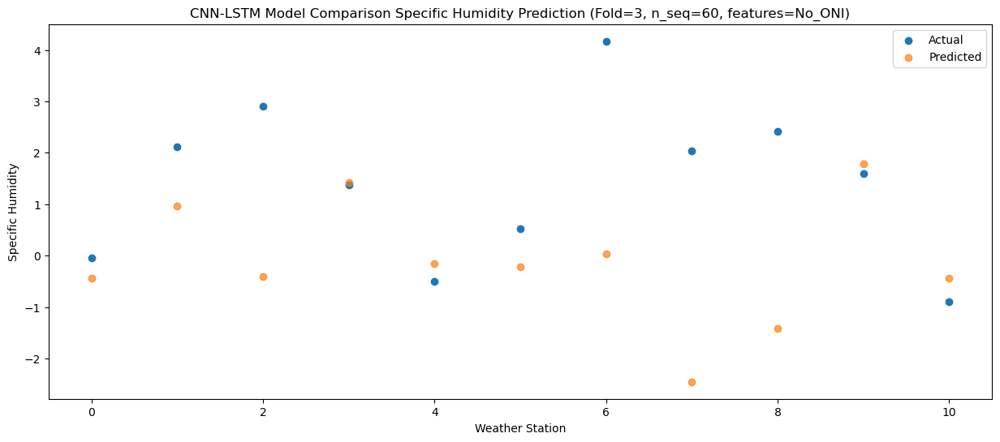

Predictions for (t+40):
    Weather_Station  Actual  Predicted
0                 0   -0.44  -0.041124
1                 1    3.05   1.358861
2                 2    4.42  -0.021268
3                 3    1.24   1.808854
4                 4   -0.84   0.238834
5                 5    0.95   0.178845
6                 6    4.47   0.428782
7                 7    3.07  -2.061246
8                 8    3.21  -1.021251
9                 9    1.80   2.178811
10               10   -0.76  -0.041178


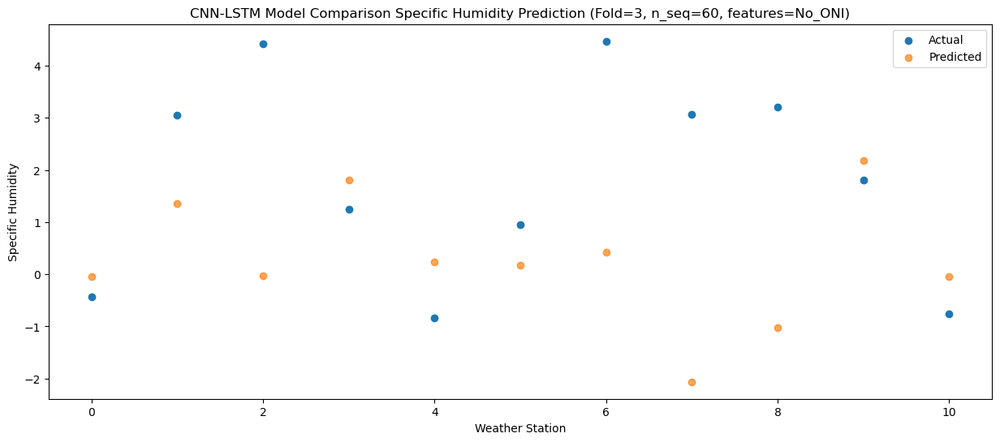

Predictions for (t+41):
    Weather_Station  Actual  Predicted
0                 0    1.55   1.274183
1                 1    3.92   2.674170
2                 2    4.62   1.294030
3                 3    2.78   3.124161
4                 4    0.39   1.554144
5                 5    2.26   1.494153
6                 6    5.10   1.744085
7                 7    2.22  -0.745946
8                 8    3.59   0.294046
9                 9    4.04   3.494117
10               10    1.67   1.274129


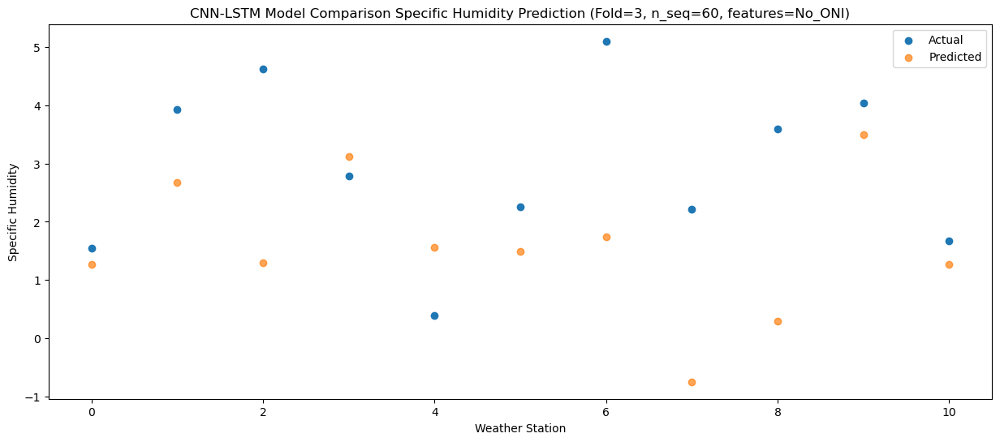

Predictions for (t+42):
    Weather_Station  Actual  Predicted
0                 0    3.00   3.793450
1                 1    8.33   5.193441
2                 2    5.56   3.813288
3                 3    5.69   5.643428
4                 4    3.57   4.073410
5                 5    4.86   4.013420
6                 6    7.26   4.263347
7                 7    3.76   1.773317
8                 8    5.18   2.813305
9                 9    4.56   6.013378
10               10    2.14   3.793393


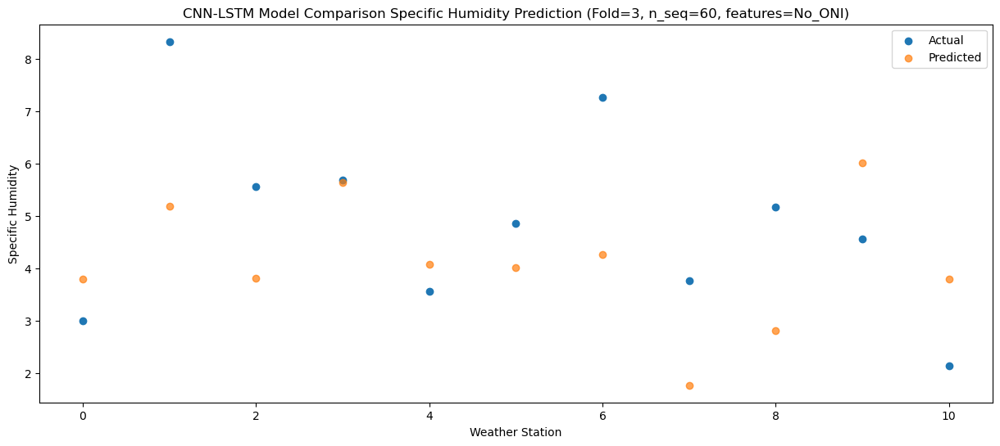

Predictions for (t+43):
    Weather_Station  Actual  Predicted
0                 0    6.27   6.550663
1                 1   10.97   7.950653
2                 2    6.33   6.570461
3                 3    7.71   8.400641
4                 4    5.70   6.830621
5                 5    7.02   6.770633
6                 6    7.49   7.020533
7                 7    4.26   4.530493
8                 8    5.24   5.570478
9                 9    8.26   8.770582
10               10    5.83   6.550598


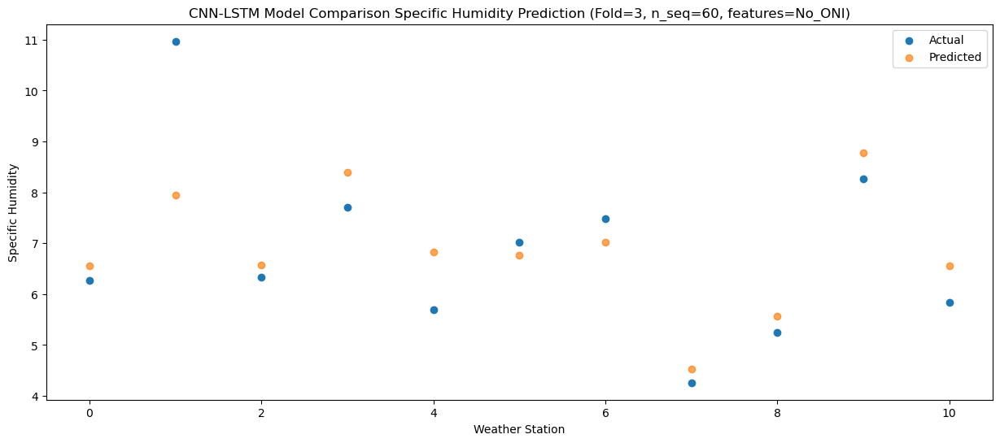

Predictions for (t+44):
    Weather_Station  Actual  Predicted
0                 0   10.22   8.801011
1                 1   13.24  10.201000
2                 2    7.43   8.820799
3                 3   11.36  10.650989
4                 4    9.47   9.080968
5                 5   11.53   9.020981
6                 6    8.33   9.270874
7                 7    5.23   6.780830
8                 8    6.08   7.820816
9                 9   13.11  11.020929
10               10    9.81   8.800946


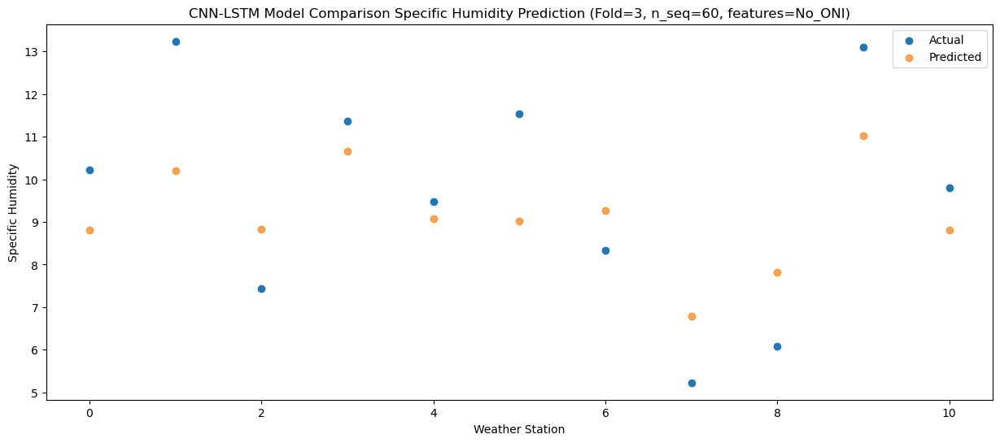

Predictions for (t+45):
    Weather_Station  Actual  Predicted
0                 0    9.32   8.269617
1                 1   13.48   9.669604
2                 2    8.50   8.289371
3                 3   10.81  10.119599
4                 4    9.86   8.549574
5                 5   10.65   8.489590
6                 6    9.98   8.739456
7                 7    7.81   6.249405
8                 8    7.35   7.289388
9                 9   10.54  10.489531
10               10    8.57   8.269550


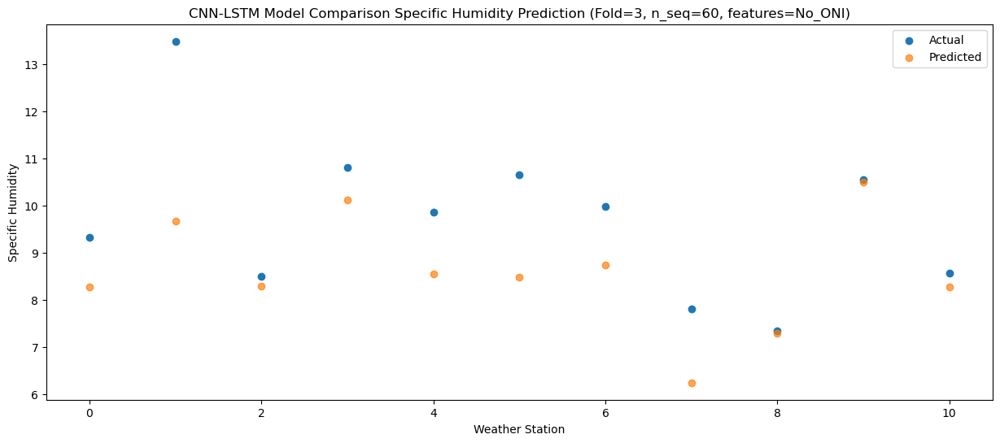

Predictions for (t+46):
    Weather_Station  Actual  Predicted
0                 0    6.41   6.144558
1                 1    9.41   7.544544
2                 2    6.96   6.164303
3                 3    8.34   7.994541
4                 4    5.75   6.424515
5                 5    7.42   6.364532
6                 6    7.36   6.614389
7                 7    6.87   4.124338
8                 8    6.80   5.164321
9                 9    9.57   8.364471
10               10    6.88   6.144490


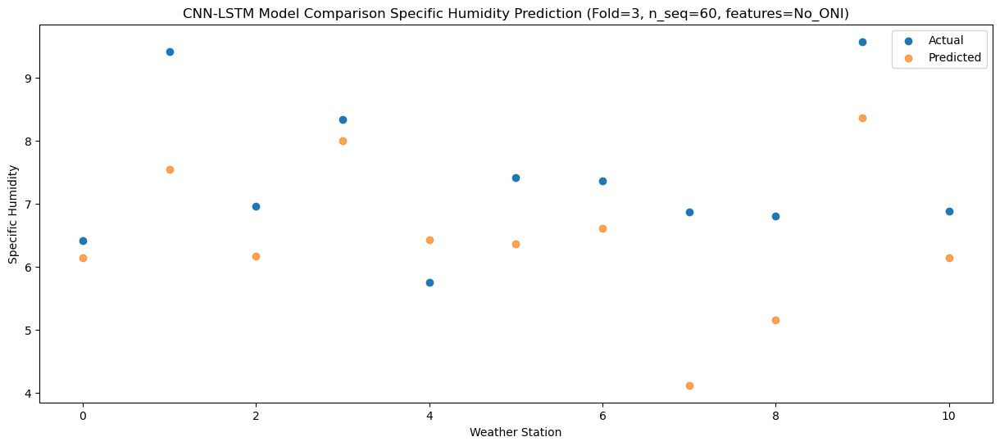

Predictions for (t+47):
    Weather_Station  Actual  Predicted
0                 0    2.30   2.842169
1                 1    5.97   4.242154
2                 2    5.80   2.861887
3                 3    4.81   4.692151
4                 4    2.13   3.122125
5                 5    4.04   3.062144
6                 6    6.11   3.311980
7                 7    3.81   0.821924
8                 8    5.37   1.861903
9                 9    6.18   5.062075
10               10    3.61   2.842098


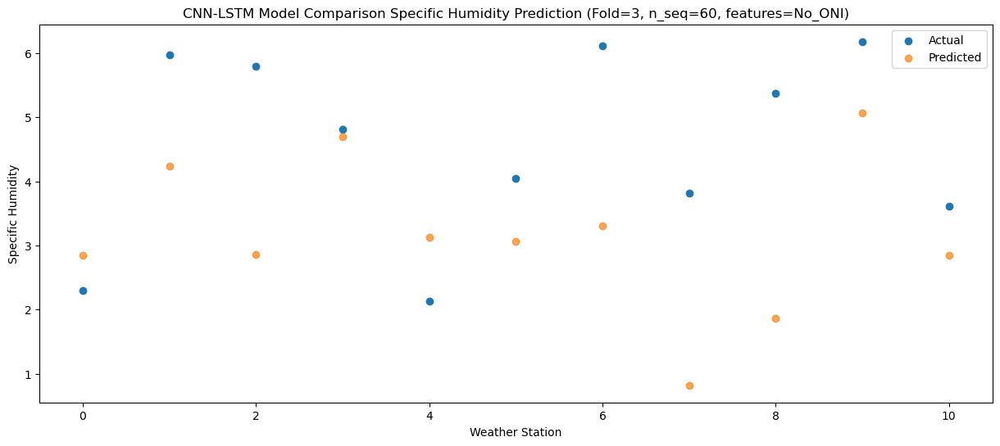

Predictions for (t+48):
    Weather_Station  Actual  Predicted
0                 0   -0.93  -0.087853
1                 1    3.09   1.312132
2                 2    3.69  -0.068140
3                 3    1.42   1.762131
4                 4   -1.04   0.192103
5                 5    0.85   0.132123
6                 6    4.78   0.381954
7                 7    2.80  -2.108103
8                 8    4.28  -1.068124
9                 9    2.38   2.132054
10               10   -0.07  -0.087924


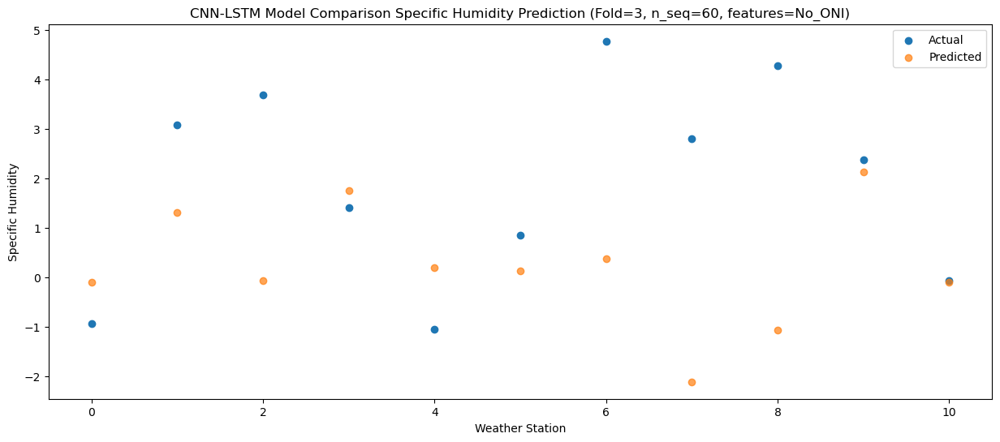

Predictions for (t+49):
    Weather_Station  Actual  Predicted
0                 0   -0.94  -0.381817
1                 1    2.27   1.018170
2                 2    3.92  -0.362109
3                 3    1.44   1.468167
4                 4   -1.45  -0.101860
5                 5    0.81  -0.161839
6                 6    4.65   0.087991
7                 7    2.72  -2.402068
8                 8    4.66  -1.362092
9                 9    2.71   1.838088
10               10    0.31  -0.381891


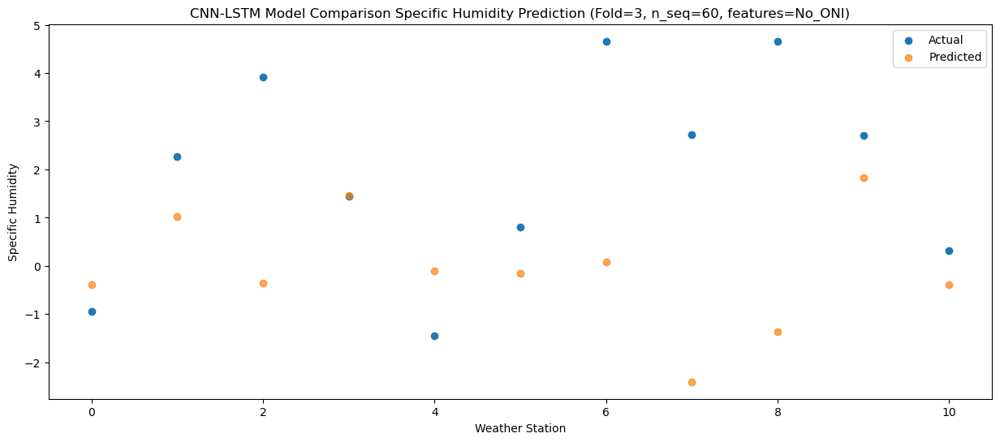

Predictions for (t+50):
    Weather_Station  Actual  Predicted
0                 0   -1.59  -1.461416
1                 1    0.96  -0.061436
2                 2    4.46  -1.441733
3                 3    0.70   0.388568
4                 4   -2.32  -1.181462
5                 5   -0.07  -1.241438
6                 6    4.59  -0.991629
7                 7    3.26  -3.481695
8                 8    4.67  -2.441714
9                 9    1.41   0.758485
10               10   -0.82  -1.461491


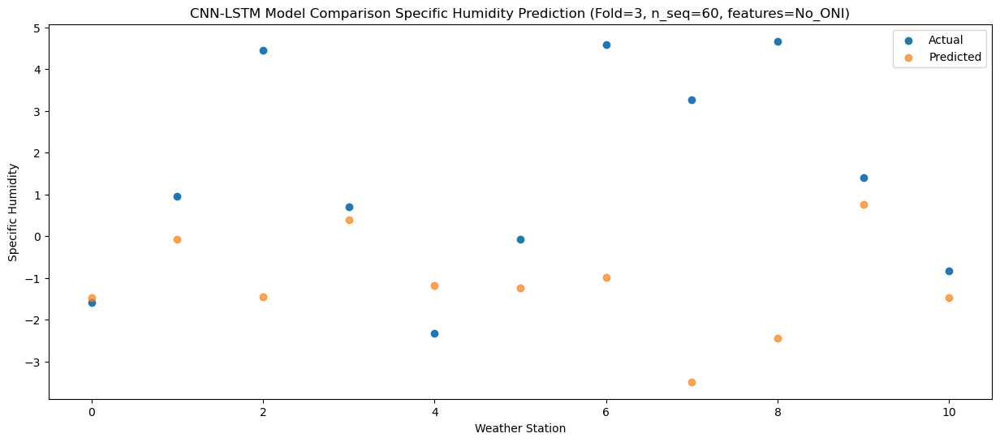

Predictions for (t+51):
    Weather_Station  Actual  Predicted
0                 0   -1.53  -0.755667
1                 1    2.38   0.644310
2                 2    4.63  -0.735979
3                 3    1.02   1.094314
4                 4   -1.41  -0.475715
5                 5    0.51  -0.535692
6                 6    4.66  -0.285877
7                 7    4.08  -2.775943
8                 8    4.36  -1.735962
9                 9    1.31   1.464236
10               10   -0.91  -0.755739


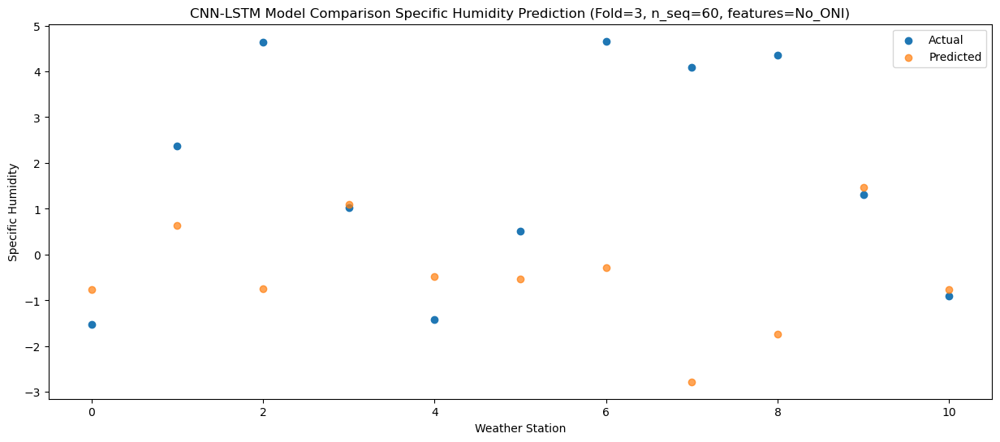

Predictions for (t+52):
    Weather_Station  Actual  Predicted
0                 0   -0.03   0.219701
1                 1    3.80   1.619680
2                 2    4.34   0.239392
3                 3    1.98   2.069680
4                 4   -0.37   0.499655
5                 5    1.59   0.439672
6                 6    5.02   0.689493
7                 7    3.40  -1.800572
8                 8    4.16  -0.760588
9                 9    2.36   2.439600
10               10    0.14   0.219625


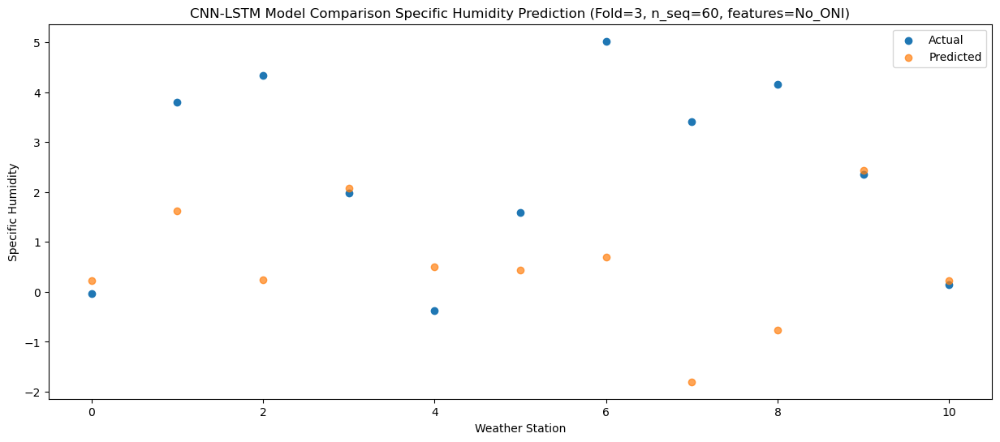

Predictions for (t+53):
    Weather_Station  Actual  Predicted
0                 0    2.01   1.606933
1                 1    5.34   3.006917
2                 2    5.02   1.626599
3                 3    3.89   3.456916
4                 4    1.45   1.886891
5                 5    3.84   1.826906
6                 6    5.70   2.076711
7                 7    3.10  -0.413359
8                 8    4.60   0.626616
9                 9    3.27   3.826827
10               10    1.74   1.606856


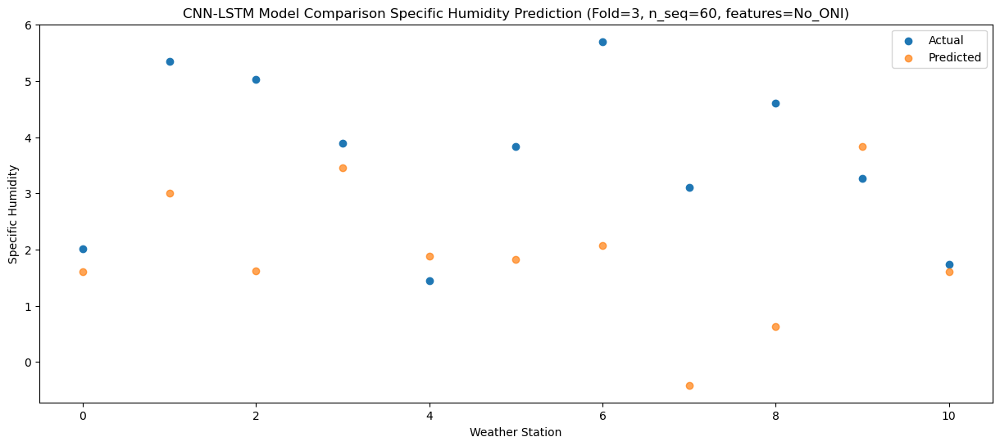

Predictions for (t+54):
    Weather_Station  Actual  Predicted
0                 0    5.88   5.024122
1                 1    9.84   6.424104
2                 2    4.89   5.043770
3                 3    8.00   6.874103
4                 4    5.59   5.304078
5                 5    7.51   5.244093
6                 6    6.59   5.493887
7                 7    2.97   3.003815
8                 8    4.76   4.043785
9                 9    6.73   7.244011
10               10    5.37   5.024043


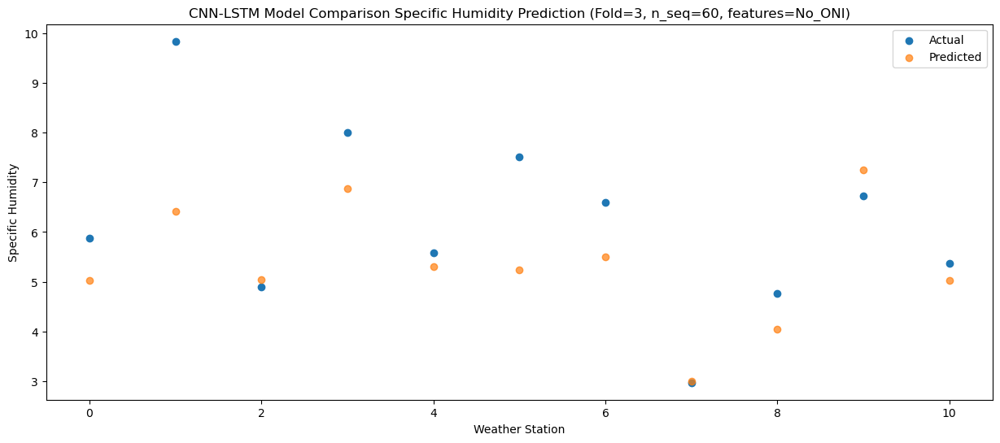

Predictions for (t+55):
    Weather_Station  Actual  Predicted
0                 0    7.61   7.365142
1                 1   12.12   8.765123
2                 2    6.16   7.384763
3                 3    9.80   9.215121
4                 4    7.56   7.645092
5                 5    9.33   7.585105
6                 6    8.88   7.834890
7                 7    4.37   5.344816
8                 8    5.91   6.384776
9                 9    9.60   9.585020
10               10    7.05   7.365054


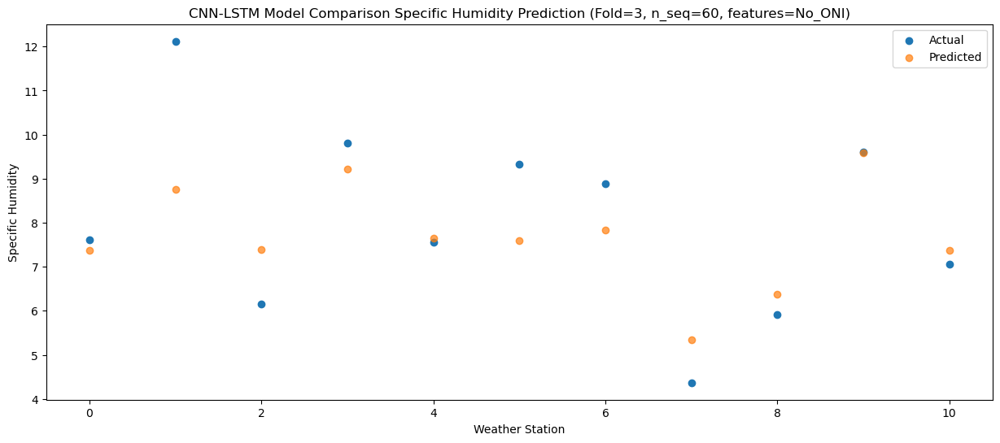

Predictions for (t+56):
    Weather_Station  Actual  Predicted
0                 0   10.47   8.625850
1                 1   12.61  10.025831
2                 2    8.14   8.645471
3                 3   10.70  10.475828
4                 4    9.13   8.905798
5                 5   10.52   8.845811
6                 6    8.93   9.095597
7                 7    5.40   6.605523
8                 8    7.49   7.645483
9                 9   12.77  10.845723
10               10    9.93   8.625758


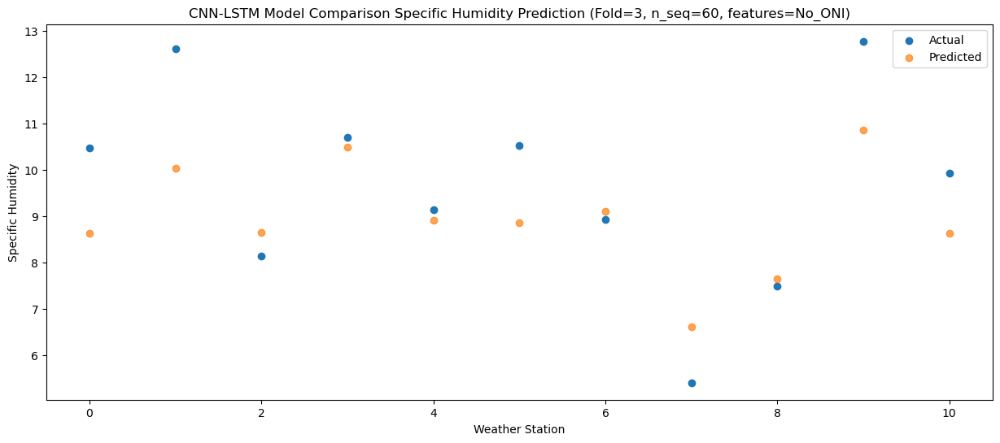

Predictions for (t+57):
    Weather_Station  Actual  Predicted
0                 0    9.03   8.042841
1                 1   11.87   9.442826
2                 2    6.45   8.062492
3                 3    9.38   9.892819
4                 4    8.65   8.322792
5                 5    9.96   8.262802
6                 6   10.39   8.512608
7                 7    6.22   6.022539
8                 8    6.76   7.062504
9                 9   11.42  10.262719
10               10    8.65   8.042752


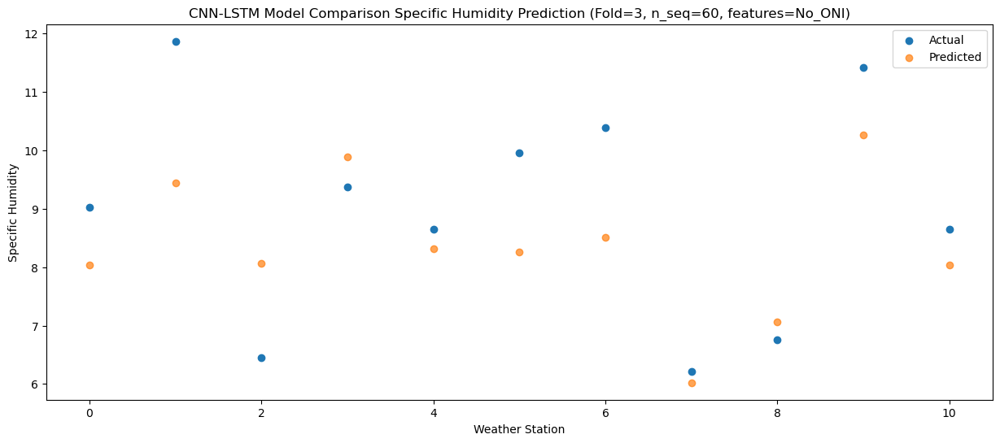

Predictions for (t+58):
    Weather_Station  Actual  Predicted
0                 0    7.32   6.032427
1                 1    8.88   7.432412
2                 2    6.72   6.052109
3                 3    7.84   7.882407
4                 4    5.64   6.312381
5                 5    7.34   6.252391
6                 6    7.97   6.502214
7                 7    4.50   4.012153
8                 8    6.44   5.052121
9                 9    8.06   8.252315
10               10    5.83   6.032347


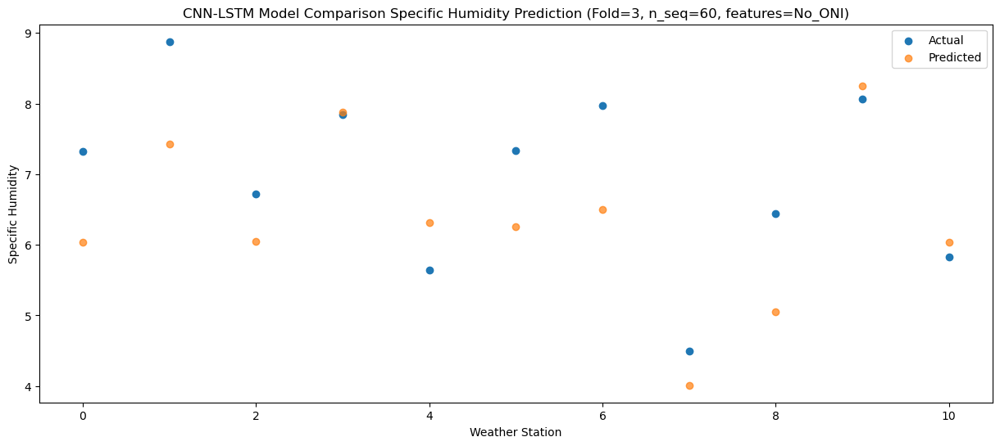

Predictions for (t+59):
    Weather_Station  Actual  Predicted
0                 0    2.50   2.191327
1                 1    4.65   3.591313
2                 2    5.61   2.211020
3                 3    4.09   4.041307
4                 4    1.28   2.471280
5                 5    3.47   2.411288
6                 6    6.21   2.661123
7                 7    3.45   0.171065
8                 8    4.85   1.211030
9                 9    4.96   4.411217
10               10    1.83   2.191246


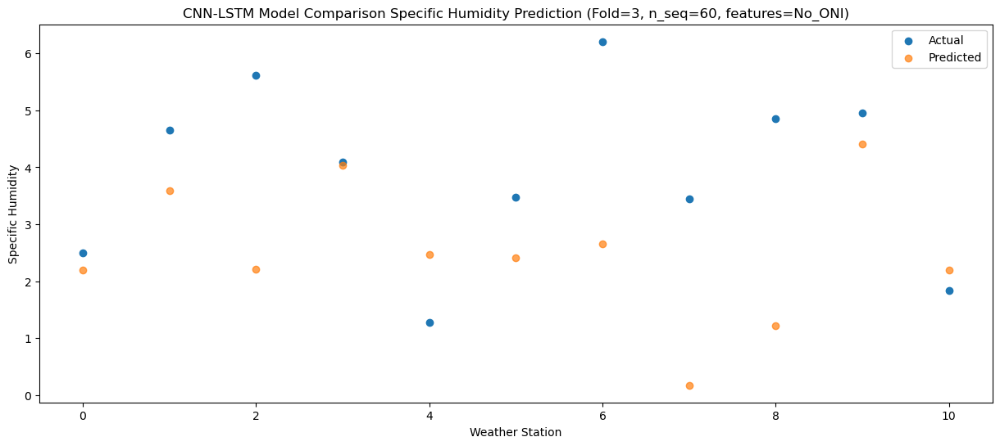

f, t:
[[-1.290e+00  2.240e+00  3.790e+00  1.020e+00  2.490e+00  4.400e-01
   4.780e+00  2.690e+00  3.330e+00  2.250e+00 -5.400e-01]
 [-1.080e+00  1.830e+00  4.330e+00  1.550e+00  9.900e-01  7.300e-01
   4.410e+00  3.680e+00  4.560e+00  1.890e+00 -6.600e-01]
 [-1.030e+00  1.800e+00  3.950e+00  1.150e+00 -1.300e+00  2.300e-01
   4.370e+00  2.560e+00  3.880e+00  1.610e+00 -7.400e-01]
 [-7.000e-01  1.440e+00  3.260e+00  9.700e-01 -2.060e+00 -2.000e-02
   4.330e+00  2.140e+00  2.990e+00  1.690e+00 -7.500e-01]
 [ 1.030e+00  4.040e+00  4.340e+00  2.830e+00  1.000e-02  1.970e+00
   4.960e+00  3.880e+00  3.470e+00  2.180e+00  2.100e-01]
 [ 8.500e-01  4.190e+00  5.710e+00  2.750e+00  3.300e-01  2.090e+00
   5.310e+00  3.690e+00  4.530e+00  2.680e+00  6.400e-01]
 [ 4.070e+00  7.160e+00  5.520e+00  6.180e+00  4.030e+00  5.300e+00
   6.440e+00  2.990e+00  5.390e+00  4.910e+00  3.170e+00]
 [ 7.610e+00  1.069e+01  7.060e+00  9.420e+00  7.120e+00  8.030e+00
   7.500e+00  3.320e+00  5.610e+00  9.020e+0

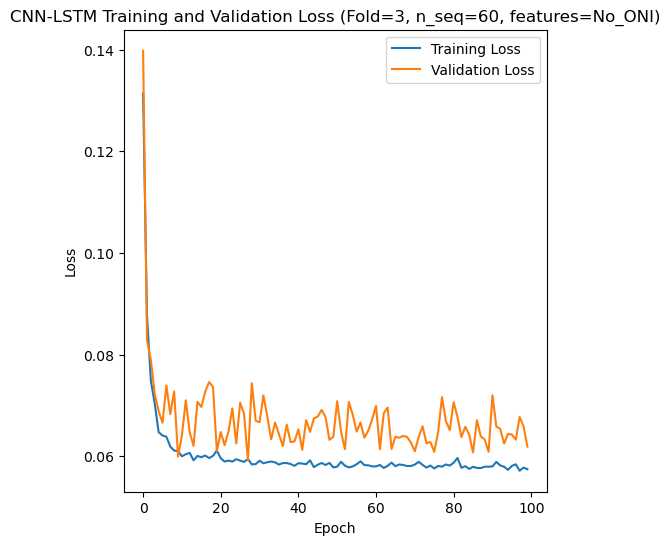

[[ 3.4   2.19  4.28 ... 10.54  6.41  5.39]
 [ 7.94  7.22  7.86 ... 18.27 13.85 11.85]
 [ 5.92  4.91  6.84 ... 14.38  9.59 10.48]
 ...
 [ 3.92  3.    4.93 ... 11.51  7.19  6.46]
 [ 3.98  2.61  4.   ... 10.23  6.65  5.8 ]
 [ 3.84  2.35  4.25 ... 10.6   6.5   5.9 ]]
Epoch 1/100
84/84 [==============================] - 22s 71ms/step - loss: 0.1266 - accuracy: 0.1905 - mae: 0.1036 - rmse: 0.1266 - mape: 22.5732 - pearson: 0.5632 - val_loss: 0.0991 - val_accuracy: 0.7000 - val_mae: 0.0787 - val_rmse: 0.0991 - val_mape: 16.6329 - val_pearson: 0.6662
Epoch 2/100
84/84 [==============================] - 3s 36ms/step - loss: 0.0849 - accuracy: 0.3095 - mae: 0.0680 - rmse: 0.0849 - mape: 15.1962 - pearson: 0.7161 - val_loss: 0.0676 - val_accuracy: 0.2000 - val_mae: 0.0525 - val_rmse: 0.0676 - val_mape: 12.3766 - val_pearson: 0.7523
Epoch 3/100
84/84 [==============================] - 3s 32ms/step - loss: 0.0774 - accuracy: 0.4286 - mae: 0.0621 - rmse: 0.0774 - mape: 13.9112 - pearson: 0.7489 - va

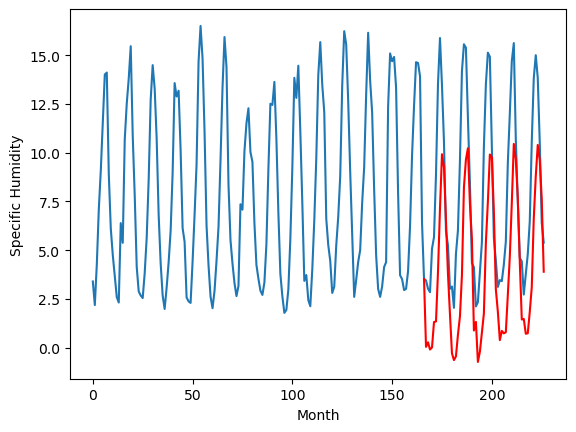

Weather Station 2:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
-1.88		-0.39		1.49
-1.74		-0.16		1.58
-3.30		-0.53		2.77
-2.46		-0.42		2.04
-1.08		0.88		1.96
0.13		0.91		0.78
0.78		3.45		2.67
4.11		6.69		2.58
5.85		9.48		3.63
6.09		8.82		2.73
5.51		6.10		0.59
3.47		3.34		-0.13
0.41		1.29		0.88
-4.33		-0.72		3.61
-3.98		-1.07		2.91
-1.99		-0.88		1.11
-2.02		0.23		2.25
-1.27		1.16		2.43
0.06		3.28		3.22
4.35		7.78		3.43
5.56		9.21		3.65
5.95		9.79		3.84
5.15		6.95		1.80
2.23		5.13		2.90
-2.43		0.45		2.88
-0.69		0.89		1.58
-4.55		-1.16		3.39
-2.97		-0.64		2.33
-1.44		0.33		1.77
-0.15		1.31		1.46
2.24		4.95		2.71
5.14		7.04		1.90
6.17		9.47		3.30
6.25		9.32		3.07
5.38		6.55		1.17
0.60		2.55		1.95
0.77		1.42		0.65
-2.75		-0.05		2.70
-3.26		0.43		3.69
-1.32		0.30		1.62
-0.94		0.36		1.30
0.55		2.26		1.71
1.35		4.24		2.89
4.86		7.00		2.14
6.77		10.01		3.24
7.07		9.23		2.16
4.62		7.23		2.61
1.00		3.97		2.97
-1.30		1.01		2.31
-2.39		1.04		3.43
-3.43		0.28		3.71
-4.

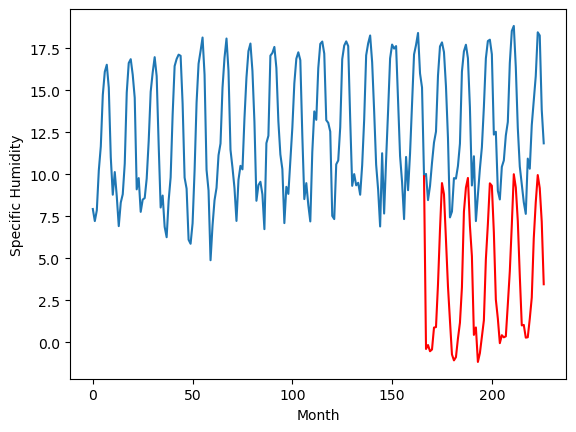

Weather Station 3:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
2.90		4.15		1.25
3.74		4.38		0.64
3.60		4.01		0.41
3.41		4.12		0.71
6.96		5.42		-1.54
5.84		5.45		-0.39
8.08		7.99		-0.09
11.38		11.23		-0.15
14.31		14.02		-0.29
12.80		13.36		0.56
10.75		10.64		-0.11
7.40		7.88		0.48
4.73		5.83		1.10
2.35		3.82		1.47
2.24		3.47		1.23
2.12		3.66		1.54
5.18		4.77		-0.41
5.43		5.70		0.27
8.87		7.82		-1.05
13.11		12.32		-0.79
14.76		13.75		-1.01
14.77		14.33		-0.44
11.83		11.49		-0.34
9.05		9.67		0.62
3.61		4.99		1.38
6.56		5.43		-1.13
1.83		3.38		1.55
2.68		3.90		1.22
3.73		4.87		1.14
6.18		5.85		-0.33
10.78		9.49		-1.29
13.16		11.58		-1.58
15.00		14.01		-0.99
14.82		13.86		-0.96
10.58		11.09		0.51
5.62		7.09		1.47
4.87		5.96		1.09
4.33		4.49		0.16
4.23		4.97		0.74
4.90		4.84		-0.06
5.23		4.90		-0.33
6.07		6.80		0.73
9.45		8.78		-0.67
13.02		11.54		-1.48
14.61		14.55		-0.06
13.03		13.77		0.74
10.01		11.77		1.76
6.08		8.51		2.43
4.10		5.55		1.45
2.79		5.58		2.79

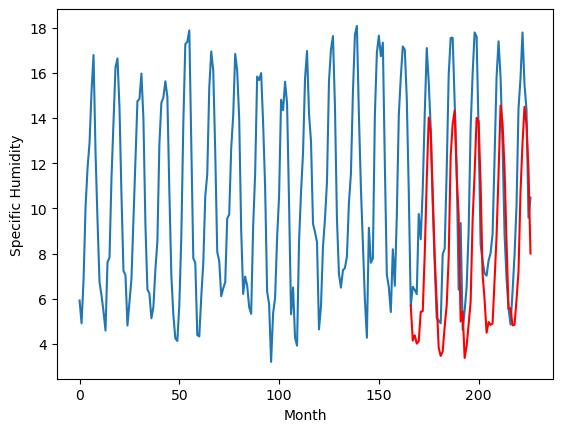

Weather Station 4:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
3.20		2.13		-1.07
2.20		2.36		0.16
2.84		1.99		-0.85
2.22		2.10		-0.12
6.17		3.40		-2.77
5.77		3.43		-2.34
8.93		5.97		-2.96
11.09		9.21		-1.88
14.32		12.00		-2.32
11.73		11.34		-0.39
10.52		8.62		-1.90
5.95		5.86		-0.09
4.31		3.81		-0.50
1.71		1.80		0.09
1.60		1.45		-0.15
1.28		1.64		0.36
3.94		2.75		-1.19
5.23		3.68		-1.55
9.23		5.80		-3.43
12.92		10.30		-2.62
13.49		11.73		-1.76
13.88		12.31		-1.57
9.87		9.47		-0.40
7.02		7.65		0.63
3.40		2.97		-0.43
5.26		3.41		-1.85
0.60		1.36		0.76
1.13		1.88		0.75
2.72		2.85		0.13
6.23		3.83		-2.40
10.22		7.47		-2.75
11.99		9.56		-2.43
11.41		11.99		0.58
12.42		11.84		-0.58
9.14		9.07		-0.07
4.68		5.07		0.39
4.50		3.94		-0.56
2.92		2.47		-0.45
2.23		2.95		0.72
2.59		2.82		0.23
4.65		2.88		-1.77
5.33		4.78		-0.55
9.59		6.76		-2.83
13.53		9.52		-4.01
13.38		12.53		-0.85
11.28		11.75		0.47
10.38		9.75		-0.63
6.66		6.49		-0.17
4.13		3.53		-0.60
2.38		3.56	

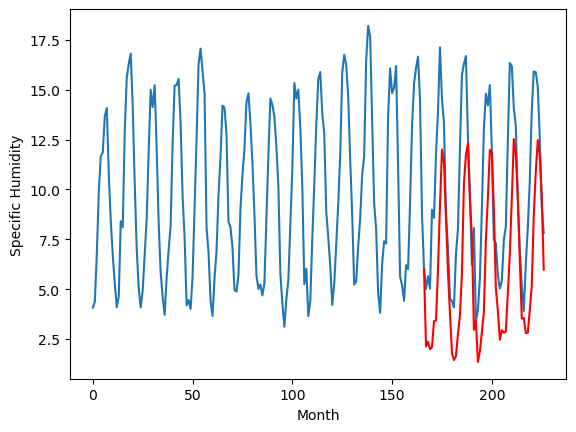

Weather Station 5:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
1.29		0.29		-1.00
0.32		0.52		0.20
1.01		0.15		-0.86
0.35		0.26		-0.09
4.25		1.56		-2.69
3.74		1.59		-2.15
6.98		4.13		-2.85
8.96		7.37		-1.59
12.11		10.16		-1.95
9.46		9.50		0.04
8.57		6.78		-1.79
3.80		4.02		0.22
2.44		1.97		-0.47
-0.13		-0.04		0.09
-0.17		-0.39		-0.22
-0.62		-0.20		0.42
1.96		0.91		-1.05
3.32		1.84		-1.48
7.61		3.96		-3.65
11.49		8.46		-3.03
11.87		9.89		-1.98
11.98		10.47		-1.51
8.08		7.63		-0.45
5.35		5.81		0.46
1.74		1.13		-0.61
3.15		1.57		-1.58
-1.18		-0.48		0.70
-0.74		0.04		0.78
0.78		1.01		0.23
4.46		1.99		-2.47
8.34		5.63		-2.71
10.02		7.72		-2.30
9.52		10.15		0.63
10.69		10.00		-0.69
7.54		7.23		-0.31
3.08		3.23		0.15
2.66		2.10		-0.56
1.07		0.63		-0.44
0.32		1.11		0.79
0.72		0.98		0.26
2.69		1.04		-1.65
3.54		2.94		-0.60
7.81		4.92		-2.89
11.29		7.68		-3.61
10.39		10.69		0.30
9.01		9.91		0.90
8.68		7.91		-0.77
5.02		4.65		-0.37
2.60		1.69		-0.91
0.84		1.72		0.88

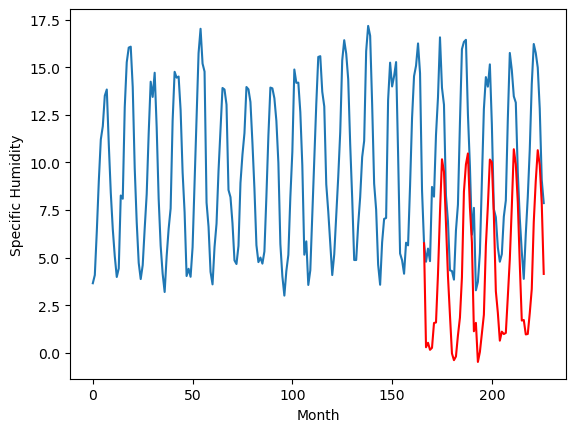

Weather Station 6:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
2.63		-0.14		-2.77
1.39		0.09		-1.30
1.27		-0.28		-1.55
1.15		-0.17		-1.32
3.95		1.13		-2.82
3.20		1.16		-2.04
5.47		3.70		-1.77
7.18		6.94		-0.24
8.41		9.73		1.32
7.10		9.07		1.97
6.91		6.35		-0.56
3.26		3.59		0.33
2.80		1.54		-1.26
0.24		-0.47		-0.71
0.94		-0.82		-1.76
0.30		-0.63		-0.93
1.79		0.48		-1.31
2.75		1.41		-1.34
7.30		3.53		-3.77
9.60		8.03		-1.57
10.63		9.46		-1.17
10.35		10.04		-0.31
7.10		7.20		0.10
4.05		5.38		1.33
2.33		0.70		-1.63
1.48		1.14		-0.34
0.02		-0.91		-0.93
0.01		-0.39		-0.40
0.60		0.58		-0.02
2.63		1.56		-1.07
4.89		5.20		0.31
7.74		7.29		-0.45
8.43		9.72		1.29
10.42		9.57		-0.85
9.17		6.80		-2.37
5.66		2.80		-2.86
2.96		1.67		-1.29
2.32		0.20		-2.12
0.77		0.68		-0.09
0.89		0.55		-0.34
2.18		0.61		-1.57
2.15		2.51		0.36
6.99		4.49		-2.50
10.85		7.25		-3.60
8.52		10.26		1.74
7.66		9.48		1.82
8.17		7.48		-0.69
6.04		4.22		-1.82
3.74		1.26		-2.48
2.16		1.29		-0.87
0

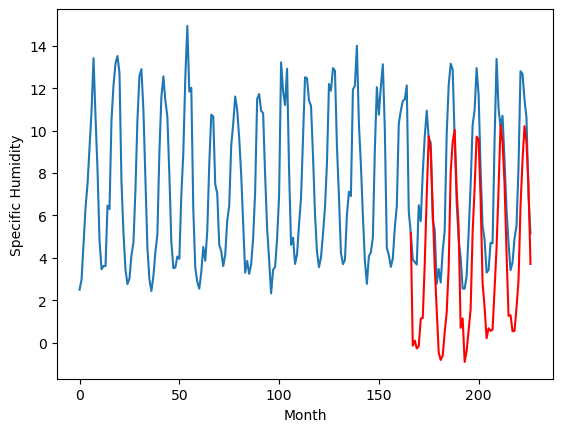

Weather Station 7:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
-2.97		-1.30		1.67
-2.90		-1.07		1.83
-3.06		-1.44		1.62
-2.48		-1.33		1.15
-0.29		-0.03		0.26
-0.96		-0.00		0.96
2.16		2.54		0.38
5.99		5.78		-0.21
8.58		8.57		-0.01
8.79		7.91		-0.88
4.95		5.19		0.24
2.30		2.43		0.13
-0.53		0.38		0.91
-3.87		-1.63		2.24
-3.99		-1.98		2.01
-3.74		-1.79		1.95
-2.03		-0.68		1.35
-1.62		0.25		1.87
1.36		2.37		1.01
6.05		6.87		0.82
7.65		8.30		0.65
8.03		8.88		0.85
4.45		6.04		1.59
2.24		4.22		1.98
-3.48		-0.46		3.02
-1.62		-0.02		1.60
-4.60		-2.07		2.53
-3.28		-1.55		1.73
-2.44		-0.58		1.86
-1.38		0.40		1.78
2.63		4.04		1.41
4.91		6.13		1.22
8.07		8.56		0.49
6.88		8.41		1.53
3.33		5.64		2.31
-1.35		1.64		2.99
-1.53		0.51		2.04
-3.52		-0.96		2.56
-2.89		-0.48		2.41
-1.85		-0.61		1.24
-2.36		-0.55		1.81
-0.76		1.35		2.11
1.46		3.33		1.87
4.51		6.09		1.58
7.90		9.10		1.20
7.44		8.32		0.88
3.99		6.32		2.33
0.08		3.06		2.98
-2.87		0.10		2.97
-3.15		0.13		3.28
-3.93	

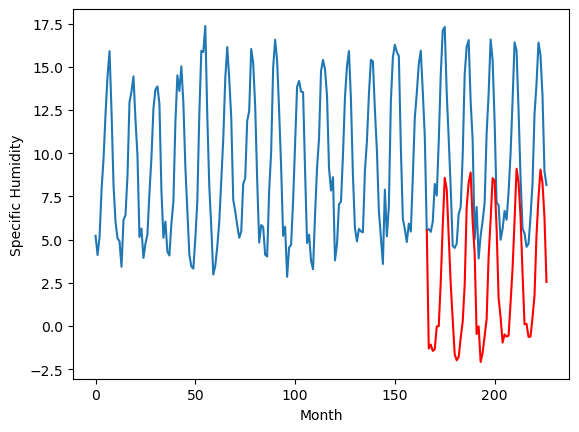

Weather Station 8:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
1.81		1.43		-0.38
1.54		1.66		0.12
1.30		1.29		-0.01
1.07		1.40		0.33
3.62		2.70		-0.92
3.94		2.73		-1.21
7.32		5.27		-2.05
10.93		8.51		-2.42
12.98		11.30		-1.68
10.33		10.64		0.31
8.73		7.92		-0.81
4.18		5.16		0.98
2.51		3.11		0.60
0.58		1.10		0.52
0.43		0.75		0.32
-0.20		0.94		1.14
2.17		2.05		-0.12
3.09		2.98		-0.11
6.25		5.10		-1.15
10.85		9.60		-1.25
11.80		11.03		-0.77
11.54		11.61		0.07
8.28		8.77		0.49
6.19		6.95		0.76
1.50		2.27		0.77
2.97		2.71		-0.26
-0.23		0.66		0.89
0.28		1.18		0.90
1.79		2.15		0.36
3.58		3.13		-0.45
8.29		6.77		-1.52
10.65		8.86		-1.79
11.45		11.29		-0.16
11.92		11.14		-0.78
8.11		8.37		0.26
3.45		4.37		0.92
2.09		3.24		1.15
1.22		1.77		0.55
1.50		2.25		0.75
1.31		2.12		0.81
2.07		2.18		0.11
2.97		4.08		1.11
7.36		6.06		-1.30
9.92		8.82		-1.10
12.71		11.83		-0.88
12.99		11.05		-1.94
8.79		9.05		0.26
5.18		5.79		0.61
2.15		2.83		0.68
1.34		2.86		1.52
0.19		2.10	

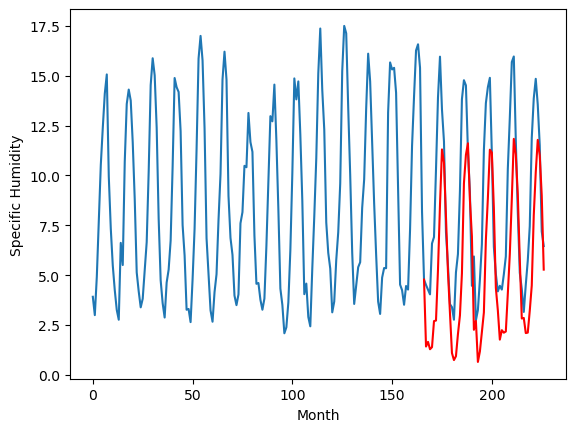

Weather Station 9:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
0.40		0.13		-0.27
0.57		0.36		-0.21
0.20		-0.01		-0.21
-0.20		0.10		0.30
1.72		1.40		-0.32
2.00		1.43		-0.57
5.15		3.97		-1.18
7.89		7.21		-0.68
11.11		10.00		-1.11
9.44		9.34		-0.10
6.52		6.62		0.10
3.14		3.86		0.72
1.46		1.81		0.35
-0.14		-0.20		-0.06
-0.49		-0.55		-0.06
-1.06		-0.36		0.70
0.88		0.75		-0.13
2.21		1.68		-0.53
4.50		3.80		-0.70
9.56		8.30		-1.26
10.82		9.73		-1.09
10.96		10.31		-0.65
7.48		7.47		-0.01
6.33		5.65		-0.68
0.56		0.97		0.41
1.27		1.41		0.14
-1.11		-0.64		0.47
-0.53		-0.12		0.41
0.78		0.85		0.07
2.27		1.83		-0.44
6.29		5.47		-0.82
7.73		7.56		-0.17
10.47		9.99		-0.48
10.11		9.84		-0.27
7.45		7.07		-0.38
2.12		3.07		0.95
1.08		1.94		0.86
0.12		0.47		0.35
0.74		0.95		0.21
0.34		0.82		0.48
0.69		0.88		0.19
2.14		2.78		0.64
4.39		4.76		0.37
6.35		7.52		1.17
10.65		10.53		-0.12
10.11		9.75		-0.36
7.31		7.75		0.44
3.98		4.49		0.51
0.91		1.53		0.62
0.88		1.56		0.68
-0.20	

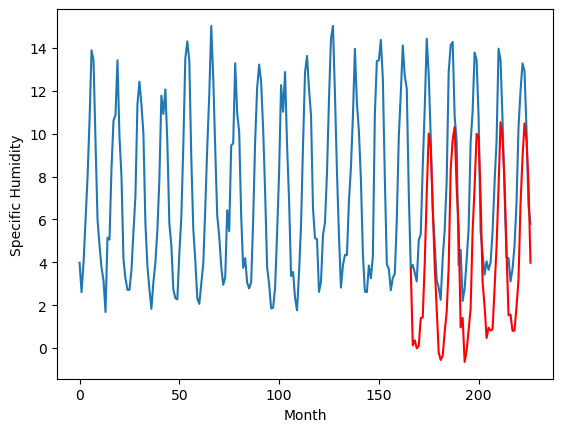

Weather Station 10:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
0.95		0.19		-0.76
1.12		0.42		-0.70
0.64		0.05		-0.59
0.37		0.16		-0.21
2.42		1.46		-0.96
3.01		1.49		-1.52
6.73		4.03		-2.70
9.21		7.27		-1.94
12.77		10.06		-2.71
10.58		9.40		-1.18
7.80		6.68		-1.12
3.64		3.92		0.28
2.55		1.87		-0.68
0.64		-0.14		-0.78
0.32		-0.49		-0.81
-0.32		-0.30		0.02
2.05		0.81		-1.24
3.36		1.74		-1.62
5.98		3.86		-2.12
10.73		8.36		-2.37
12.13		9.79		-2.34
12.38		10.37		-2.01
8.35		7.53		-0.82
6.48		5.71		-0.77
1.19		1.03		-0.16
1.73		1.47		-0.26
-0.51		-0.58		-0.07
0.19		-0.06		-0.25
1.71		0.91		-0.80
3.01		1.89		-1.12
7.08		5.53		-1.55
9.32		7.62		-1.70
11.96		10.05		-1.91
11.19		9.90		-1.29
7.82		7.13		-0.69
3.06		3.13		0.07
1.69		2.00		0.31
0.58		0.53		-0.05
1.10		1.01		-0.09
0.87		0.88		0.01
1.48		0.94		-0.54
2.99		2.84		-0.15
5.77		4.82		-0.95
7.41		7.58		0.17
12.11		10.59		-1.52
11.98		9.81		-2.17
8.20		7.81		-0.39
4.76		4.55		-0.21
1.37		1.59		0.22
1.86		1.6

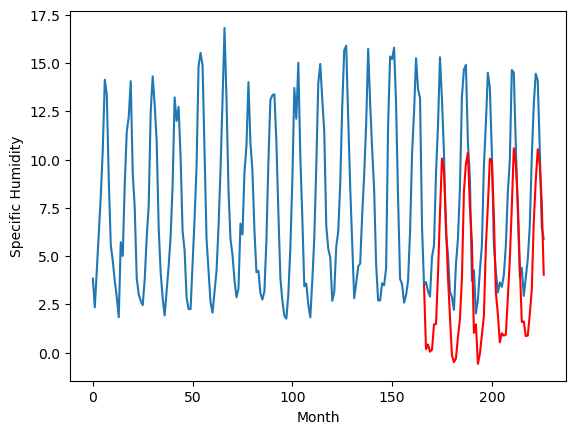

Weather Station 11:
Actual S.H.	Predicted S.H.	Difference
-----------	--------------	----------
0.15		0.05		-0.10
0.30		0.28		-0.02
-0.04		-0.09		-0.05
-0.39		0.02		0.41
1.18		1.32		0.14
1.02		1.35		0.33
3.64		3.89		0.25
6.83		7.13		0.30
9.75		9.92		0.17
8.33		9.26		0.93
6.19		6.54		0.35
3.15		3.78		0.63
1.22		1.73		0.51
-0.11		-0.28		-0.17
-0.49		-0.63		-0.14
-1.06		-0.44		0.62
0.23		0.67		0.44
1.90		1.60		-0.30
3.50		3.72		0.22
8.51		8.22		-0.29
9.78		9.65		-0.13
10.65		10.23		-0.42
6.89		7.39		0.50
5.88		5.57		-0.31
0.64		0.89		0.25
0.60		1.33		0.73
-1.14		-0.72		0.42
-0.69		-0.20		0.49
0.46		0.77		0.31
1.45		1.75		0.30
4.91		5.39		0.48
6.82		7.48		0.66
8.55		9.91		1.36
9.01		9.76		0.75
7.02		6.99		-0.03
2.20		2.99		0.79
1.48		1.86		0.38
0.03		0.39		0.36
0.65		0.87		0.22
-0.10		0.74		0.84
0.11		0.80		0.69
1.81		2.70		0.89
2.71		4.68		1.97
5.95		7.44		1.49
9.57		10.45		0.88
8.77		9.67		0.90
7.06		7.67		0.61
4.00		4.41		0.41
0.56		1.45		0.89
1.08		1.48		0.40
0.01		0.72		0.71
0.03		0.7

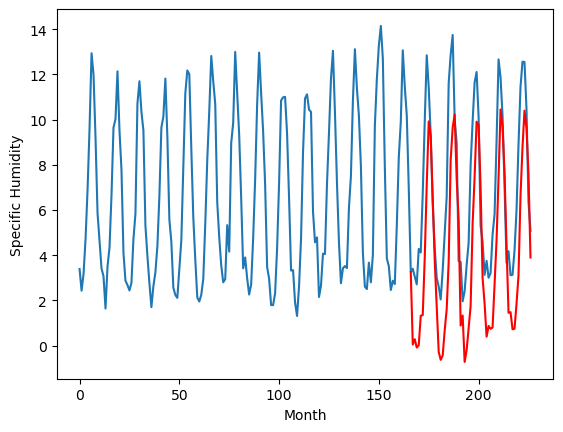

Predictions for (t+0):
    Weather_Station  Actual  Predicted
0                 0    0.95   0.045880
1                 1   -1.88  -0.394120
2                 2    2.90   4.145879
3                 3    3.20   2.125880
4                 4    1.29   0.285880
5                 5    2.63  -0.144120
6                 6   -2.97  -1.304120
7                 7    1.81   1.425879
8                 8    0.40   0.125880
9                 9    0.95   0.185880
10               10    0.15   0.045880


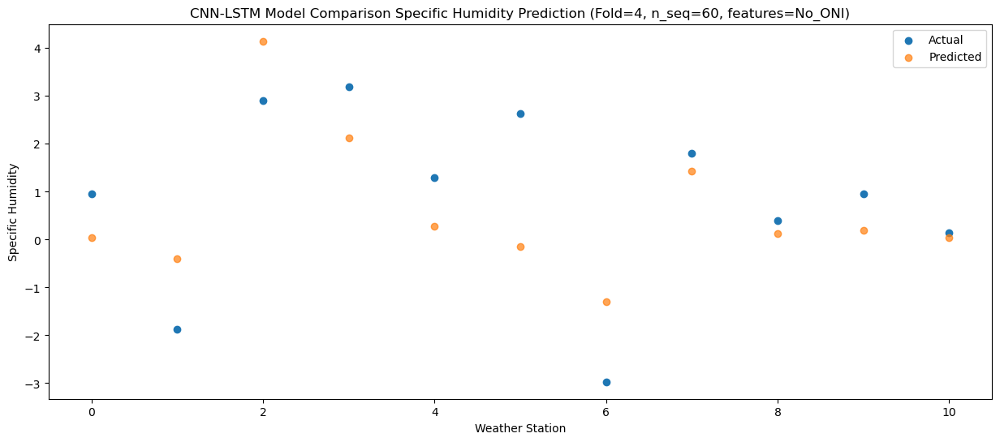

Predictions for (t+1):
    Weather_Station  Actual  Predicted
0                 0    0.88   0.281448
1                 1   -1.74  -0.158550
2                 2    3.74   4.381448
3                 3    2.20   2.361449
4                 4    0.32   0.521450
5                 5    1.39   0.091450
6                 6   -2.90  -1.068551
7                 7    1.54   1.661448
8                 8    0.57   0.361449
9                 9    1.12   0.421449
10               10    0.30   0.281449


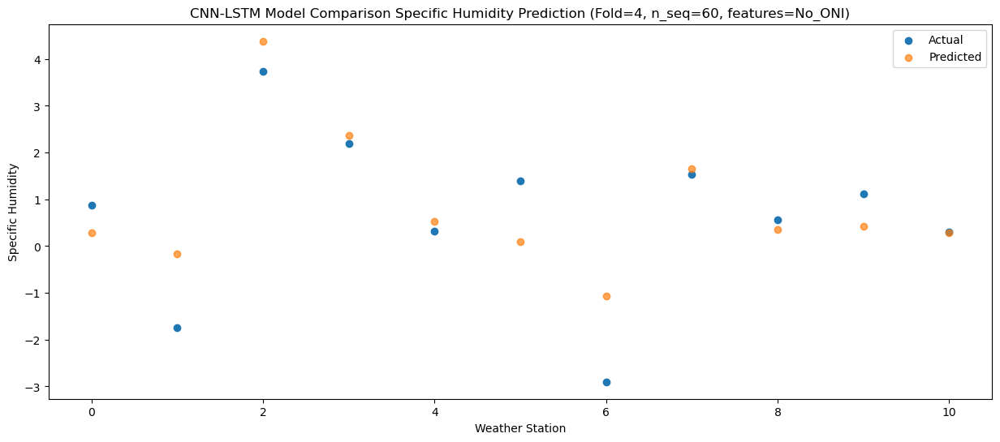

Predictions for (t+2):
    Weather_Station  Actual  Predicted
0                 0    0.46  -0.088380
1                 1   -3.30  -0.528379
2                 2    3.60   4.011621
3                 3    2.84   1.991621
4                 4    1.01   0.151622
5                 5    1.27  -0.278378
6                 6   -3.06  -1.438378
7                 7    1.30   1.291620
8                 8    0.20  -0.008380
9                 9    0.64   0.051621
10               10   -0.04  -0.088380


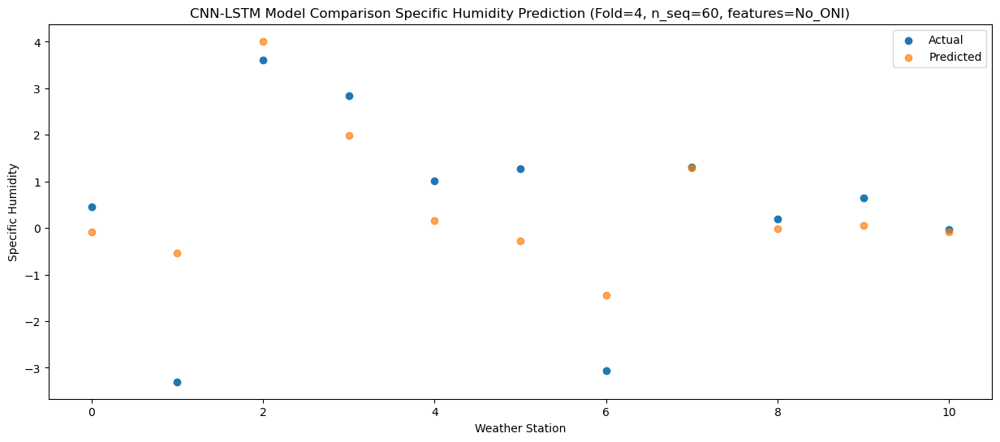

Predictions for (t+3):
    Weather_Station  Actual  Predicted
0                 0    0.28   0.016121
1                 1   -2.46  -0.423878
2                 2    3.41   4.116123
3                 3    2.22   2.096121
4                 4    0.35   0.256122
5                 5    1.15  -0.173878
6                 6   -2.48  -1.333878
7                 7    1.07   1.396120
8                 8   -0.20   0.096120
9                 9    0.37   0.156122
10               10   -0.39   0.016120


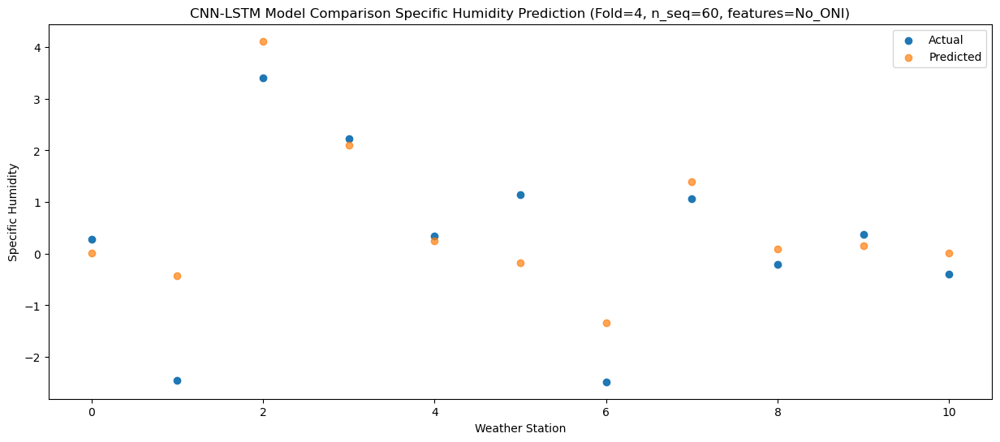

Predictions for (t+4):
    Weather_Station  Actual  Predicted
0                 0    2.51   1.320906
1                 1   -1.08   0.880909
2                 2    6.96   5.420907
3                 3    6.17   3.400906
4                 4    4.25   1.560907
5                 5    3.95   1.130908
6                 6   -0.29  -0.029093
7                 7    3.62   2.700904
8                 8    1.72   1.400904
9                 9    2.42   1.460908
10               10    1.18   1.320903


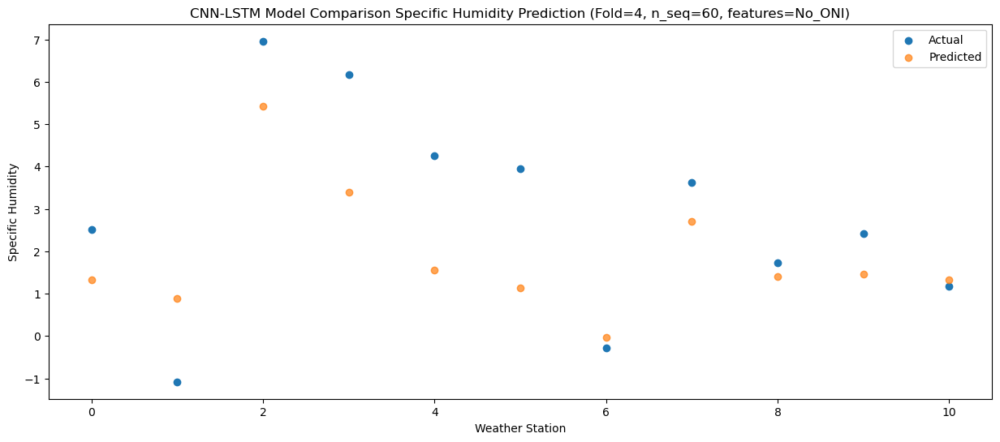

Predictions for (t+5):
    Weather_Station  Actual  Predicted
0                 0    3.10   1.349209
1                 1    0.13   0.909210
2                 2    5.84   5.449209
3                 3    5.77   3.429207
4                 4    3.74   1.589208
5                 5    3.20   1.159209
6                 6   -0.96  -0.000790
7                 7    3.94   2.729206
8                 8    2.00   1.429206
9                 9    3.01   1.489212
10               10    1.02   1.349206


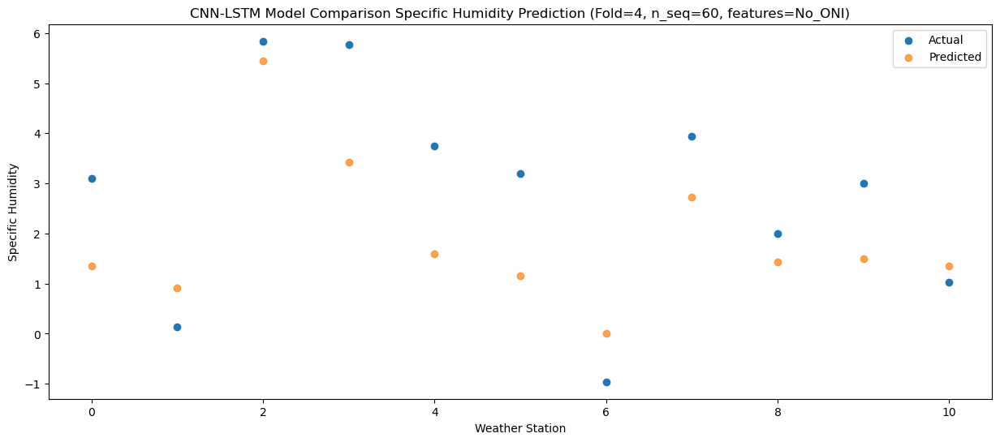

Predictions for (t+6):
    Weather_Station  Actual  Predicted
0                 0    6.31   3.889941
1                 1    0.78   3.449939
2                 2    8.08   7.989940
3                 3    8.93   5.969937
4                 4    6.98   4.129938
5                 5    5.47   3.699938
6                 6    2.16   2.539940
7                 7    7.32   5.269937
8                 8    5.15   3.969936
9                 9    6.73   4.029943
10               10    3.64   3.889936


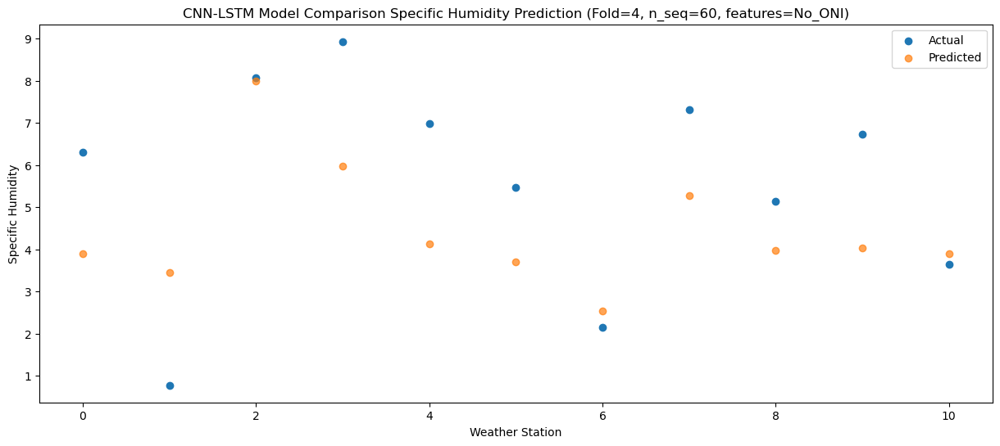

Predictions for (t+7):
    Weather_Station  Actual  Predicted
0                 0   10.96   7.133937
1                 1    4.11   6.693933
2                 2   11.38  11.233934
3                 3   11.09   9.213933
4                 4    8.96   7.373934
5                 5    7.18   6.943933
6                 6    5.99   5.783934
7                 7   10.93   8.513932
8                 8    7.89   7.213933
9                 9    9.21   7.273940
10               10    6.83   7.133933


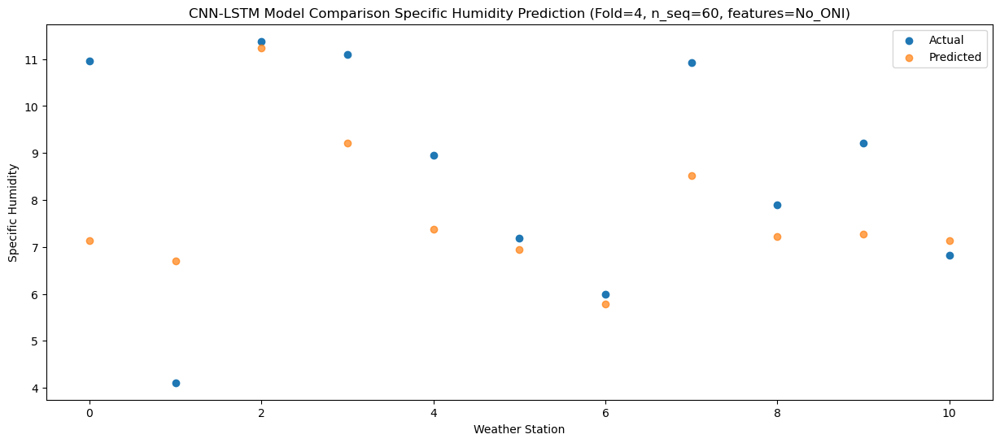

Predictions for (t+8):
    Weather_Station  Actual  Predicted
0                 0   13.31   9.922638
1                 1    5.85   9.482635
2                 2   14.31  14.022634
3                 3   14.32  12.002633
4                 4   12.11  10.162634
5                 5    8.41   9.732634
6                 6    8.58   8.572634
7                 7   12.98  11.302634
8                 8   11.11  10.002632
9                 9   12.77  10.062641
10               10    9.75   9.922632


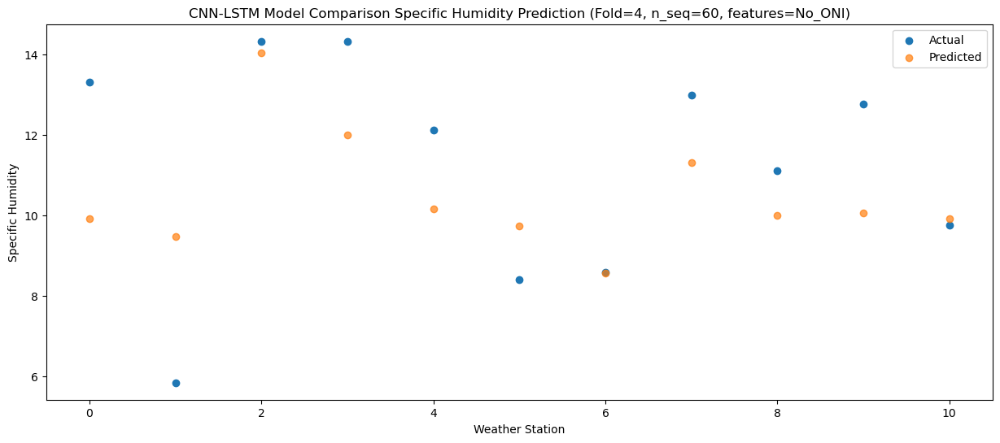

Predictions for (t+9):
    Weather_Station  Actual  Predicted
0                 0   10.88   9.261916
1                 1    6.09   8.821909
2                 2   12.80  13.361909
3                 3   11.73  11.341911
4                 4    9.46   9.501912
5                 5    7.10   9.071909
6                 6    8.79   7.911911
7                 7   10.33  10.641911
8                 8    9.44   9.341911
9                 9   10.58   9.401920
10               10    8.33   9.261911


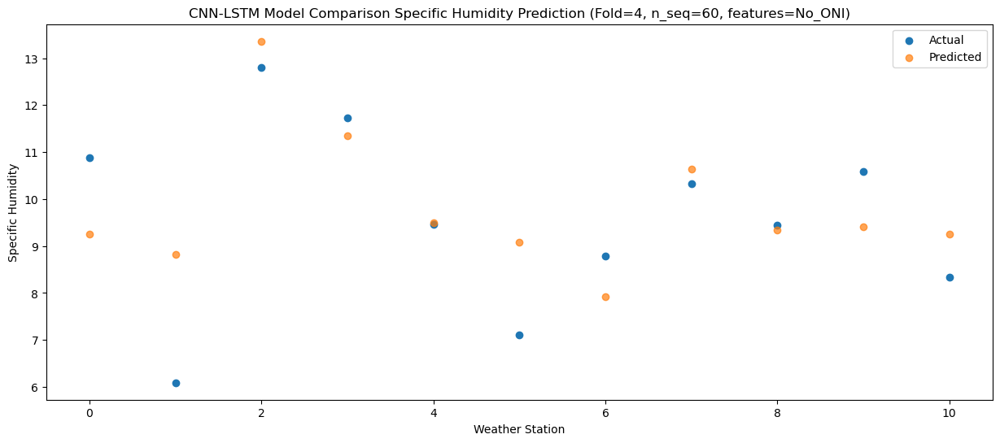

Predictions for (t+10):
    Weather_Station  Actual  Predicted
0                 0    7.99   6.541072
1                 1    5.51   6.101061
2                 2   10.75  10.641063
3                 3   10.52   8.621065
4                 4    8.57   6.781066
5                 5    6.91   6.351061
6                 6    4.95   5.191065
7                 7    8.73   7.921066
8                 8    6.52   6.621065
9                 9    7.80   6.681075
10               10    6.19   6.541065


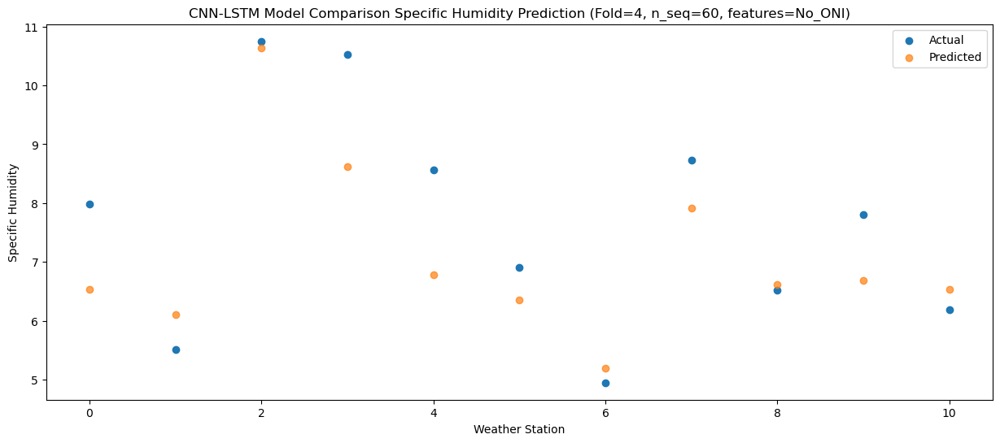

Predictions for (t+11):
    Weather_Station  Actual  Predicted
0                 0    3.40   3.781528
1                 1    3.47   3.341513
2                 2    7.40   7.881517
3                 3    5.95   5.861520
4                 4    3.80   4.021521
5                 5    3.26   3.591514
6                 6    2.30   2.431519
7                 7    4.18   5.161521
8                 8    3.14   3.861521
9                 9    3.64   3.921533
10               10    3.15   3.781522


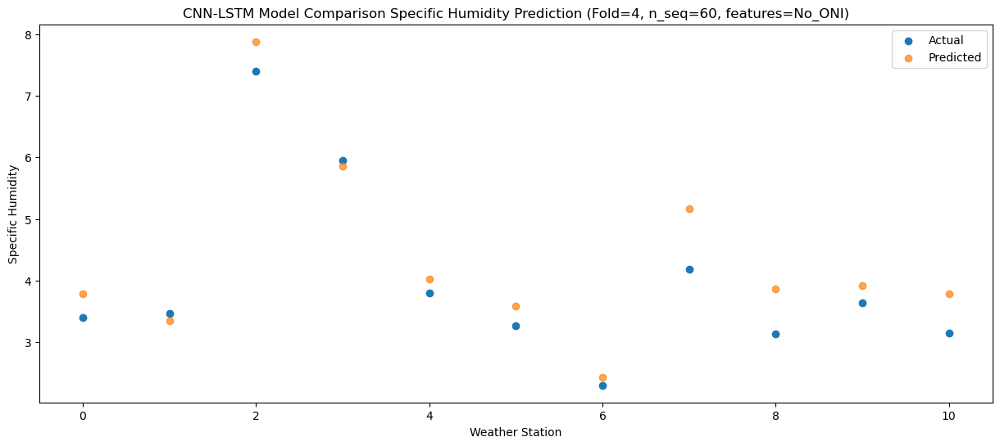

Predictions for (t+12):
    Weather_Station  Actual  Predicted
0                 0    2.68   1.730119
1                 1    0.41   1.290101
2                 2    4.73   5.830108
3                 3    4.31   3.810110
4                 4    2.44   1.970110
5                 5    2.80   1.540103
6                 6   -0.53   0.380109
7                 7    2.51   3.110110
8                 8    1.46   1.810111
9                 9    2.55   1.870124
10               10    1.22   1.730112


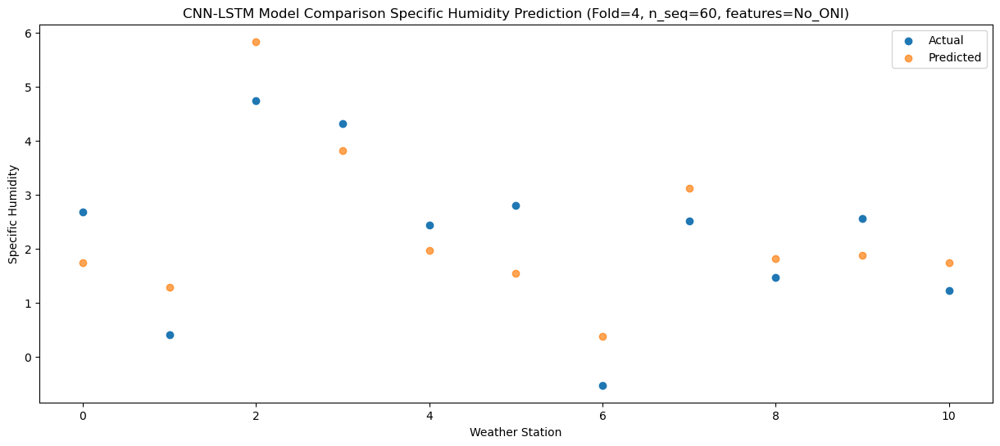

Predictions for (t+13):
    Weather_Station  Actual  Predicted
0                 0    0.45  -0.279842
1                 1   -4.33  -0.719860
2                 2    2.35   3.820149
3                 3    1.71   1.800151
4                 4   -0.13  -0.039849
5                 5    0.24  -0.469858
6                 6   -3.87  -1.629851
7                 7    0.58   1.100150
8                 8   -0.14  -0.199849
9                 9    0.64  -0.139836
10               10   -0.11  -0.279849


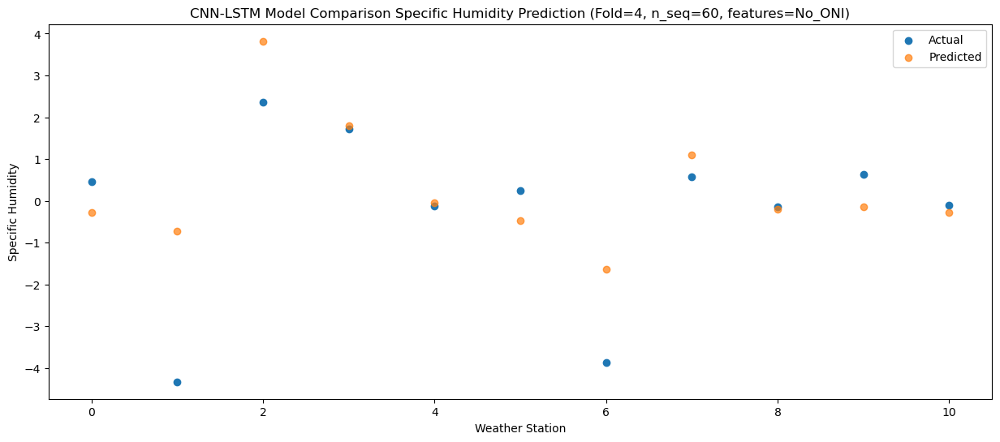

Predictions for (t+14):
    Weather_Station  Actual  Predicted
0                 0    0.57  -0.631837
1                 1   -3.98  -1.071853
2                 2    2.24   3.468155
3                 3    1.60   1.448155
4                 4   -0.17  -0.391843
5                 5    0.94  -0.821850
6                 6   -3.99  -1.981845
7                 7    0.43   0.748155
8                 8   -0.49  -0.551843
9                 9    0.32  -0.491832
10               10   -0.49  -0.631844


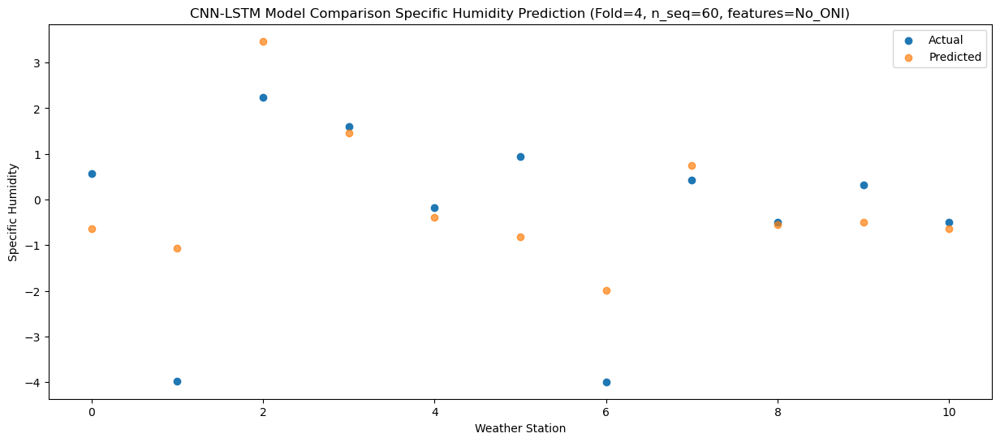

Predictions for (t+15):
    Weather_Station  Actual  Predicted
0                 0   -0.52  -0.437982
1                 1   -1.99  -0.877996
2                 2    2.12   3.662010
3                 3    1.28   1.642011
4                 4   -0.62  -0.197987
5                 5    0.30  -0.627993
6                 6   -3.74  -1.787989
7                 7   -0.20   0.942011
8                 8   -1.06  -0.357988
9                 9   -0.32  -0.297977
10               10   -1.06  -0.437989


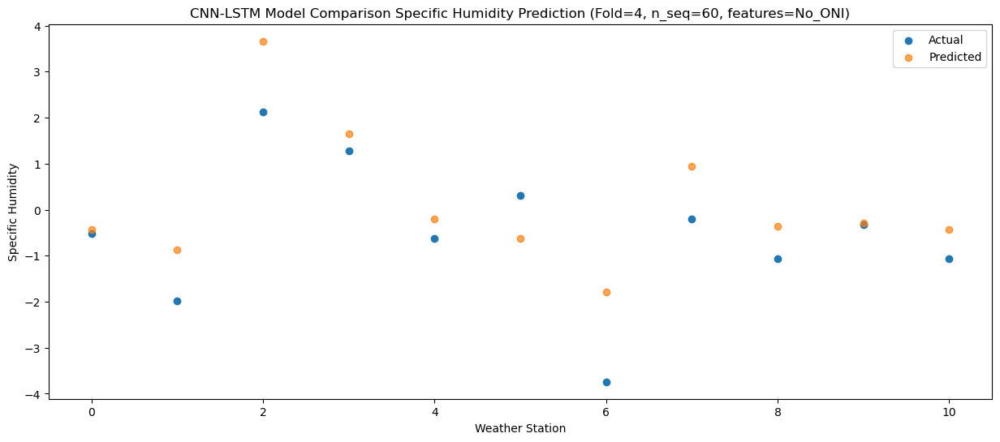

Predictions for (t+16):
    Weather_Station  Actual  Predicted
0                 0    2.24   0.668428
1                 1   -2.02   0.228414
2                 2    5.18   4.768420
3                 3    3.94   2.748421
4                 4    1.96   0.908422
5                 5    1.79   0.478418
6                 6   -2.03  -0.681579
7                 7    2.17   2.048422
8                 8    0.88   0.748422
9                 9    2.05   0.808432
10               10    0.23   0.668421


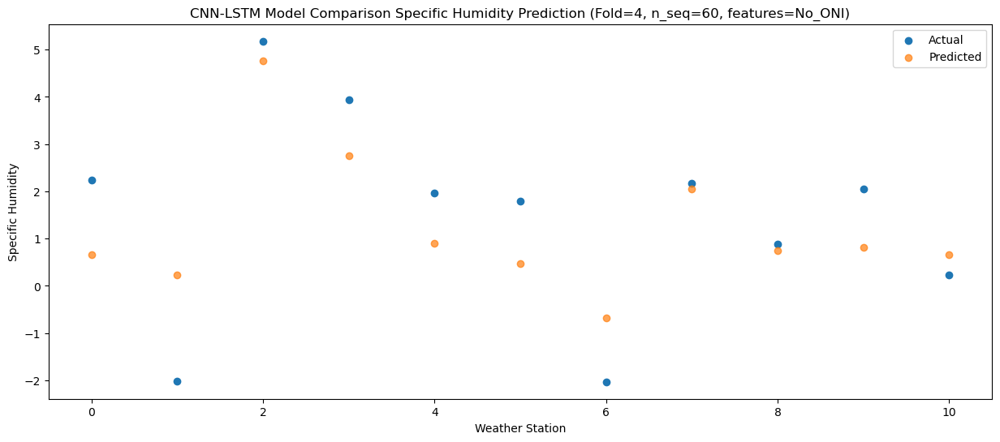

Predictions for (t+17):
    Weather_Station  Actual  Predicted
0                 0    3.45   1.604193
1                 1   -1.27   1.164178
2                 2    5.43   5.704184
3                 3    5.23   3.684186
4                 4    3.32   1.844186
5                 5    2.75   1.414182
6                 6   -1.62   0.254185
7                 7    3.09   2.984186
8                 8    2.21   1.684186
9                 9    3.36   1.744197
10               10    1.90   1.604186


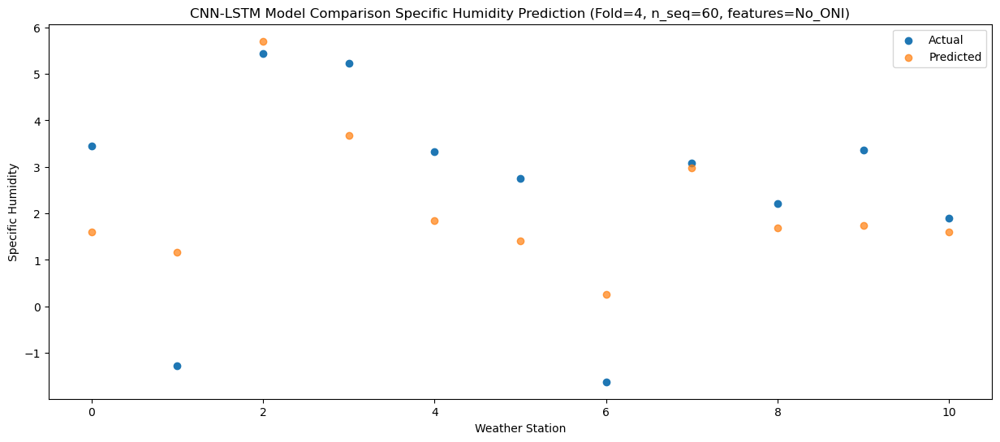

Predictions for (t+18):
    Weather_Station  Actual  Predicted
0                 0    7.01   3.715924
1                 1    0.06   3.275914
2                 2    8.87   7.815918
3                 3    9.23   5.795919
4                 4    7.61   3.955920
5                 5    7.30   3.525918
6                 6    1.36   2.365918
7                 7    6.25   5.095918
8                 8    4.50   3.795918
9                 9    5.98   3.855929
10               10    3.50   3.715918


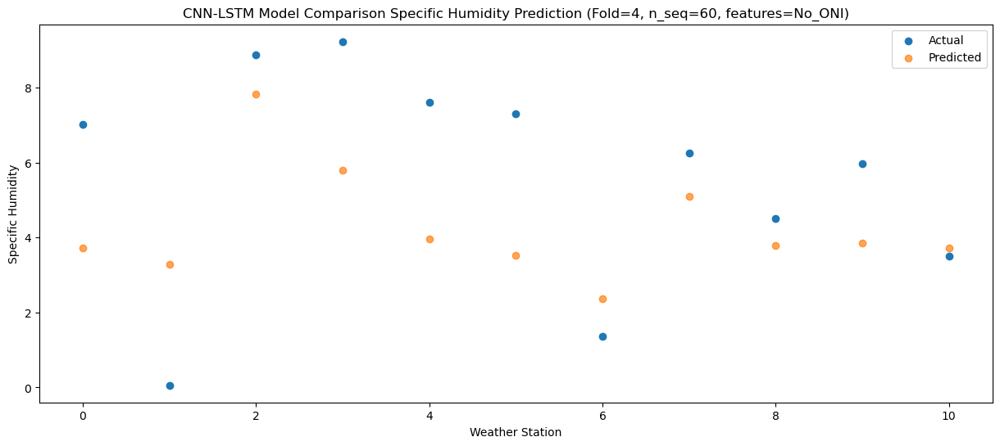

Predictions for (t+19):
    Weather_Station  Actual  Predicted
0                 0   11.60   8.220236
1                 1    4.35   7.780226
2                 2   13.11  12.320230
3                 3   12.92  10.300232
4                 4   11.49   8.460234
5                 5    9.60   8.030230
6                 6    6.05   6.870231
7                 7   10.85   9.600230
8                 8    9.56   8.300230
9                 9   10.73   8.360241
10               10    8.51   8.220228


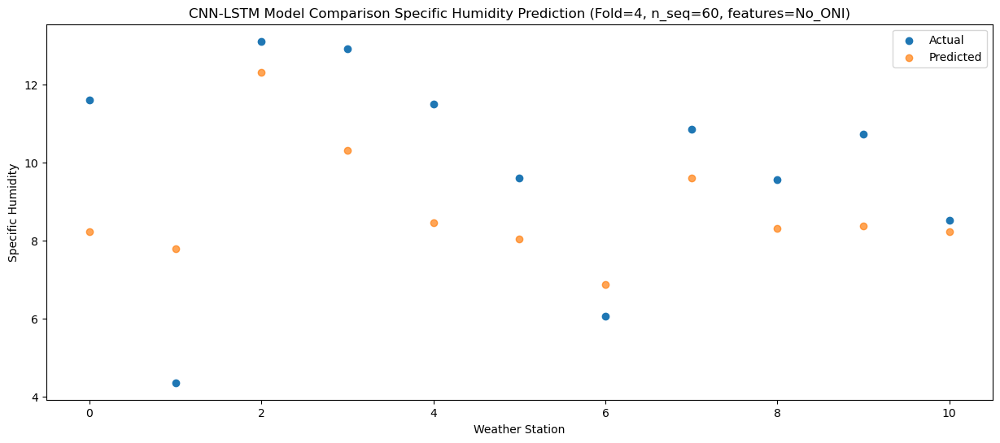

Predictions for (t+20):
    Weather_Station  Actual  Predicted
0                 0   12.99   9.650966
1                 1    5.56   9.210957
2                 2   14.76  13.750961
3                 3   13.49  11.730963
4                 4   11.87   9.890965
5                 5   10.63   9.460961
6                 6    7.65   8.300963
7                 7   11.80  11.030962
8                 8   10.82   9.730963
9                 9   12.13   9.790972
10               10    9.78   9.650961


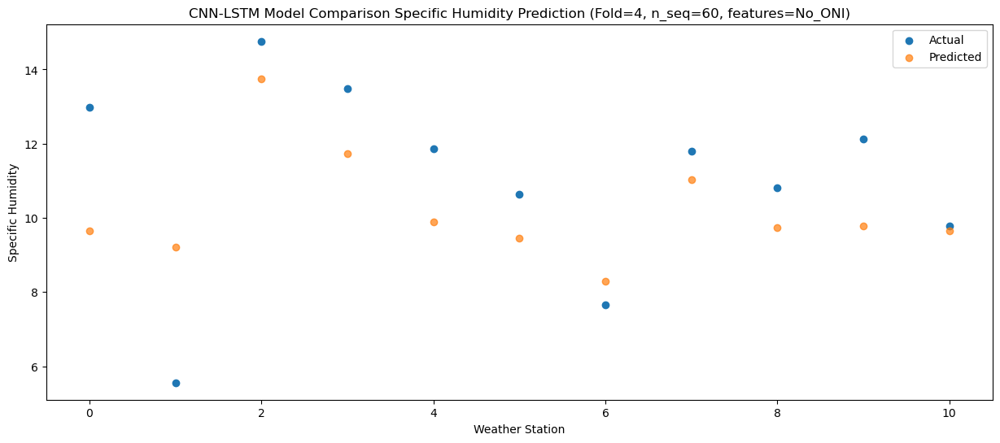

Predictions for (t+21):
    Weather_Station  Actual  Predicted
0                 0   12.81  10.228275
1                 1    5.95   9.788264
2                 2   14.77  14.328270
3                 3   13.88  12.308271
4                 4   11.98  10.468272
5                 5   10.35  10.038270
6                 6    8.03   8.878271
7                 7   11.54  11.608270
8                 8   10.96  10.308272
9                 9   12.38  10.368281
10               10   10.65  10.228269


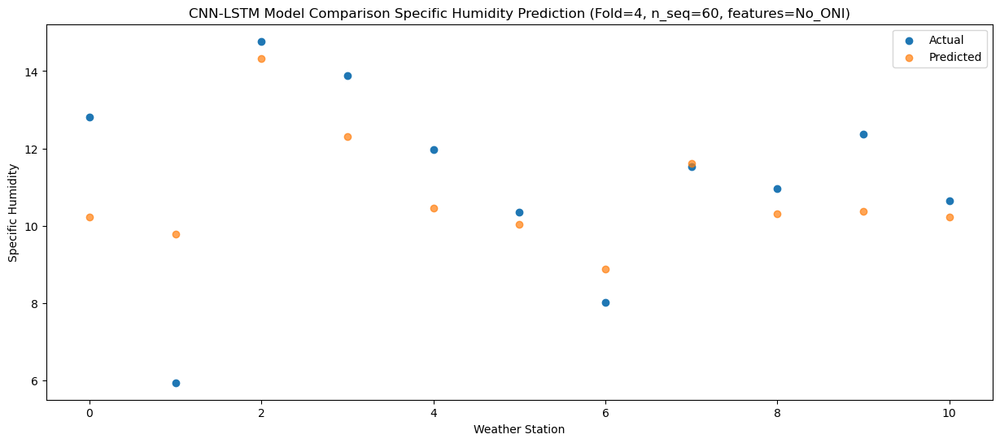

Predictions for (t+22):
    Weather_Station  Actual  Predicted
0                 0    9.23   7.388031
1                 1    5.15   6.948019
2                 2   11.83  11.488026
3                 3    9.87   9.468027
4                 4    8.08   7.628028
5                 5    7.10   7.198025
6                 6    4.45   6.038028
7                 7    8.28   8.768027
8                 8    7.48   7.468028
9                 9    8.35   7.528036
10               10    6.89   7.388025


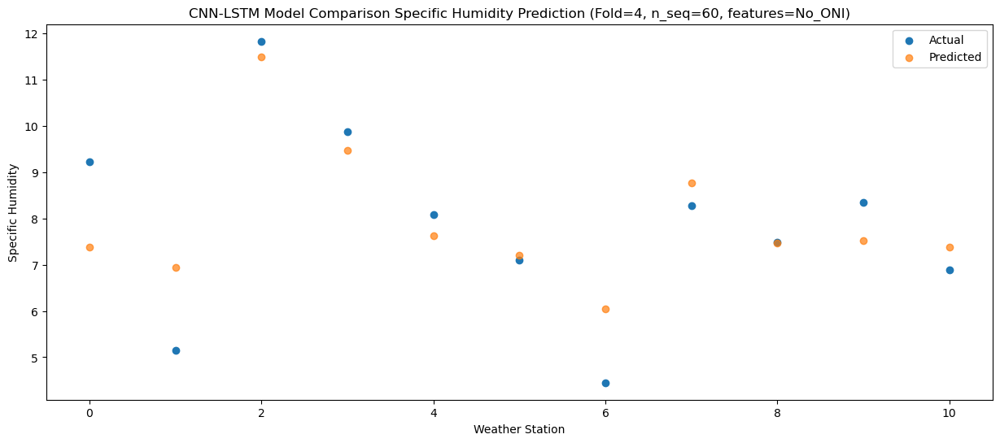

Predictions for (t+23):
    Weather_Station  Actual  Predicted
0                 0    5.86   5.568701
1                 1    2.23   5.128688
2                 2    9.05   9.668696
3                 3    7.02   7.648697
4                 4    5.35   5.808699
5                 5    4.05   5.378694
6                 6    2.24   4.218697
7                 7    6.19   6.948697
8                 8    6.33   5.648698
9                 9    6.48   5.708707
10               10    5.88   5.568695


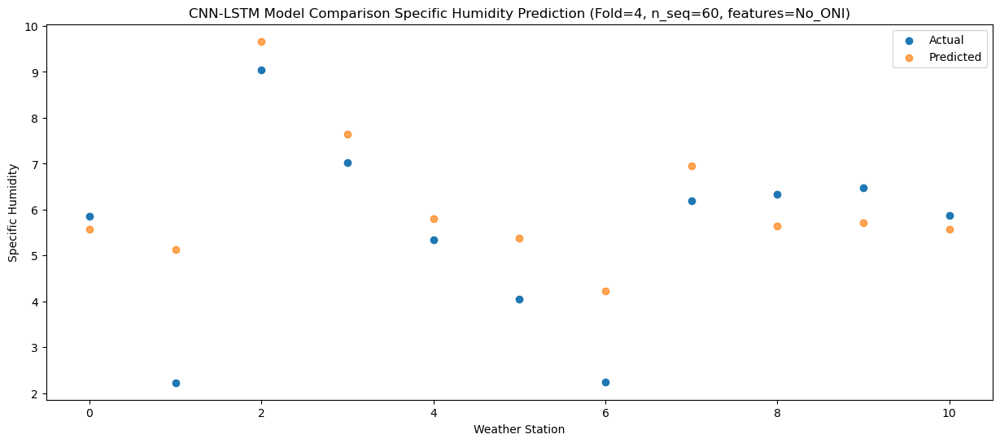

Predictions for (t+24):
    Weather_Station  Actual  Predicted
0                 0    1.77   0.886125
1                 1   -2.43   0.446113
2                 2    3.61   4.986120
3                 3    3.40   2.966120
4                 4    1.74   1.126122
5                 5    2.33   0.696120
6                 6   -3.48  -0.463880
7                 7    1.50   2.266120
8                 8    0.56   0.966121
9                 9    1.19   1.026128
10               10    0.64   0.886118


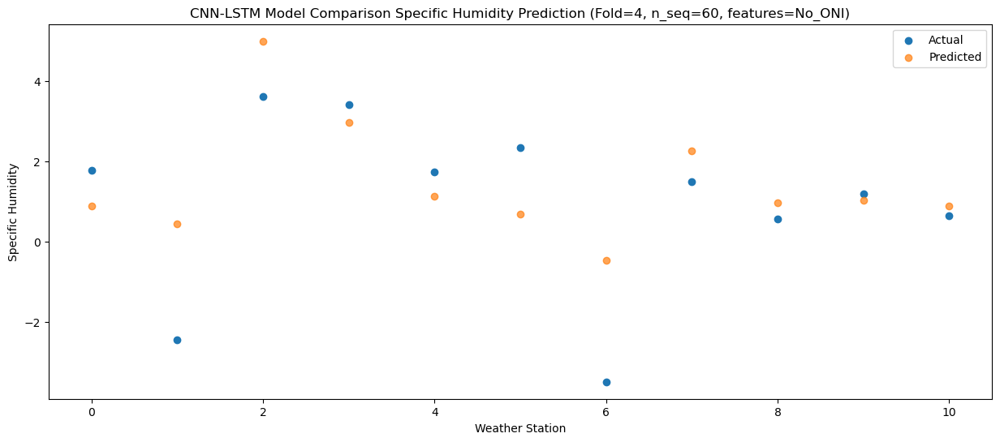

Predictions for (t+25):
    Weather_Station  Actual  Predicted
0                 0    1.56   1.327484
1                 1   -0.69   0.887472
2                 2    6.56   5.427480
3                 3    5.26   3.407480
4                 4    3.15   1.567482
5                 5    1.48   1.137480
6                 6   -1.62  -0.022519
7                 7    2.97   2.707480
8                 8    1.27   1.407481
9                 9    1.73   1.467488
10               10    0.60   1.327479


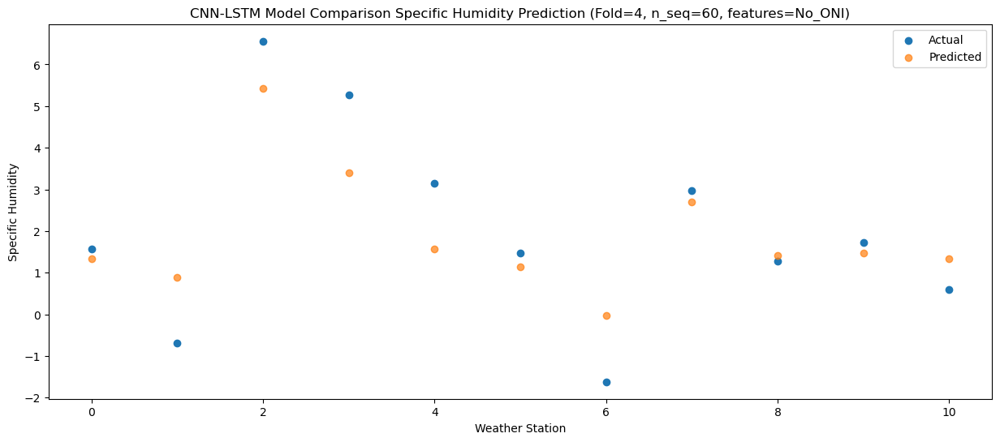

Predictions for (t+26):
    Weather_Station  Actual  Predicted
0                 0   -0.45  -0.724333
1                 1   -4.55  -1.164346
2                 2    1.83   3.375663
3                 3    0.60   1.355663
4                 4   -1.18  -0.484335
5                 5    0.02  -0.914338
6                 6   -4.60  -2.074336
7                 7   -0.23   0.655663
8                 8   -1.11  -0.644336
9                 9   -0.51  -0.584329
10               10   -1.14  -0.724339


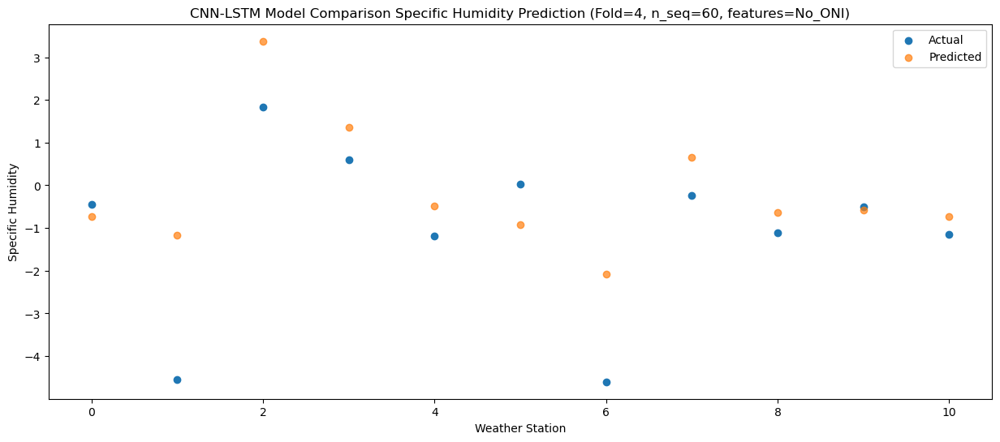

Predictions for (t+27):
    Weather_Station  Actual  Predicted
0                 0   -0.23  -0.200409
1                 1   -2.97  -0.640421
2                 2    2.68   3.899587
3                 3    1.13   1.879587
4                 4   -0.74   0.039588
5                 5    0.01  -0.390414
6                 6   -3.28  -1.550412
7                 7    0.28   1.179587
8                 8   -0.53  -0.120412
9                 9    0.19  -0.060404
10               10   -0.69  -0.200414


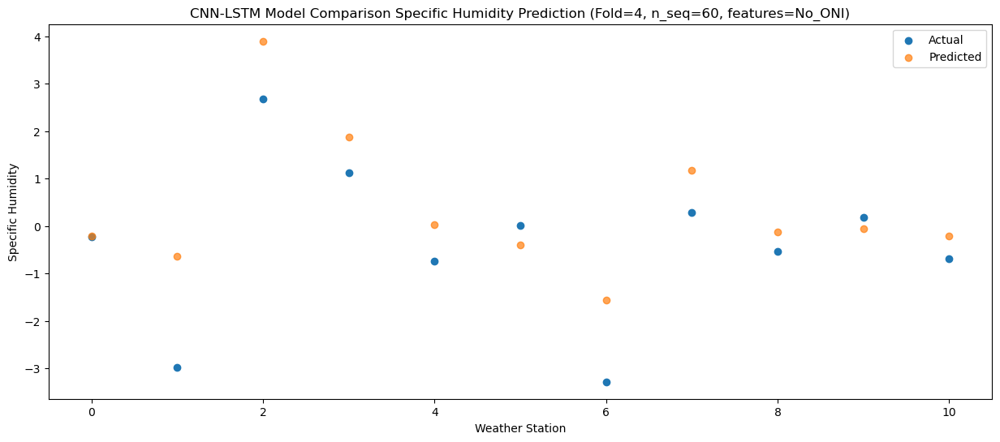

Predictions for (t+28):
    Weather_Station  Actual  Predicted
0                 0    1.33   0.769805
1                 1   -1.44   0.329794
2                 2    3.73   4.869803
3                 3    2.72   2.849801
4                 4    0.78   1.009802
5                 5    0.60   0.579801
6                 6   -2.44  -0.580197
7                 7    1.79   2.149800
8                 8    0.78   0.849802
9                 9    1.71   0.909811
10               10    0.46   0.769799


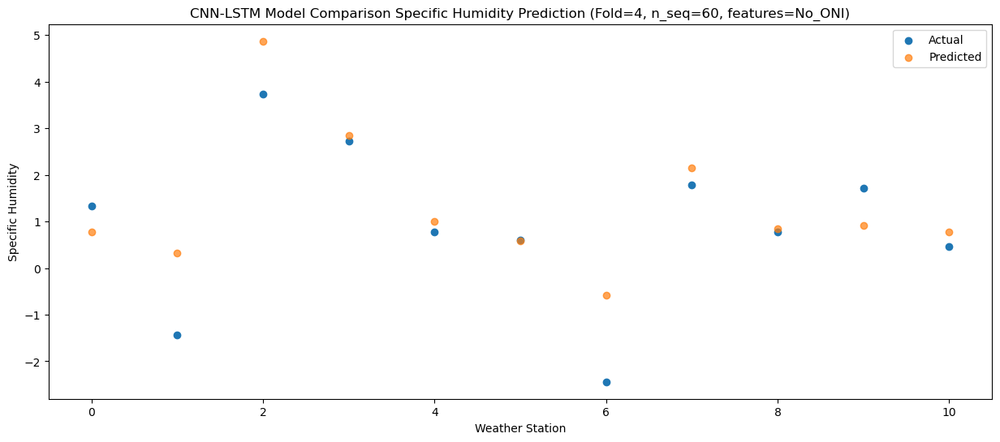

Predictions for (t+29):
    Weather_Station  Actual  Predicted
0                 0    2.82   1.753905
1                 1   -0.15   1.313894
2                 2    6.18   5.853903
3                 3    6.23   3.833900
4                 4    4.46   1.993900
5                 5    2.63   1.563901
6                 6   -1.38   0.403903
7                 7    3.58   3.133900
8                 8    2.27   1.833902
9                 9    3.01   1.893911
10               10    1.45   1.753899


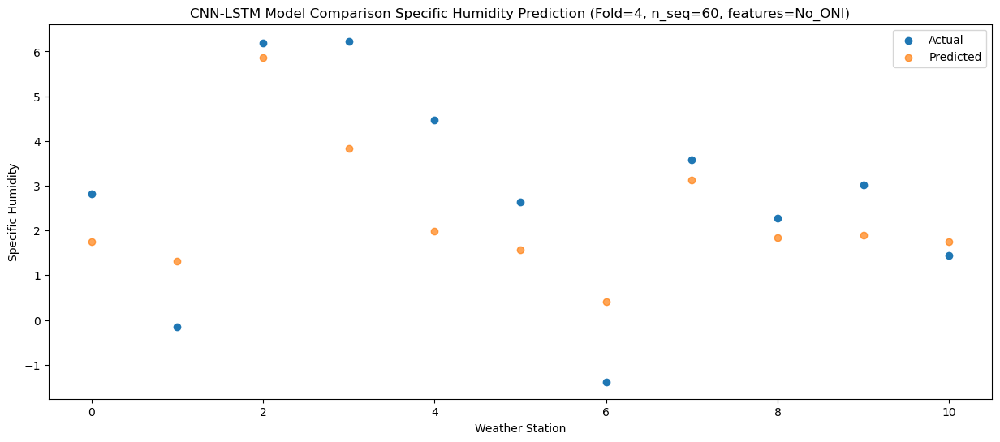

Predictions for (t+30):
    Weather_Station  Actual  Predicted
0                 0    7.70   5.391272
1                 1    2.24   4.951256
2                 2   10.78   9.491266
3                 3   10.22   7.471265
4                 4    8.34   5.631265
5                 5    4.89   5.201264
6                 6    2.63   4.041266
7                 7    8.29   6.771266
8                 8    6.29   5.471268
9                 9    7.08   5.531275
10               10    4.91   5.391265


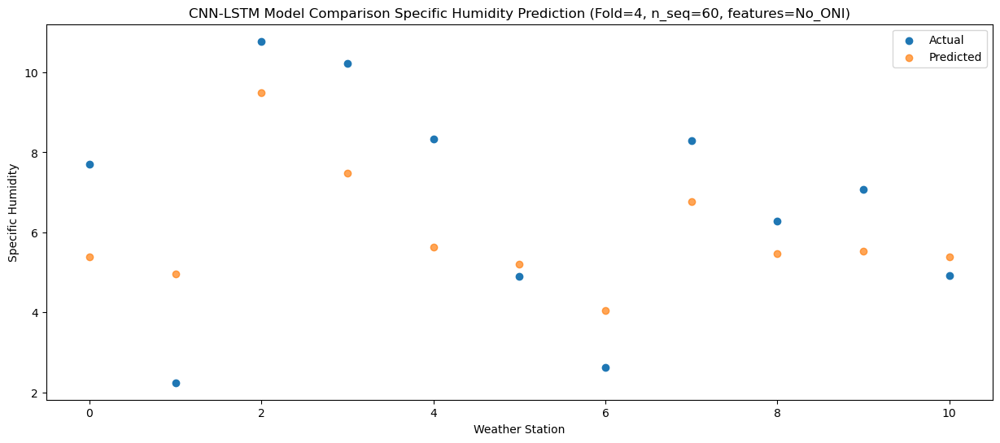

Predictions for (t+31):
    Weather_Station  Actual  Predicted
0                 0   10.93   7.475455
1                 1    5.14   7.035435
2                 2   13.16  11.575447
3                 3   11.99   9.555447
4                 4   10.02   7.715448
5                 5    7.74   7.285444
6                 6    4.91   6.125448
7                 7   10.65   8.855449
8                 8    7.73   7.555451
9                 9    9.32   7.615459
10               10    6.82   7.475447


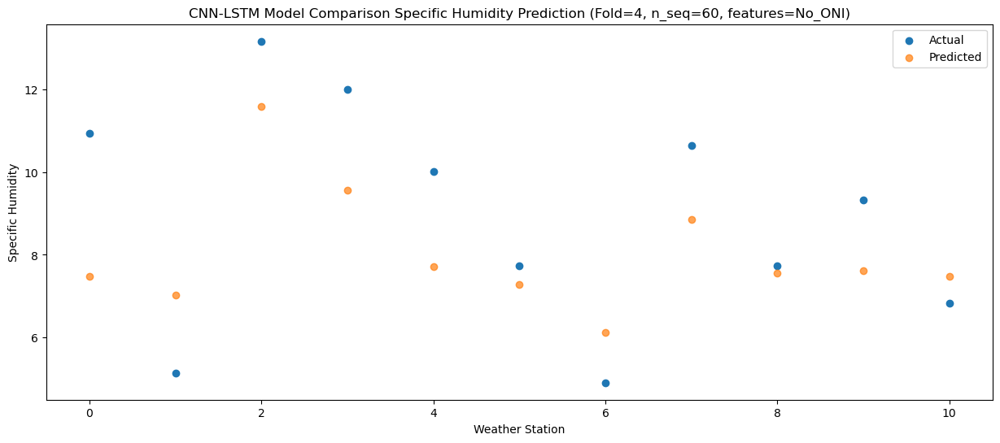

Predictions for (t+32):
    Weather_Station  Actual  Predicted
0                 0   12.56   9.908654
1                 1    6.17   9.468635
2                 2   15.00  14.008648
3                 3   11.41  11.988648
4                 4    9.52  10.148649
5                 5    8.43   9.718645
6                 6    8.07   8.558649
7                 7   11.45  11.288649
8                 8   10.47   9.988651
9                 9   11.96  10.048661
10               10    8.55   9.908647


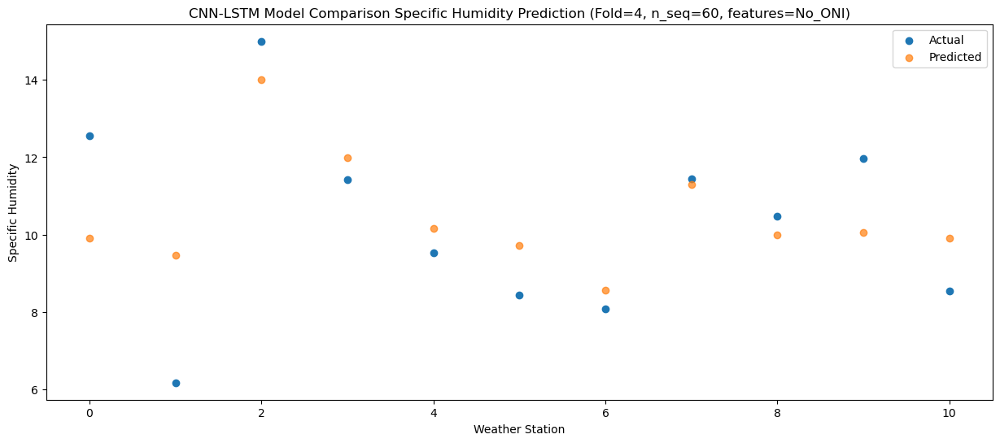

Predictions for (t+33):
    Weather_Station  Actual  Predicted
0                 0   12.35   9.763303
1                 1    6.25   9.323283
2                 2   14.82  13.863295
3                 3   12.42  11.843296
4                 4   10.69  10.003296
5                 5   10.42   9.573292
6                 6    6.88   8.413296
7                 7   11.92  11.143296
8                 8   10.11   9.843298
9                 9   11.19   9.903310
10               10    9.01   9.763295


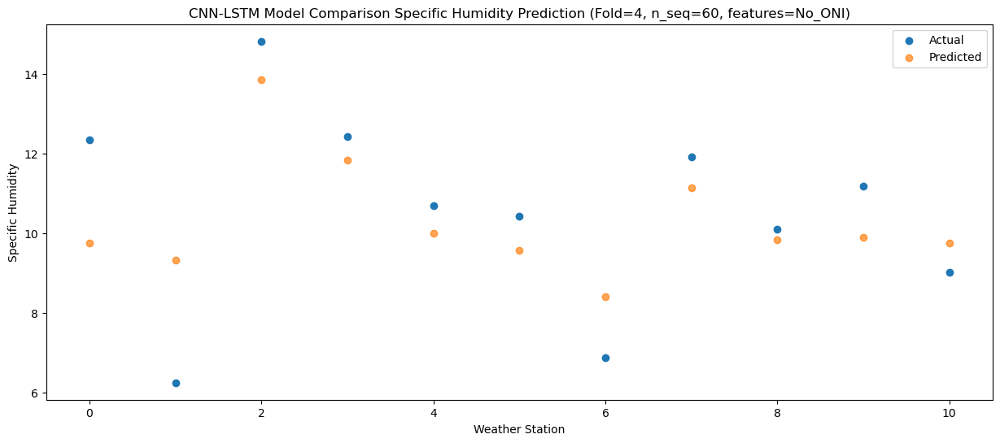

Predictions for (t+34):
    Weather_Station  Actual  Predicted
0                 0    7.65   6.990415
1                 1    5.38   6.550396
2                 2   10.58  11.090407
3                 3    9.14   9.070407
4                 4    7.54   7.230408
5                 5    9.17   6.800404
6                 6    3.33   5.640407
7                 7    8.11   8.370409
8                 8    7.45   7.070411
9                 9    7.82   7.130421
10               10    7.02   6.990406


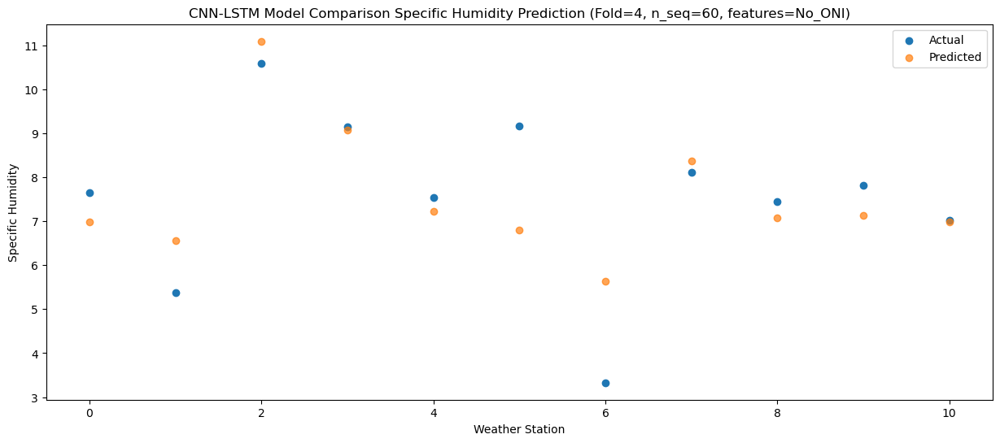

Predictions for (t+35):
    Weather_Station  Actual  Predicted
0                 0    3.06   2.989255
1                 1    0.60   2.549238
2                 2    5.62   7.089249
3                 3    4.68   5.069248
4                 4    3.08   3.229249
5                 5    5.66   2.799247
6                 6   -1.35   1.639249
7                 7    3.45   4.369250
8                 8    2.12   3.069251
9                 9    3.06   3.129260
10               10    2.20   2.989246


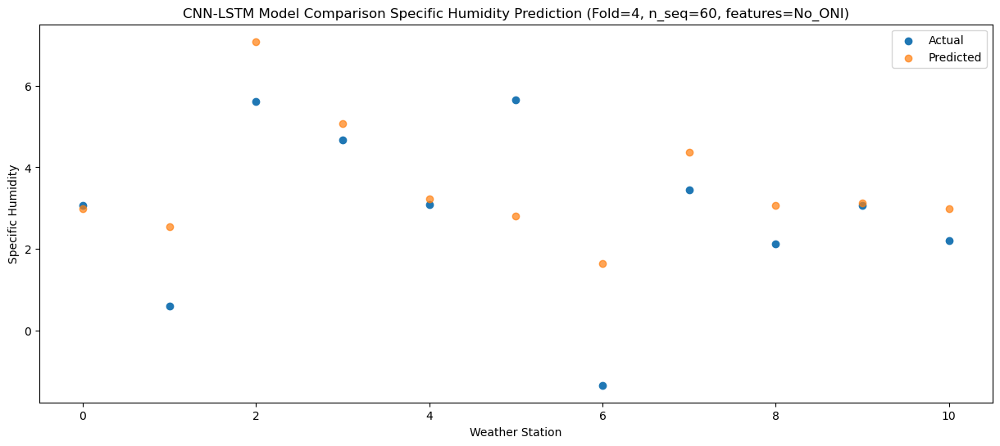

Predictions for (t+36):
    Weather_Station  Actual  Predicted
0                 0    1.89   1.857606
1                 1    0.77   1.417591
2                 2    4.87   5.957600
3                 3    4.50   3.937598
4                 4    2.66   2.097599
5                 5    2.96   1.667600
6                 6   -1.53   0.507600
7                 7    2.09   3.237600
8                 8    1.08   1.937601
9                 9    1.69   1.997609
10               10    1.48   1.857596


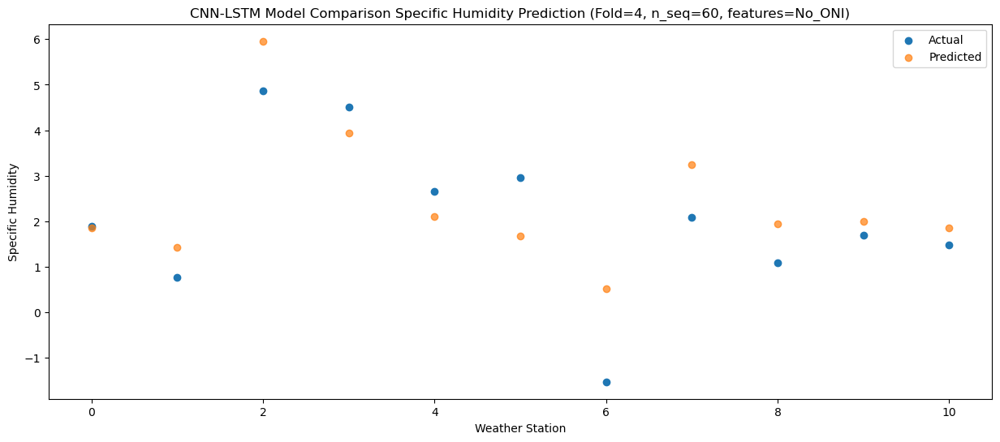

Predictions for (t+37):
    Weather_Station  Actual  Predicted
0                 0    0.55   0.393254
1                 1   -2.75  -0.046758
2                 2    4.33   4.493249
3                 3    2.92   2.473247
4                 4    1.07   0.633247
5                 5    2.32   0.203249
6                 6   -3.52  -0.956752
7                 7    1.22   1.773248
8                 8    0.12   0.473249
9                 9    0.58   0.533256
10               10    0.03   0.393244


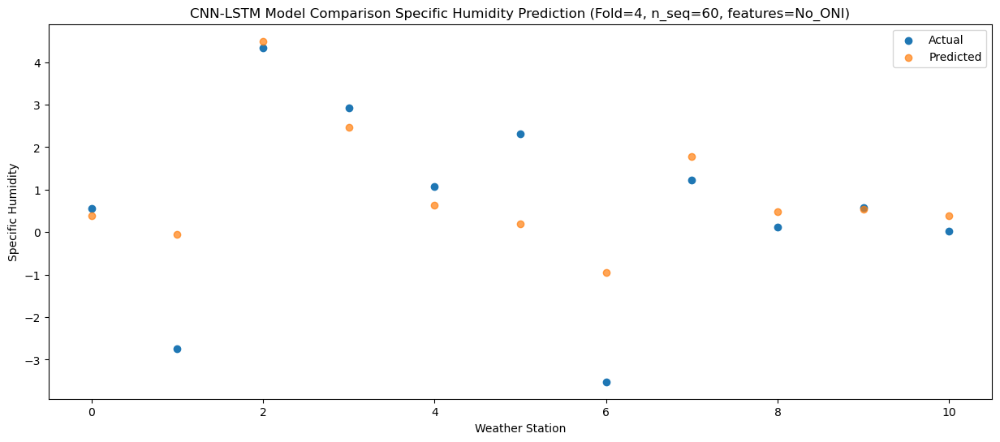

Predictions for (t+38):
    Weather_Station  Actual  Predicted
0                 0    0.90   0.866021
1                 1   -3.26   0.426009
2                 2    4.23   4.966015
3                 3    2.23   2.946014
4                 4    0.32   1.106015
5                 5    0.77   0.676014
6                 6   -2.89  -0.483986
7                 7    1.50   2.246016
8                 8    0.74   0.946016
9                 9    1.10   1.006024
10               10    0.65   0.866011


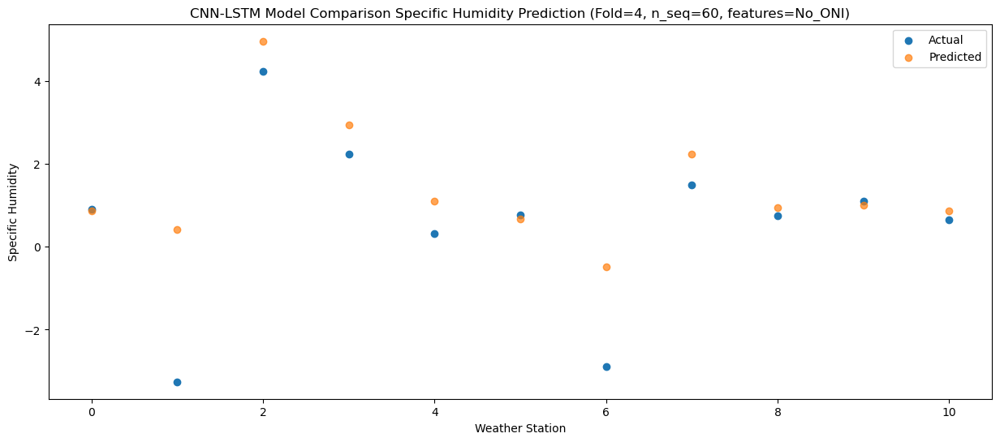

Predictions for (t+39):
    Weather_Station  Actual  Predicted
0                 0    0.85   0.739995
1                 1   -1.32   0.299982
2                 2    4.90   4.839986
3                 3    2.59   2.819986
4                 4    0.72   0.979987
5                 5    0.89   0.549986
6                 6   -1.85  -0.610014
7                 7    1.31   2.119989
8                 8    0.34   0.819990
9                 9    0.87   0.879998
10               10   -0.10   0.739985


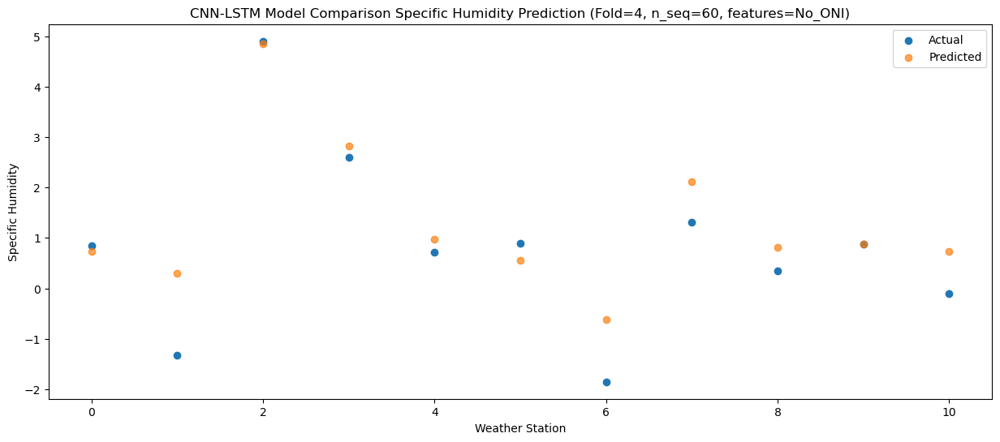

Predictions for (t+40):
    Weather_Station  Actual  Predicted
0                 0    1.69   0.800287
1                 1   -0.94   0.360272
2                 2    5.23   4.900278
3                 3    4.65   2.880277
4                 4    2.69   1.040277
5                 5    2.18   0.610277
6                 6   -2.36  -0.549724
7                 7    2.07   2.180282
8                 8    0.69   0.880282
9                 9    1.48   0.940292
10               10    0.11   0.800277


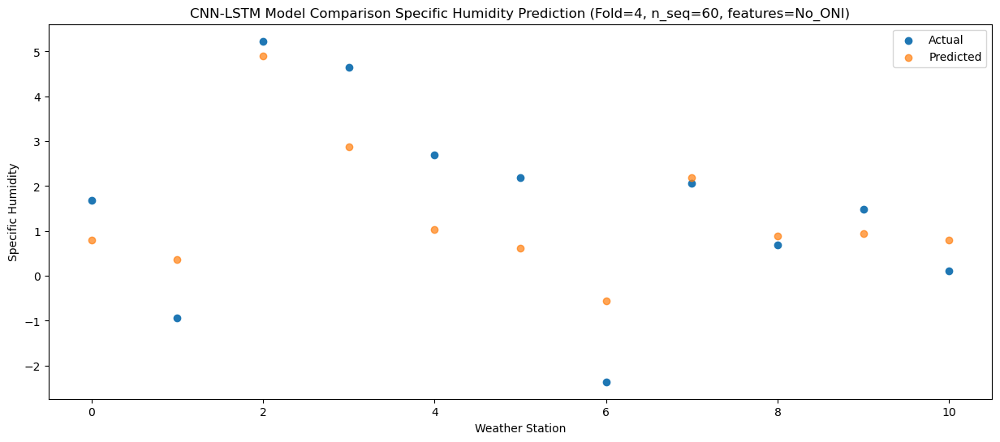

Predictions for (t+41):
    Weather_Station  Actual  Predicted
0                 0    2.87   2.703805
1                 1    0.55   2.263789
2                 2    6.07   6.803797
3                 3    5.33   4.783796
4                 4    3.54   2.943796
5                 5    2.15   2.513796
6                 6   -0.76   1.353796
7                 7    2.97   4.083801
8                 8    2.14   2.783803
9                 9    2.99   2.843812
10               10    1.81   2.703796


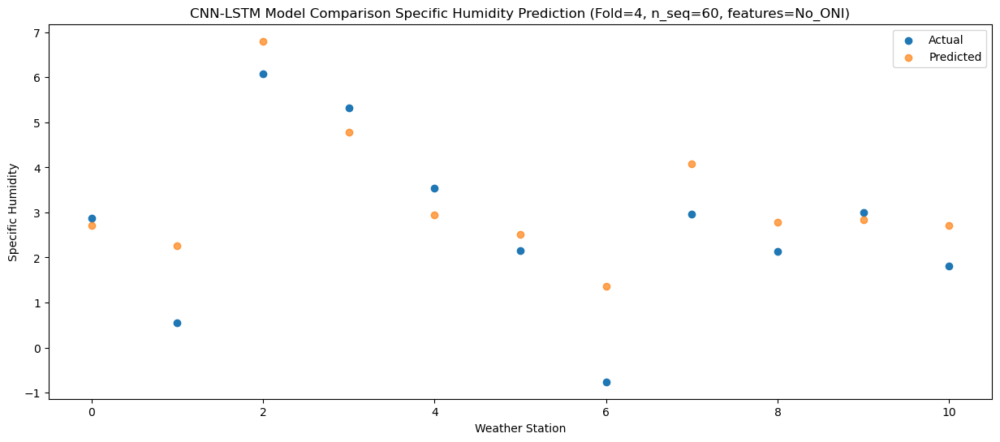

Predictions for (t+42):
    Weather_Station  Actual  Predicted
0                 0    6.89   4.677608
1                 1    1.35   4.237592
2                 2    9.45   8.777600
3                 3    9.59   6.757599
4                 4    7.81   4.917599
5                 5    6.99   4.487597
6                 6    1.46   3.327598
7                 7    7.36   6.057603
8                 8    4.39   4.757606
9                 9    5.77   4.817616
10               10    2.71   4.677599


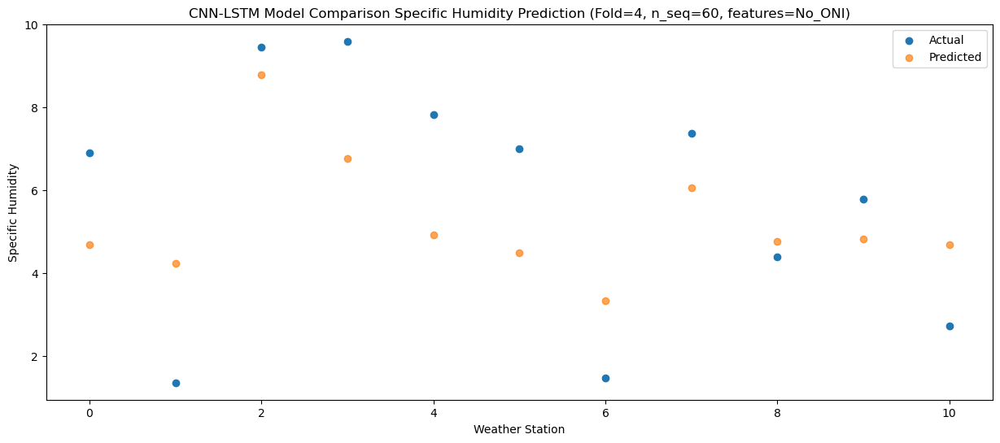

Predictions for (t+43):
    Weather_Station  Actual  Predicted
0                 0    9.43   7.439137
1                 1    4.86   6.999119
2                 2   13.02  11.539126
3                 3   13.53   9.519126
4                 4   11.29   7.679127
5                 5   10.85   7.249124
6                 6    4.51   6.089124
7                 7    9.92   8.819130
8                 8    6.35   7.519134
9                 9    7.41   7.579143
10               10    5.95   7.439127


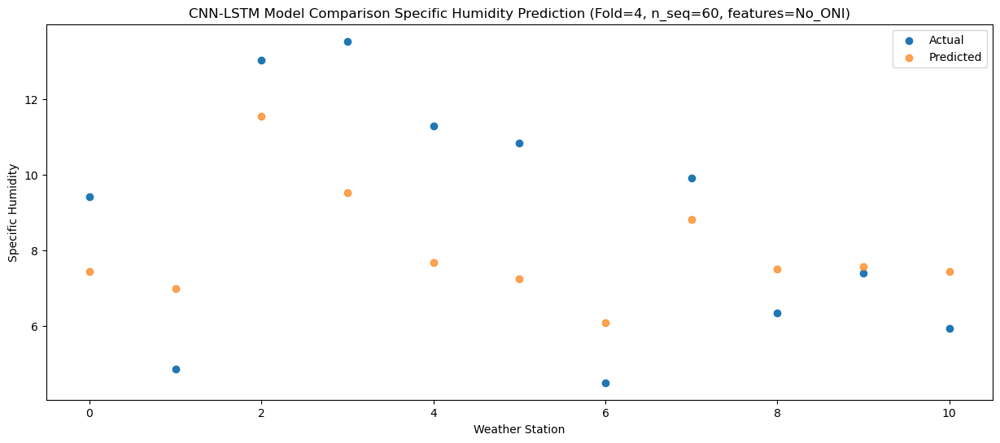

Predictions for (t+44):
    Weather_Station  Actual  Predicted
0                 0   12.12  10.450936
1                 1    6.77  10.010915
2                 2   14.61  14.550923
3                 3   13.38  12.530925
4                 4   10.39  10.690927
5                 5    8.52  10.260920
6                 6    7.90   9.100921
7                 7   12.71  11.830927
8                 8   10.65  10.530930
9                 9   12.11  10.590940
10               10    9.57  10.450925


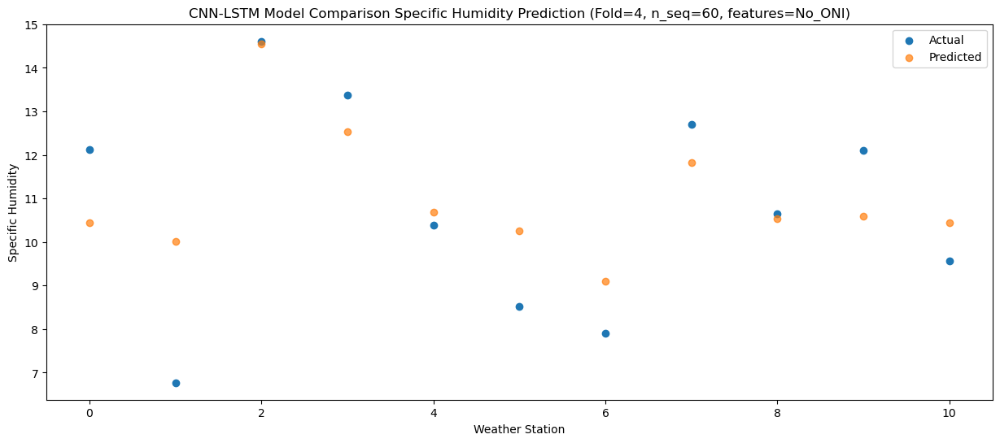

Predictions for (t+45):
    Weather_Station  Actual  Predicted
0                 0   13.05   9.665949
1                 1    7.07   9.225928
2                 2   13.03  13.765936
3                 3   11.28  11.745938
4                 4    9.01   9.905940
5                 5    7.66   9.475933
6                 6    7.44   8.315935
7                 7   12.99  11.045941
8                 8   10.11   9.745943
9                 9   11.98   9.805954
10               10    8.77   9.665939


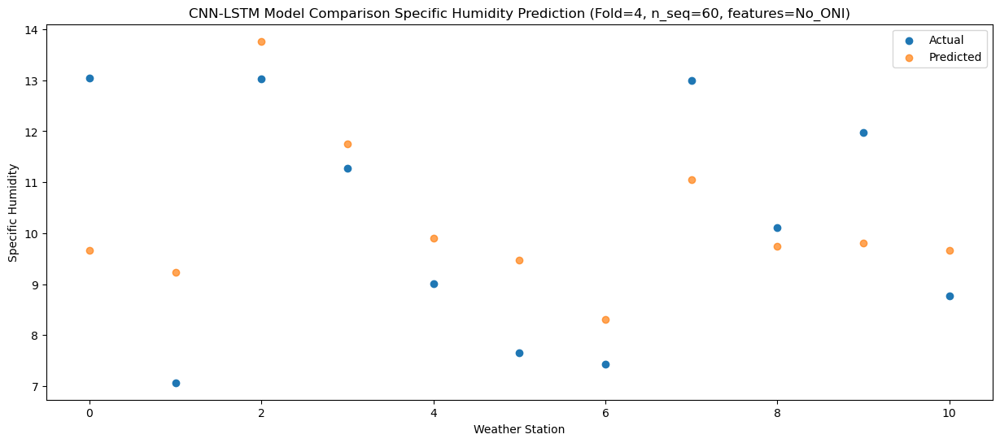

Predictions for (t+46):
    Weather_Station  Actual  Predicted
0                 0    8.13   7.666769
1                 1    4.62   7.226747
2                 2   10.01  11.766755
3                 3   10.38   9.746757
4                 4    8.68   7.906760
5                 5    8.17   7.476752
6                 6    3.99   6.316753
7                 7    8.79   9.046761
8                 8    7.31   7.746763
9                 9    8.20   7.806772
10               10    7.06   7.666758


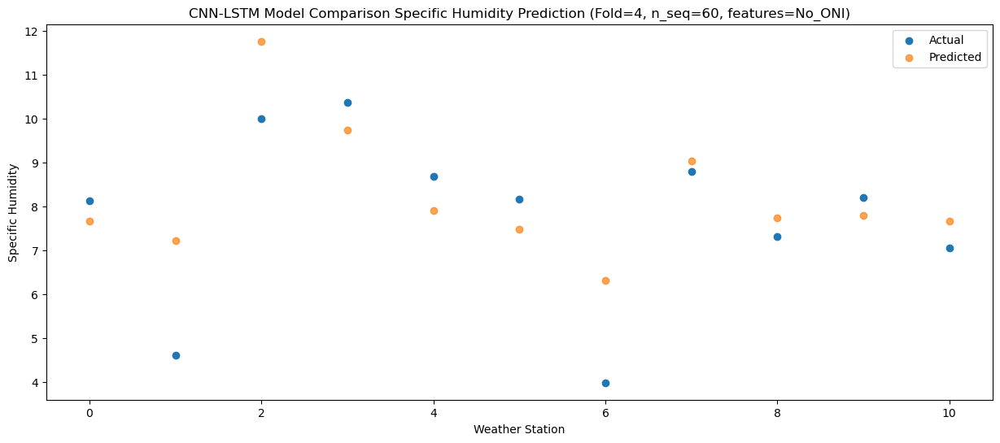

Predictions for (t+47):
    Weather_Station  Actual  Predicted
0                 0    4.94   4.407150
1                 1    1.00   3.967125
2                 2    6.08   8.507134
3                 3    6.66   6.487137
4                 4    5.02   4.647139
5                 5    6.04   4.217130
6                 6    0.08   3.057133
7                 7    5.18   5.787140
8                 8    3.98   4.487142
9                 9    4.76   4.547152
10               10    4.00   4.407137


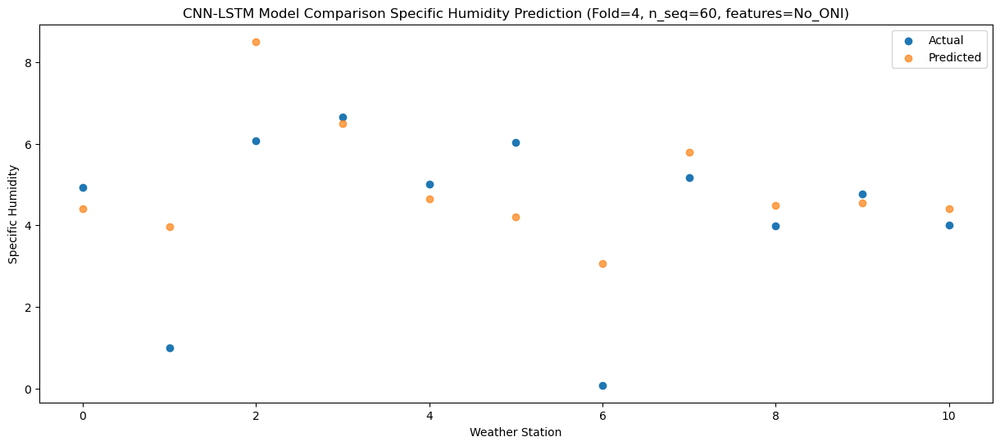

Predictions for (t+48):
    Weather_Station  Actual  Predicted
0                 0    2.04   1.448755
1                 1   -1.30   1.008730
2                 2    4.10   5.548740
3                 3    4.13   3.528744
4                 4    2.60   1.688746
5                 5    3.74   1.258736
6                 6   -2.87   0.098740
7                 7    2.15   2.828747
8                 8    0.91   1.528749
9                 9    1.37   1.588759
10               10    0.56   1.448744


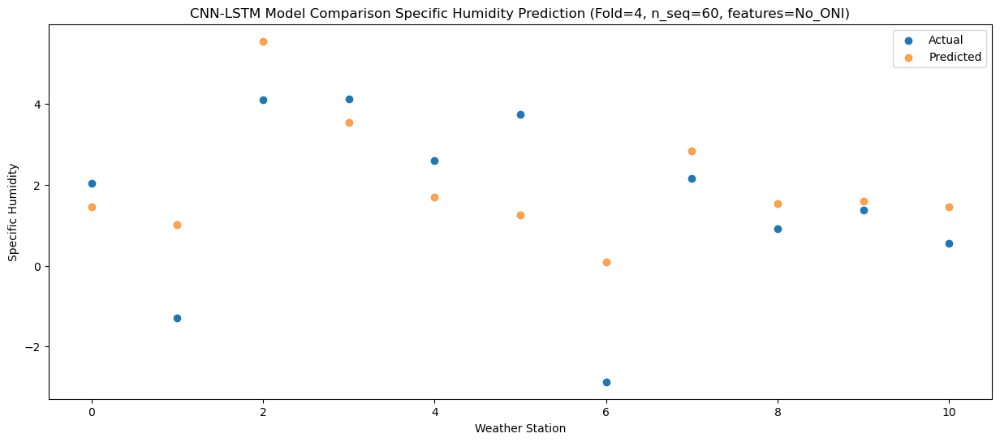

Predictions for (t+49):
    Weather_Station  Actual  Predicted
0                 0    1.86   1.479938
1                 1   -2.39   1.039913
2                 2    2.79   5.579924
3                 3    2.38   3.559928
4                 4    0.84   1.719930
5                 5    2.16   1.289919
6                 6   -3.15   0.129923
7                 7    1.34   2.859931
8                 8    0.88   1.559933
9                 9    1.86   1.619943
10               10    1.08   1.479928


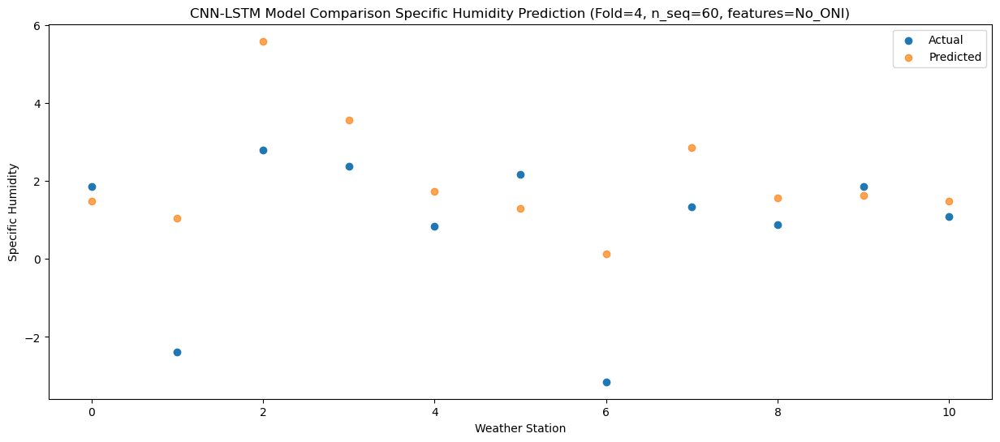

Predictions for (t+50):
    Weather_Station  Actual  Predicted
0                 0    0.16   0.720436
1                 1   -3.43   0.280411
2                 2    2.07   4.820422
3                 3    1.10   2.800426
4                 4   -0.58   0.960427
5                 5    0.89   0.530416
6                 6   -3.93  -0.629579
7                 7    0.19   2.100428
8                 8   -0.20   0.800430
9                 9    0.40   0.860439
10               10    0.01   0.720426


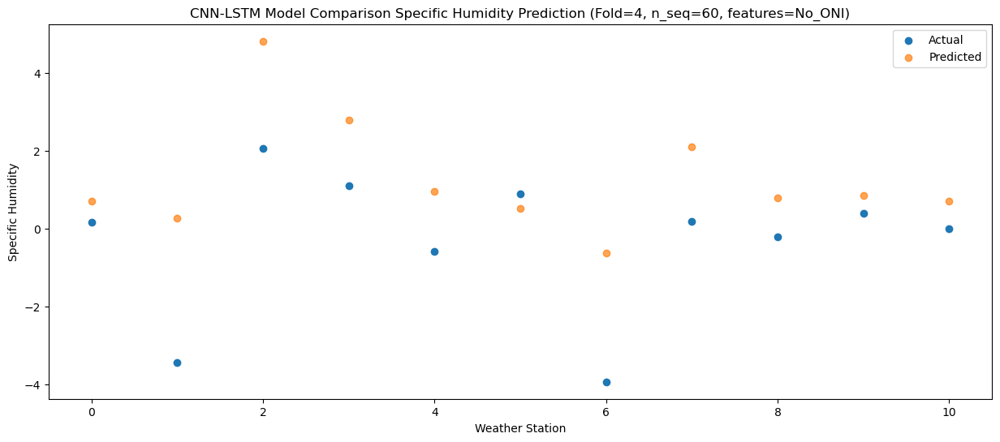

Predictions for (t+51):
    Weather_Station  Actual  Predicted
0                 0    1.17   0.743930
1                 1   -4.12   0.303902
2                 2    3.50   4.843913
3                 3    3.44   2.823916
4                 4    1.77   0.983918
5                 5    1.24   0.553908
6                 6   -3.75  -0.606088
7                 7    1.55   2.123921
8                 8    0.38   0.823923
9                 9    1.32   0.883932
10               10    0.03   0.743918


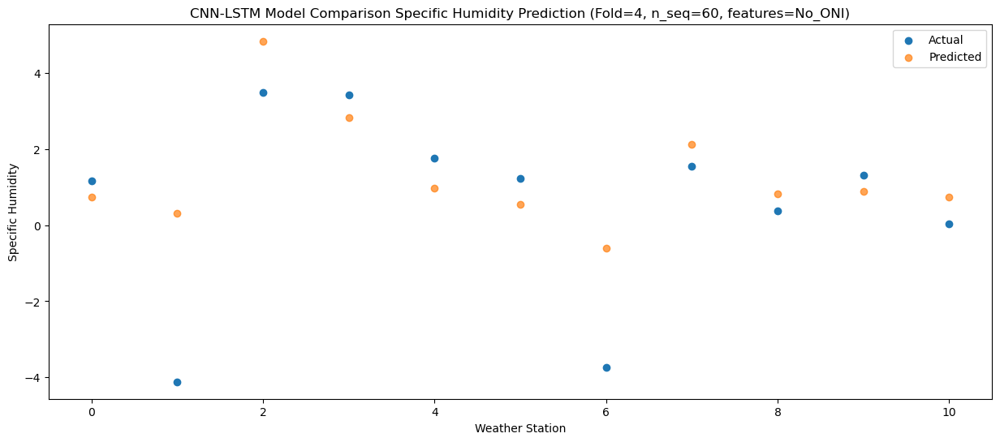

Predictions for (t+52):
    Weather_Station  Actual  Predicted
0                 0    2.23   1.841624
1                 1   -0.83   1.401597
2                 2    5.13   5.941607
3                 3    5.23   3.921611
4                 4    3.72   2.081612
5                 5    2.38   1.651603
6                 6   -2.18   0.491607
7                 7    2.76   3.221615
8                 8    1.45   1.921616
9                 9    2.29   1.981623
10               10    1.10   1.841612


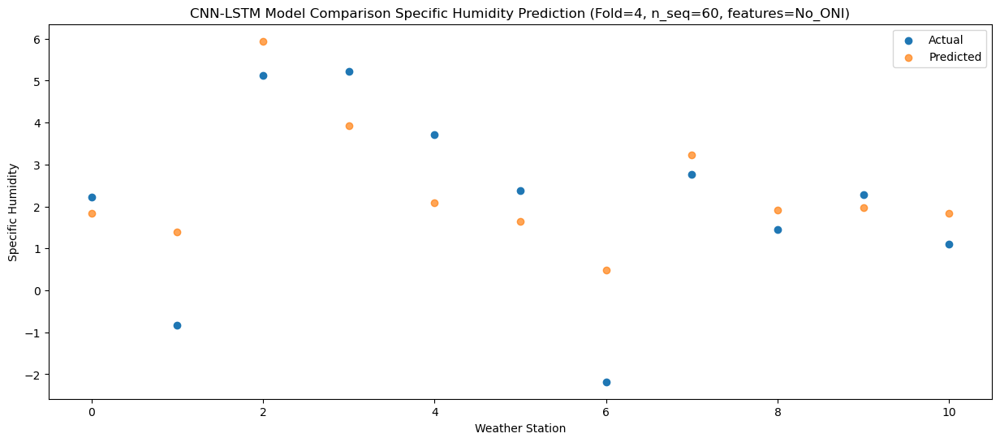

Predictions for (t+53):
    Weather_Station  Actual  Predicted
0                 0    3.91   3.105994
1                 1   -1.43   2.665967
2                 2    7.31   7.205976
3                 3    7.60   5.185979
4                 4    6.22   3.345981
5                 5    2.98   2.915973
6                 6   -0.26   1.755975
7                 7    4.49   4.485985
8                 8    3.48   3.185986
9                 9    4.01   3.245993
10               10    2.88   3.105982


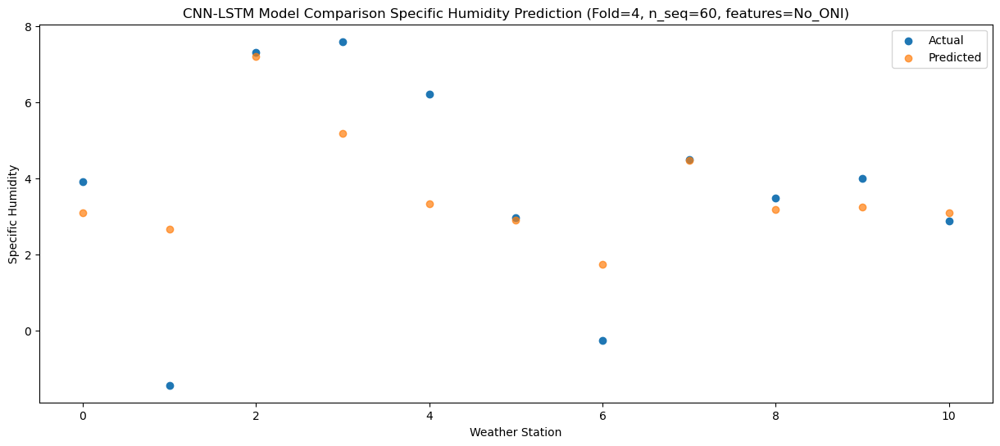

Predictions for (t+54):
    Weather_Station  Actual  Predicted
0                 0    7.98   6.618786
1                 1    1.16   6.178760
2                 2   11.63  10.718768
3                 3   11.17   8.698773
4                 4    9.65   6.858773
5                 5    5.74   6.428767
6                 6    3.74   5.268768
7                 7    8.91   7.998778
8                 8    6.97   6.698778
9                 9    7.55   6.758785
10               10    5.80   6.618776


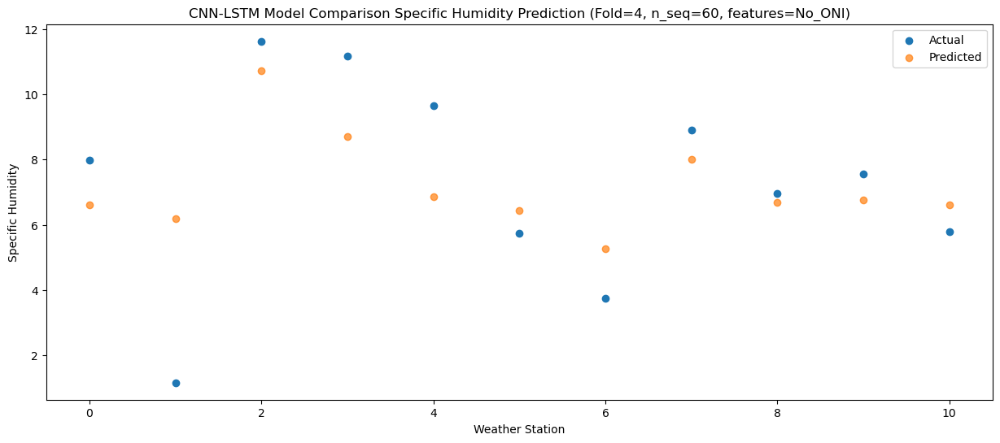

Predictions for (t+55):
    Weather_Station  Actual  Predicted
0                 0   11.24   8.780218
1                 1    2.62   8.340193
2                 2   12.97  12.880201
3                 3   13.11  10.860204
4                 4   11.76   9.020206
5                 5   10.27   8.590200
6                 6    5.50   7.430199
7                 7   10.89  10.160210
8                 8    8.66   8.860211
9                 9   10.31   8.920218
10               10    8.35   8.780208


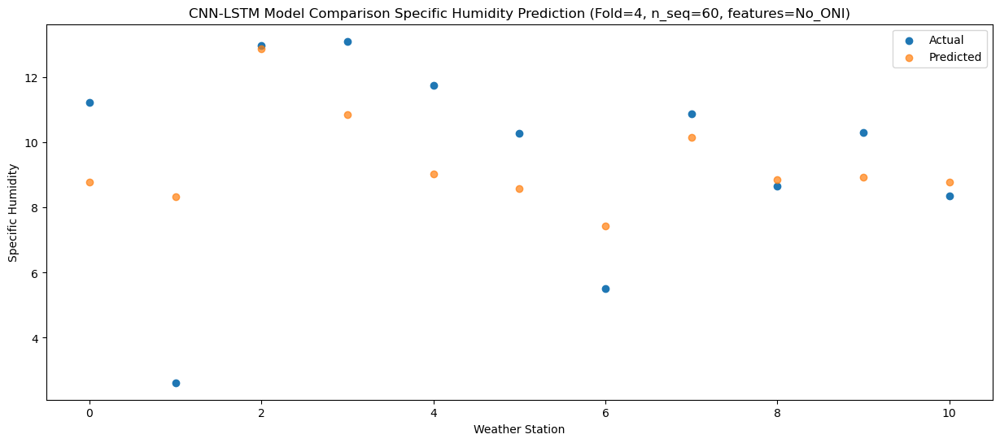

Predictions for (t+56):
    Weather_Station  Actual  Predicted
0                 0   12.43  10.400633
1                 1    4.08   9.960606
2                 2   15.00  14.500616
3                 3   13.07  12.480618
4                 4   11.29  10.640620
5                 5   10.15  10.210614
6                 6    7.89   9.050614
7                 7   11.87  11.780625
8                 8    9.96  10.480627
9                 9   11.92  10.540634
10               10    9.47  10.400624


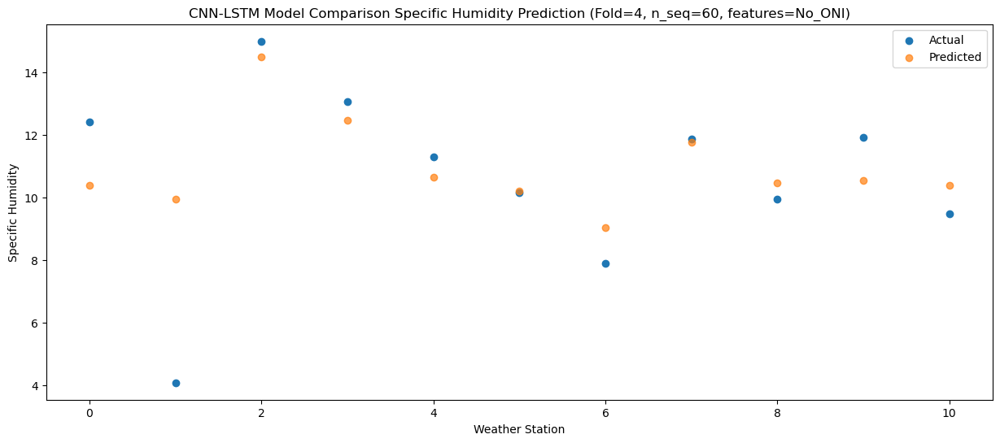

Predictions for (t+57):
    Weather_Station  Actual  Predicted
0                 0   11.27   9.622146
1                 1    6.69   9.182119
2                 2   12.69  13.722130
3                 3   12.36  11.702132
4                 4   10.52   9.862133
5                 5    8.95   9.432126
6                 6    7.15   8.272129
7                 7   10.58  11.002139
8                 8    9.60   9.702141
9                 9   11.56   9.762147
10               10    9.45   9.622137


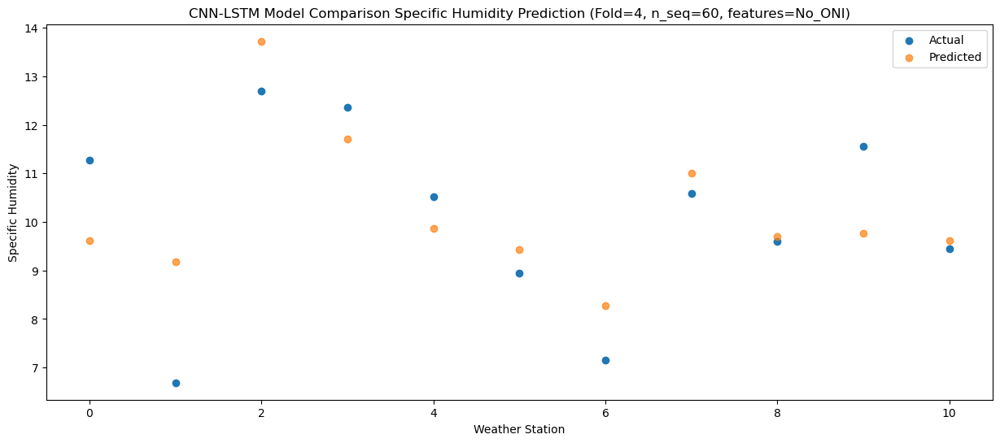

Predictions for (t+58):
    Weather_Station  Actual  Predicted
0                 0    7.97   7.620860
1                 1    6.50   7.180833
2                 2   11.59  11.720843
3                 3    9.83   9.700845
4                 4    8.36   7.860847
5                 5    8.07   7.430840
6                 6    4.83   6.270842
7                 7    8.54   9.000853
8                 8    6.92   7.700855
9                 9    8.06   7.760861
10               10    7.38   7.620851


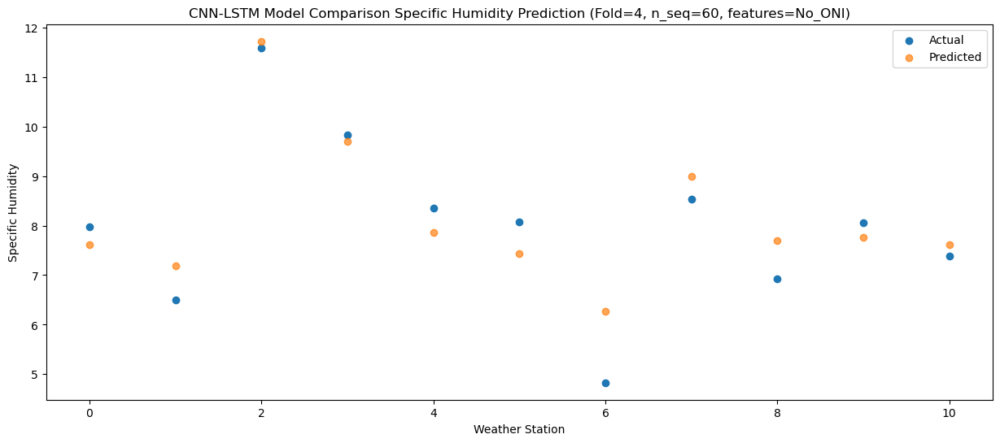

Predictions for (t+59):
    Weather_Station  Actual  Predicted
0                 0    3.84   3.899620
1                 1    2.08   3.459595
2                 2    6.80   7.999604
3                 3    6.37   5.979607
4                 4    4.62   4.139608
5                 5    4.38   3.709602
6                 6    0.43   2.549603
7                 7    4.22   5.279614
8                 8    3.34   3.979616
9                 9    3.96   4.039621
10               10    3.27   3.899612


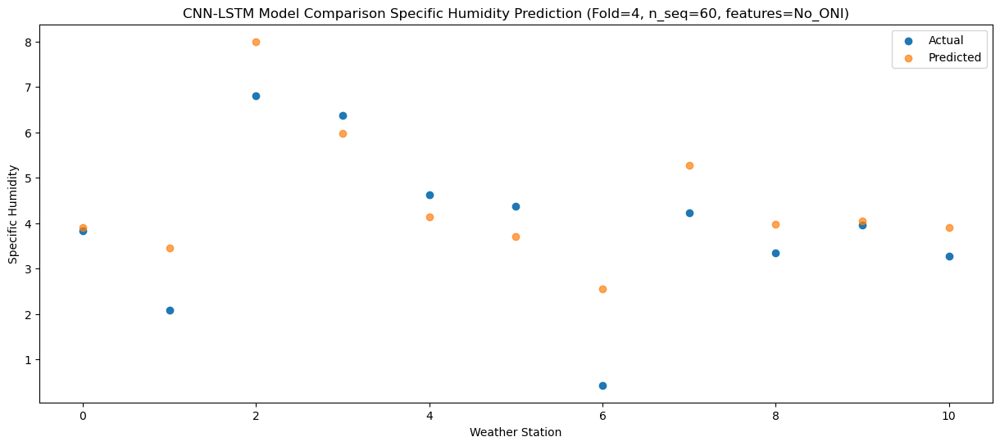

f, t:
[[ 9.500e-01 -1.880e+00  2.900e+00  3.200e+00  1.290e+00  2.630e+00
  -2.970e+00  1.810e+00  4.000e-01  9.500e-01  1.500e-01]
 [ 8.800e-01 -1.740e+00  3.740e+00  2.200e+00  3.200e-01  1.390e+00
  -2.900e+00  1.540e+00  5.700e-01  1.120e+00  3.000e-01]
 [ 4.600e-01 -3.300e+00  3.600e+00  2.840e+00  1.010e+00  1.270e+00
  -3.060e+00  1.300e+00  2.000e-01  6.400e-01 -4.000e-02]
 [ 2.800e-01 -2.460e+00  3.410e+00  2.220e+00  3.500e-01  1.150e+00
  -2.480e+00  1.070e+00 -2.000e-01  3.700e-01 -3.900e-01]
 [ 2.510e+00 -1.080e+00  6.960e+00  6.170e+00  4.250e+00  3.950e+00
  -2.900e-01  3.620e+00  1.720e+00  2.420e+00  1.180e+00]
 [ 3.100e+00  1.300e-01  5.840e+00  5.770e+00  3.740e+00  3.200e+00
  -9.600e-01  3.940e+00  2.000e+00  3.010e+00  1.020e+00]
 [ 6.310e+00  7.800e-01  8.080e+00  8.930e+00  6.980e+00  5.470e+00
   2.160e+00  7.320e+00  5.150e+00  6.730e+00  3.640e+00]
 [ 1.096e+01  4.110e+00  1.138e+01  1.109e+01  8.960e+00  7.180e+00
   5.990e+00  1.093e+01  7.890e+00  9.210e+0

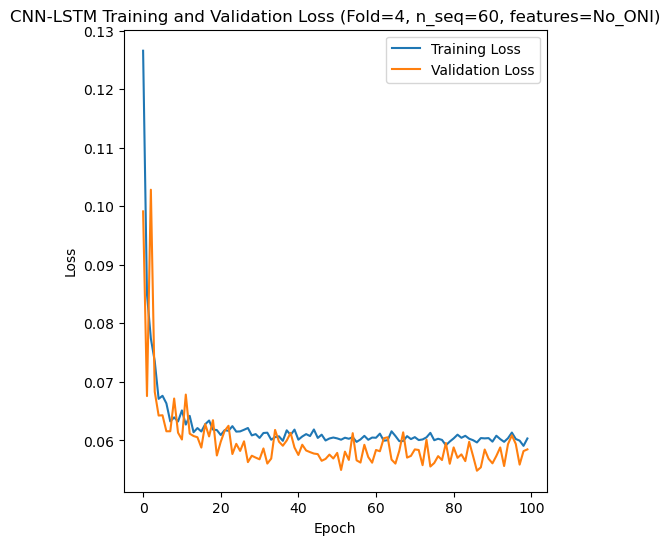

[[1.9494864099563778], [3.9995394133970037], [1.6423843518857248], [2.170228267790209], [1.5189664845251019]]
[[array(1.94948641)], [array(3.99953941)], [array(1.64238435)], [array(2.17022827)], [array(1.51896648)]]
[[1.524209443719212], [3.3388236575868886], [1.2537656118313814], [1.5696892443669563], [1.1522262281917712]]
[[1.5075163140386945], [2.9617242359785383], [0.8537193960993301], [1.0130205496622606], [0.9603353406078986]]
[[0.803072717654816], [0.19163795672800954], [0.8544561773026402], [0.636505080565917], [0.8854007149476248]]
[[array(-0.05011326)], [array(1.56299199)], [array(0.39046508)], [array(0.57542932)], [array(0.59997242)]]
[[array(0.86824572)], [array(0.71433115)], [array(0.85822101)], [array(0.73695094)], [array(0.88992794)]]
[0.03 0.46 0.37 ... 9.45 7.38 3.27]
[ 0.29684199  0.05511218 -0.21586874 ...  9.62213741  7.62085114
  3.89961229]
Accuracy Results:
RMSE for each fold:
[[1.9494864099563778], [3.9995394133970037], [1.6423843518857248], [2.170228267790209],

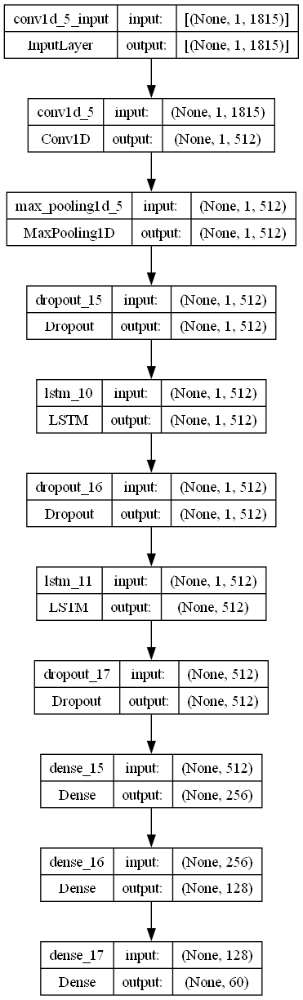

In [3]:
from sklearn.metrics import mean_squared_error, mean_absolute_error, mean_absolute_percentage_error, r2_score
from tensorflow.keras.utils import plot_model

def rmse (y_true, y_pred):
    return K.sqrt(K.mean(K.square(y_pred - y_true)))

def kmape (y_true, y_pred):
    return K.mean(K.sqrt(K.square(y_true - y_pred))/y_true)
    
def kpearson (y_true, y_pred):
    mean_true = K.mean(y_true)
    mean_pred = K.mean(y_pred)
    return (K.square(K.mean((y_true - mean_true)*(y_pred - mean_pred))))/(K.mean(K.square(y_true - mean_true))*K.mean(K.square(y_pred - mean_pred)))

# fit the best LSTM model using parameters found by Optuna
def create_best_model(X, y, n_lag, n_seq, n_batch, nb_epoch):
    
    #Parameters:
    #trial (array-like): Optuna parameters.
    #train (array-like): Target values.
    #n_lag (int): Number of lag observations.
    #n_seq (int): Number of sequence observations
    #nb_epoch (int): Maximum number of epochs
    
    # Hyperparameters from the best model
    filters = 512
    lr = 0.0020251169132599243
    optimizer = Adam(learning_rate = lr)
    activation_function = 'tanh'
    lstm_units = 512
    dropout_rate = 0.14042268236135122

    # design network
    model = Sequential()
    model.add(Conv1D(filters=filters, kernel_size=1, activation='relu', input_shape=(X.shape[1], X.shape[2]))) # CNN-LSTM only
    model.add(MaxPooling1D(pool_size=1)) # CNN-LSTM only
    model.add(Dropout(dropout_rate))
    model.add(LSTM(lstm_units, return_sequences=True))
    model.add(Dropout(dropout_rate))
    model.add(LSTM(lstm_units))
    model.add(Dropout(dropout_rate))
    model.add(Dense(256, input_dim=y.shape[1], activation=activation_function))
    model.add(Dense(128, activation=activation_function))
    model.add(Dense(n_seq))
    model.compile(loss=rmse, optimizer=optimizer, metrics=['accuracy', 'mae', rmse, mape, pearson])
        
    return model

# Make one forecast with a CNN-LSTM
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def forecast_cnnlstm(model, X, n_seq, n_test):
    # reshape input pattern to [samples, timesteps, features]
    X = X.reshape(1, 1, X.shape[1])
    # make forecast
    forecast = model.predict(X)
    # convert to array
    return forecast
     
# Evaluate the persistence model
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def make_forecasts(model, X_test, y_test, n_lag, n_seq, n_test):
    forecasts = list()
    for i in range(len(X_test)):
        X, y = X_test[i, :], y_test[i, :]
        # make forecast
        forecast = forecast_cnnlstm(model, X, n_seq, n_test)
        # store the forecast
        forecasts.append(forecast)
    return forecasts
     
# Invert differenced forecast
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def inverse_difference(last_ob, forecast):
    # Invert the first forecast
    inverted = list()
    inverted.append(forecast[0] + last_ob)
    # Propagate the difference forecast using the inverted first value
    for i in range(1, len(forecast)):
        inverted.append(forecast[i] + inverted[i-1])
    return inverted
     
# Inverse data transform on forecasts
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def inverse_transform(series, forecasts, scaler, n_test, n_seq):
    inverted = list()
    for i in range(len(forecasts)):
        # create an array from the forecast
        forecast = forecasts[i]
        forecast = forecast.reshape(1, n_seq)
        # invert scaling
        inv_scale = scaler.inverse_transform(forecast)
        inv_scale = inv_scale[0, :]
        # invert differencing
        index = len(series) - n_test + i
        last_ob = series.values[index]
        inv_diff = inverse_difference(last_ob, inv_scale)
        # store
        inverted.append(inv_diff)
    return inverted
     
# Evaluate the RMSE for each forecast time step
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def evaluate_forecasts(actual, forecasts, n_lag, n_seq):

    t = np.array(actual).transpose()
    f = np.array(forecasts).transpose()

    print("f, t:")
    print(t)
    print(f)
    rmse_list = []
    mae_list = []
    skmape_list = []
    mape_list = []
    r2_list = []
    pearson_list = []
    actual_list = []

    for i in range(n_seq):
        act = [row for row in t[i]]
        predicted = [forecast for forecast in f[i]]
        rmse1 = sqrt(mean_squared_error(act, predicted))
        rmse2 = np.array(rmse(tf.convert_to_tensor(np.array(act)), tf.convert_to_tensor(np.array(predicted))))
        mae = mean_absolute_error(act, predicted)
        mse = mean_squared_error(act, predicted)
        skmape = mean_absolute_percentage_error(act, predicted)
        kmape1 = np.array(kmape(tf.convert_to_tensor(np.array(act)), tf.convert_to_tensor(np.array(predicted))))
        kpearson1 = np.array(kpearson(tf.convert_to_tensor(np.array(act)), tf.convert_to_tensor(np.array(predicted))))
        r2 = r2_score(act, predicted) 
        avg_actual = np.mean(act)
        print("Year at t+"+str(i+1)+":")
        print('t+%d SKRMSE: %f' % ((i+1), rmse1))
        print('t+%d KRMSE: %f' % ((i+1), rmse2))        
        print('t+%d MAE: %f' % ((i+1), mae))
        print('t+%d SKMAPE: %f' % ((i+1), skmape))
        print('t+%d R2_SCORE: %f' % ((i+1), r2))
        print('t+%d KMAPE: %f' % ((i+1), kmape1))
        print('t+%d PEARSON: %f' % ((i+1), kpearson1))
        print('t+%d AVERAGE ACTUAL: %f' % ((i+1), avg_actual))

    y_true = tf.convert_to_tensor(np.array(actual).flatten())
    y_pred = tf.convert_to_tensor(np.array(forecasts).flatten())

    rmse1 = sqrt(mean_squared_error(np.array(y_true), np.array(y_pred)))
    rmse2 = np.array(rmse(y_true, y_pred))
    mae = mean_absolute_error(np.array(y_true), np.array(y_pred))
    mse = mean_squared_error(np.array(y_true), np.array(y_pred))
    skmape = mean_absolute_percentage_error(np.array(y_true), np.array(y_pred))
    kmape1 = np.array(kmape(y_true, y_pred))
    kpearson1 = np.array(kpearson(y_true, y_pred))
    r2 = r2_score(np.array(y_true), np.array(y_pred)) 
    avg_actual = np.mean(np.array(y_true))
    rmse1_list.append(rmse1)
    rmse2_list.append(rmse2)
    mae_list.append(mae)
    skmape_list.append(skmape)
    pearson_list.append(kpearson1)
    mape_list.append(kmape1)
    r2_list.append(r2)
    actual_list.append(avg_actual)
    print("Metrics for this Fold:")
    print('SKRMSE: %f' % (rmse1))
    print('KRMSE: %f' % (rmse2))        
    print('MAE: %f' % (mae))
    print('SKMAPE: %f' % (skmape))
    print('R2_SCORE: %f' % (r2))
    print('KMAPE: %f' % (kmape1))
    print('PEARSON: %f' % (kpearson1))
    print('AVERAGE ACTUAL: %f' % (avg_actual))

    return rmse1_list, rmse2_list, mae_list, skmape_list, r2_list, mape_list, pearson_list, actual_list
     
# plot the forecasts in the context of the original dataset
#Taken from: https://machinelearningmastery.com/multi-step-time-series-forecasting-long-short-term-memory-networks-python/
def plot_forecasts(series, forecasts, actual, n_test, n_seq, n_lag):
    # plot the entire dataset in blue
    plt.plot(series[:n_lag+2+len(forecasts)].values)
    # plot the forecasts in red
    off_s = n_lag + 1
    off_e = off_s + len(forecasts) + 1
    xaxis = [x for x in range(off_s, off_e)]
    yaxis = [series.values[off_s]] + forecasts
    print(xaxis)
    print(yaxis)
    plt.plot(xaxis, yaxis, color='red')
    plt.xlabel("Month")
    plt.ylabel("Specific Humidity")
    # show the plot
    plt.show()

n_batch = 1
n_test = 11
nb_epoch = 100
    
rmse1_avg_list = []
rmse2_avg_list = []
mae_avg_list = []
skmape_avg_list = []
r2_score_avg_list = []
mape_avg_list = []
pearson_avg_list = []
actual_avg_list = []
forecast_results = []
actual_results = []
    
for i in range(5):
    train1 = train[i]
    test1 = test[i]
    validation1 = validation[i]

    X = train1[:, 0:-n_seq]
    y = train1[:, -n_seq:]
    X_test = test1[:, 0:-n_seq]
    y_test = test1[:, -n_seq:]
    X_val = validation1[:, 0:-n_seq]
    y_val = validation1[:, -n_seq:]
    
    dataset_df = pd.DataFrame(val_y[i])
    dataset_df = dataset_df.iloc[0:10, :]
    dataset = dataset_df.values

    print(dataset)

    series = pd.Series(dataset[:, 0]) # Using first column (specific_humidity)

    X = X.reshape(X.shape[0], 1, X.shape[1])
    X1 = X_test
    X_test = X_test.reshape(X_test.shape[0], 1, X_test.shape[1])
    X_val = X_val.reshape(X_val.shape[0], 1, X_val.shape[1])

    best_model = create_best_model(X, y, n_lag, n_seq, n_batch, nb_epoch)
    history = best_model.fit(X, y, epochs=100, batch_size=n_batch, validation_data=(X_val, y_val))
    
    # Evaluate the model
    loss = best_model.evaluate(X_test, y_test, verbose=2)
    print(f'Test Loss: {loss}')

    # make forecasts
    forecasts = make_forecasts(best_model, X_test, y_test, n_lag, n_seq, n_test)
    
    # inverse transform forecasts and test
    forecasts = inverse_transform(series, forecasts, scaler[i], n_test, n_seq)
    actual = [row[-n_seq:] for row in test1]
    actual = inverse_transform(series, actual, scaler[i], n_test, n_seq)

    # Print out plots of actual and predicted values for weather stations
    ws = df.index[1:12]
    print(ws)
    a = []
    f = []
    for q in range(len(actual)):
        x = actual[q]
        a.append(x[0])
    for q in range(len(forecasts)):
        x = forecasts[q]
        f.append(x[0])
    print(a)
    print(f)
    # Create a DataFrame for plotting
    results_df = pd.DataFrame({
        'ws': ws,
        'Actual': a,
        'Predicted': f
    })

    print(results_df)
    
    print("Actual and Forecasts:")
    print(actual)
    print(forecasts)
    
    for j in range(11):
        print("Weather Station "+str(j+1)+":")
        print("Actual S.H.\tPredicted S.H.\tDifference")
        print("-----------\t--------------\t----------")
        for k in range(n_seq):
            diff = forecasts[j][k] - actual[j][k]
            print(f"{actual[j][k]:.2f}\t\t{forecasts[j][k]:.2f}\t\t{diff:.2f}")
    
        # plot forecasts
        dataset_df = pd.DataFrame(val_y[i])
        dataset_df = dataset_df.iloc[0:11, :]
        dataset_df = dataset_df.transpose()
        dataset = dataset_df.values

        series_ws = pd.Series(dataset[:, j]) # Using first column (temperatures)
        forecasts_ws = forecasts[j]
        actual_ws = actual[j]
        
        plot_forecasts(series_ws, forecasts_ws, actual_ws, n_test, n_seq, n_lag)

    for k in range(n_seq):
        print("Predictions for (t+"+str(k)+"):")
        # Print out plots of actual and predicted values for each weather station
        results = []

        # Create a DataFrame for plotting
        for j in range(11):
            results.append([j, actual[j][k], forecasts[j][k]])
               
        results_df = pd.DataFrame(results)
        results_df.columns = ['Weather_Station', 'Actual', 'Predicted']

        print(results_df)

        # Plotting the results
        plt.figure(figsize=(15, 6))
        plt.scatter(results_df['Weather_Station'], results_df['Actual'], label='Actual')
        plt.scatter(results_df['Weather_Station'], results_df['Predicted'], label='Predicted', alpha=0.7)
        title1='CNN-LSTM Model Comparison Specific Humidity Prediction (Fold='+str(i)+', n_seq='+str(n_seq)+', features=No_ONI)'
        plt.title(title1)
        plt.xlabel('Weather Station')
        plt.ylabel('Specific Humidity')
        plt.legend()
        plt.show()

    rmse1_list = [] # list stores sklearn's root mean squared errors for each future time prediction
    rmse2_list = [] # list stores root mean squared errors for each future time prediction
    mae_list = [] # list stores mean absolute errors for each future time prediction
    skmape_list = [] # list stores sklearn's mean squared percentage errors for each future time prediction
    r2_list = [] # list stores sklearn's r2 pearson values for each future time prediction
    mape_list = [] # list stores mean squared percentage errors for each future time prediction
    pearson_list = [] # list stores r2 pearson values for each future time prediction
    actual_list = [] # list stores average actual values for each future time prediction

    # evaluate forecasts
    rmse1_list, rmse2_list, mae_list, skmape_list, r2_list, mape_list, pearson_list, actual_list = evaluate_forecasts(actual, forecasts, n_lag, n_seq)

    rmse1_avg_list.append(rmse1_list)
    rmse2_avg_list.append(rmse2_list)
    mae_avg_list.append(mae_list)
    skmape_avg_list.append(skmape_list)
    r2_score_avg_list.append(r2_list)
    mape_avg_list.append(mape_list)
    pearson_avg_list.append(pearson_list)
    actual_avg_list.append(actual_list)
    forecast_results.append(forecasts)
    actual_results.append(actual)
            
    best_model.summary()

    plt.figure(figsize=(12, 6))
    plt.subplot(1, 2, 1)
    plt.plot(history.history['loss'], label='Training Loss')
    plt.plot(history.history['val_loss'], label='Validation Loss')
    title2 = 'CNN-LSTM Training and Validation Loss (Fold='+str(i)+', n_seq='+str(n_seq)+', features=No_ONI)'
    plt.title(title2)
    plt.ylabel('Loss')
    plt.xlabel('Epoch')
    plt.legend(loc='upper right')
    plt.show()

print(rmse1_avg_list)
print(rmse2_avg_list)
print(mae_avg_list)
print(skmape_avg_list)
print(r2_score_avg_list)
print(mape_avg_list)
print(pearson_avg_list)
print(np.array(actual_results).flatten())
print(np.array(forecast_results).flatten())
a2 = np.array(actual_results).flatten()
f2 = np.array(forecast_results).flatten()
p1 = np.array(pearson(tf.convert_to_tensor(a2), tf.convert_to_tensor(f2)))
print("Accuracy Results:")
print("RMSE for each fold:")
print(rmse1_avg_list)
print("Average SKRMSE:"+str(np.mean(rmse1_avg_list)))
print("Average KRMSE:"+str(np.mean(rmse2_avg_list)))
print("Average MAE:"+str(np.mean(mae_avg_list)))
print("Average SKMAPE:"+str(np.mean(skmape_avg_list)))
print("Average MAPE:"+str(np.mean(mape_avg_list)))
print("Average PEARSON:"+str(p1))
print("Average R2 Score:"+str(np.mean(r2_score_avg_list)))
print("")
print("Average Specific Humidity:"+str(np.mean(actual_avg_list)))
print("RMSE % of Specific Humidity:"+str(np.mean(rmse2_avg_list)/np.mean(actual_avg_list)))

# Plot model architecture
filename = "cnnlstm_model_optimized_SH_S60_No_ONI.png"
plot_model(best_model, to_file=filename, show_shapes=True, show_layer_names=True)